In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from netCDF4 import Dataset, num2date, date2num
from dask.distributed import Client
import xarray as xr
import fenics as fe
import yaml
import time as time_py
import logging
import os
import importlib
import pdb
import scipy as sp

In [2]:
import letkf_forecasting.letkf_io as letkf_io
import letkf_forecasting.letkf_forecasting as lf
import letkf_forecasting.random_functions as rf
import letkf_forecasting.tmh_plot as tp
import letkf_forecasting.advection
import letkf_forecasting.optical_flow
import letkf_forecasting.assimilation as assimilation
import letkf_forecasting.assimilation_accessories as aa

In [3]:
%matplotlib inline

In [4]:
year = 2014
month = 5
day = 29
config_file_path = (
    '/home2/travis/python_code/letkf_forecasting/scripts/config_opt_wrf.yml')
with open(config_file_path) as ymlfile:
    cfg = yaml.load(ymlfile)
date = cfg['date']
date['year'] = year
date['month'] = month
date['day'] = day

# Create path to save results
home = os.path.expanduser('~')
data_file_path = cfg['io']['data_file_path'].format(
    home=home, year=date['year'],
    month=date['month'], day=date['day'])
time0 = time_py.time()

logging.basicConfig(
    filename='/home2/travis/python_code/letkf_forecasting_other_things/logs/letkf.log',  # noqa
    filemode='w', level=logging.DEBUG)
logging.info('Started')

date = cfg['date']
io = cfg['io']
flags = cfg['flags']
advect_params = cfg['advect_params']
ens_params = cfg['ens_params']
pert_params = cfg['pert_params']
sat2sat = cfg['sat2sat']
sat2wind = cfg['sat2wind']
wrf = cfg['wrf']
opt_flow = cfg['opt_flow']

In [5]:
results_file_path = letkf_io.create_folder(date['year'],
                                         date['month'],
                                         date['day'],
                                         io['run_name']
)

In [6]:
# importlib.reload(lf)
# lf.forecast_system(
#     data_file_path=data_file_path, results_file_path=results_file_path,
#     date=date, io=io, flags=flags, advect_params=advect_params,
#     ens_params=ens_params, pert_params=pert_params, sat2sat=sat2sat,
#     sat2wind=sat2wind, wrf=wrf, opt_flow=opt_flow
# )

In [7]:
def U_plots(ensemble, time, mod):
    hour = time.hour
    minute = time.minute
    fig, ax = tp.var_plot(
        ensemble[:sys_vars.U_crop_size], sys_vars.U_crop_shape, 1)
    fig.suptitle(f'variance of U; {mod}; {hour:02}:{minute:02}')
    plt.show()
    
    fig, ax = tp.ensemble_stamps(
        [], [], ensemble[:sys_vars.U_crop_size], 2, 3, 
        sys_vars.U_crop_shape, 1.02,
        cmap='bwr', vmin=None)
    fig.suptitle(f'U mean and samples; {mod}; {hour:02}:{minute:02}')
    plt.show()
    
def V_plots(ensemble, time, mod):
    hour = time.hour
    minute = time.minute
    fig, ax = tp.var_plot(
        ensemble[sys_vars.U_crop_size: sys_vars.wind_size],
        sys_vars.V_crop_shape, 1)
    fig.suptitle(f'variance of V; {mod}; {hour:02}:{minute:02}')
    fig.show()
    
    fig, ax = tp.ensemble_stamps(
        [], [], ensemble[sys_vars.U_crop_size: sys_vars.wind_size],
        2, 3, sys_vars.V_crop_shape, 1.02,
        cmap='bwr', vmin=None)
    fig.suptitle(f'V mean and samples; {mod}; {hour:02}:{minute:02}')
    plt.show()

def ci_plots(ensemble, time, mod):
    hour = time.hour
    minute = time.minute
    fig, ax = tp.var_plot(ensemble[sys_vars.wind_size:], 
                          sys_vars.ci_crop_shape, 1)
    fig.suptitle(f'variance of ci; {mod}; {hour:02}:{minute:02}')
    plt.show()
    
    fig, ax = tp.ensemble_stamps(
        [], [], ensemble[sys_vars.wind_size:], 2, 3, 
        sys_vars.ci_crop_shape, 1.02)
    fig.suptitle(f'CI mean and samples; {mod}; {hour:02}:{minute:02}')
    plt.show()

In [8]:
# def forecast_system(*, data_file_path, results_file_path,                    
#                     date, io, flags, advect_params, ens_params, pert_params, 
#                     sat2sat, sat2wind, wrf, opt_flow):

In [9]:
param_dict, coords, sys_vars, assim_vars, ensemble = lf.forecast_setup(     
    data_file_path=data_file_path, date=date, io=io,                     
    flags=flags, advect_params=advect_params,                            
    ens_params=ens_params, pert_params=pert_params,                      
    sat2sat=sat2sat, sat2wind=sat2wind, wrf=wrf,                         
    opt_flow=opt_flow)

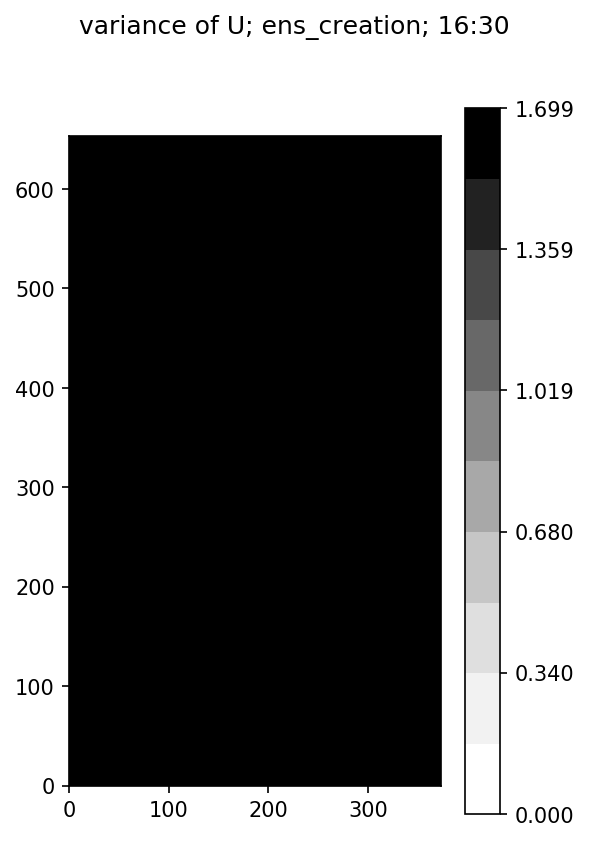

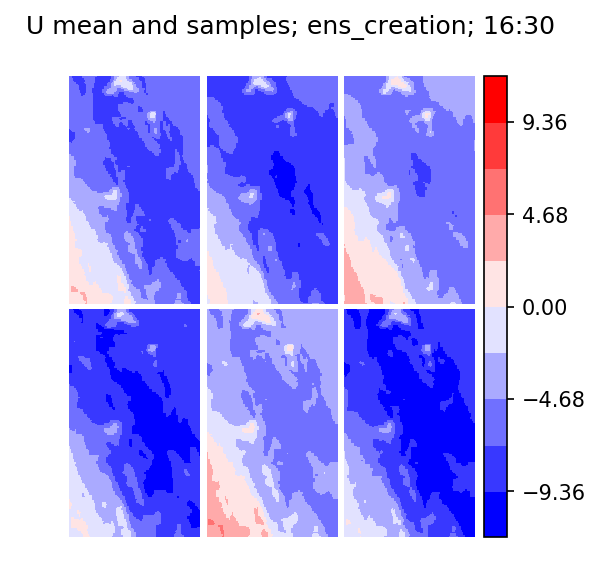

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


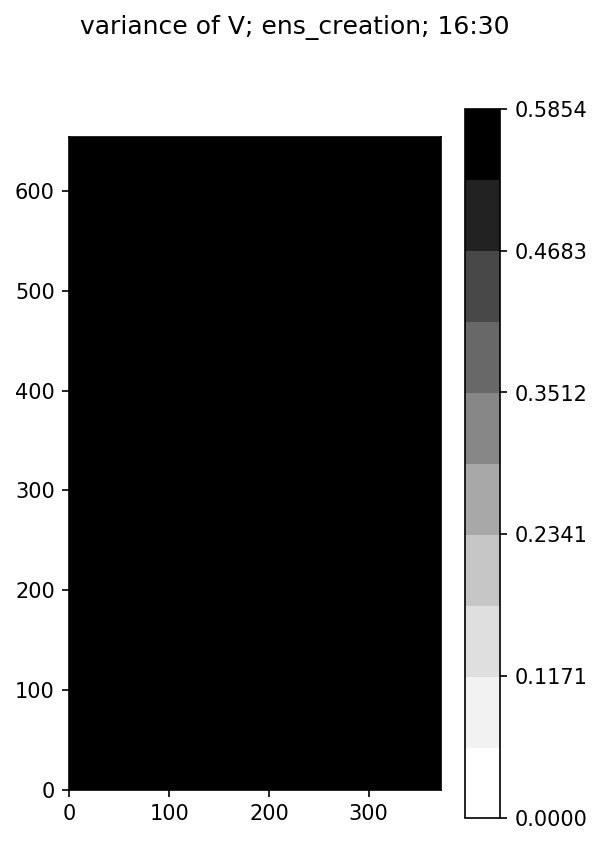

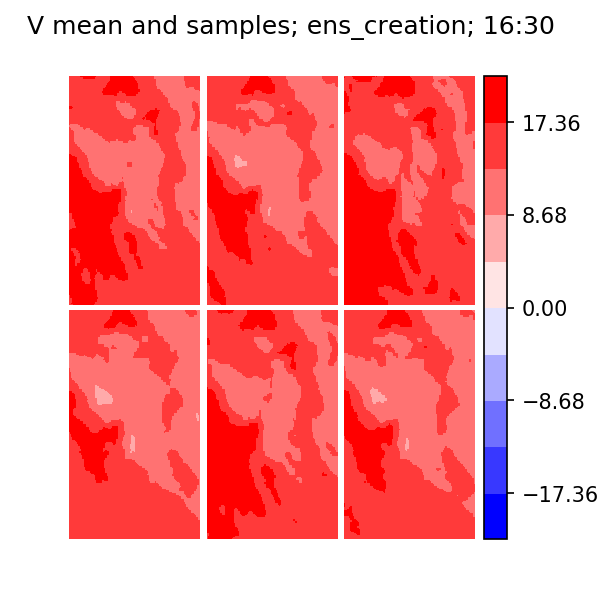

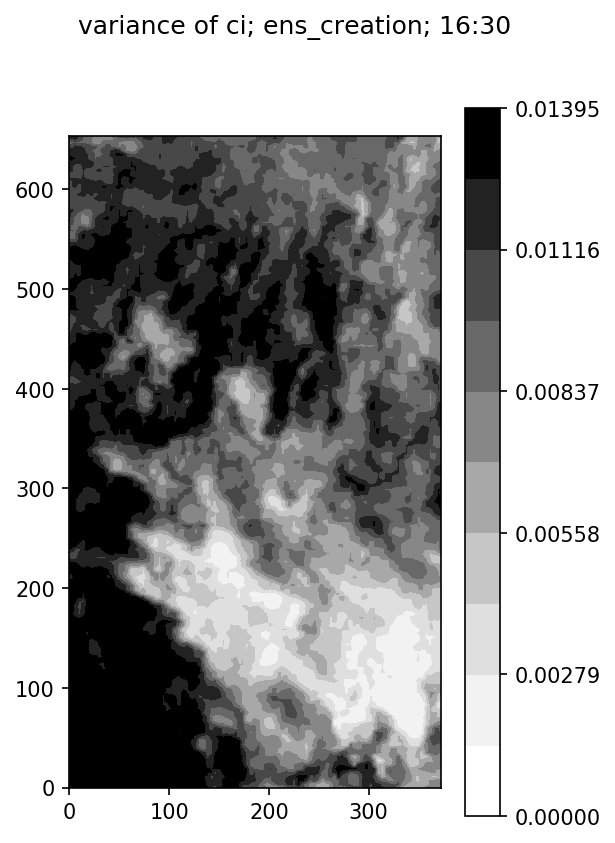

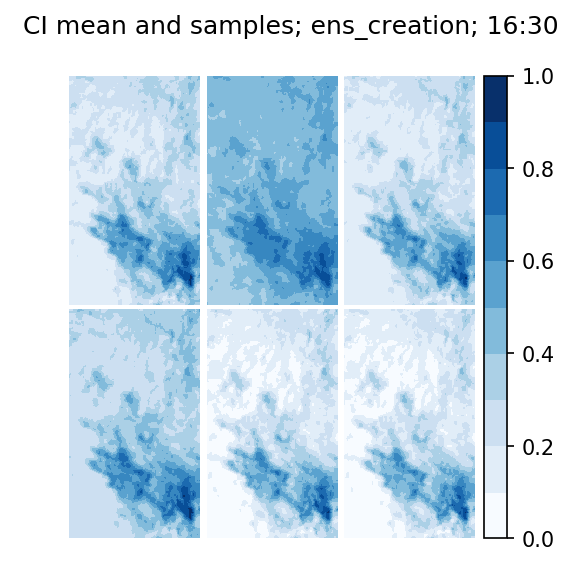

In [10]:
U_plots(ensemble, coords.sat_times[0], 'ens_creation')
V_plots(ensemble, coords.sat_times[0], 'ens_creation')
ci_plots(ensemble, coords.sat_times[0], 'ens_creation')

In [11]:
remove_div_flag = True                                                   
ensemble, remove_div_flag = lf.preprocess(                                  
    ensemble=ensemble, flags=flags,                                      
    remove_div_flag=remove_div_flag,                                     
    coords=coords, sys_vars=sys_vars)

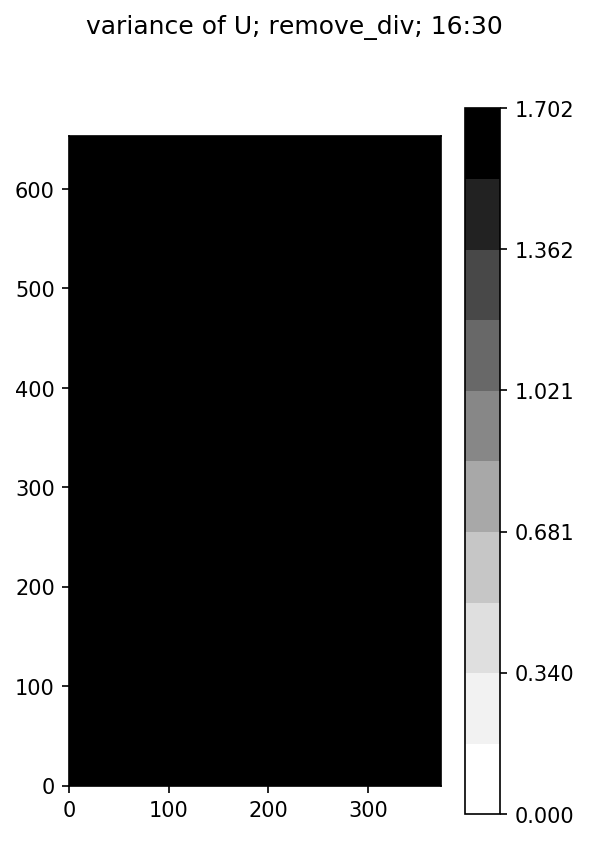

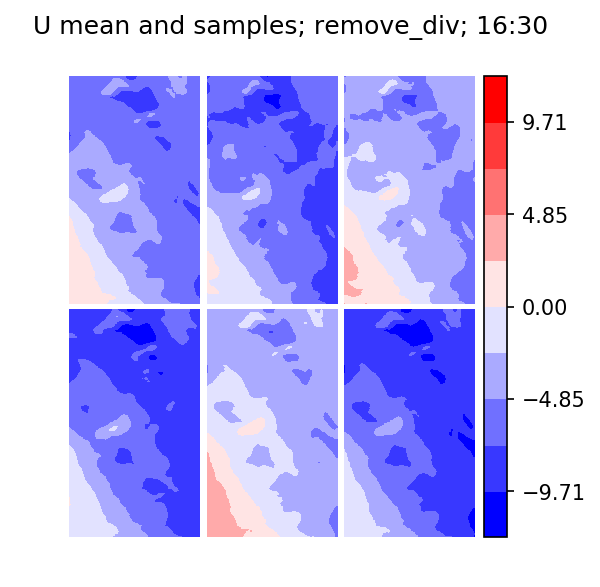

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


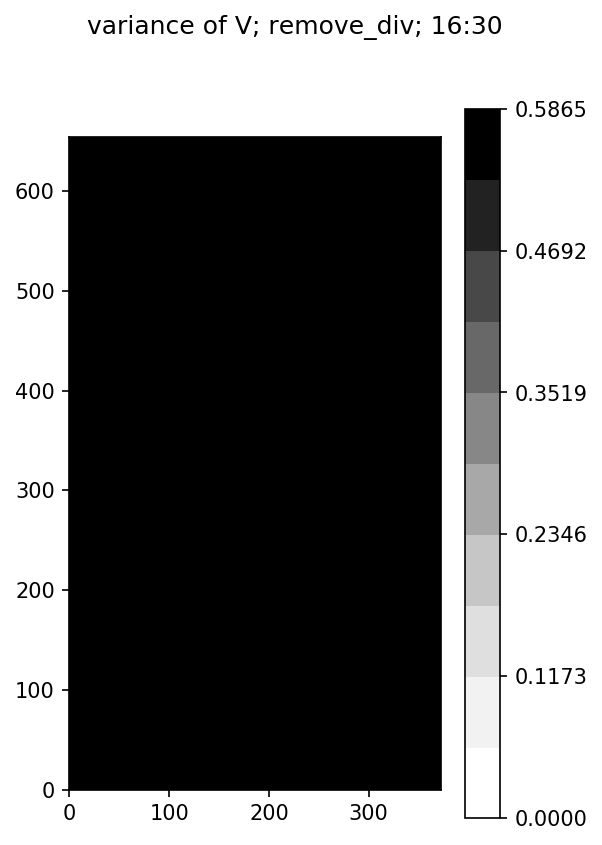

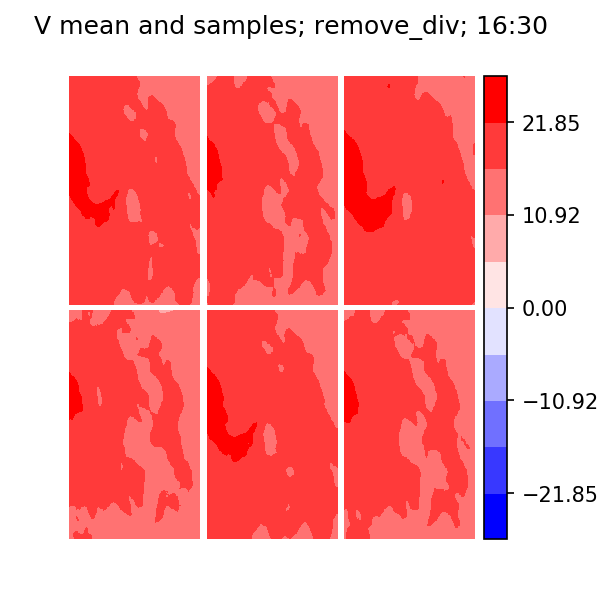

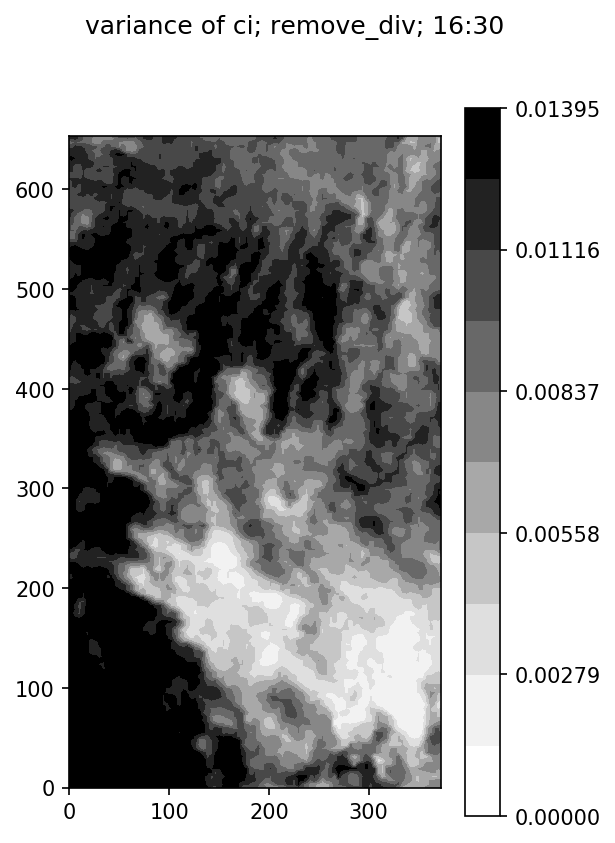

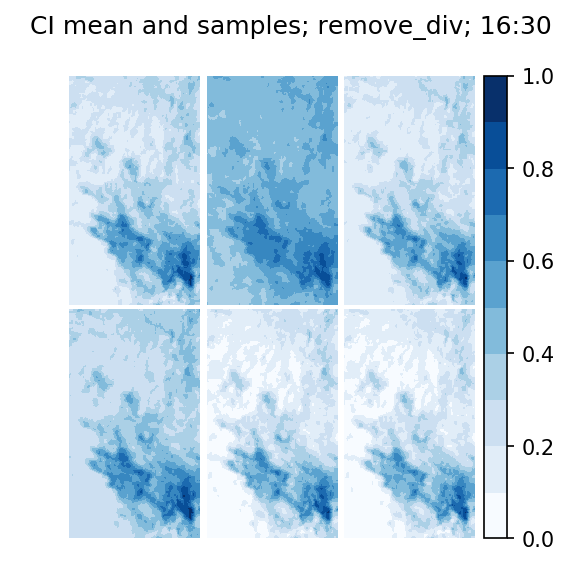

In [12]:
U_plots(ensemble, coords.sat_times[0], 'remove_div')
V_plots(ensemble, coords.sat_times[0], 'remove_div')
ci_plots(ensemble, coords.sat_times[0], 'remove_div')

In [13]:
time_index = 0                                                           
sat_time = coords.sat_times[time_index]                                  
ensemble_array, save_times, ensemble = lf.forecast(                         
    ensemble=ensemble, sat_time=sat_time,                                
    flags=flags, coords=coords, time_index=time_index,                   
    sys_vars=sys_vars,                                                   
    advect_params=advect_params, pert_params=pert_params,                
    assim_vars=assim_vars)

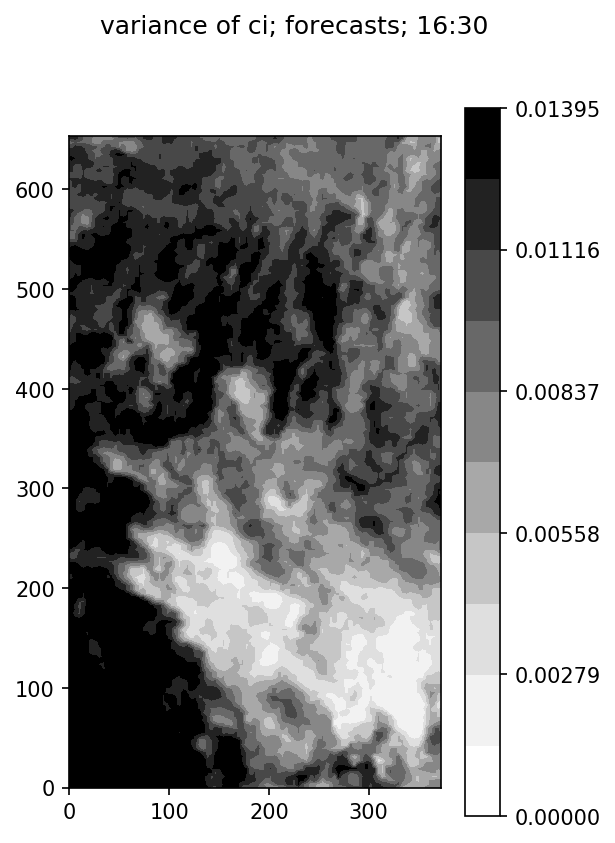

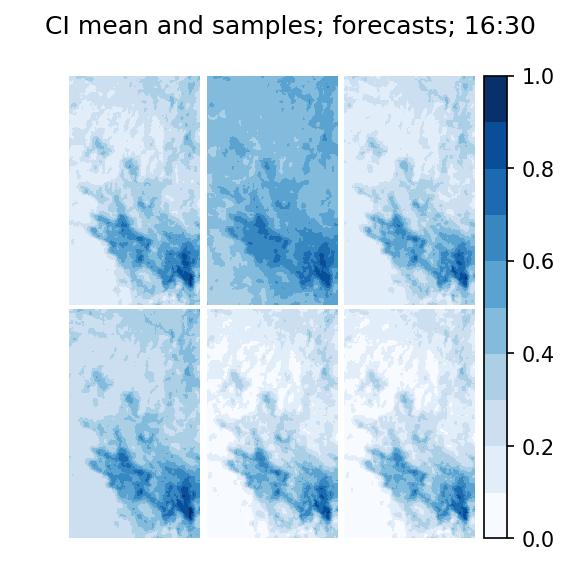

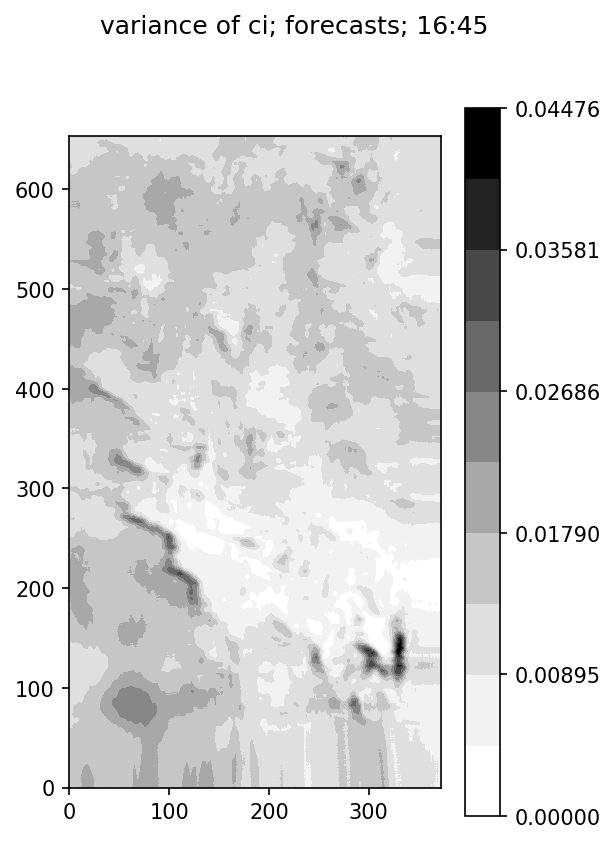

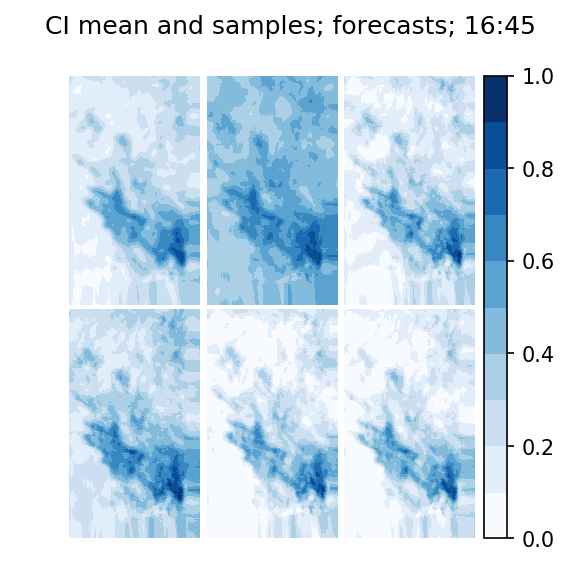

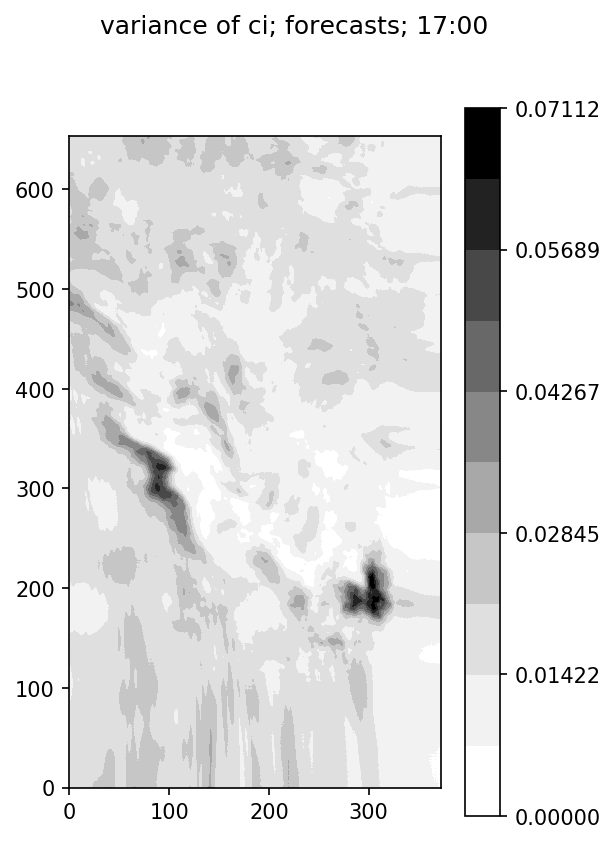

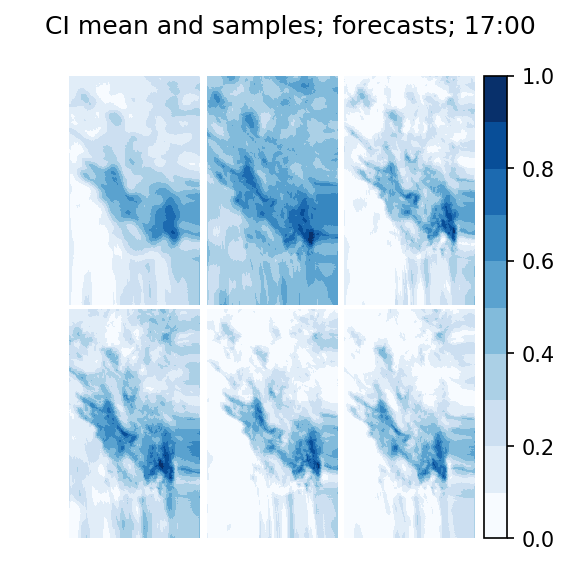

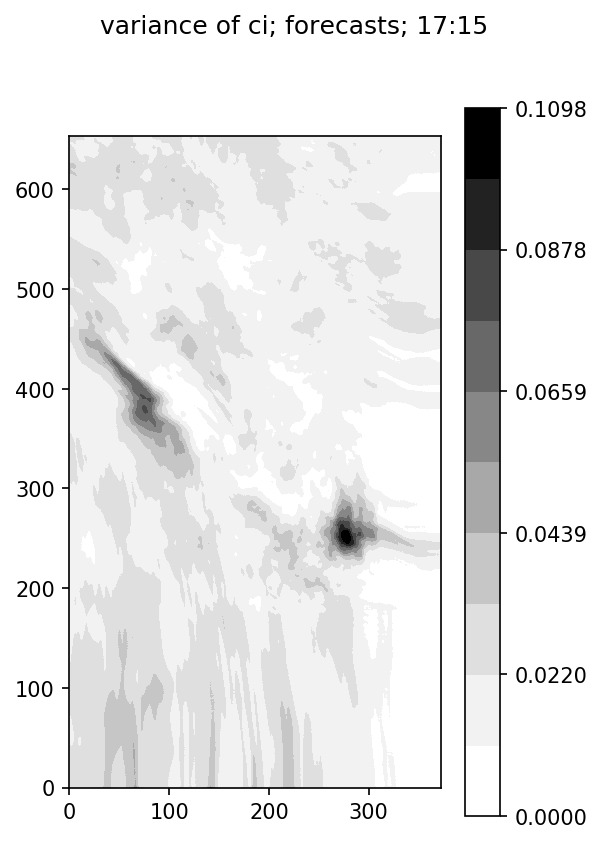

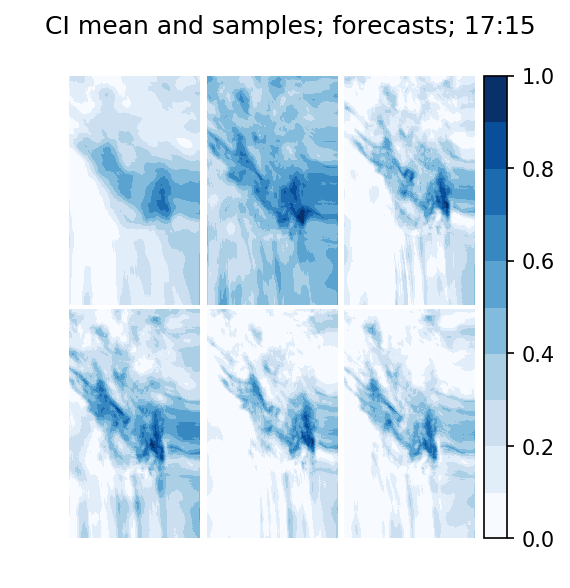

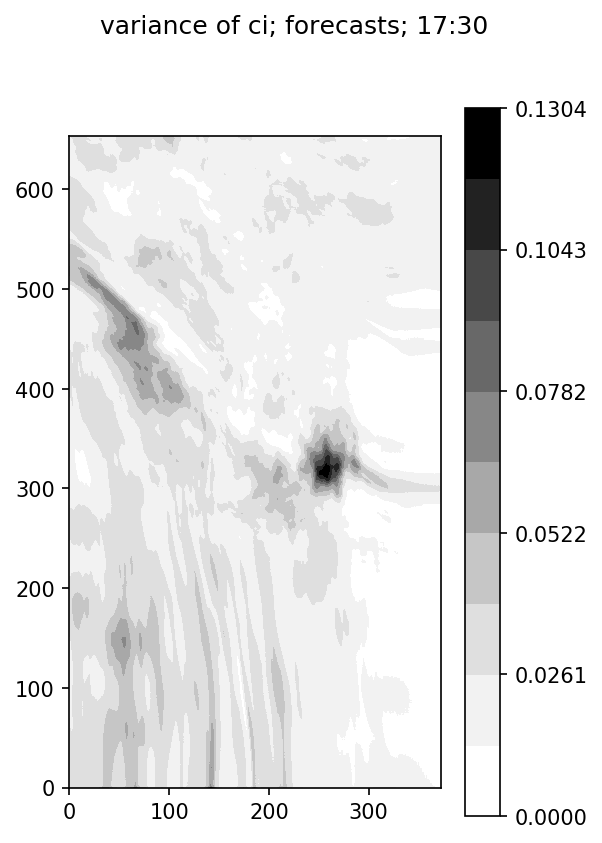

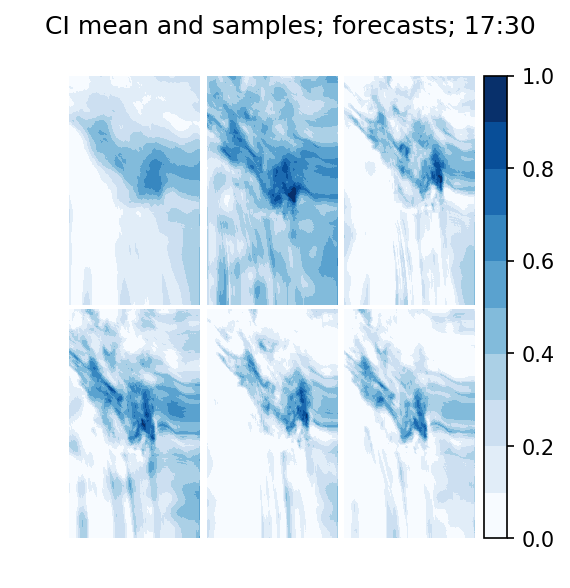

In [14]:
for ii in range(ensemble_array.shape[0]):
    ci_plots(ensemble_array[ii], save_times[ii], 'forecasts')

In [15]:
# lf.save(ensemble_array=ensemble_array, coords=coords,                       
#      ens_params=ens_params, param_dict=param_dict,                       
#      sys_vars=sys_vars, save_times=save_times,                           
#      results_file_path=results_file_path)

In [16]:
# for time_index in range(1, coords.sat_times.size):

In [17]:
time_index = 1
sat_time = coords.sat_times[time_index]                              
logging.info(str(sat_time))

In [18]:
ensemble = lf.maybe_assim_sat2sat(                                      
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    flags=flags)

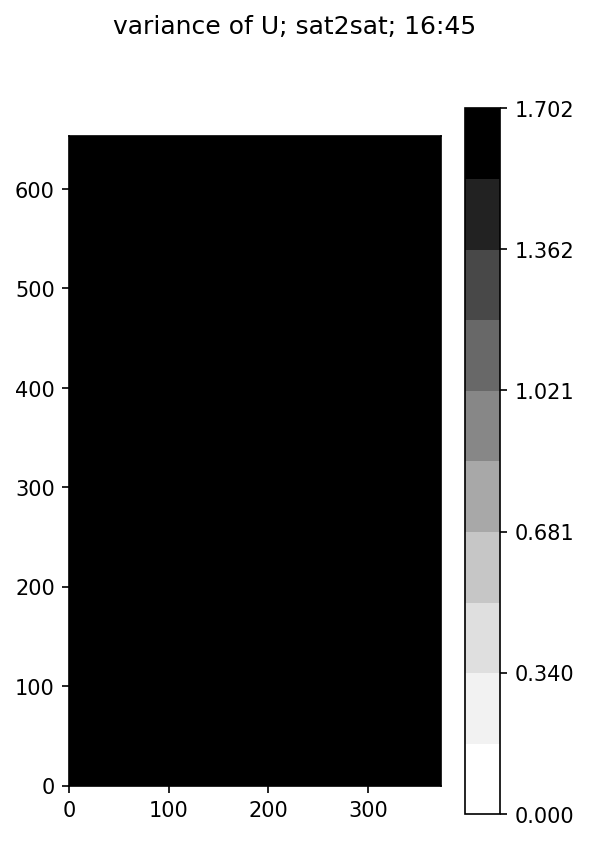

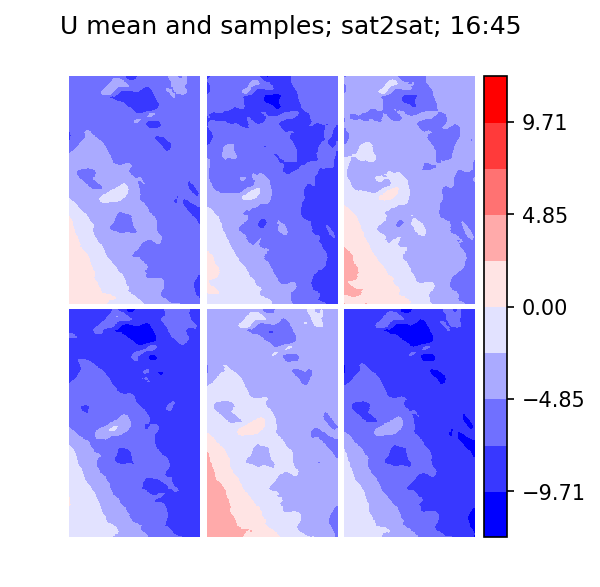

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


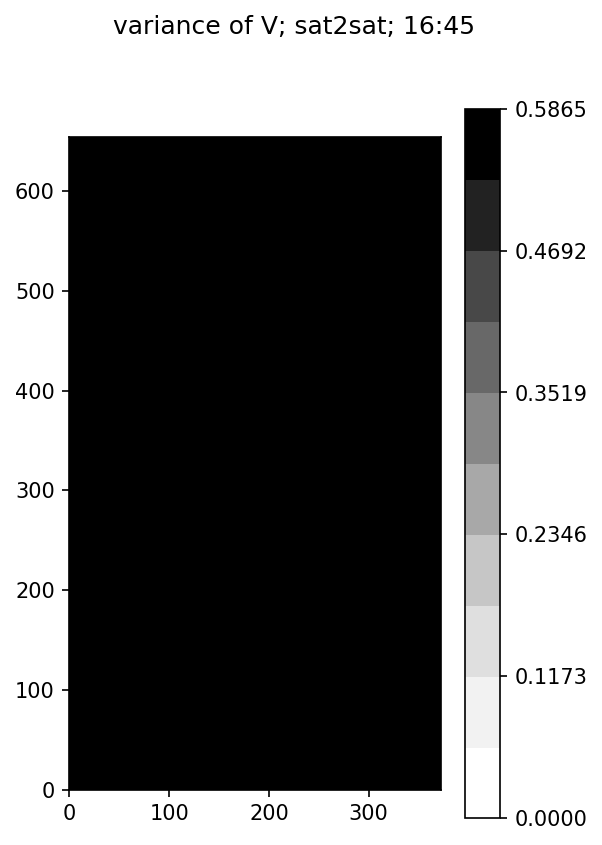

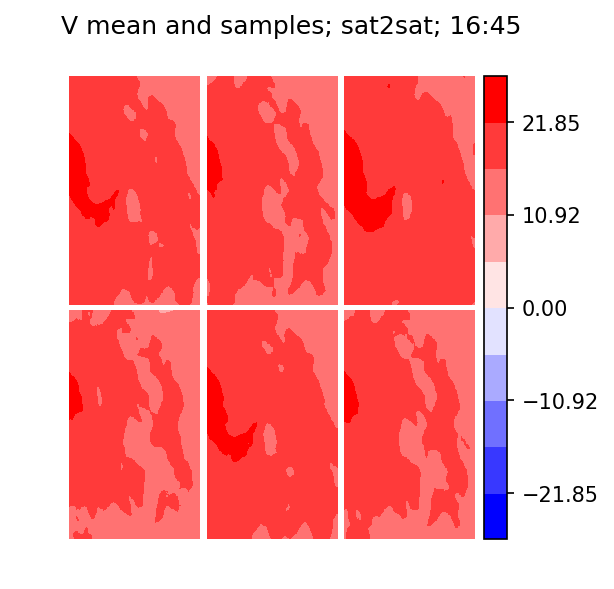

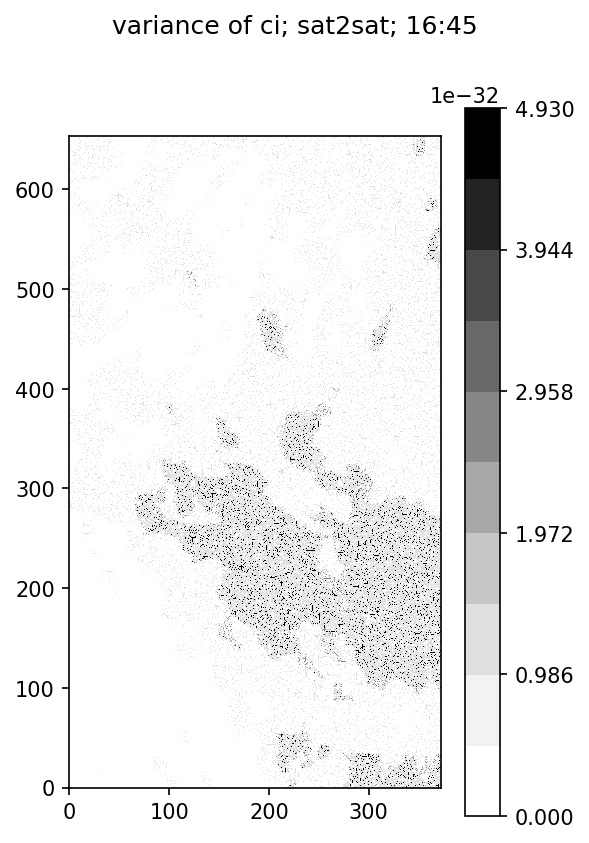

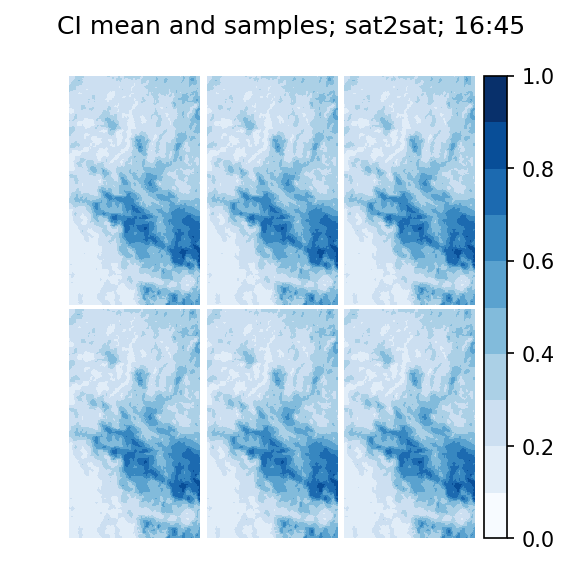

In [19]:
U_plots(ensemble, sat_time, 'sat2sat')
V_plots(ensemble, sat_time, 'sat2sat')
ci_plots(ensemble, sat_time, 'sat2sat')

In [20]:
ensemble, div_sat2wind_flag = lf.maybe_assim_sat2wind(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, sat2wind=sat2wind,                        
    flags=flags)

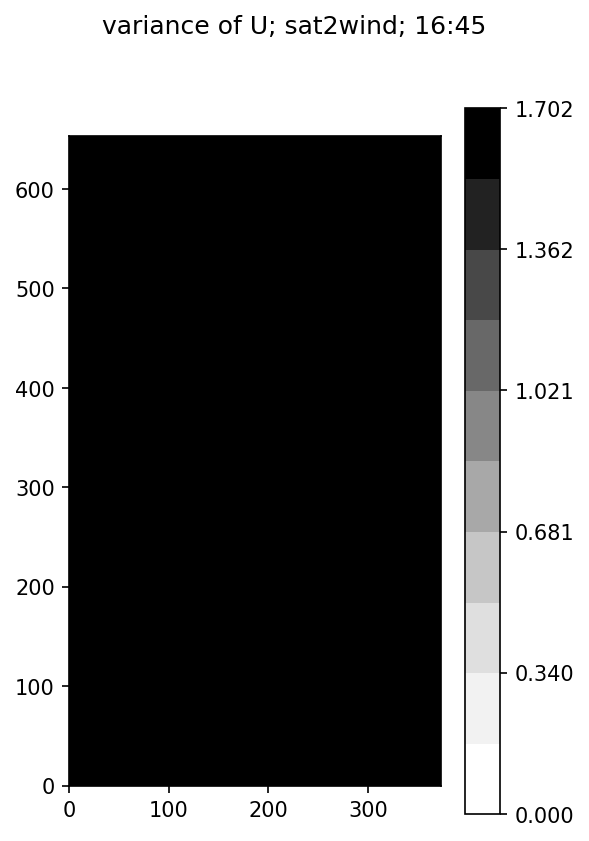

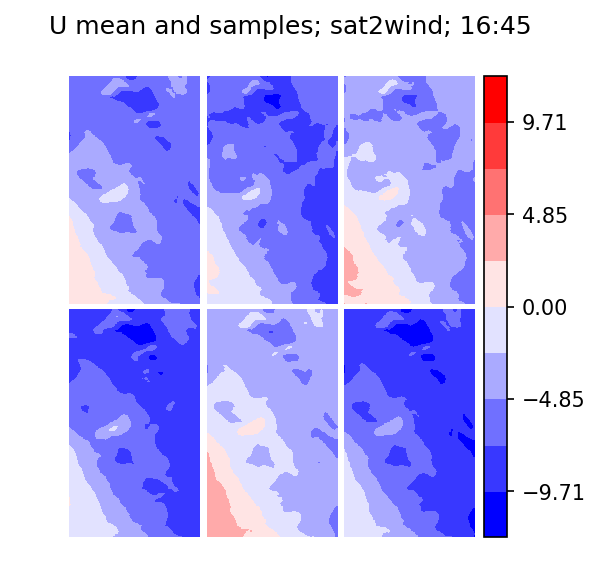

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


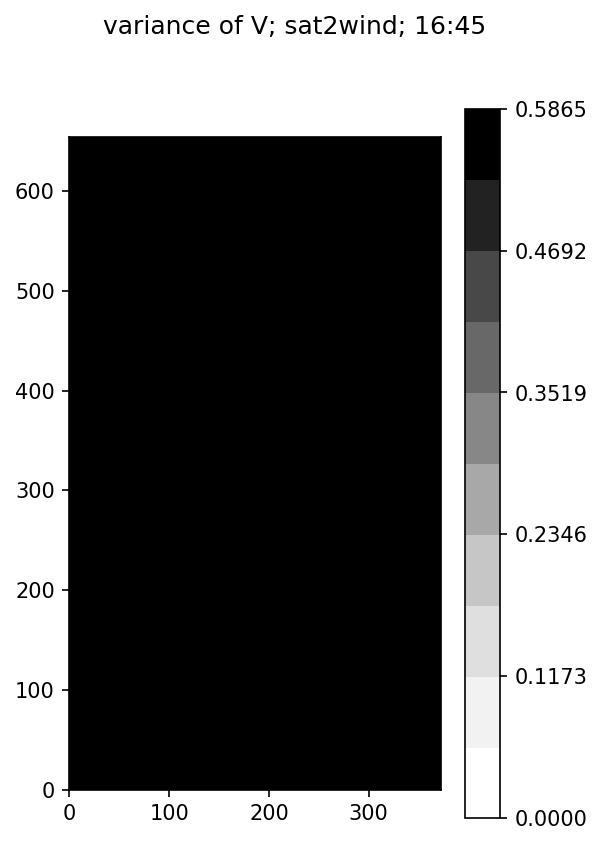

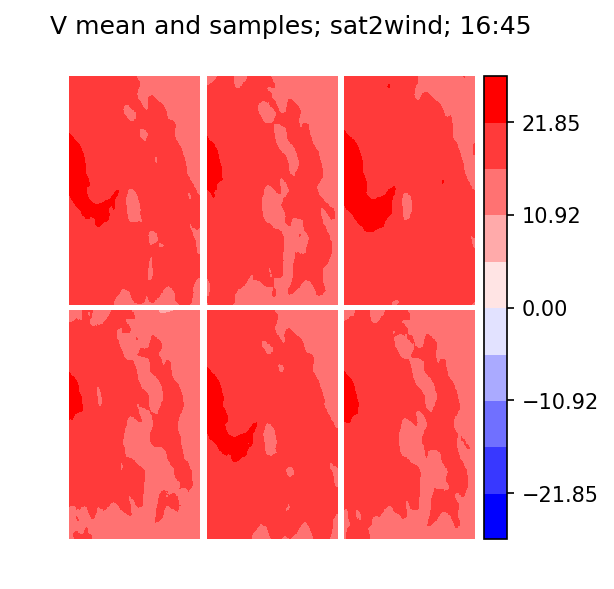

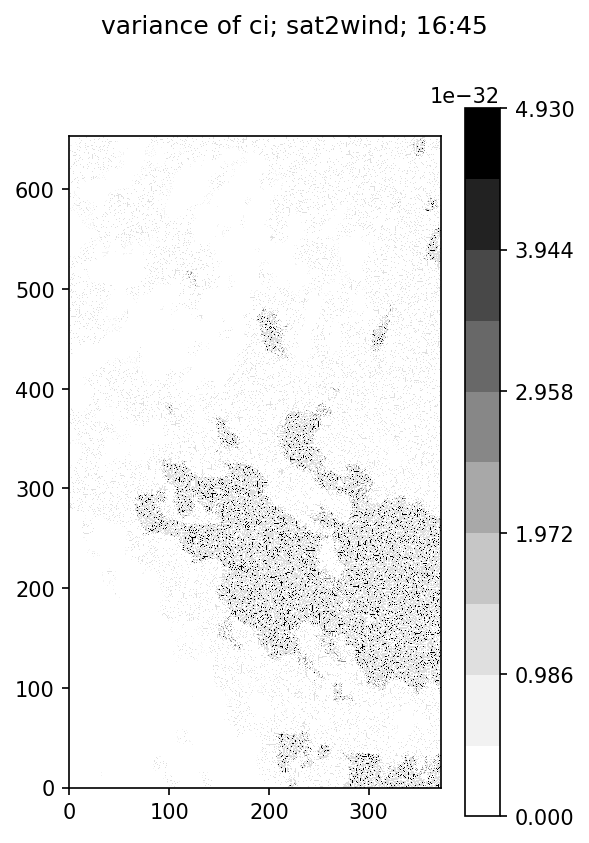

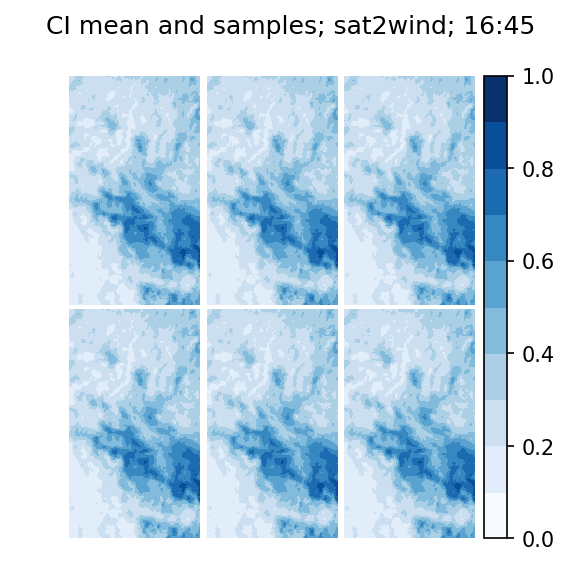

In [21]:
U_plots(ensemble, sat_time, 'sat2wind')
V_plots(ensemble, sat_time, 'sat2wind')
ci_plots(ensemble, sat_time, 'sat2wind')

In [22]:
ensemble, div_wrf_flag = lf.maybe_assim_wrf(                            
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, wrf=wrf,                                  
    ens_params=ens_params,                                           
    flags=flags)

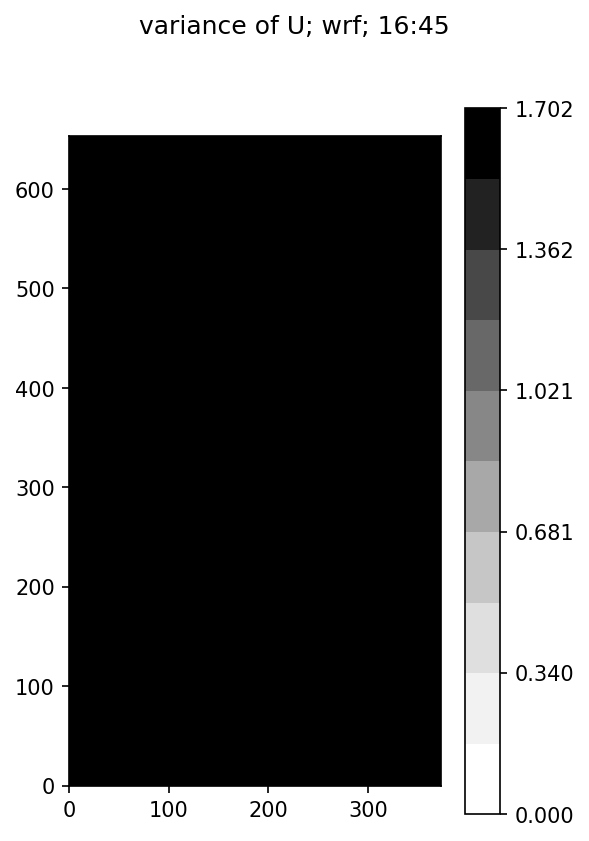

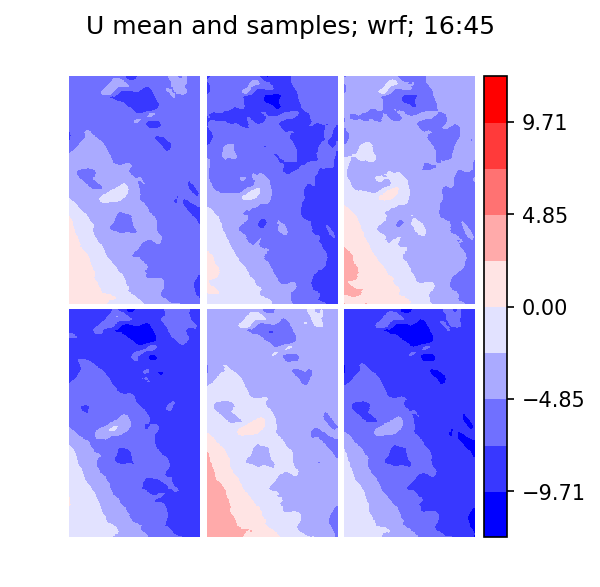

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


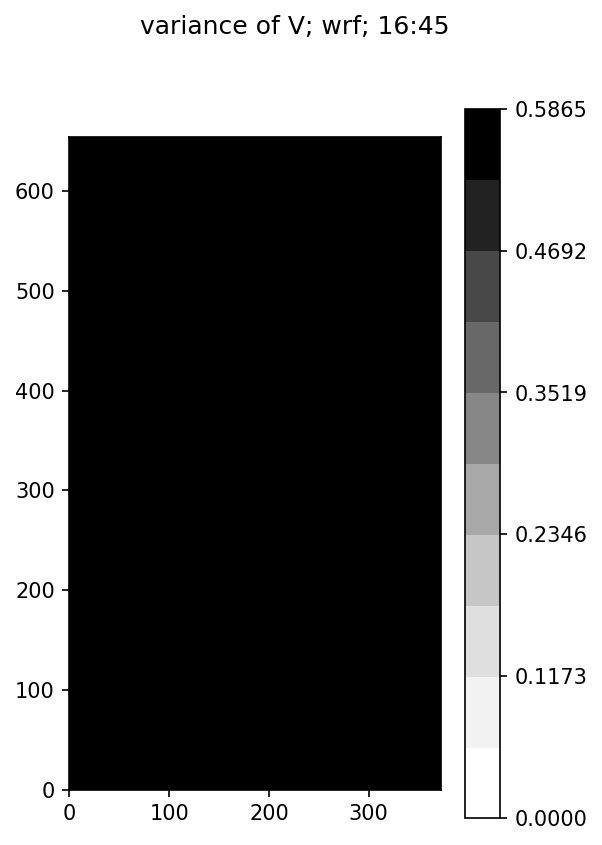

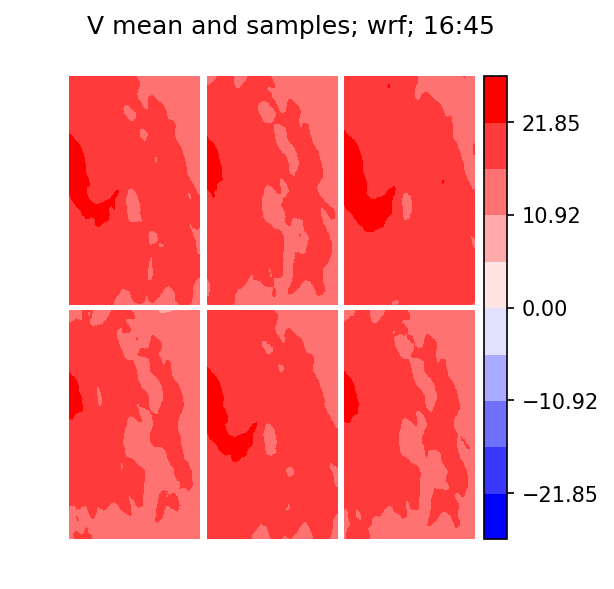

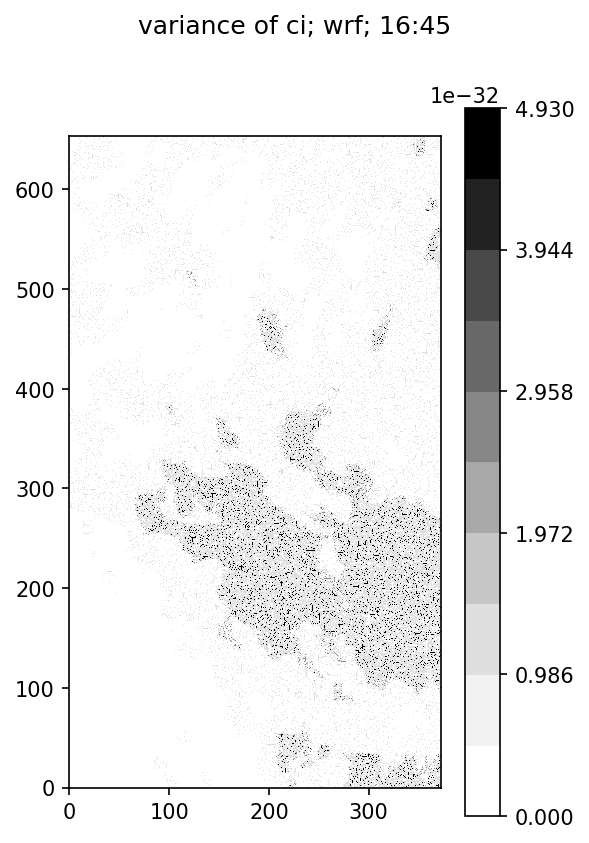

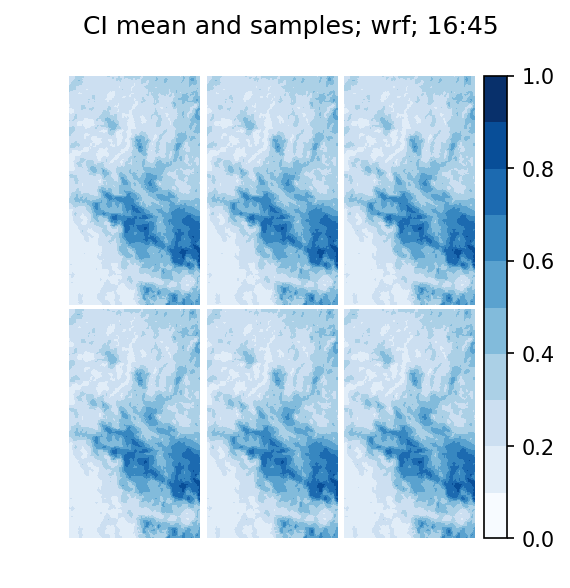

In [23]:
U_plots(ensemble, sat_time, 'wrf')
V_plots(ensemble, sat_time, 'wrf')
ci_plots(ensemble, sat_time, 'wrf')

In [24]:
ensemble_no_opt_flow = ensemble.copy()
returned = lf.maybe_assim_opt_flow(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, time_index=time_index,                        
    coords=coords, sys_vars=sys_vars,                                
    flags=flags, opt_flow=opt_flow)
ensemble, div_opt_flow_flag = returned[:2]
u_opt_flow, v_opt_flow = returned[2:4]
u_flat_pos, v_flat_pos = returned[4:6]

In [25]:
importlib.reload(tp)

<module 'letkf_forecasting.tmh_plot' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/tmh_plot.py'>

(<matplotlib.figure.Figure at 0x7fe78defa748>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe78e04cf60>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7fe79dfb9cc0>], dtype=object))

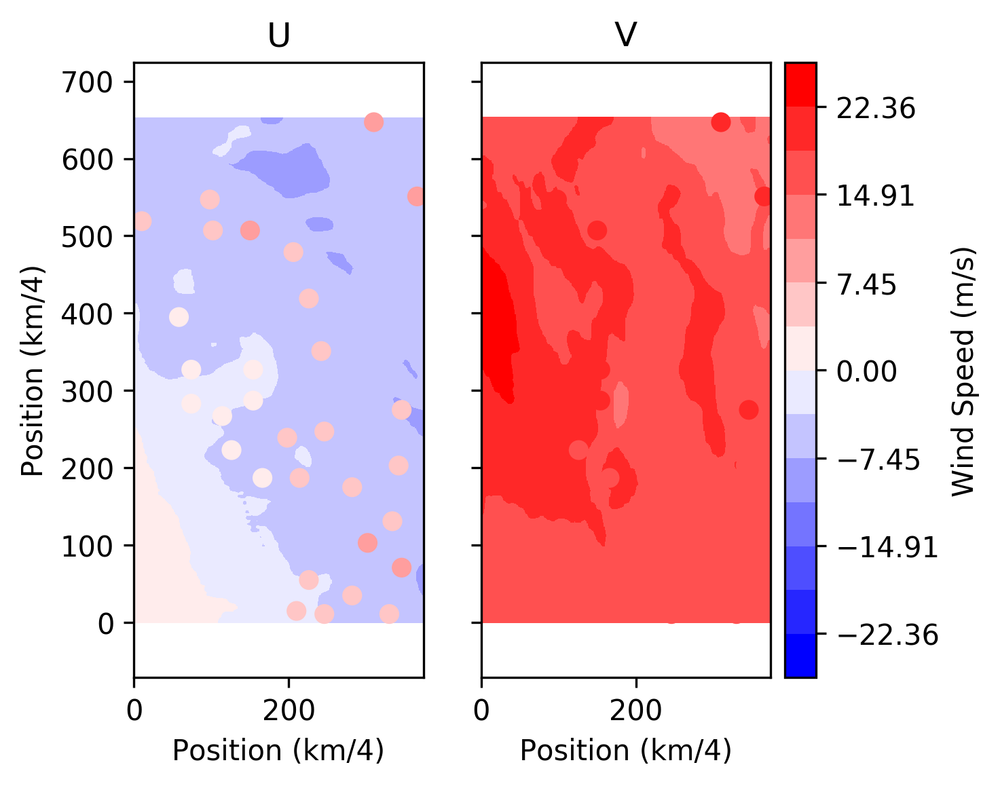

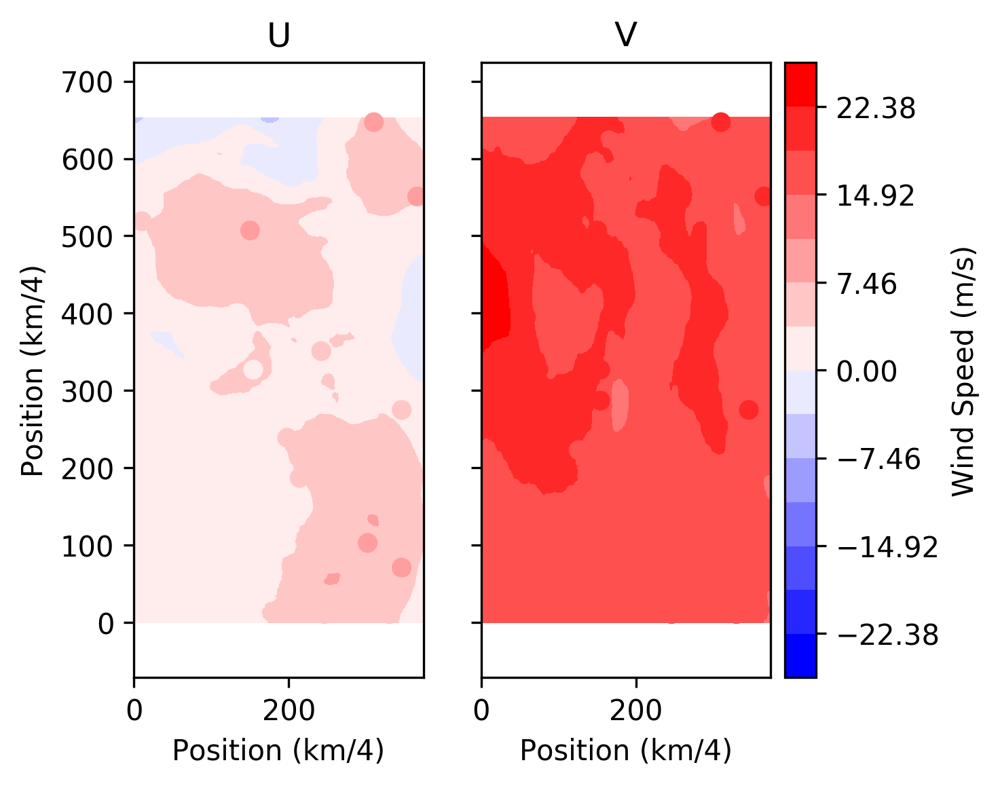

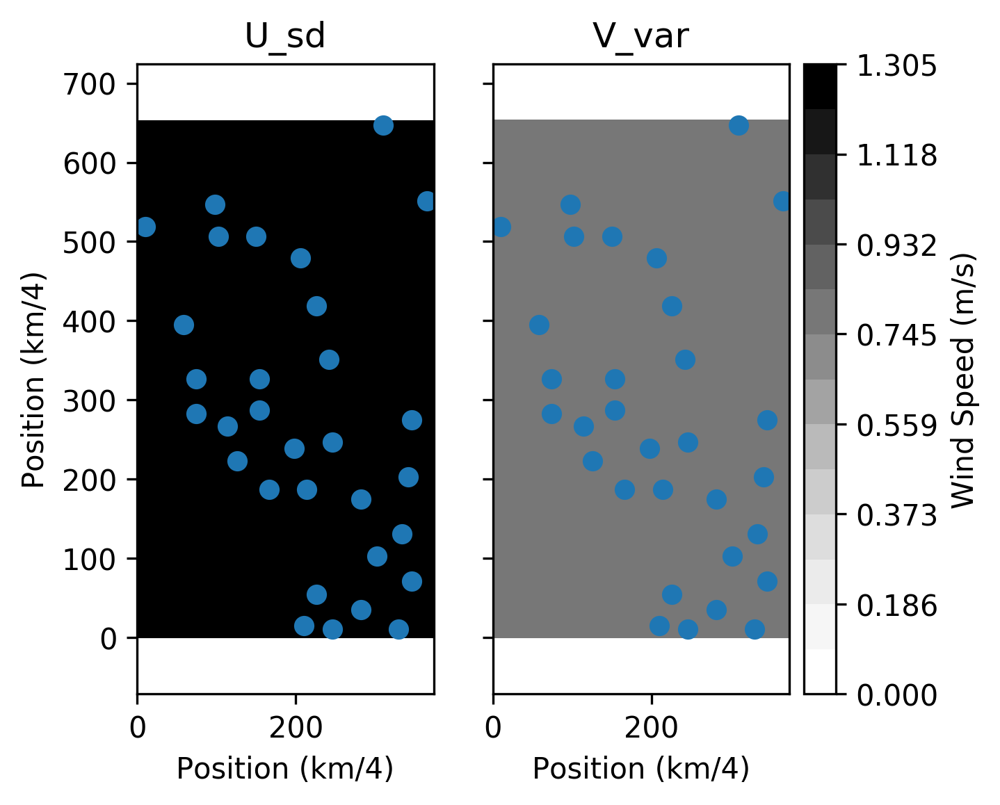

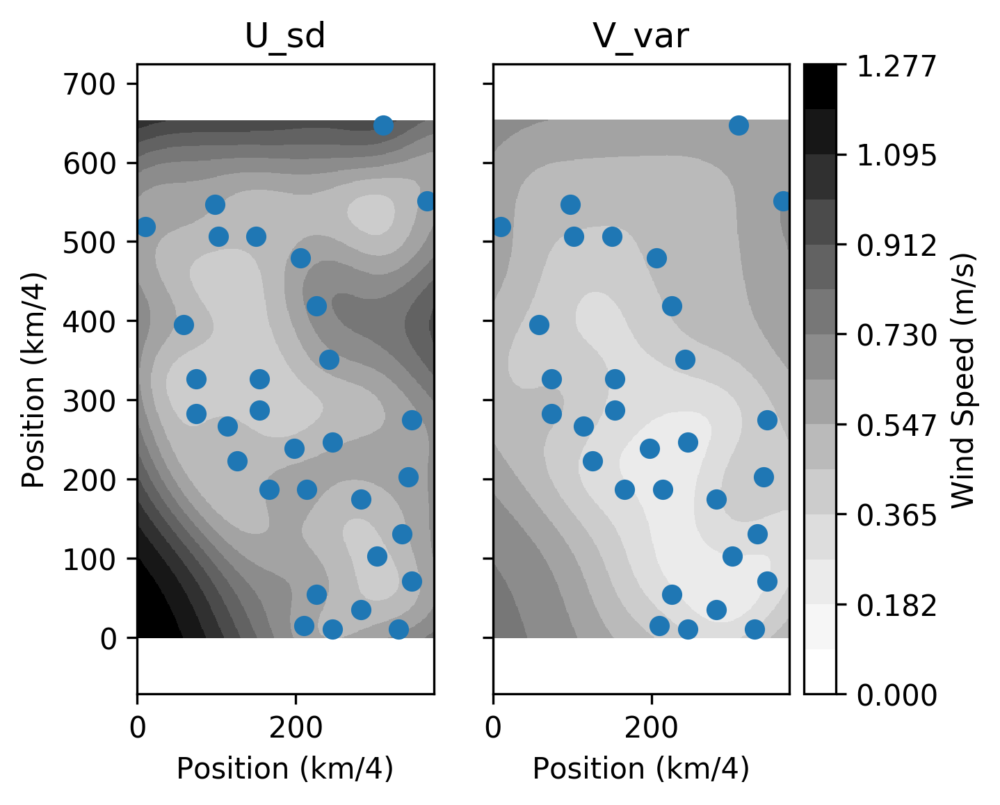

In [27]:
pos = np.array(np.unravel_index(u_flat_pos, sys_vars.U_crop_shape))
tp.wrf_opt_flow_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.wrf_opt_flow_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)

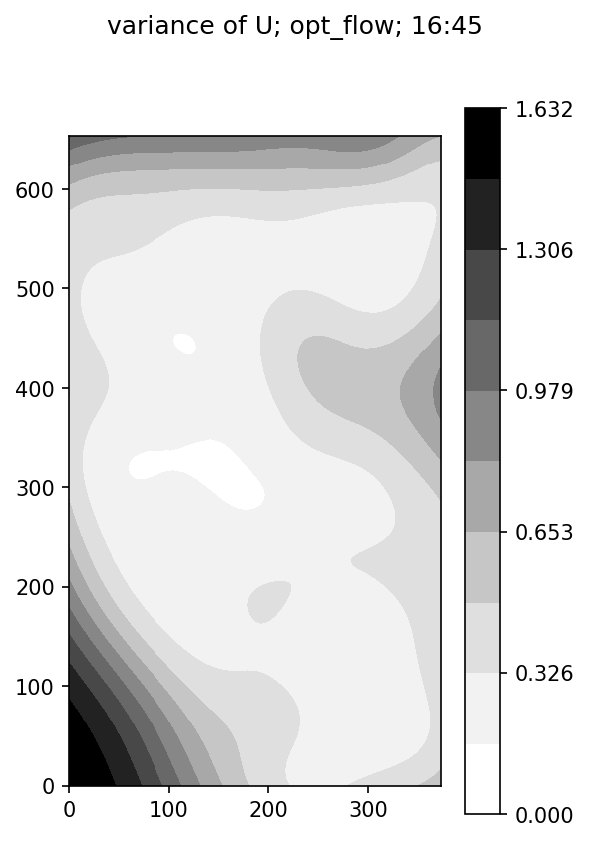

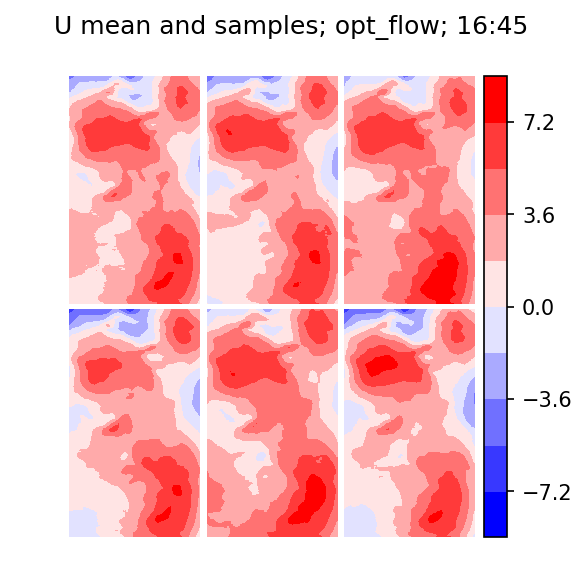

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


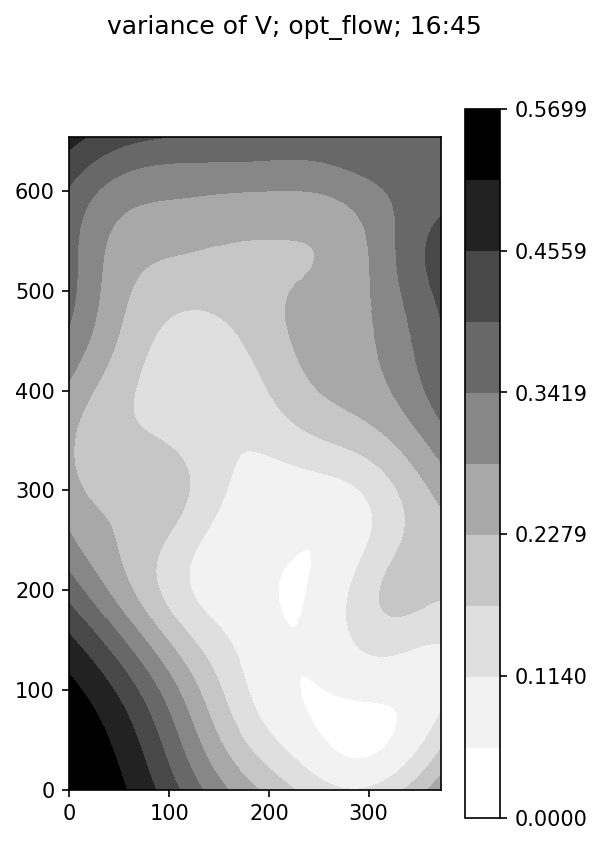

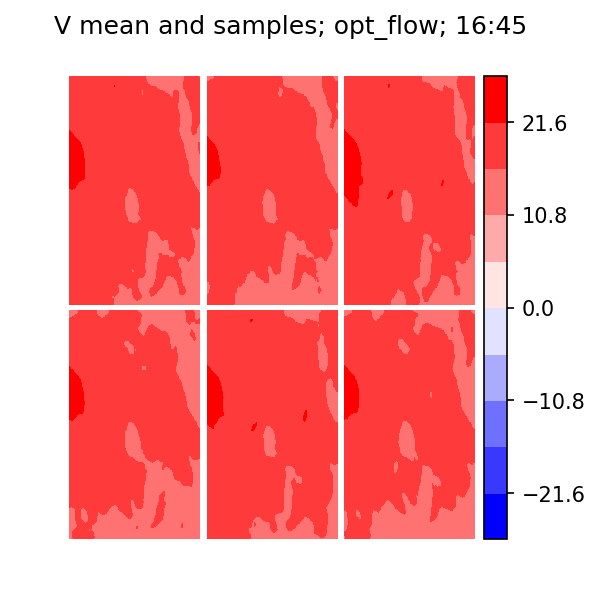

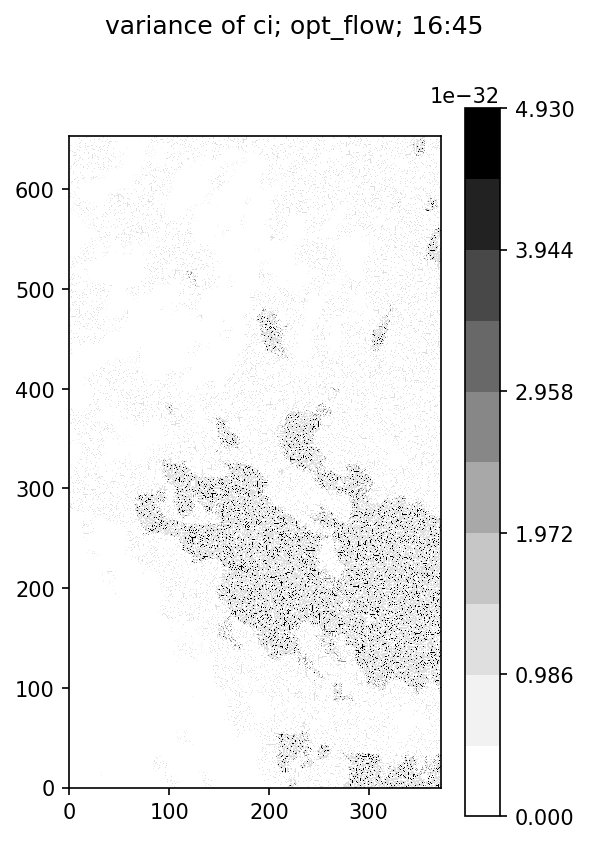

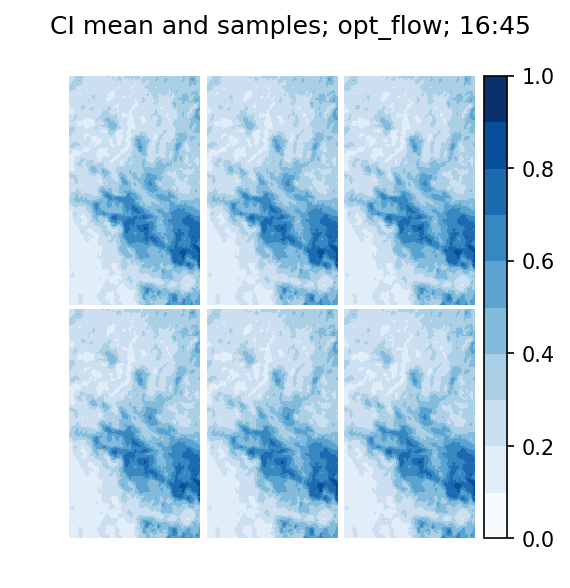

In [29]:
U_plots(ensemble, sat_time, 'opt_flow')
V_plots(ensemble, sat_time, 'opt_flow')
ci_plots(ensemble, sat_time, 'opt_flow')

In [30]:
remove_div_flag = (div_sat2wind_flag                                 
                   or div_wrf_flag                                   
                   or div_opt_flow_flag)                             
ensemble, remove_div_flag = lf.preprocess(                              
    ensemble=ensemble, flags=flags,                                  
    remove_div_flag=remove_div_flag,                                 
    coords=coords, sys_vars=sys_vars)

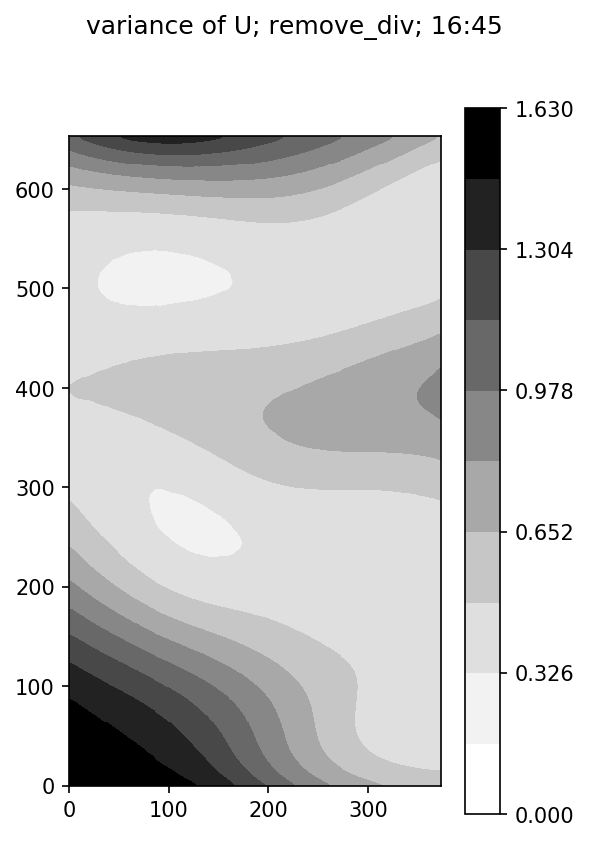

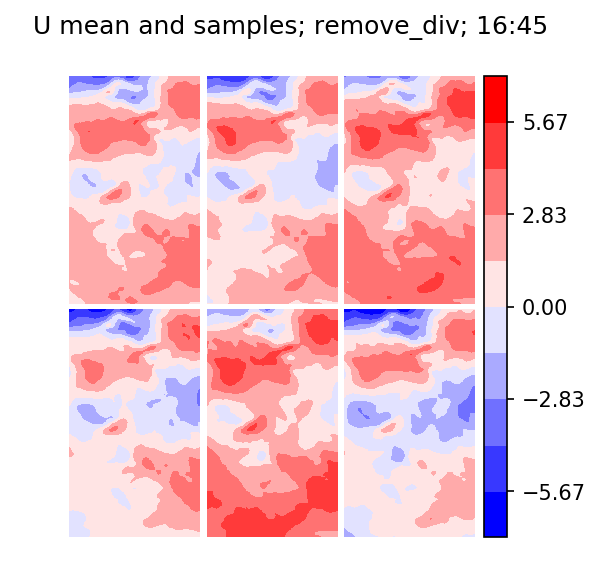

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


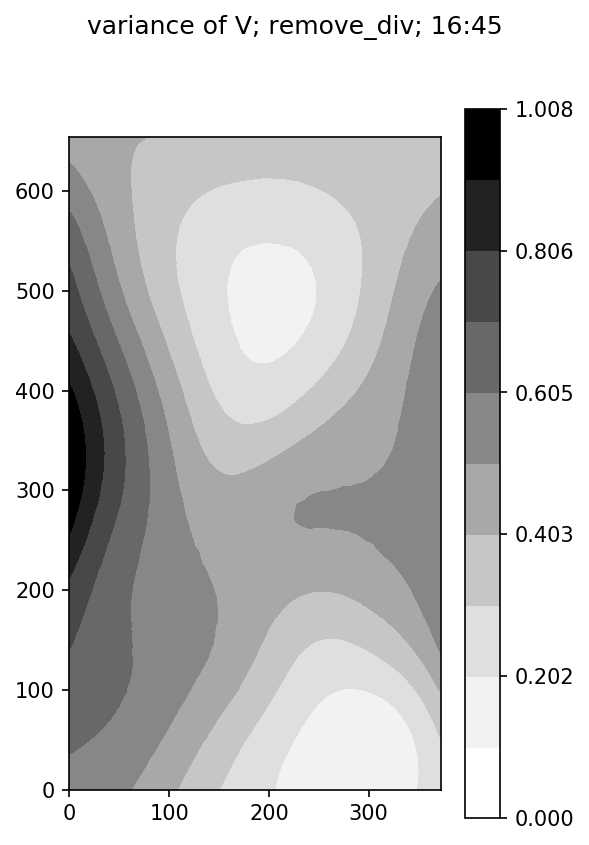

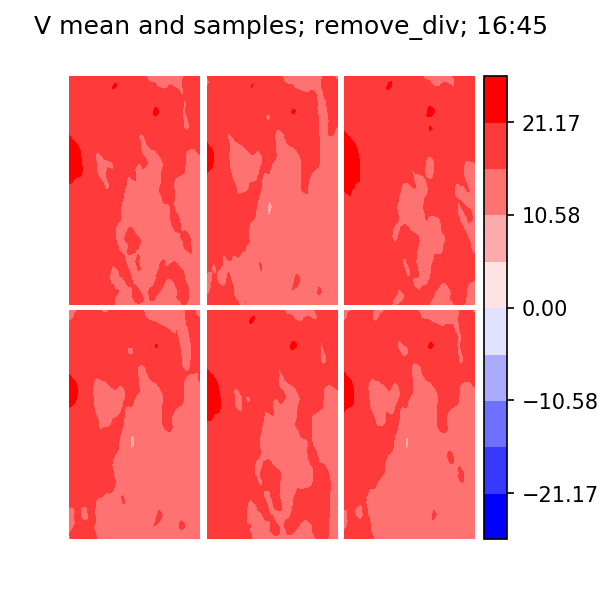

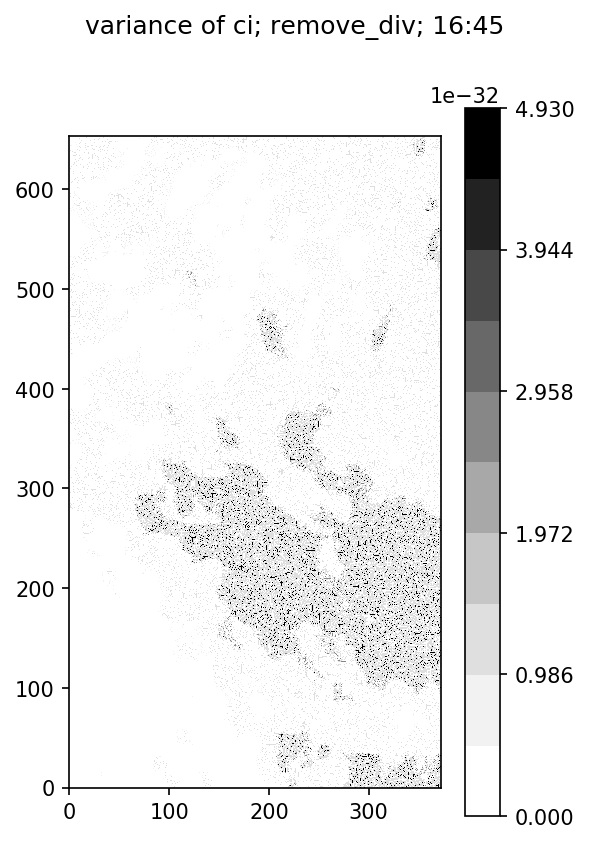

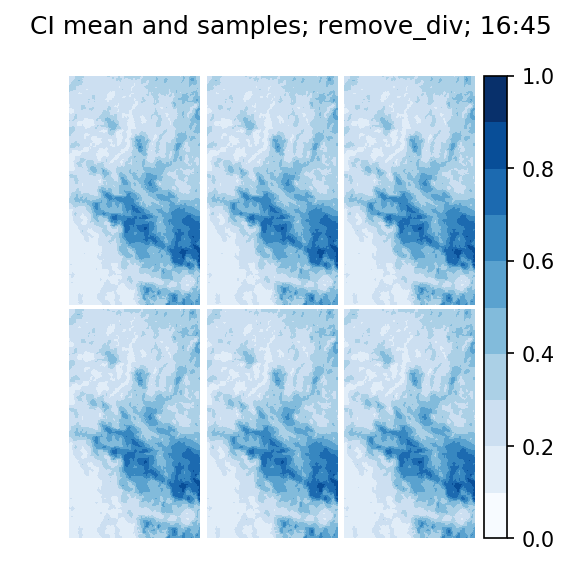

In [31]:
U_plots(ensemble, sat_time, 'remove_div')
V_plots(ensemble, sat_time, 'remove_div')
ci_plots(ensemble, sat_time, 'remove_div')

In [32]:
ensemble_array, save_times, ensemble = lf.forecast(                     
    ensemble=ensemble, sat_time=sat_time,                            
    flags=flags, coords=coords, time_index=time_index,               
    sys_vars=sys_vars,                                               
    advect_params=advect_params, pert_params=pert_params,            
    assim_vars=assim_vars)

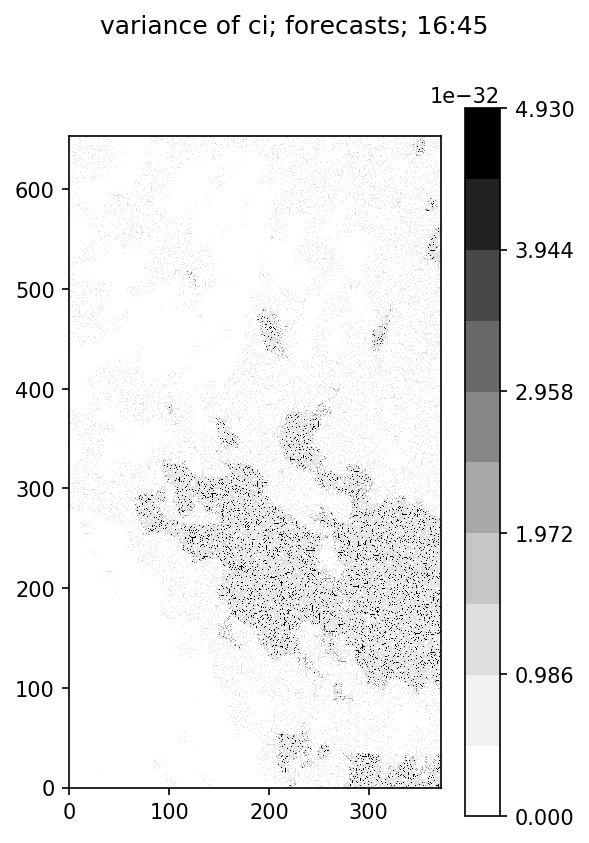

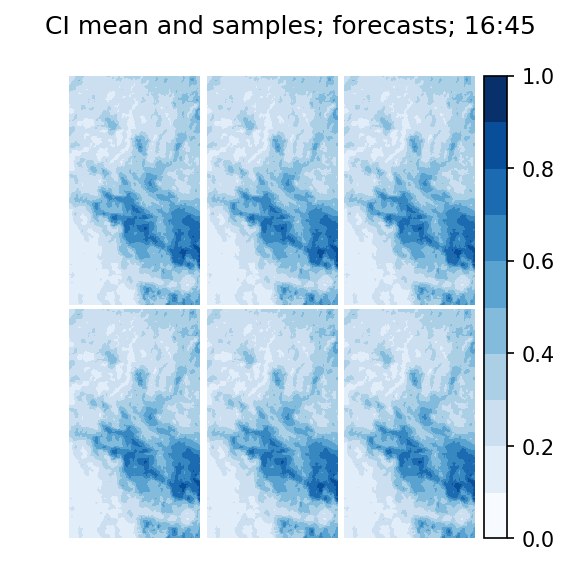

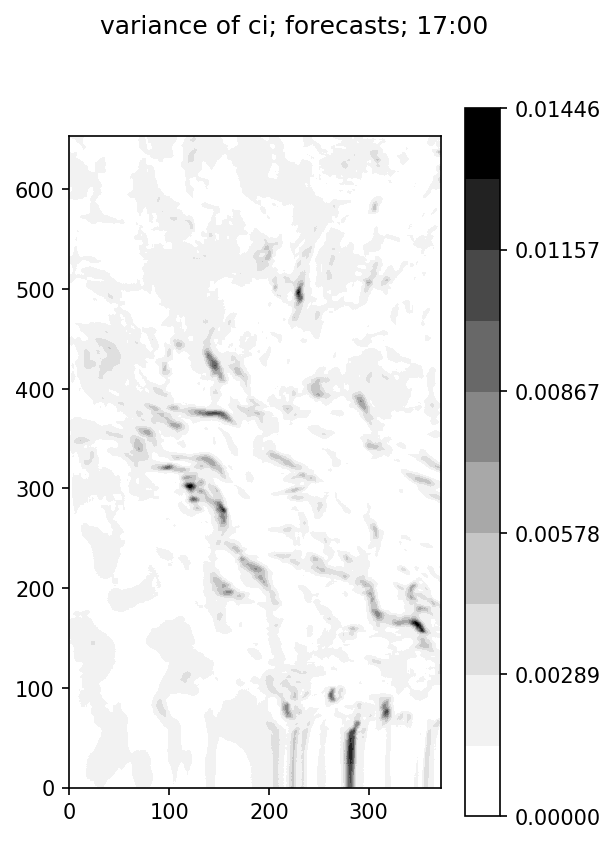

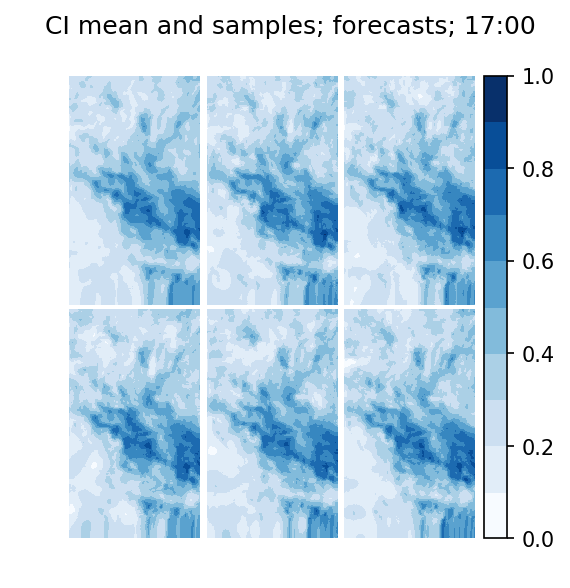

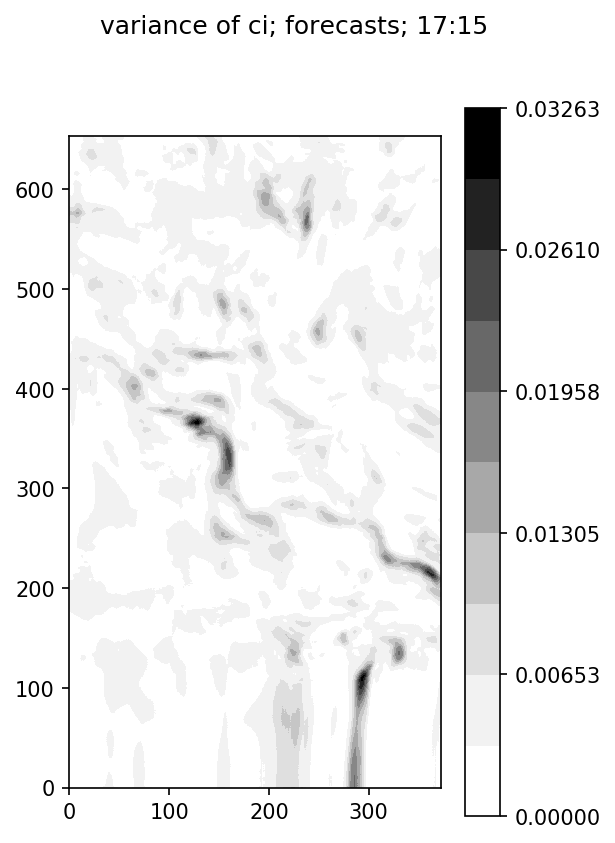

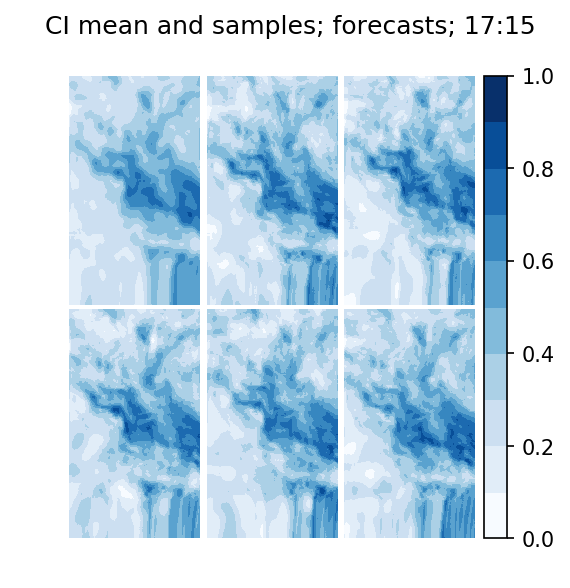

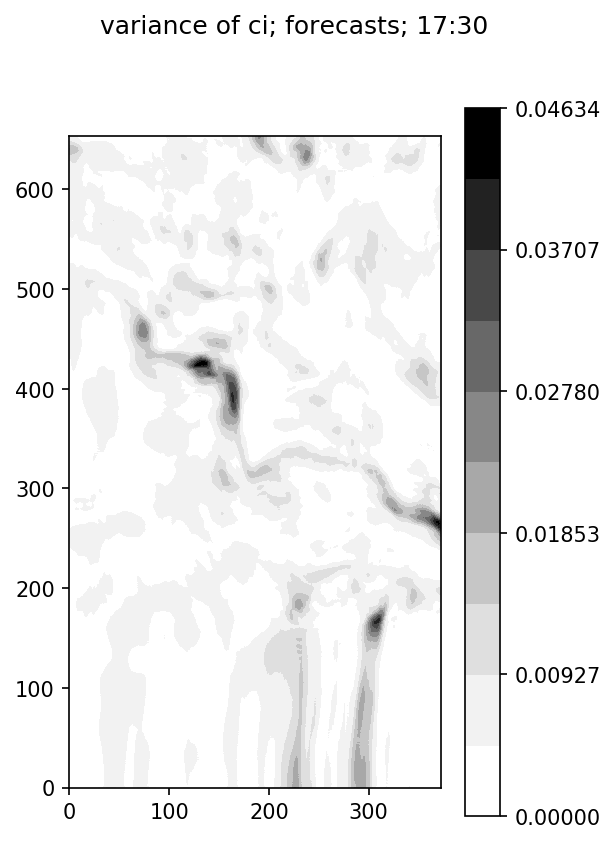

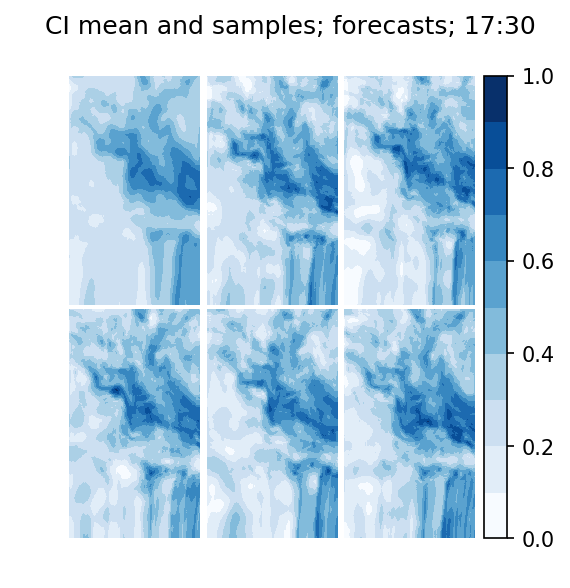

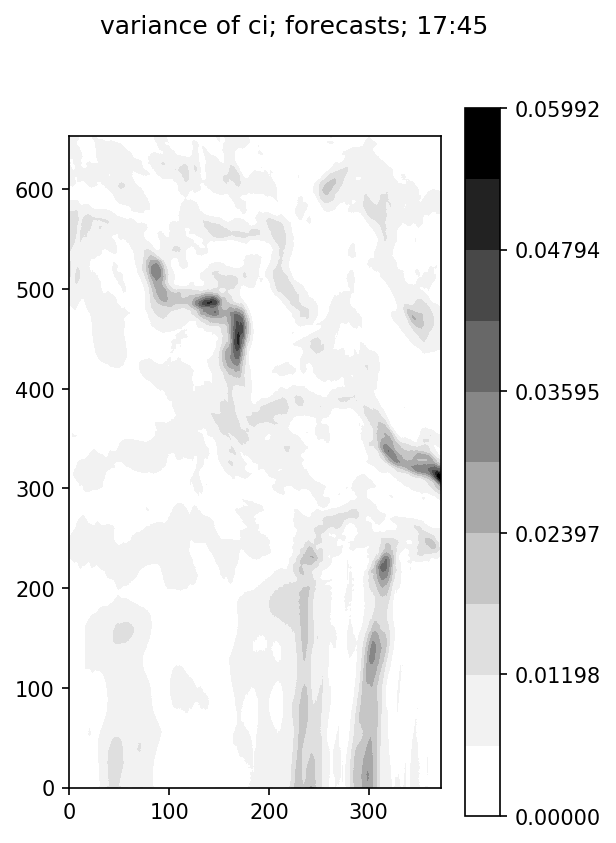

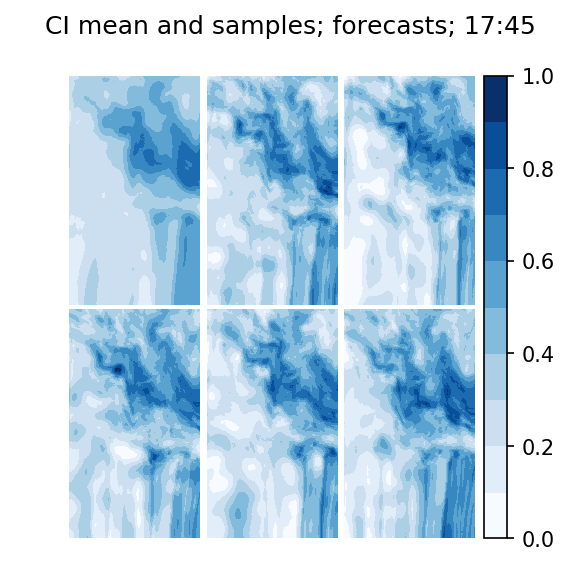

In [33]:
for ii in range(ensemble_array.shape[0]):
    ci_plots(ensemble_array[ii], save_times[ii], 'forecasts')

In [34]:
# lf.save(ensemble_array=ensemble_array, coords=coords,                   
#      ens_params=ens_params, param_dict=param_dict,                   
#      sys_vars=sys_vars, save_times=save_times,                       
#      results_file_path=results_file_path)

In [35]:
time_index = 2
sat_time = coords.sat_times[time_index]                              
logging.info(str(sat_time))

In [36]:
ensemble = lf.maybe_assim_sat2sat(                                      
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    flags=flags)

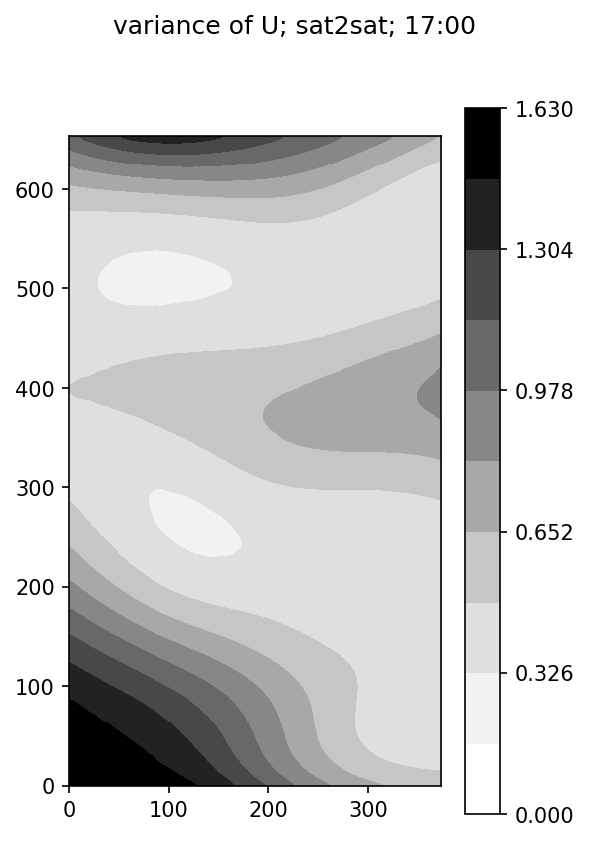

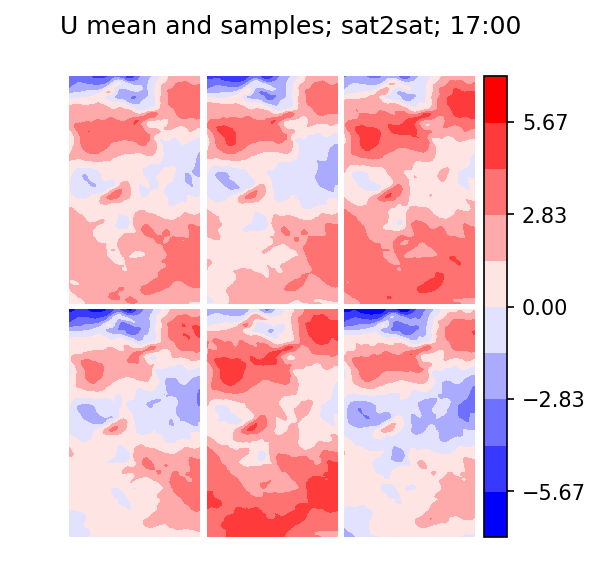

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


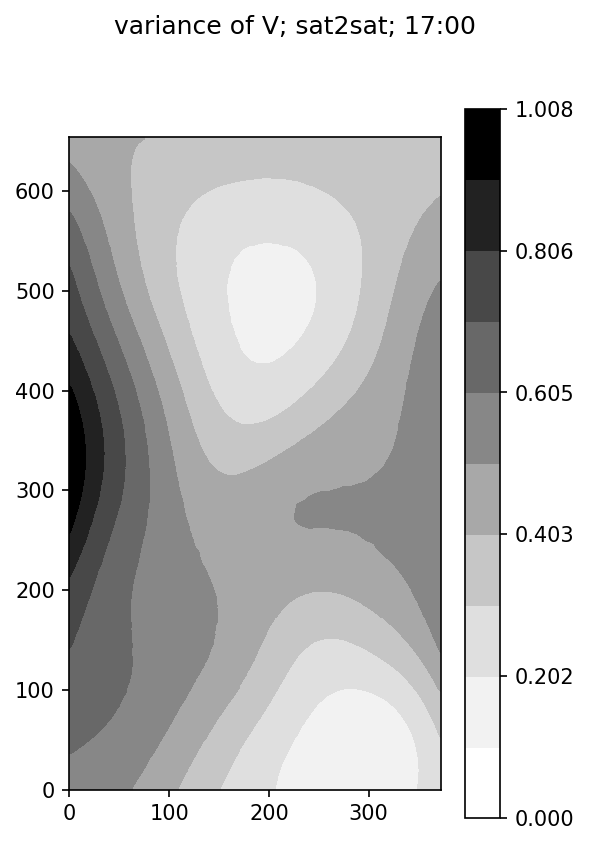

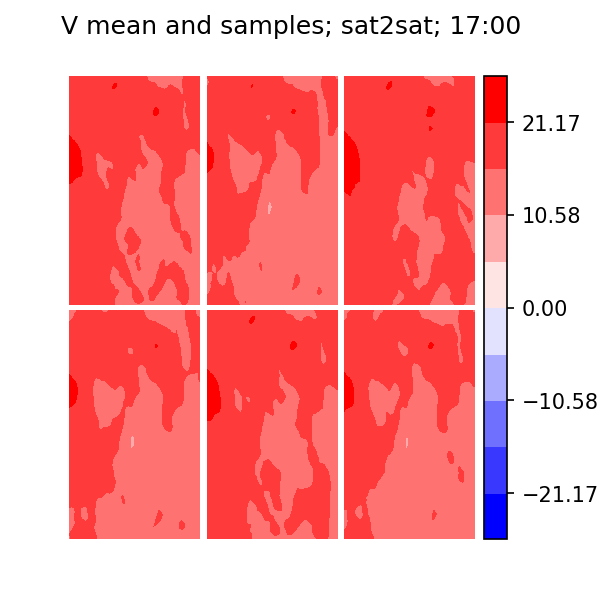

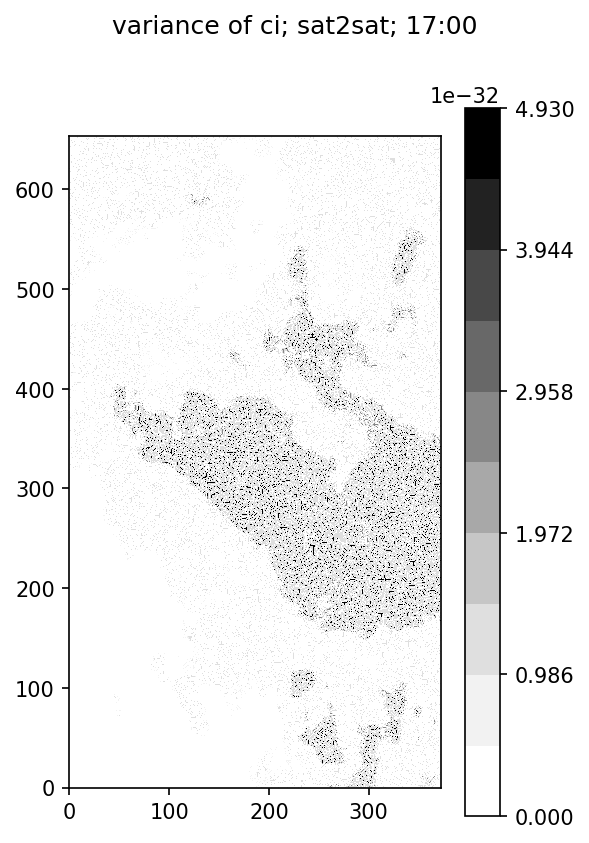

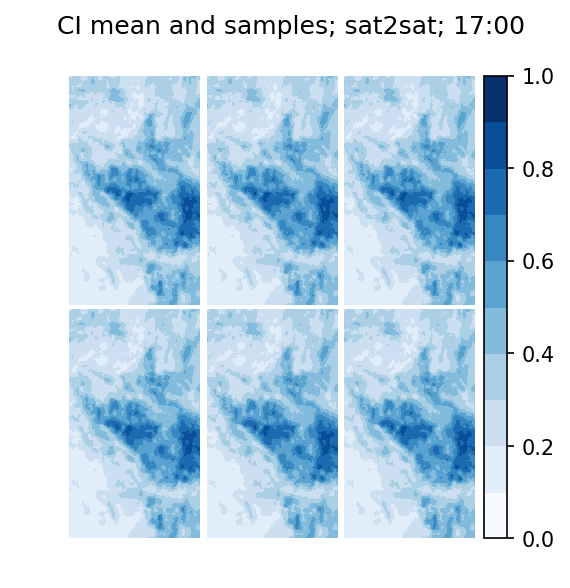

In [37]:
U_plots(ensemble, sat_time, 'sat2sat')
V_plots(ensemble, sat_time, 'sat2sat')
ci_plots(ensemble, sat_time, 'sat2sat')

In [38]:
ensemble, div_sat2wind_flag = lf.maybe_assim_sat2wind(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, sat2wind=sat2wind,                        
    flags=flags)

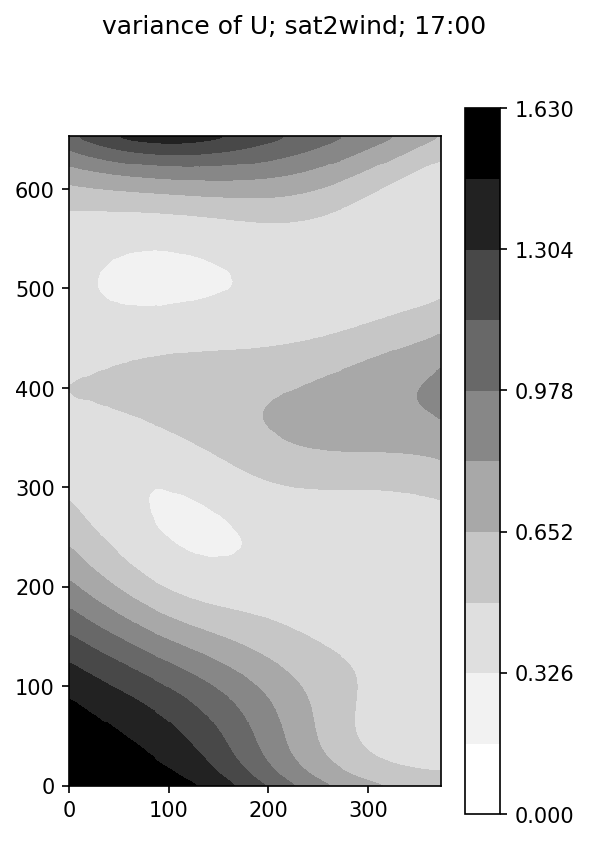

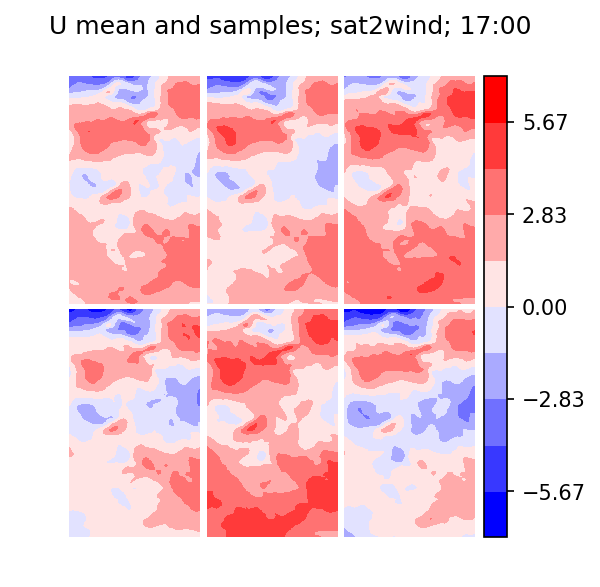

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


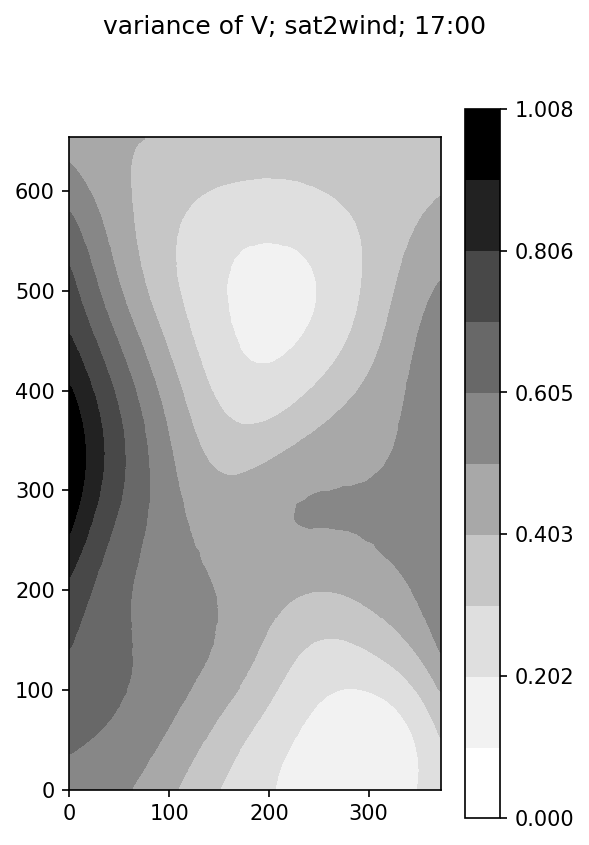

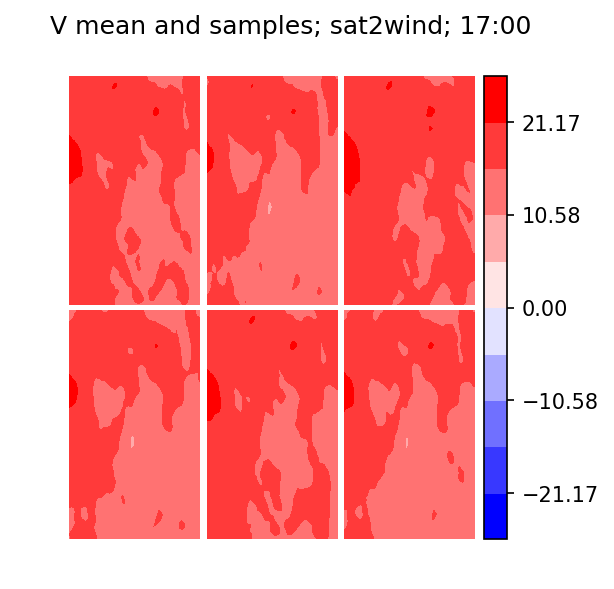

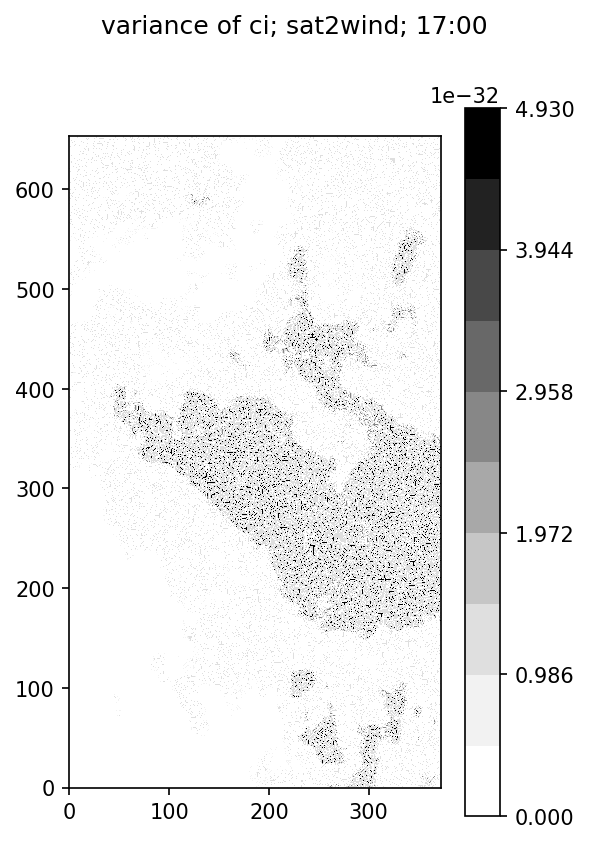

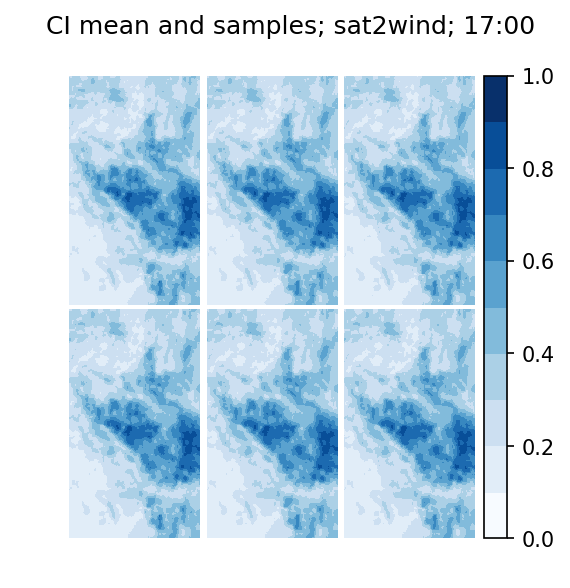

In [39]:
U_plots(ensemble, sat_time, 'sat2wind')
V_plots(ensemble, sat_time, 'sat2wind')
ci_plots(ensemble, sat_time, 'sat2wind')

In [40]:
ensemble, div_wrf_flag = lf.maybe_assim_wrf(                            
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, wrf=wrf,                                  
    ens_params=ens_params,                                           
    flags=flags)

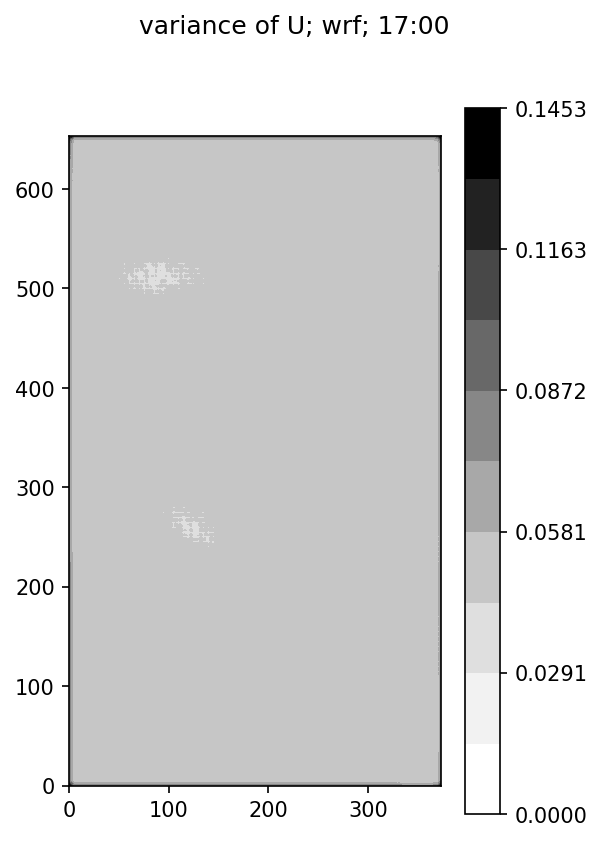

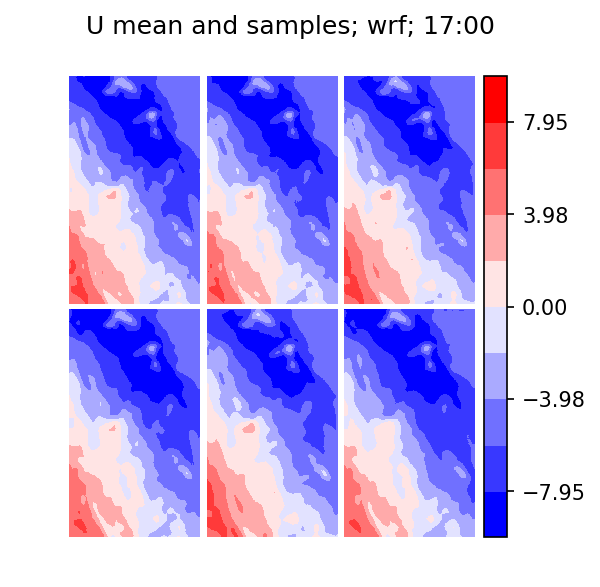

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


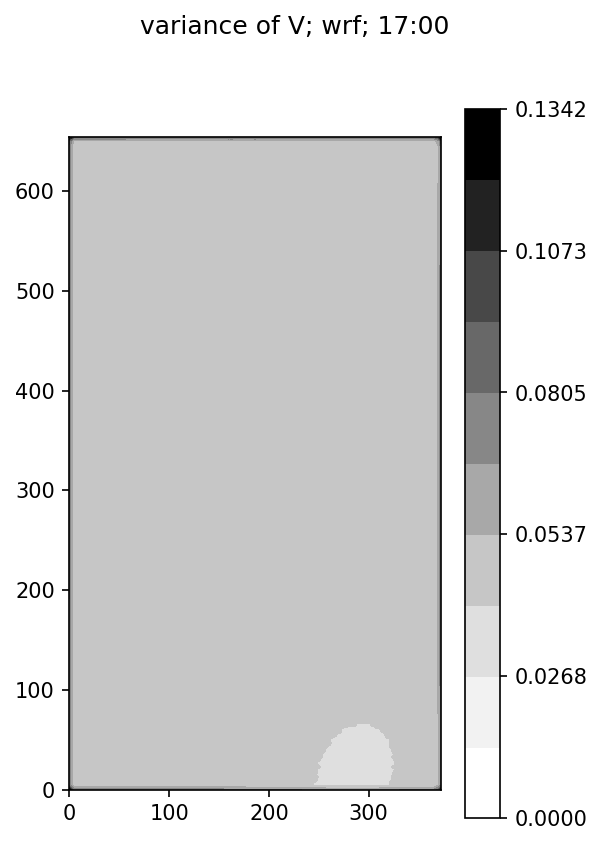

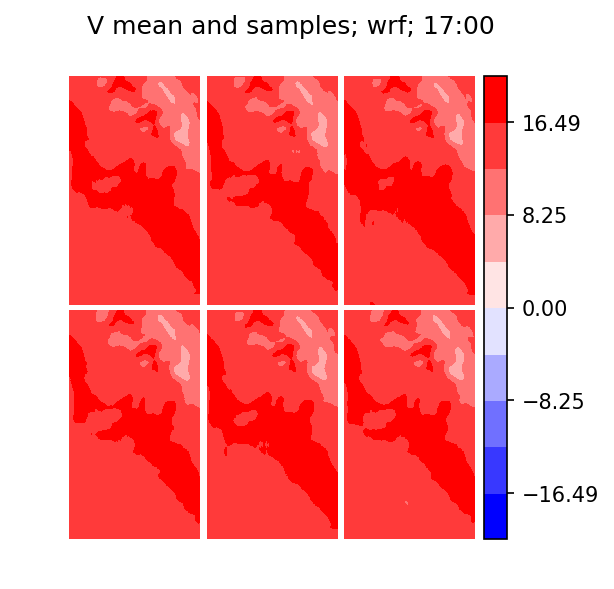

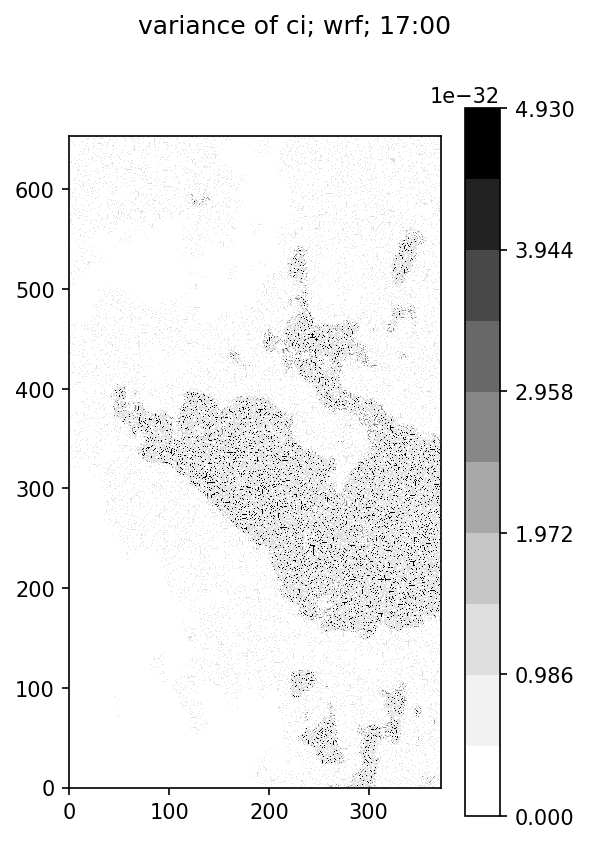

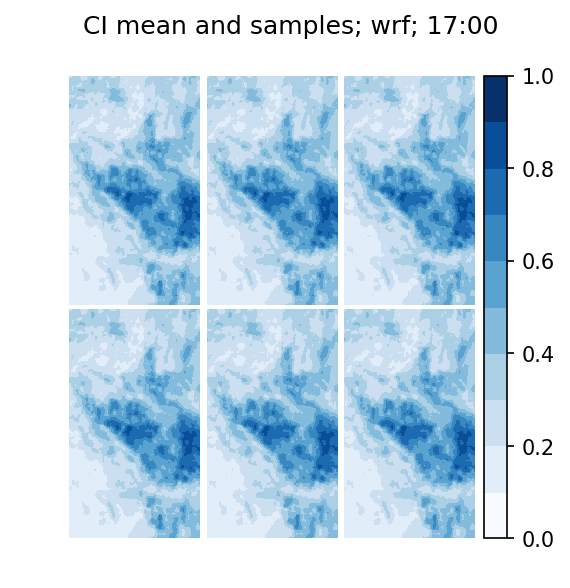

In [41]:
U_plots(ensemble, sat_time, 'wrf')
V_plots(ensemble, sat_time, 'wrf')
ci_plots(ensemble, sat_time, 'wrf')

In [42]:
ensemble_no_opt_flow = ensemble.copy()
returned = lf.maybe_assim_opt_flow(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, time_index=time_index,                        
    coords=coords, sys_vars=sys_vars,                                
    flags=flags, opt_flow=opt_flow)
ensemble, div_opt_flow_flag = returned[:2]
u_opt_flow, v_opt_flow = returned[2:4]
u_flat_pos, v_flat_pos = returned[4:6]

In [43]:
importlib.reload(tp)

<module 'letkf_forecasting.tmh_plot' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/tmh_plot.py'>

(<matplotlib.figure.Figure at 0x7fe78dea7160>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe79e15f9e8>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7fe78e3aa438>], dtype=object))

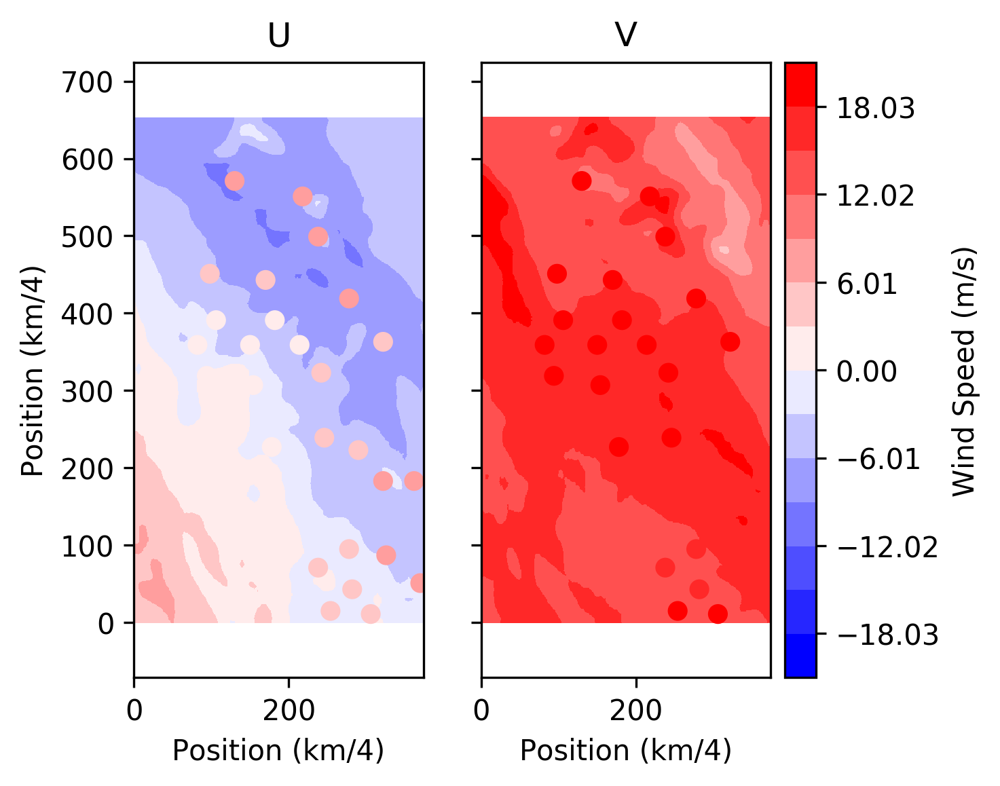

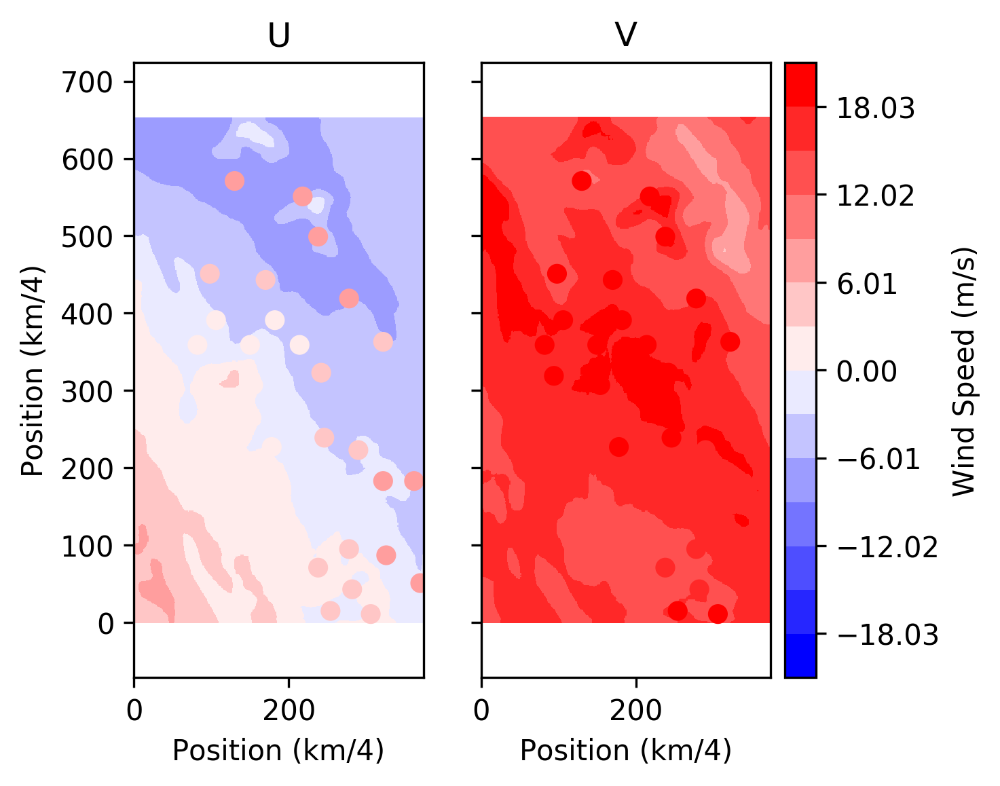

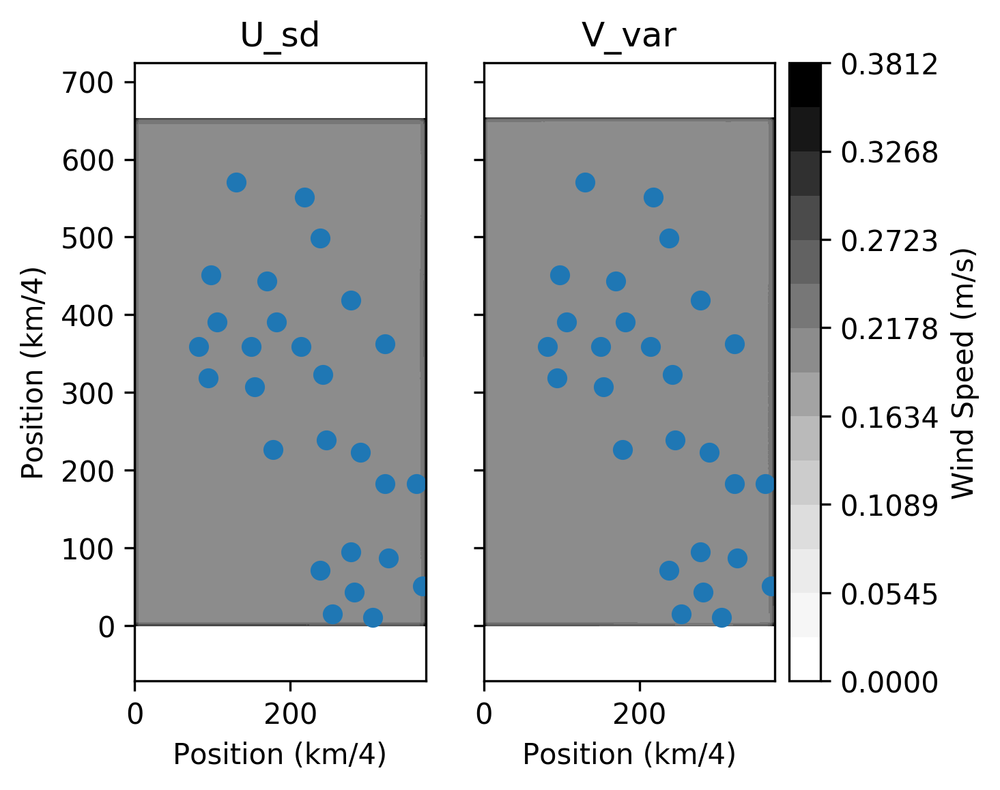

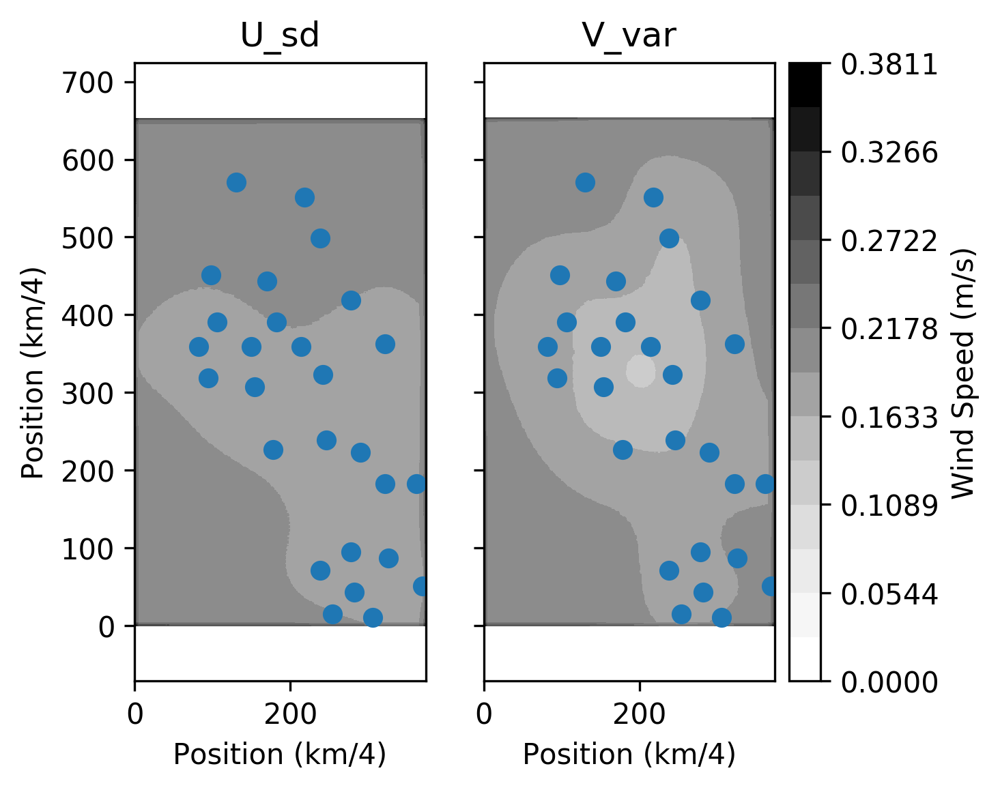

In [45]:
pos = np.array(np.unravel_index(u_flat_pos, sys_vars.U_crop_shape))
tp.wrf_opt_flow_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.wrf_opt_flow_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)

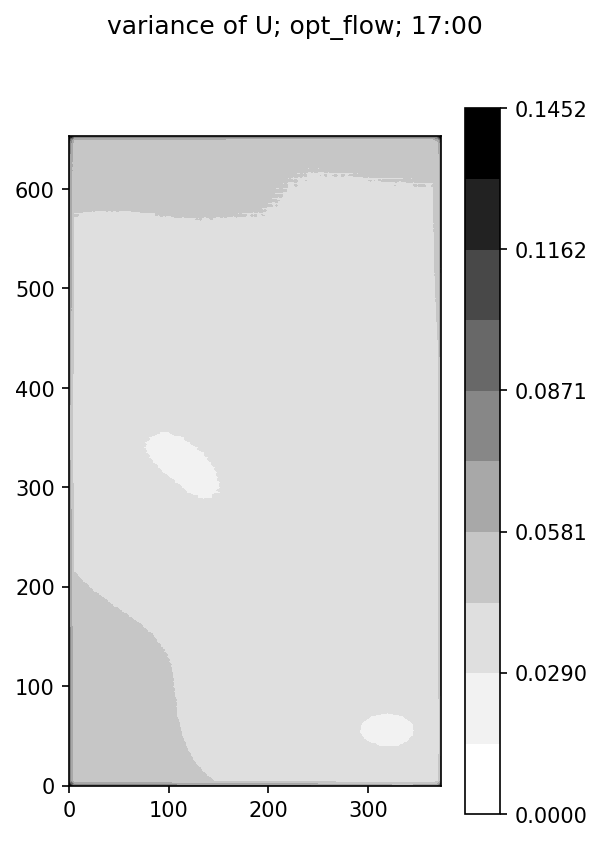

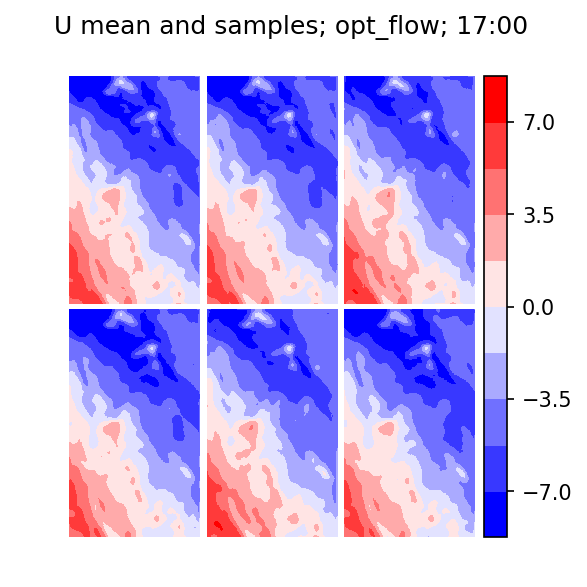

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


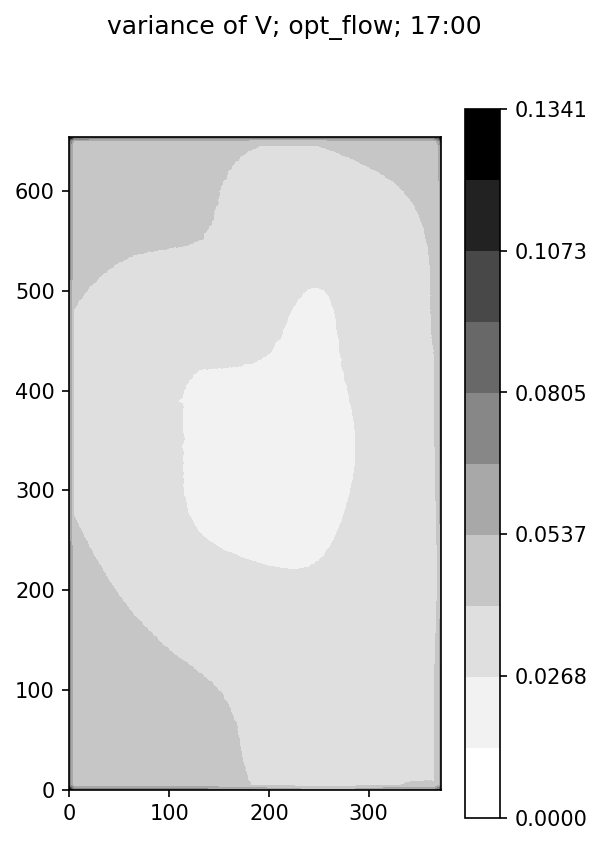

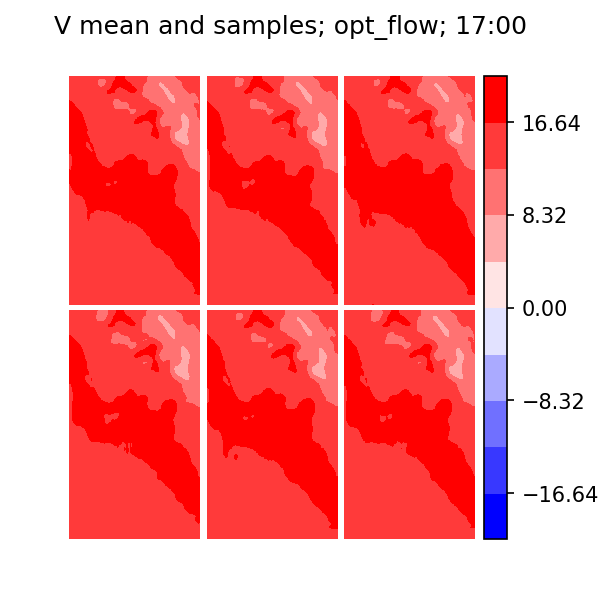

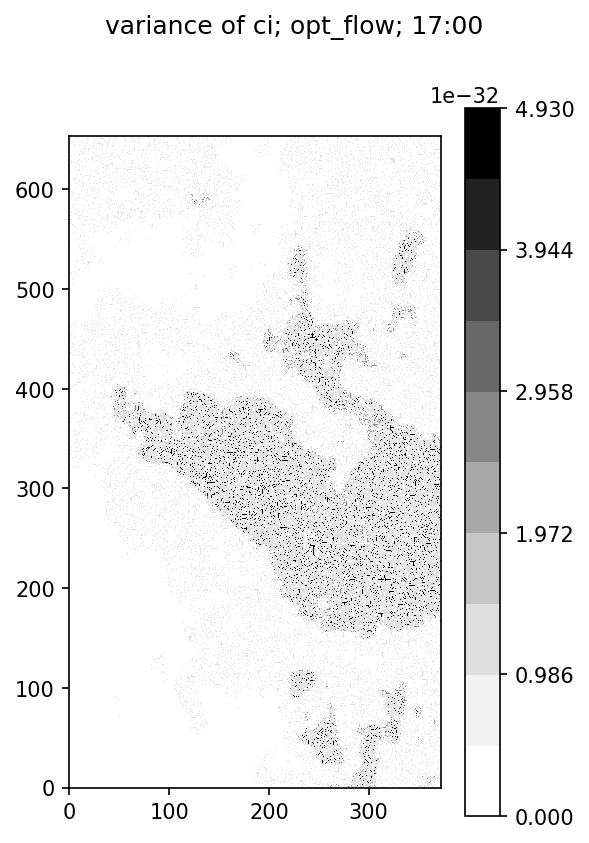

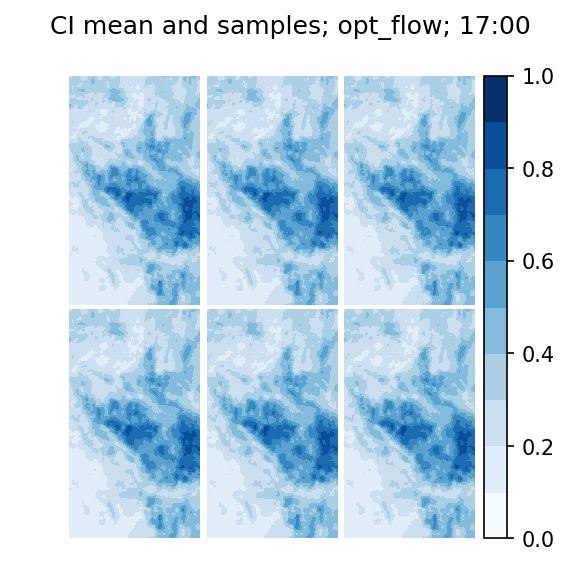

In [46]:
U_plots(ensemble, sat_time, 'opt_flow')
V_plots(ensemble, sat_time, 'opt_flow')
ci_plots(ensemble, sat_time, 'opt_flow')

In [47]:
remove_div_flag = (div_sat2wind_flag                                 
                   or div_wrf_flag                                   
                   or div_opt_flow_flag)                             
ensemble, remove_div_flag = lf.preprocess(                              
    ensemble=ensemble, flags=flags,                                  
    remove_div_flag=remove_div_flag,                                 
    coords=coords, sys_vars=sys_vars)

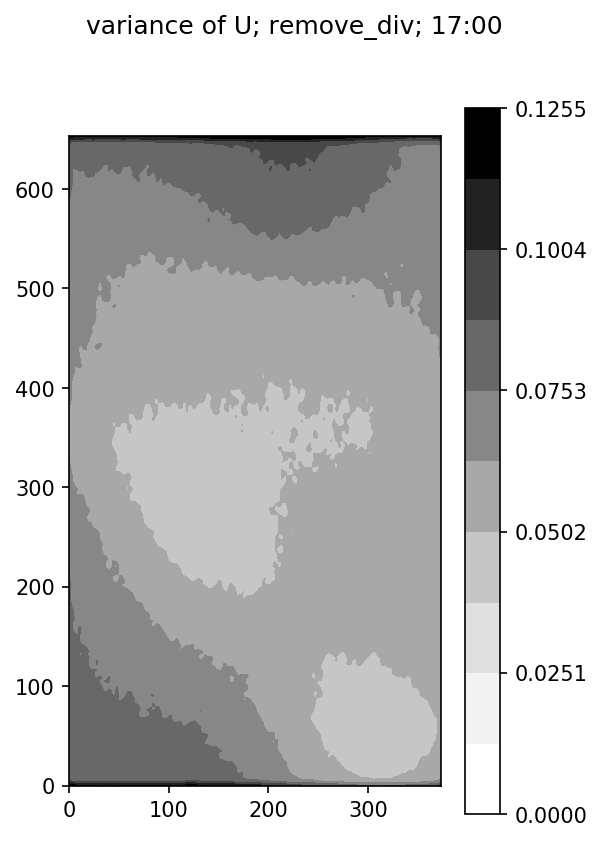

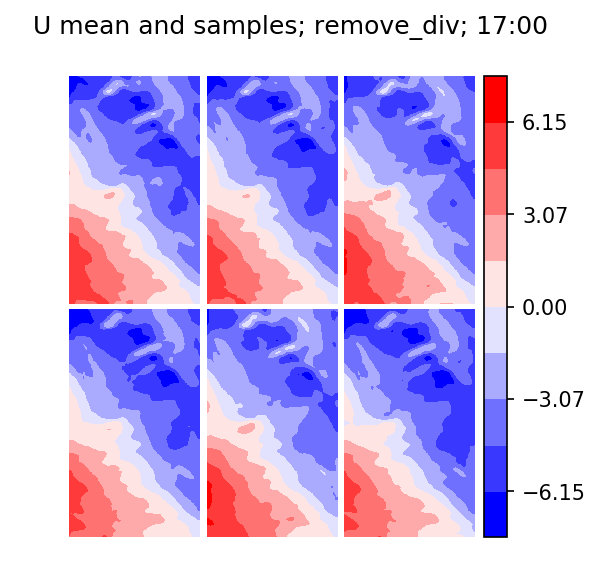

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


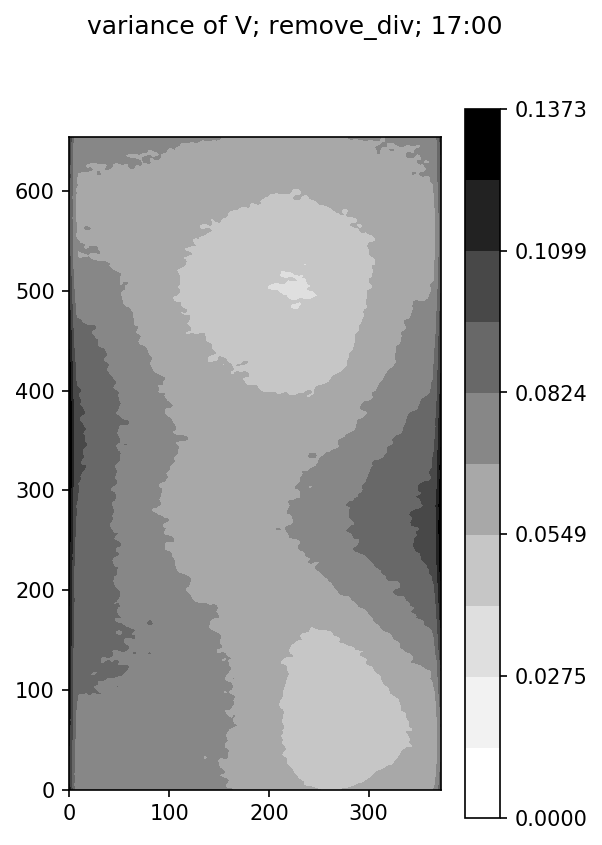

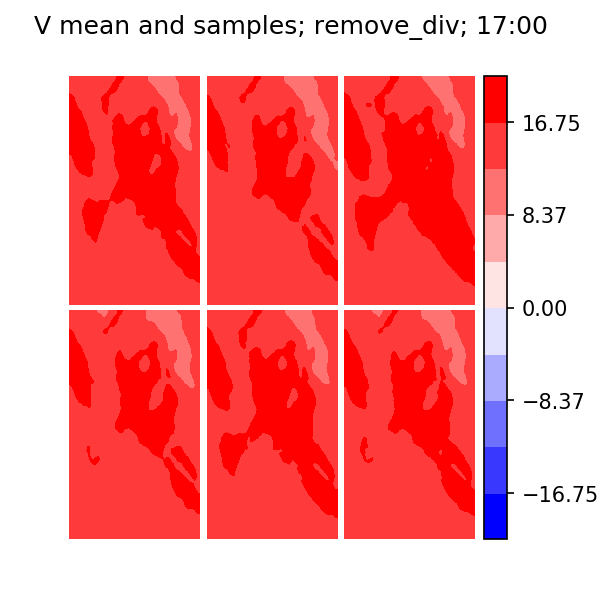

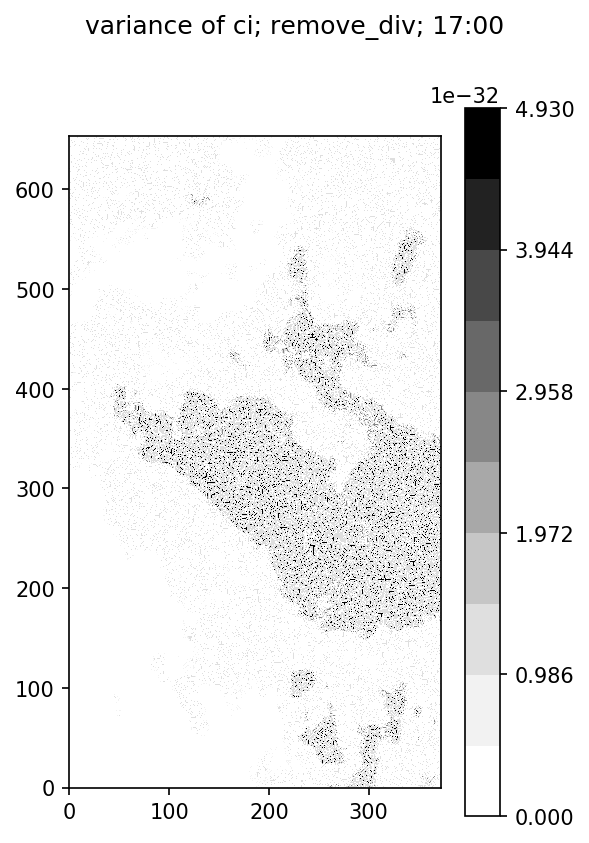

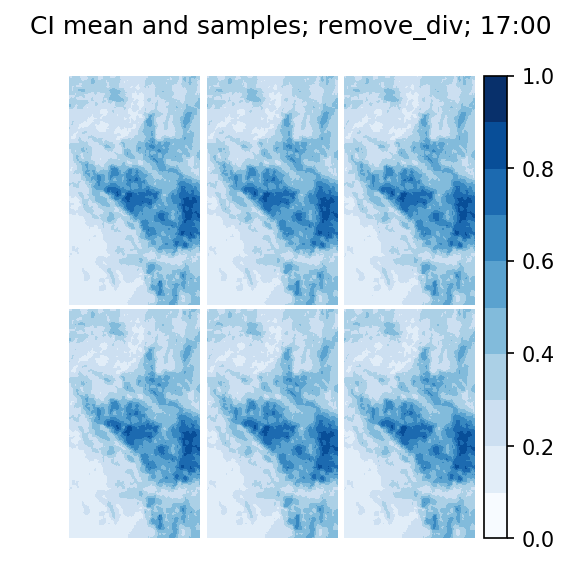

In [48]:
U_plots(ensemble, sat_time, 'remove_div')
V_plots(ensemble, sat_time, 'remove_div')
ci_plots(ensemble, sat_time, 'remove_div')

In [49]:
ensemble_array, save_times, ensemble = lf.forecast(                     
    ensemble=ensemble, sat_time=sat_time,                            
    flags=flags, coords=coords, time_index=time_index,               
    sys_vars=sys_vars,                                               
    advect_params=advect_params, pert_params=pert_params,            
    assim_vars=assim_vars)

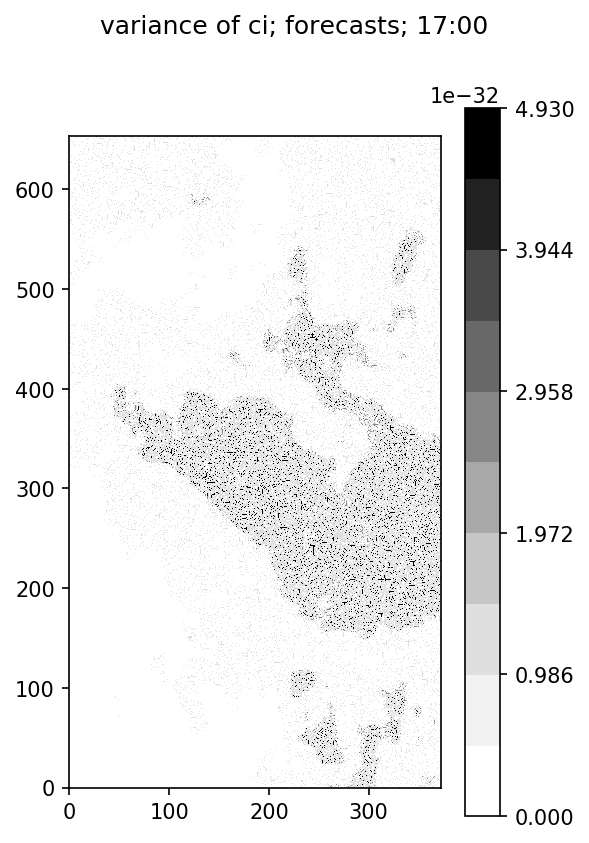

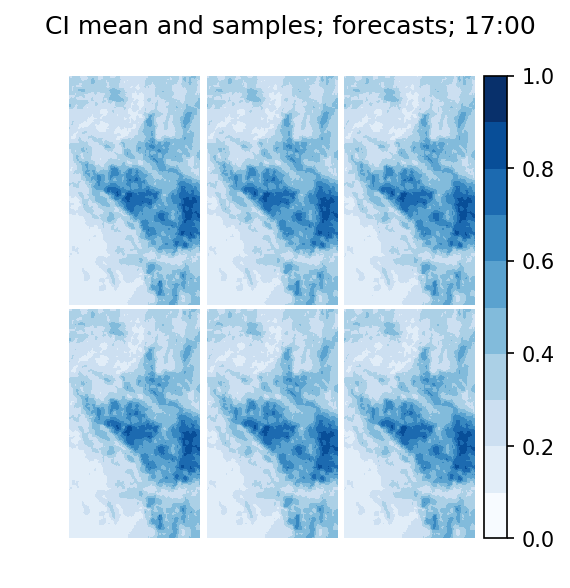

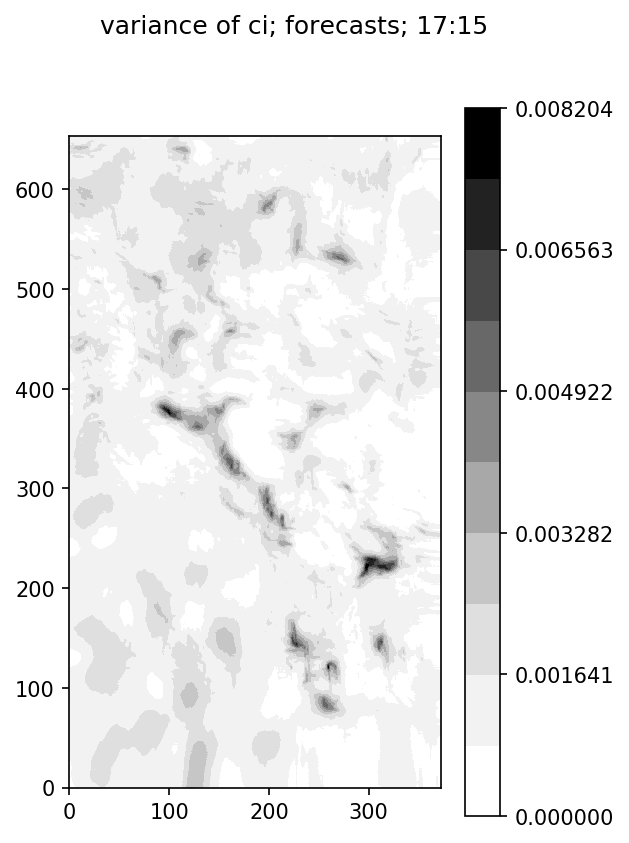

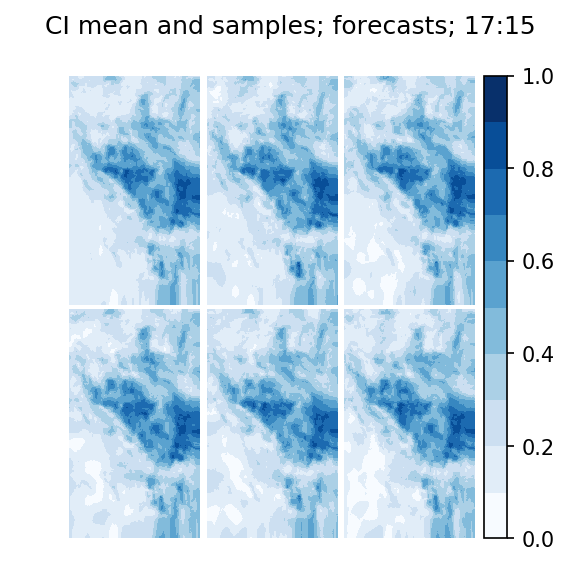

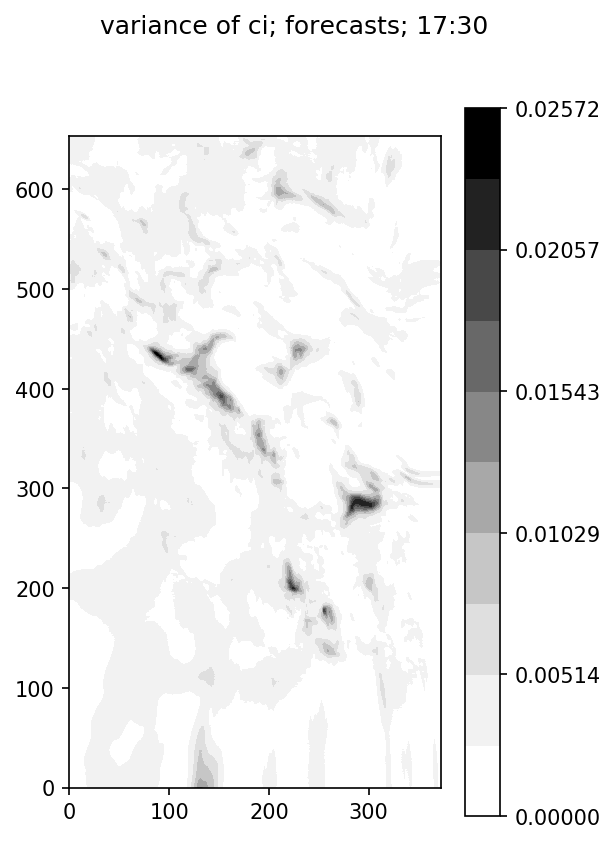

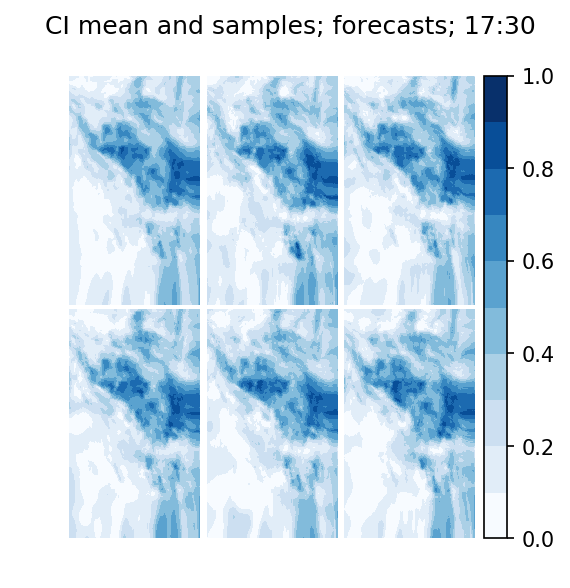

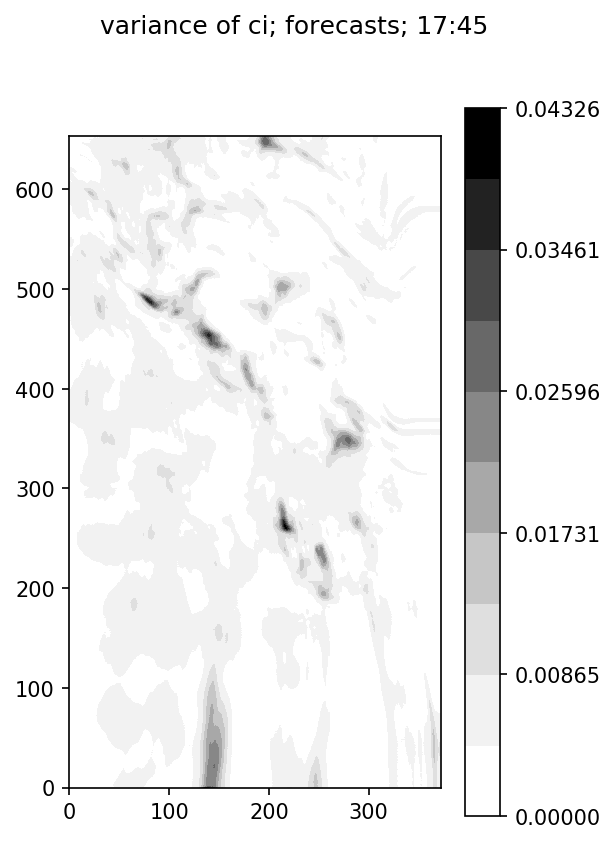

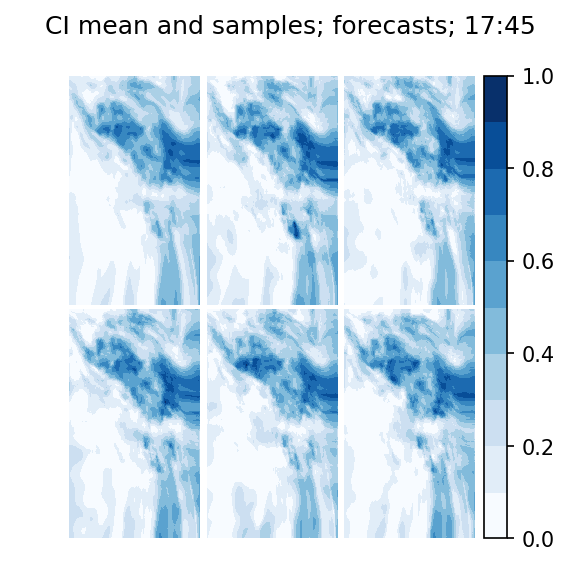

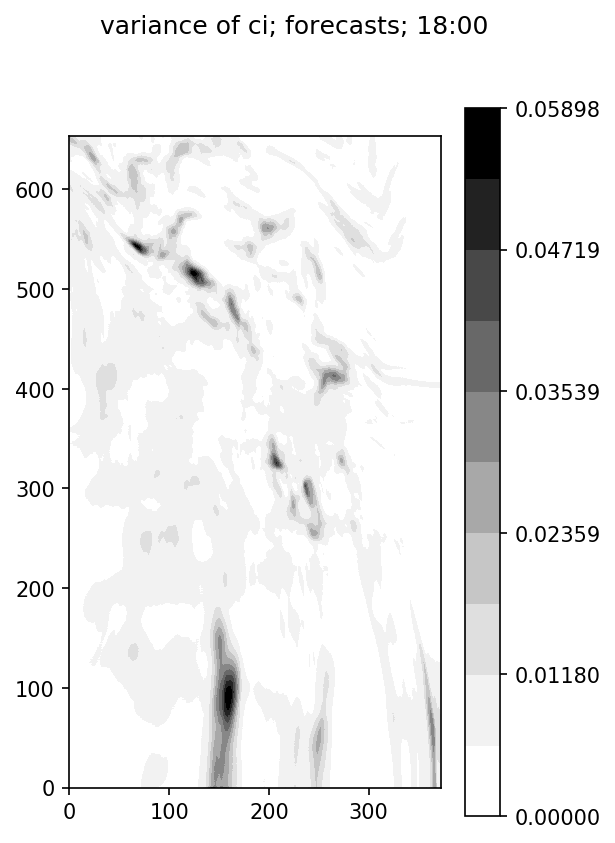

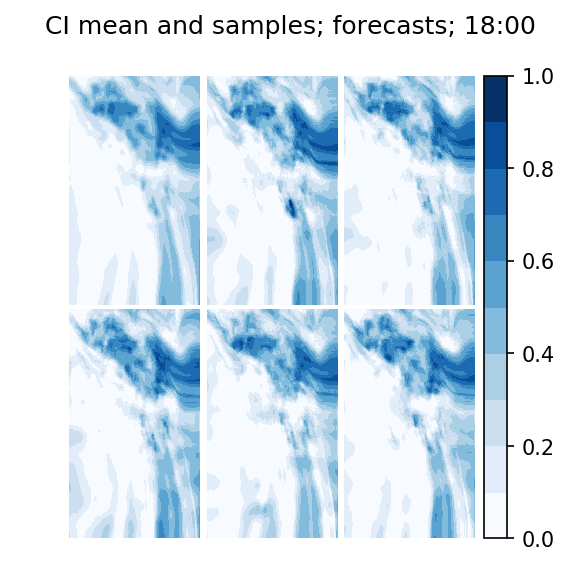

In [50]:
for ii in range(ensemble_array.shape[0]):
    ci_plots(ensemble_array[ii], save_times[ii], 'forecasts')

In [51]:
# lf.save(ensemble_array=ensemble_array, coords=coords,                   
#      ens_params=ens_params, param_dict=param_dict,                   
#      sys_vars=sys_vars, save_times=save_times,                       
#      results_file_path=results_file_path)

In [52]:
time_index = 3
sat_time = coords.sat_times[time_index]                              
logging.info(str(sat_time))

In [53]:
ensemble = lf.maybe_assim_sat2sat(                                      
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    flags=flags)

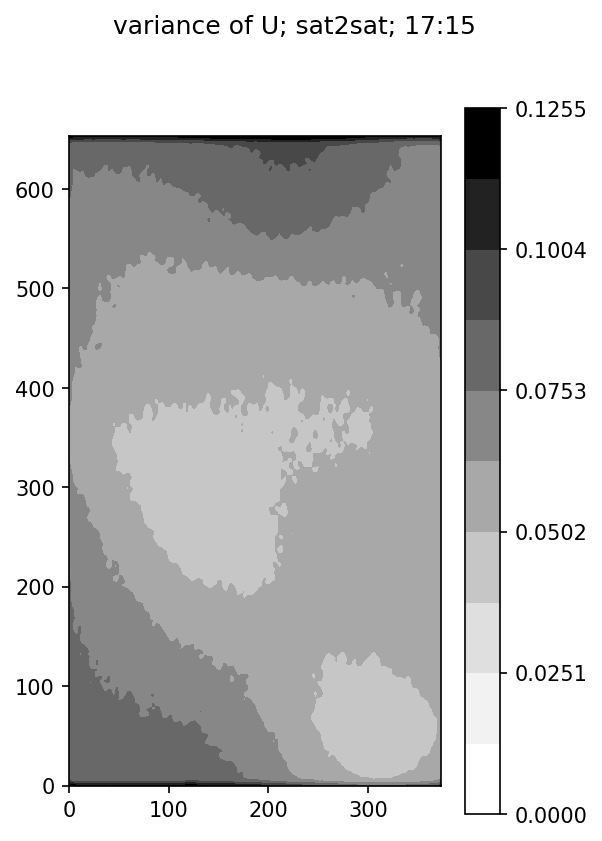

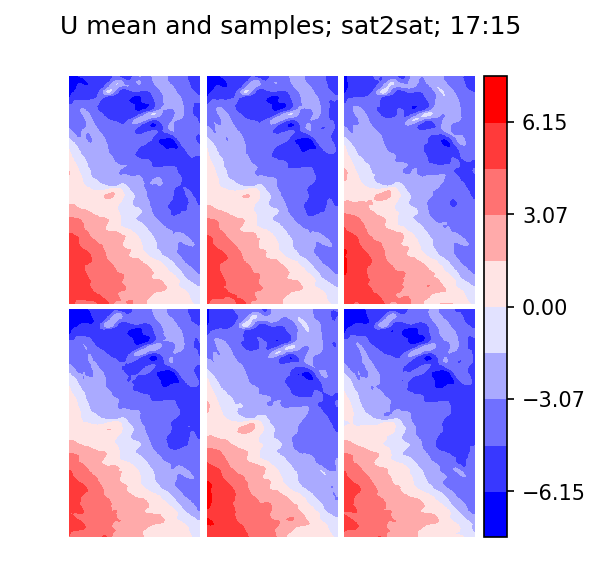

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


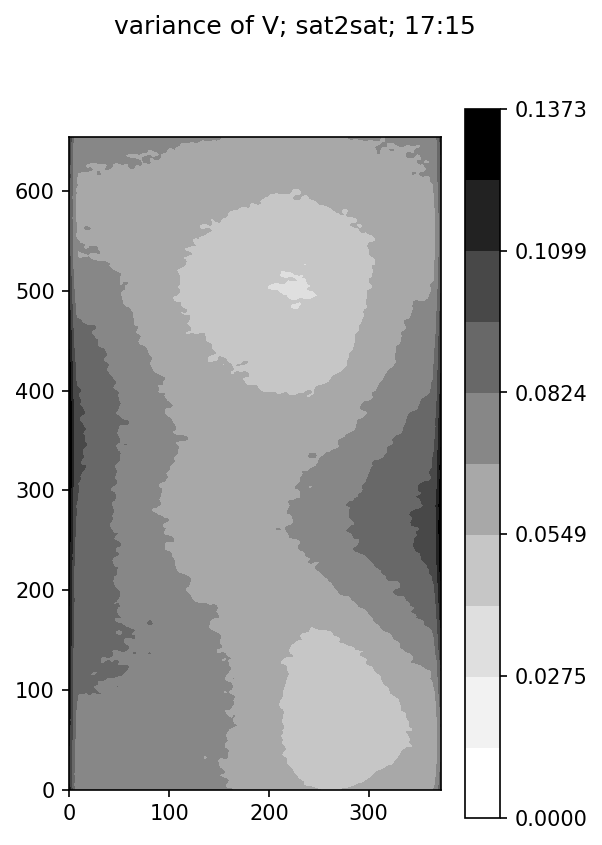

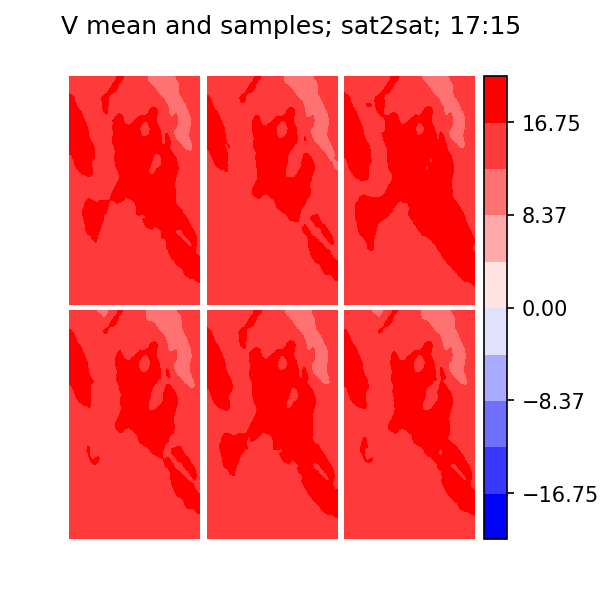

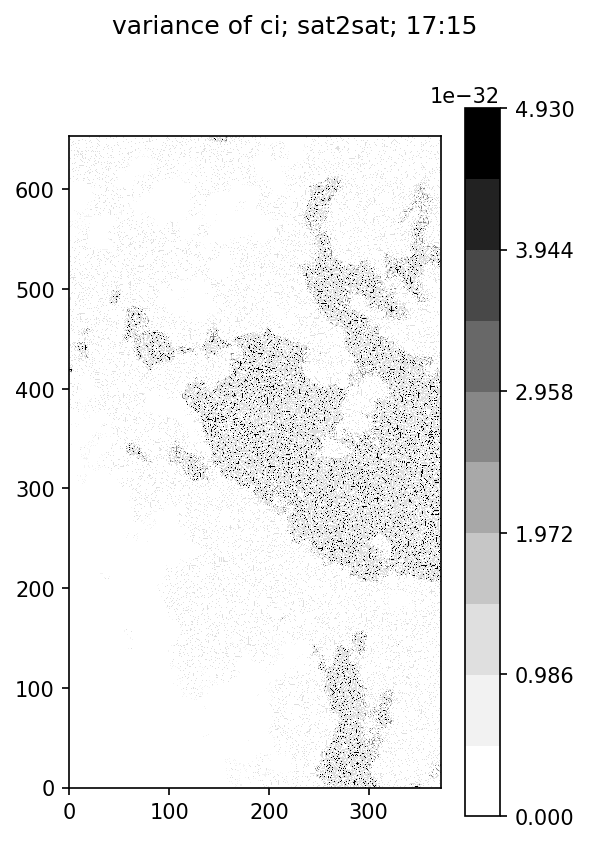

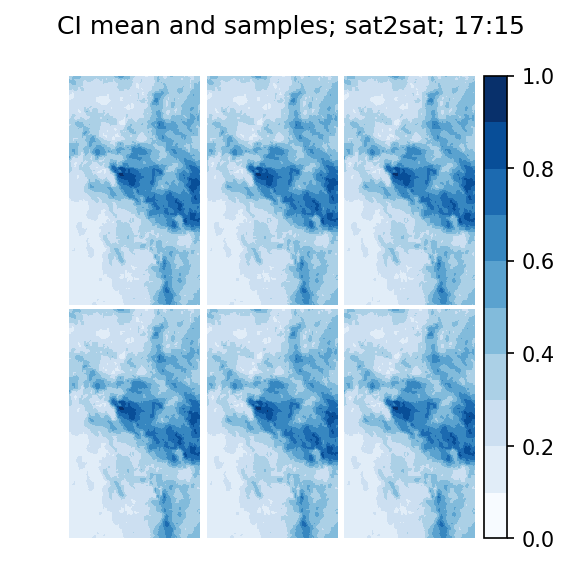

In [54]:
U_plots(ensemble, sat_time, 'sat2sat')
V_plots(ensemble, sat_time, 'sat2sat')
ci_plots(ensemble, sat_time, 'sat2sat')

In [55]:
ensemble, div_sat2wind_flag = lf.maybe_assim_sat2wind(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, sat2wind=sat2wind,                        
    flags=flags)

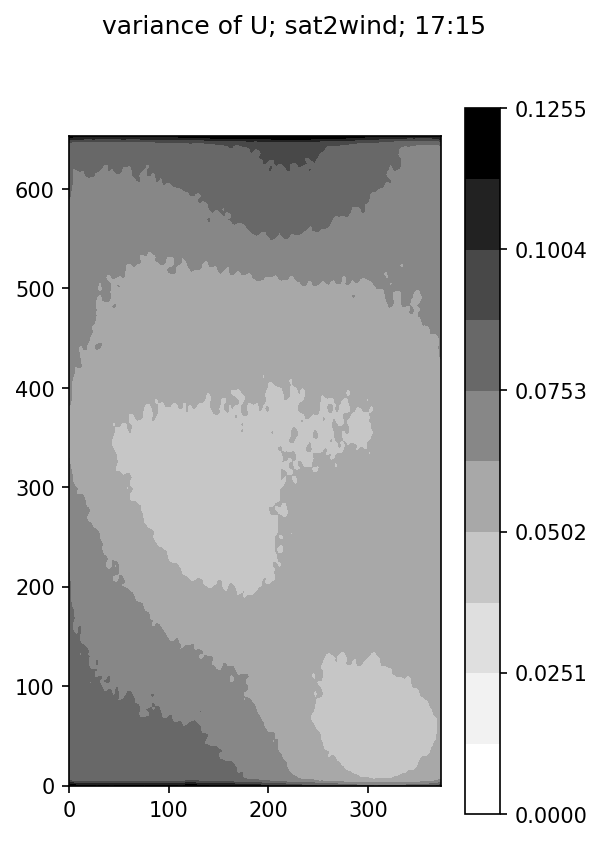

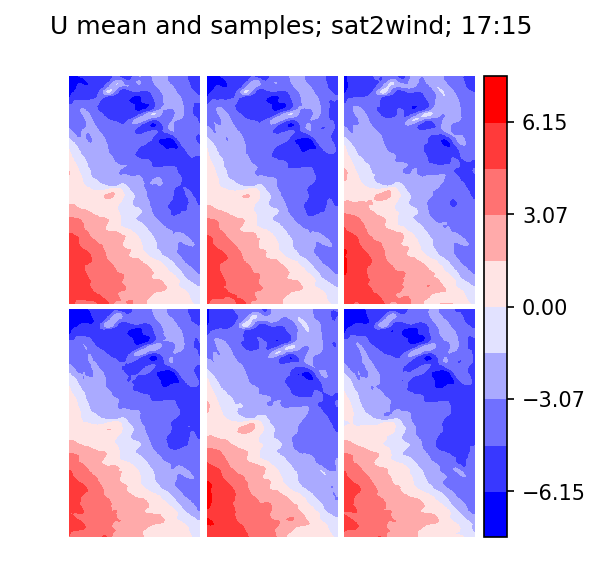

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


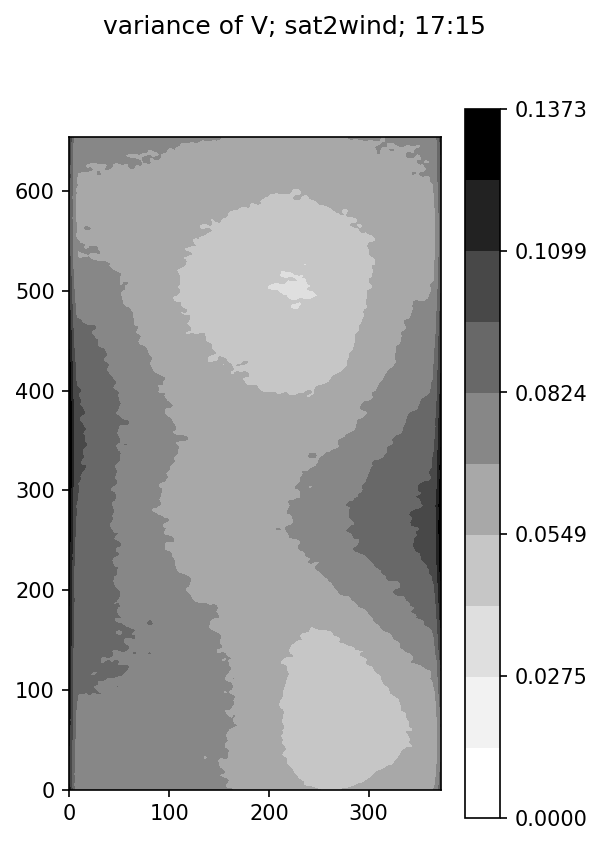

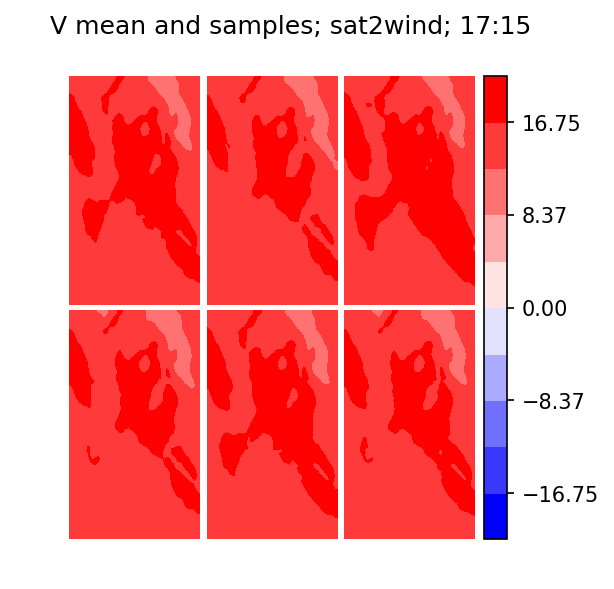

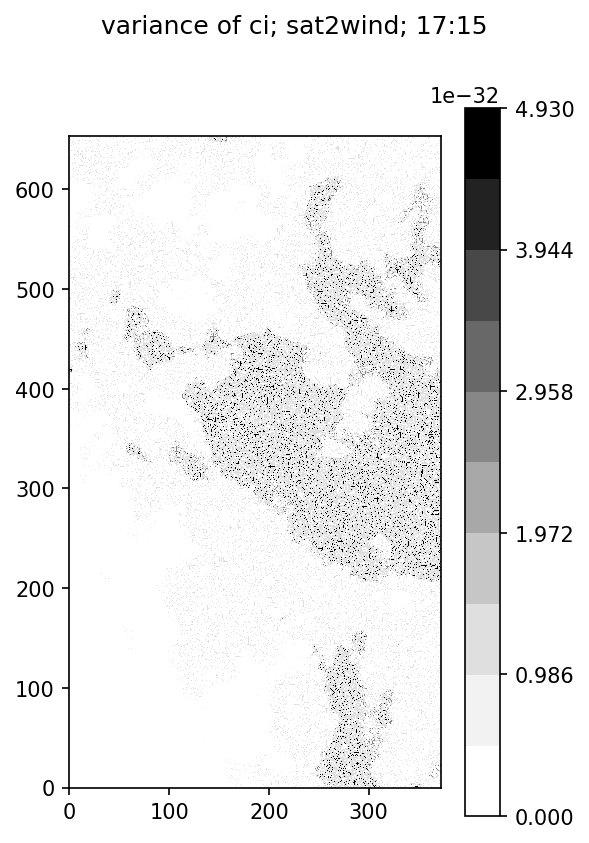

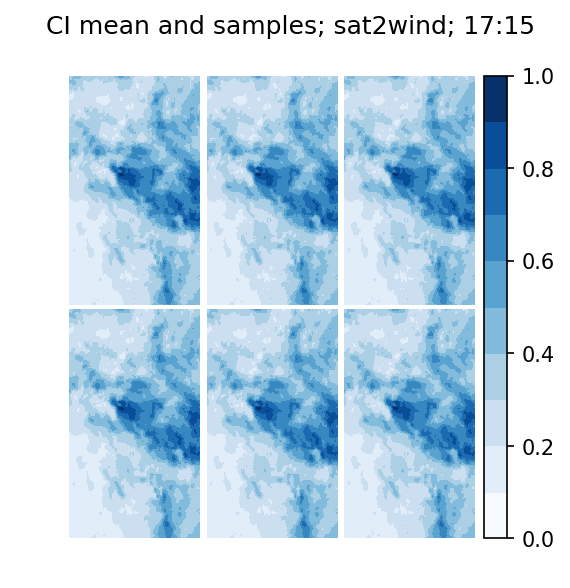

In [56]:
U_plots(ensemble, sat_time, 'sat2wind')
V_plots(ensemble, sat_time, 'sat2wind')
ci_plots(ensemble, sat_time, 'sat2wind')

In [57]:
ensemble, div_wrf_flag = lf.maybe_assim_wrf(                            
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, wrf=wrf,                                  
    ens_params=ens_params,                                           
    flags=flags)

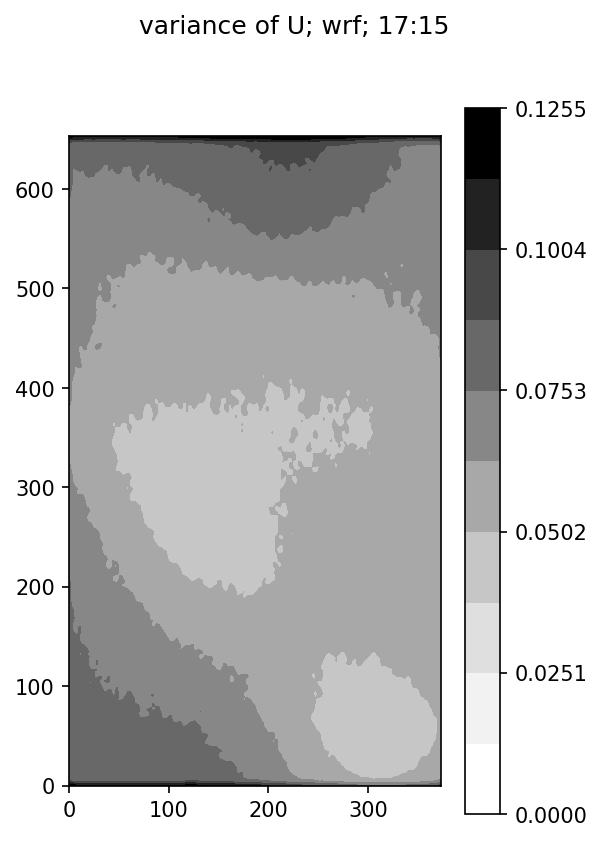

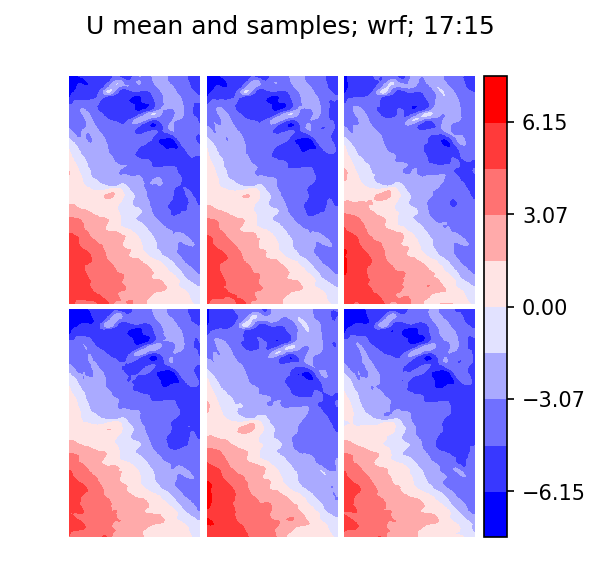

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


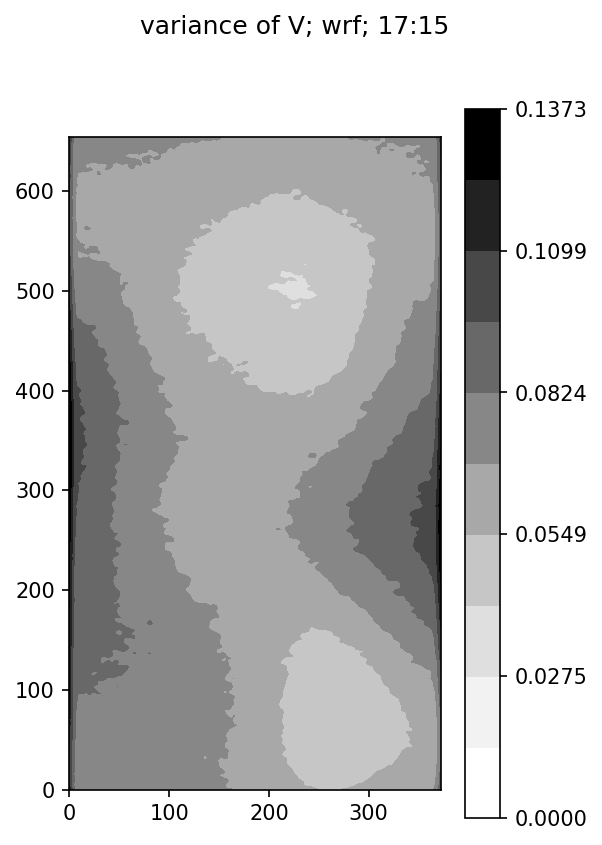

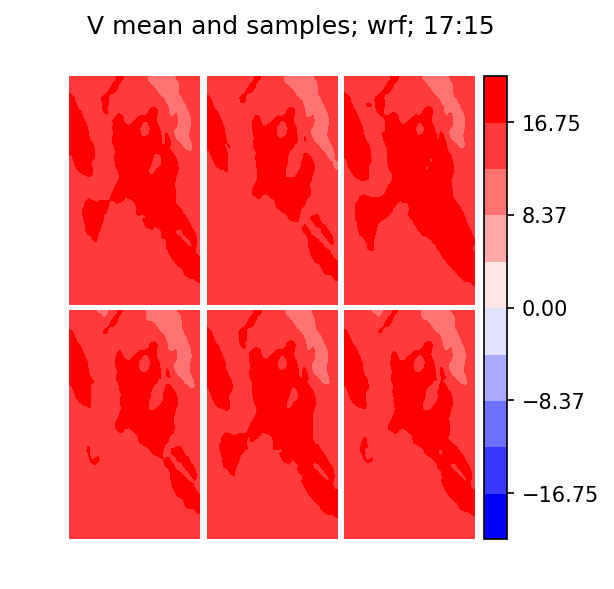

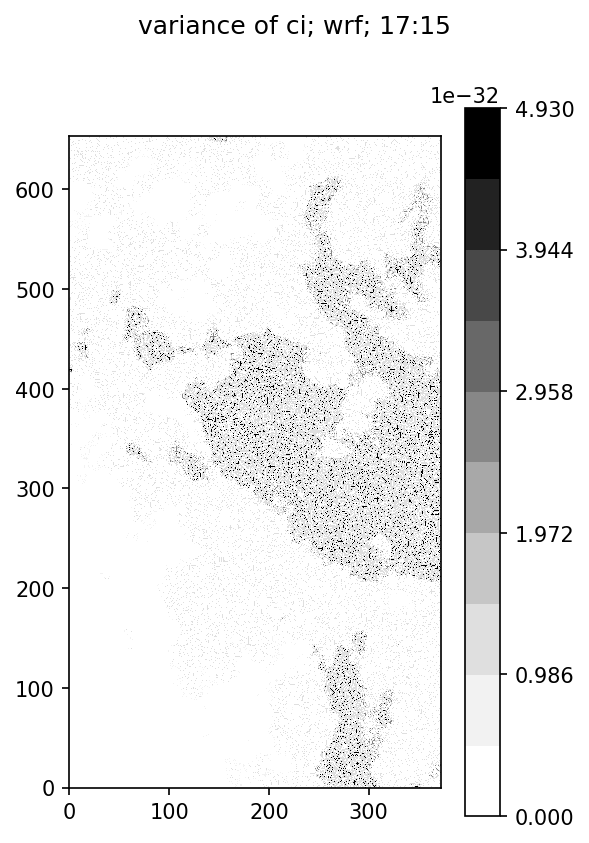

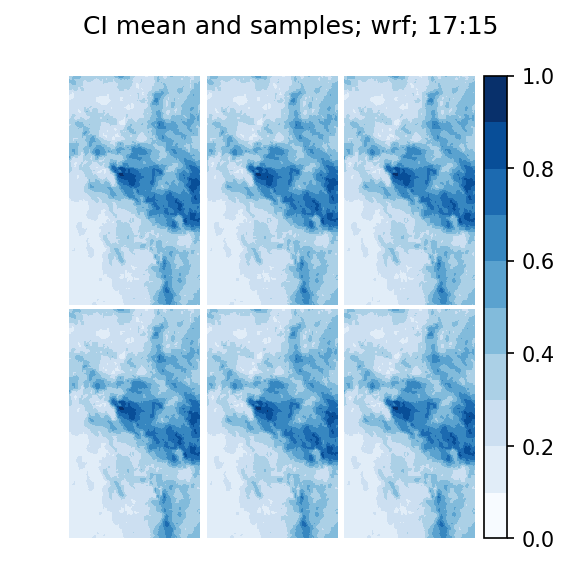

In [58]:
U_plots(ensemble, sat_time, 'wrf')
V_plots(ensemble, sat_time, 'wrf')
ci_plots(ensemble, sat_time, 'wrf')

In [59]:
ensemble_no_opt_flow = ensemble.copy()
returned = lf.maybe_assim_opt_flow(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, time_index=time_index,                        
    coords=coords, sys_vars=sys_vars,                                
    flags=flags, opt_flow=opt_flow)
ensemble, div_opt_flow_flag = returned[:2]
u_opt_flow, v_opt_flow = returned[2:4]
u_flat_pos, v_flat_pos = returned[4:6]

In [60]:
importlib.reload(tp)

<module 'letkf_forecasting.tmh_plot' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/tmh_plot.py'>

(<matplotlib.figure.Figure at 0x7fe78e0c4ba8>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe785cbf198>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7fe78defa128>], dtype=object))

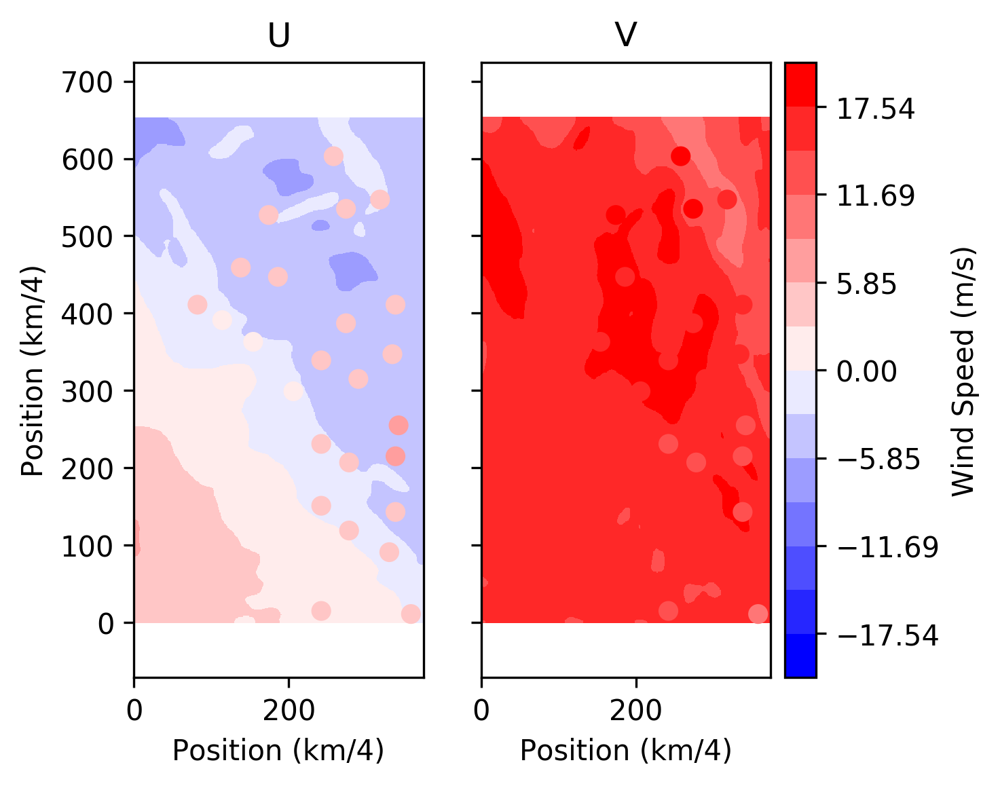

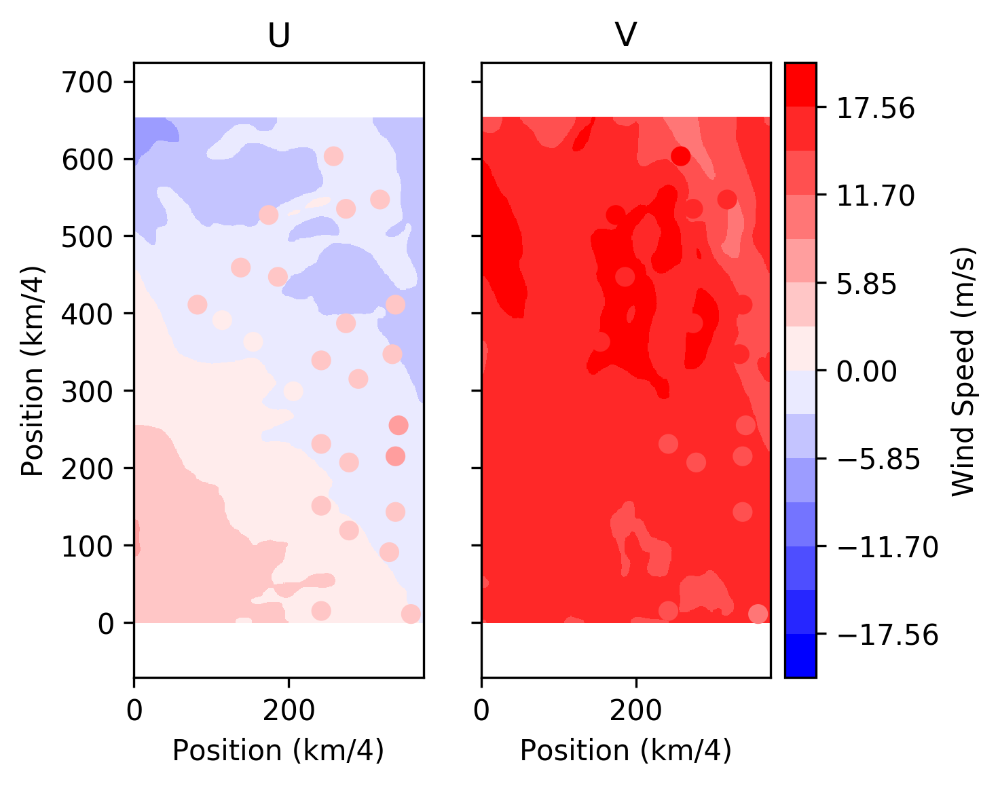

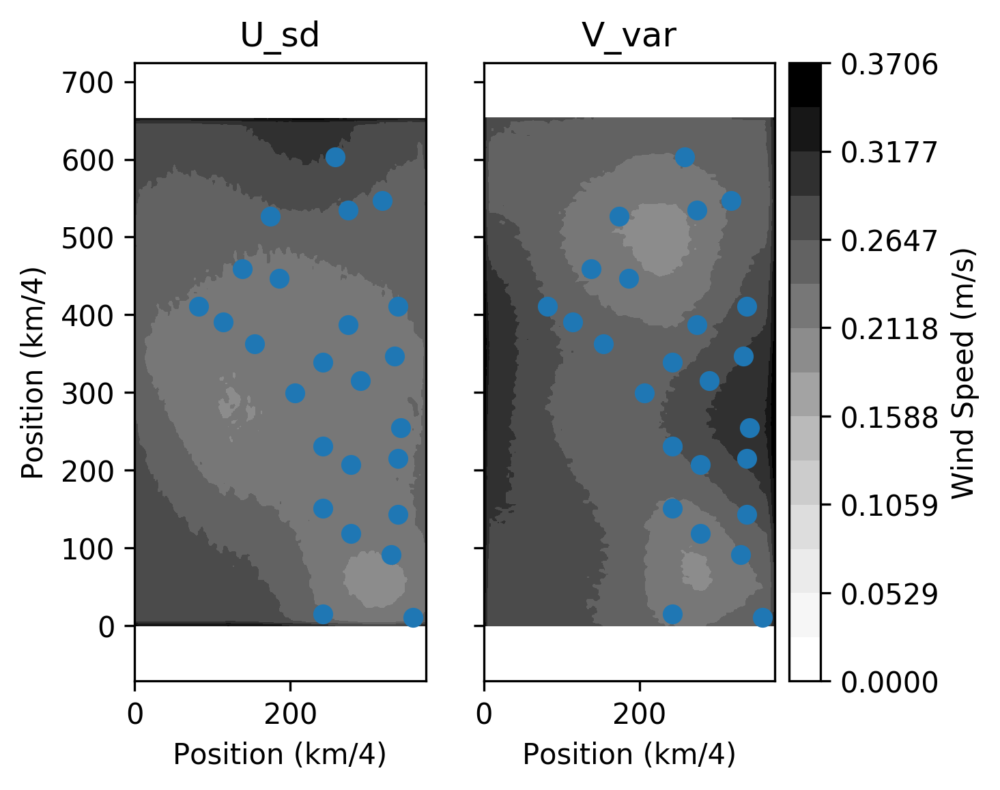

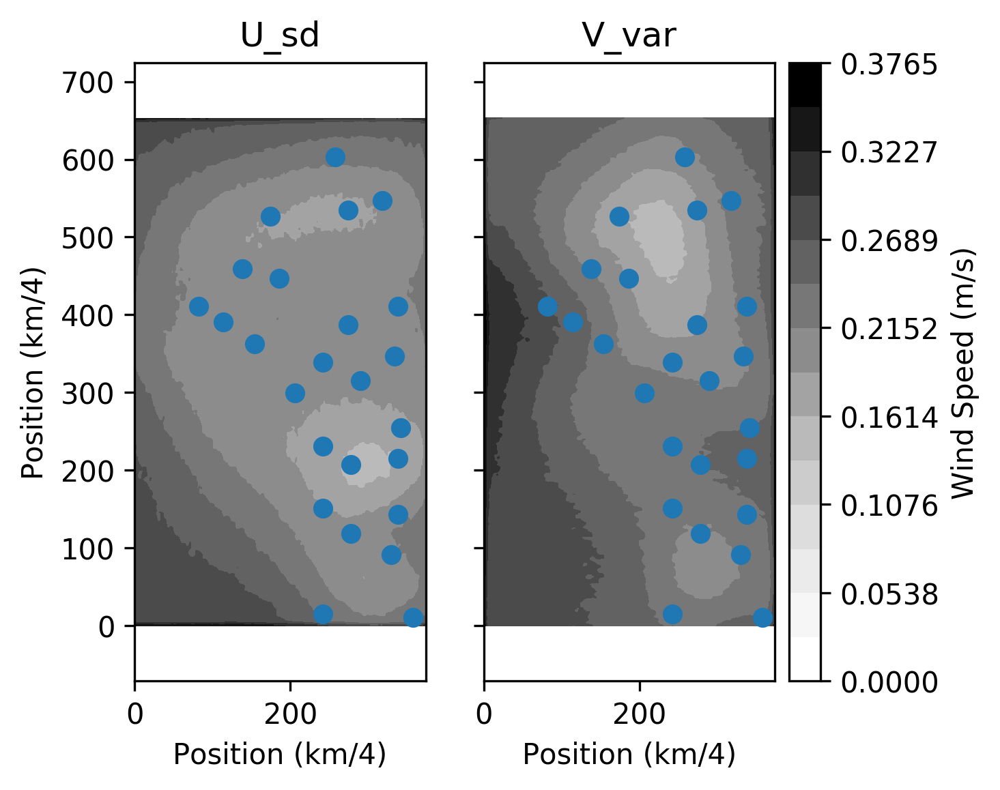

In [61]:
pos = np.array(np.unravel_index(u_flat_pos, sys_vars.U_crop_shape))
tp.wrf_opt_flow_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.wrf_opt_flow_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)

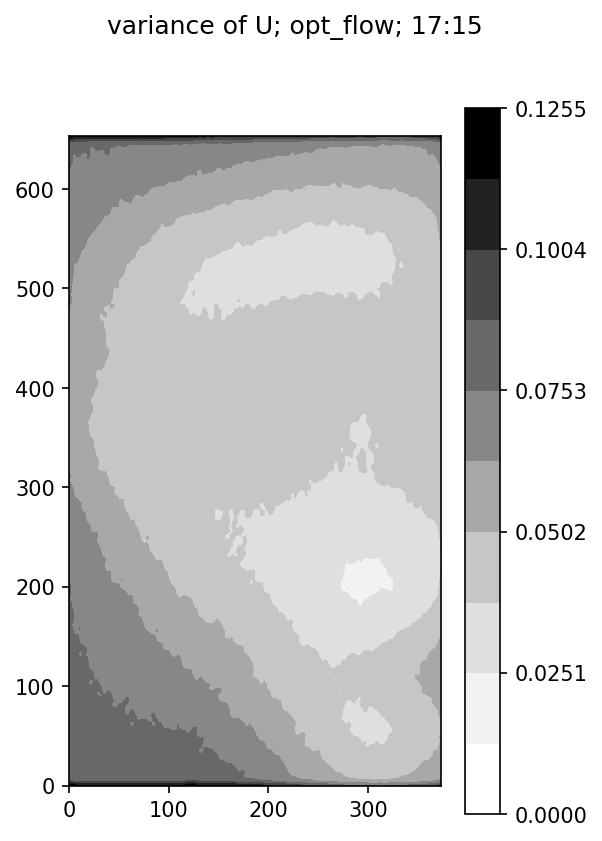

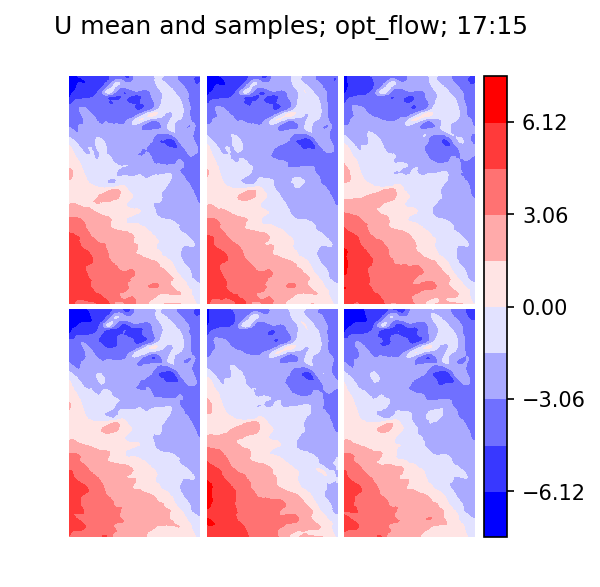

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


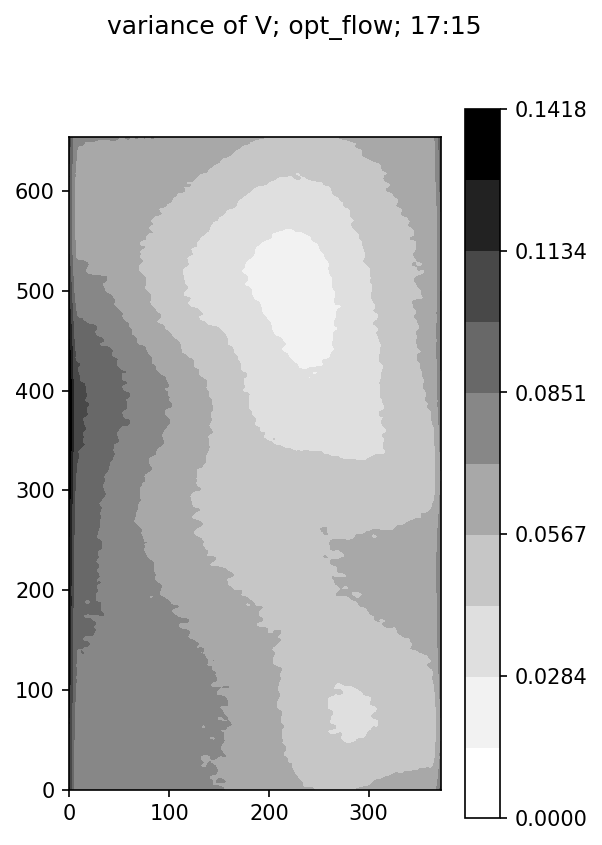

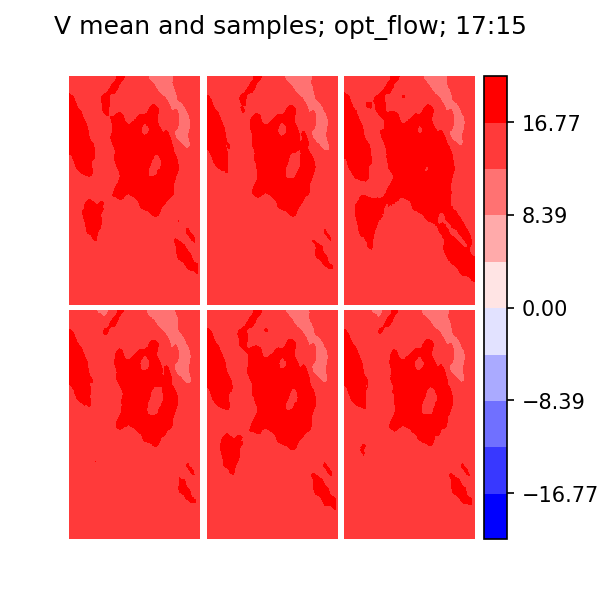

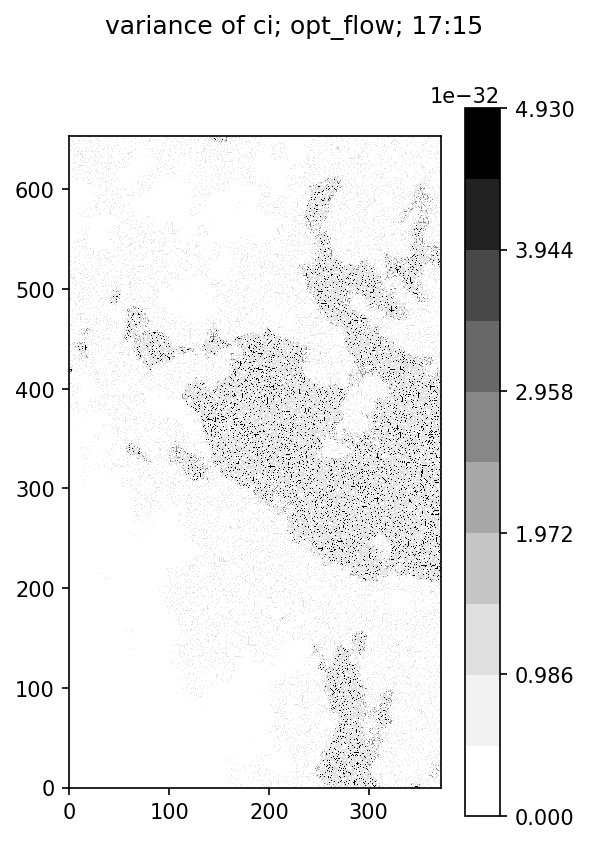

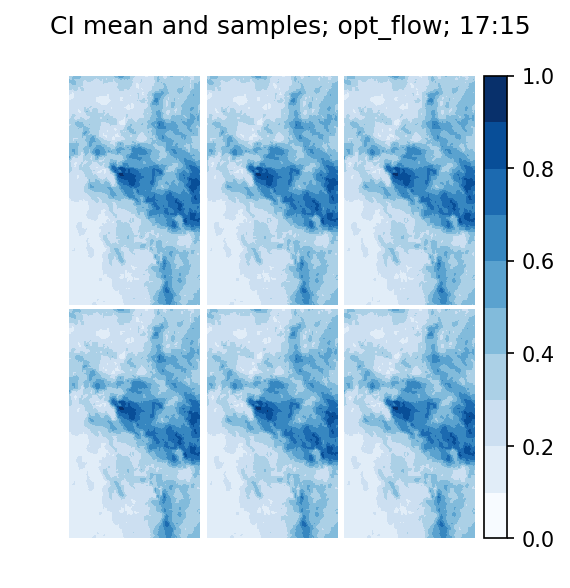

In [62]:
U_plots(ensemble, sat_time, 'opt_flow')
V_plots(ensemble, sat_time, 'opt_flow')
ci_plots(ensemble, sat_time, 'opt_flow')

In [63]:
remove_div_flag = (div_sat2wind_flag                                 
                   or div_wrf_flag                                   
                   or div_opt_flow_flag)                             
ensemble, remove_div_flag = lf.preprocess(                              
    ensemble=ensemble, flags=flags,                                  
    remove_div_flag=remove_div_flag,                                 
    coords=coords, sys_vars=sys_vars)

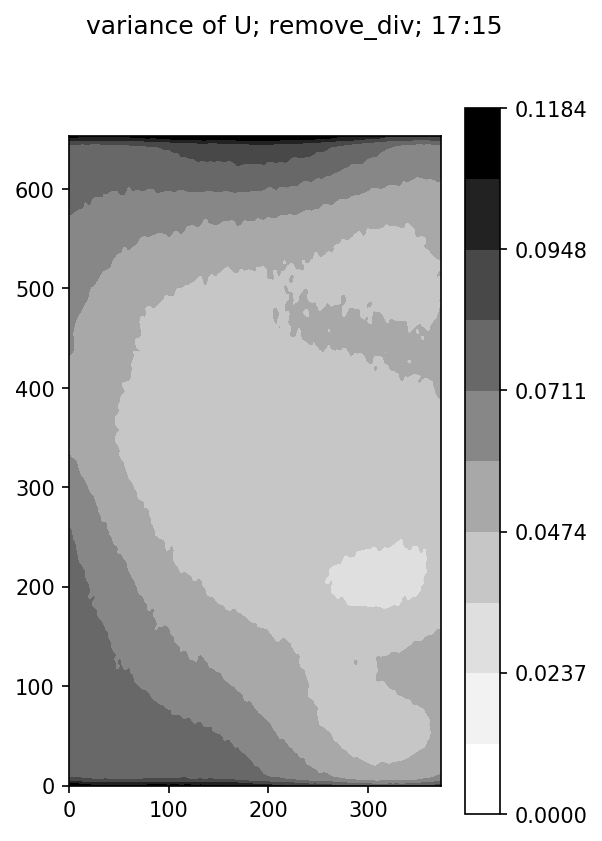

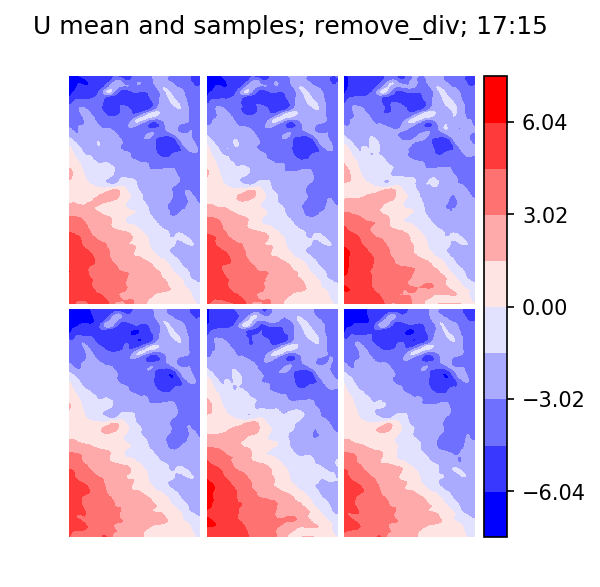

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


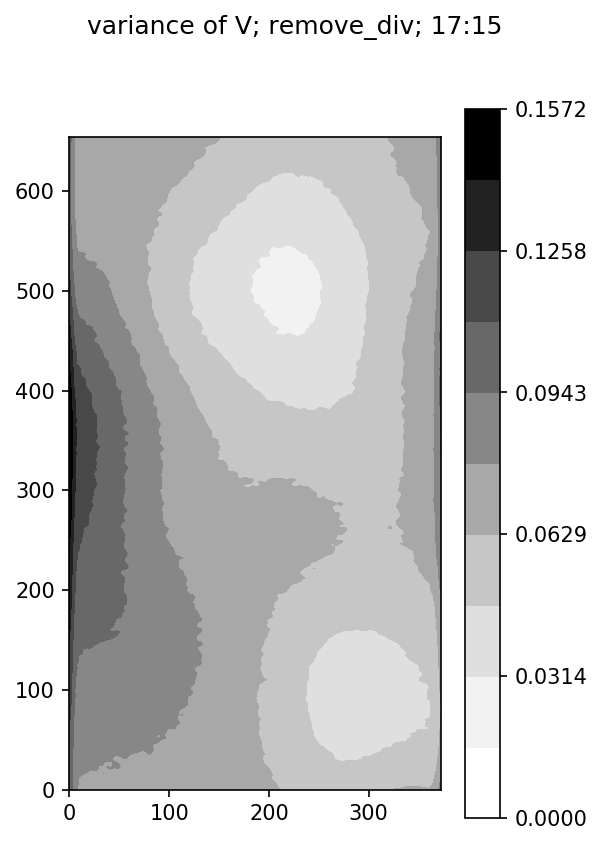

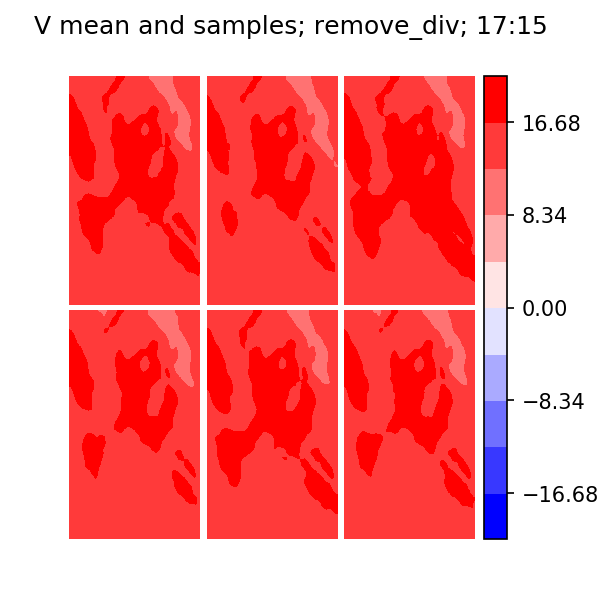

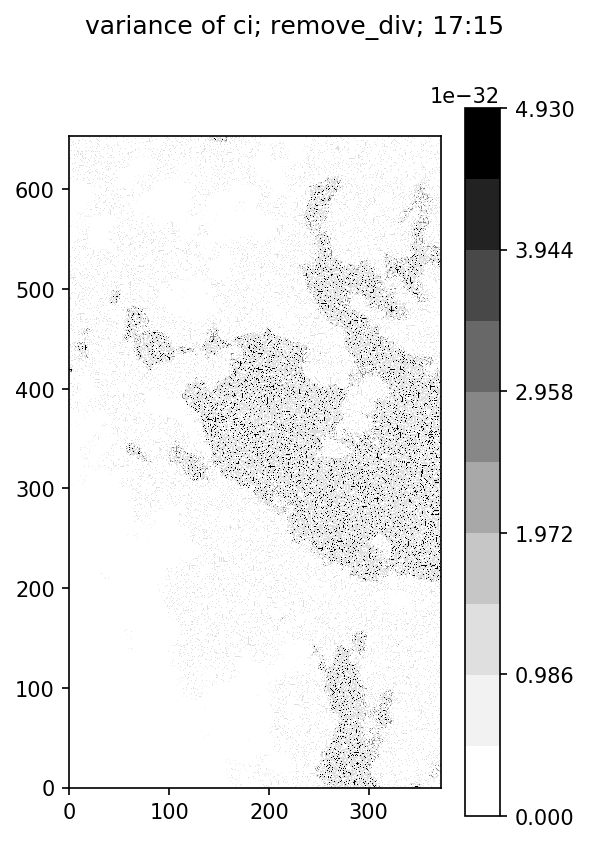

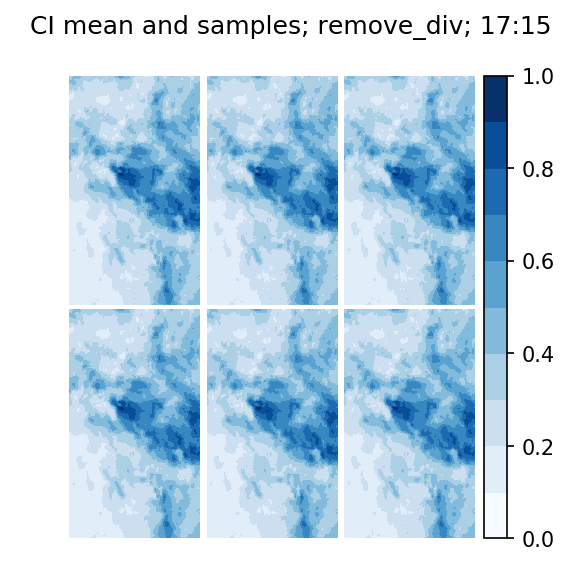

In [64]:
U_plots(ensemble, sat_time, 'remove_div')
V_plots(ensemble, sat_time, 'remove_div')
ci_plots(ensemble, sat_time, 'remove_div')

In [65]:
ensemble_array, save_times, ensemble = lf.forecast(                     
    ensemble=ensemble, sat_time=sat_time,                            
    flags=flags, coords=coords, time_index=time_index,               
    sys_vars=sys_vars,                                               
    advect_params=advect_params, pert_params=pert_params,            
    assim_vars=assim_vars)

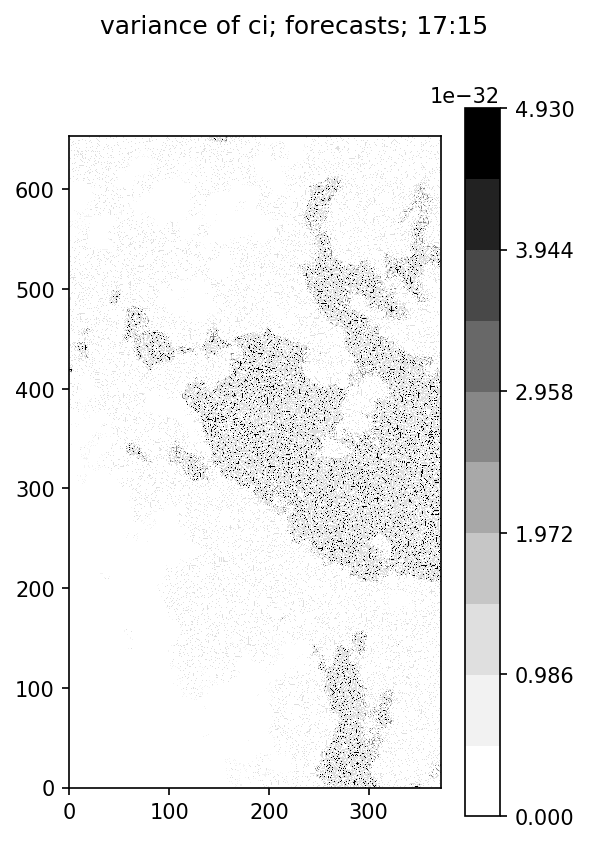

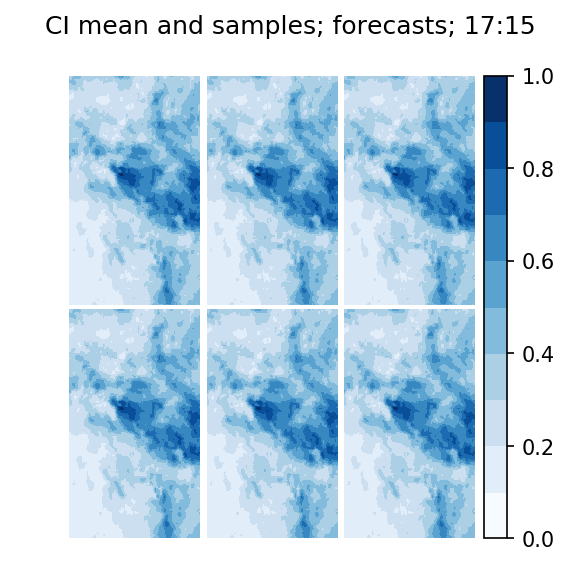

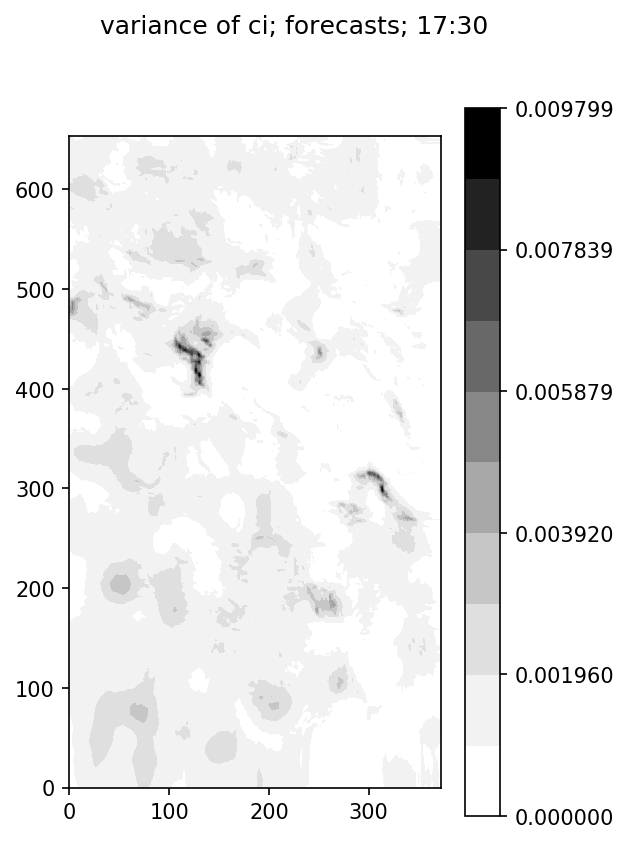

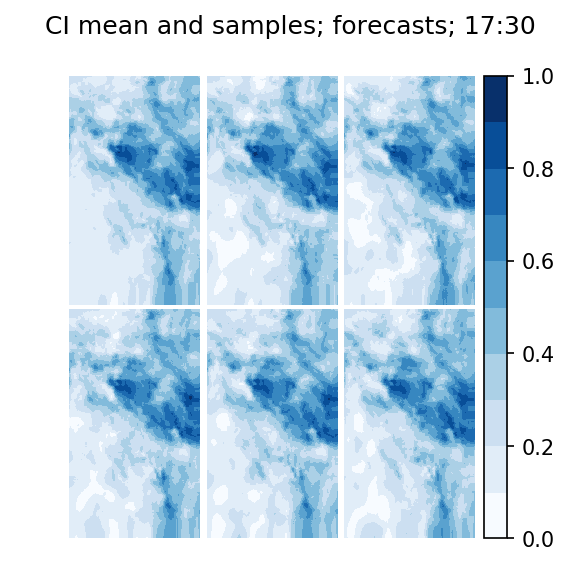

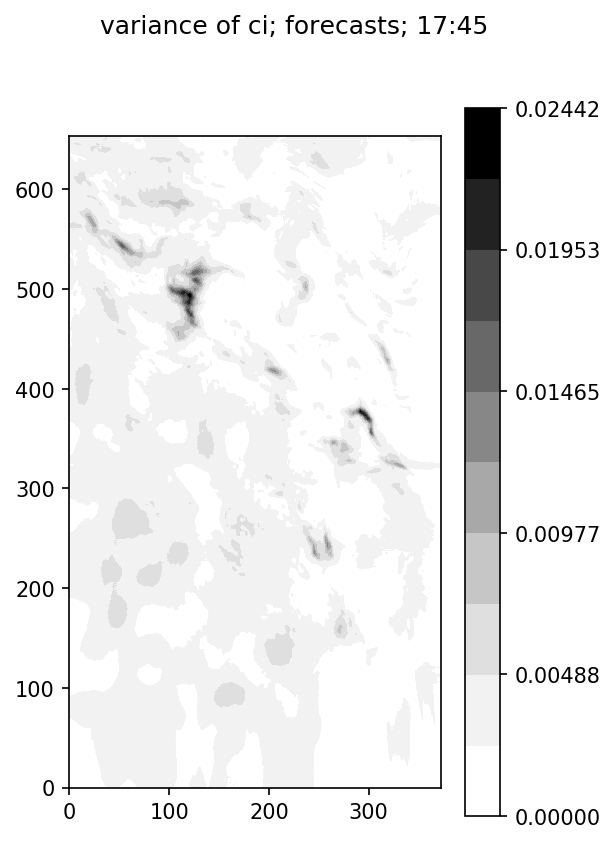

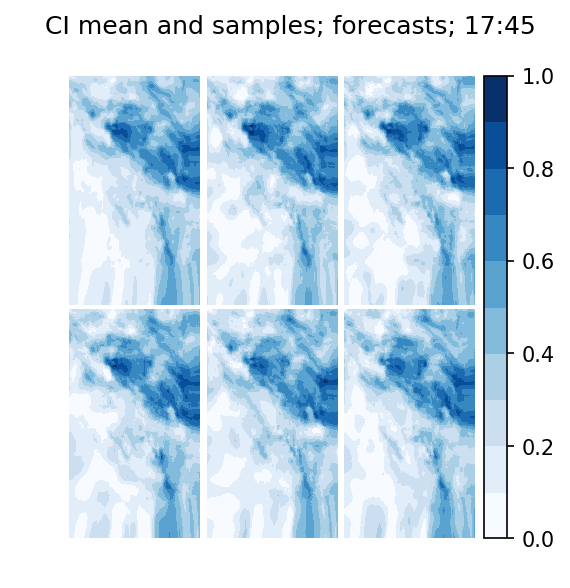

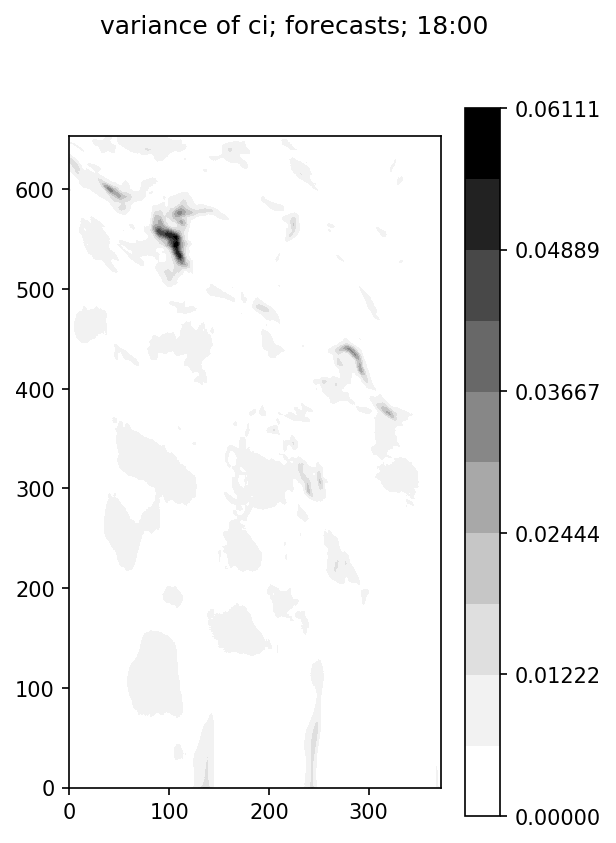

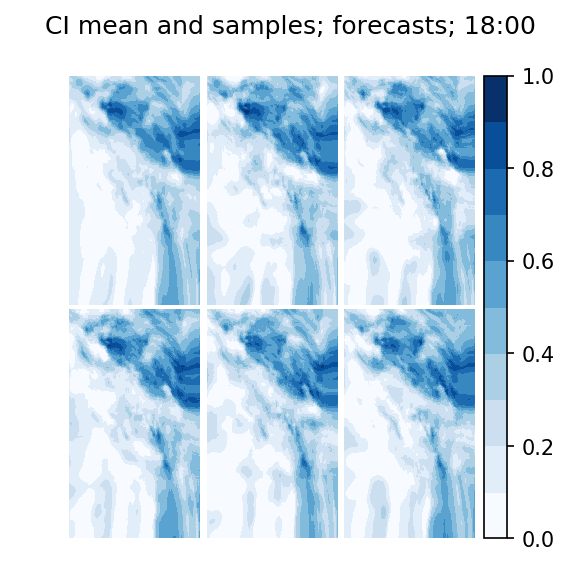

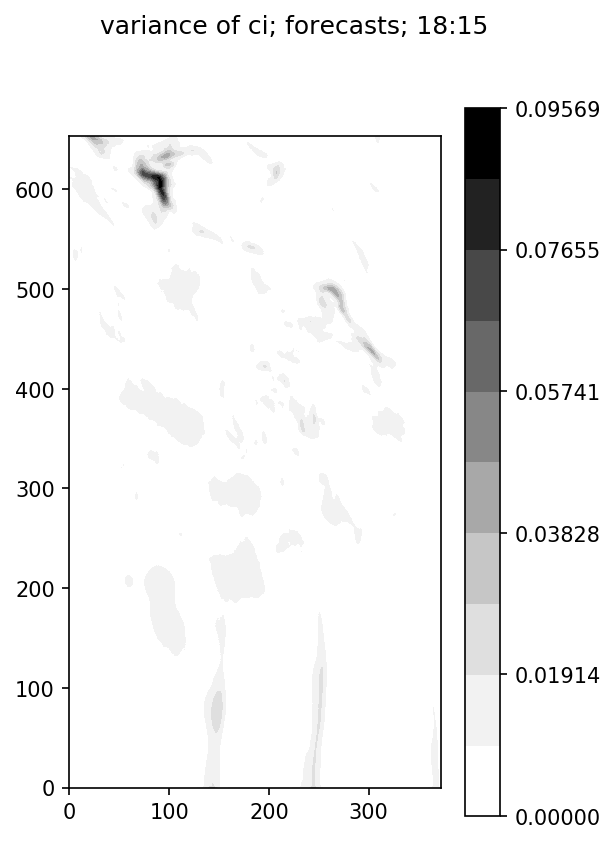

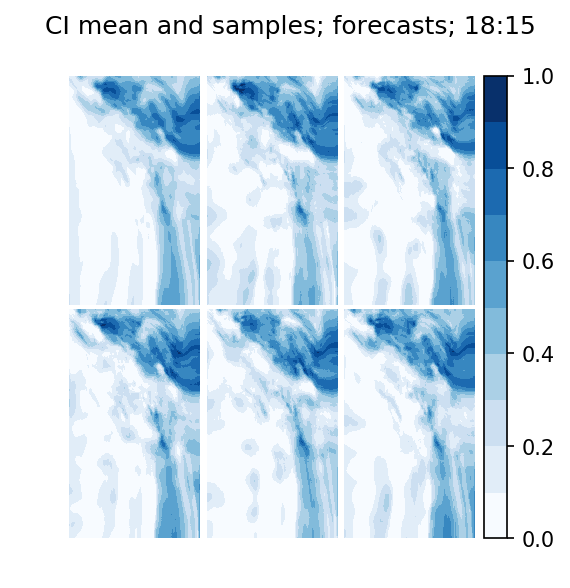

In [66]:
for ii in range(ensemble_array.shape[0]):
    ci_plots(ensemble_array[ii], save_times[ii], 'forecasts')

In [67]:
# lf.save(ensemble_array=ensemble_array, coords=coords,                   
#      ens_params=ens_params, param_dict=param_dict,                   
#      sys_vars=sys_vars, save_times=save_times,                       
#      results_file_path=results_file_path)

In [68]:
time_index = 4
sat_time = coords.sat_times[time_index]                              
logging.info(str(sat_time))

In [69]:
ensemble = lf.maybe_assim_sat2sat(                                      
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    flags=flags)

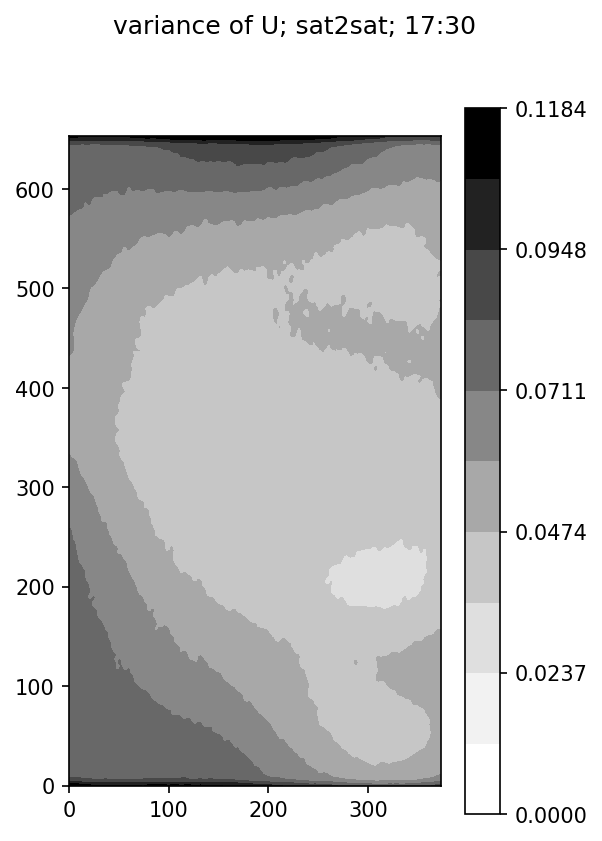

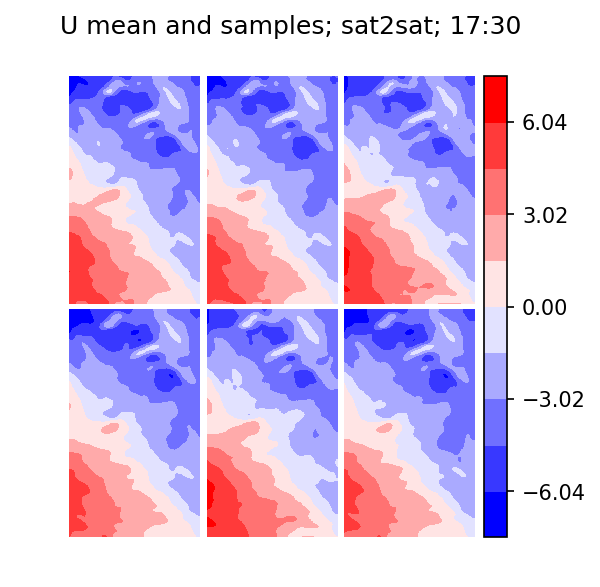

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


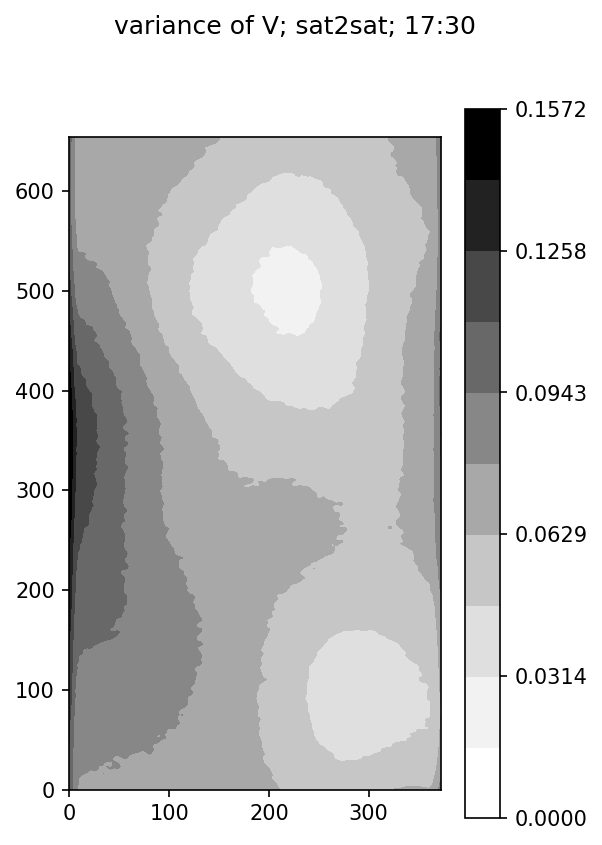

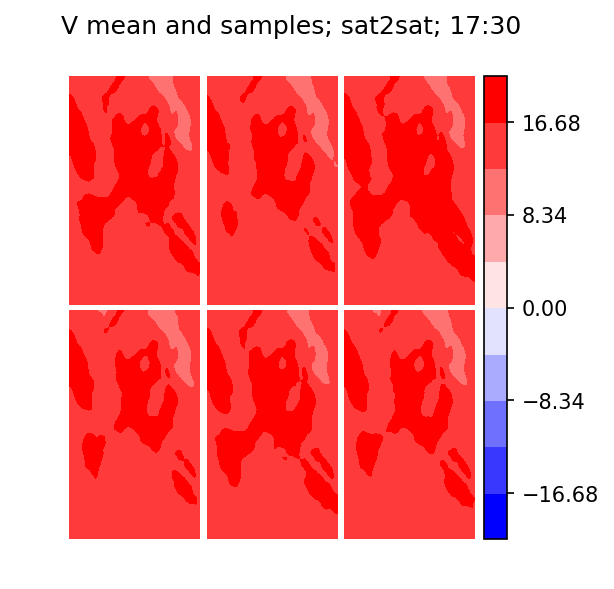

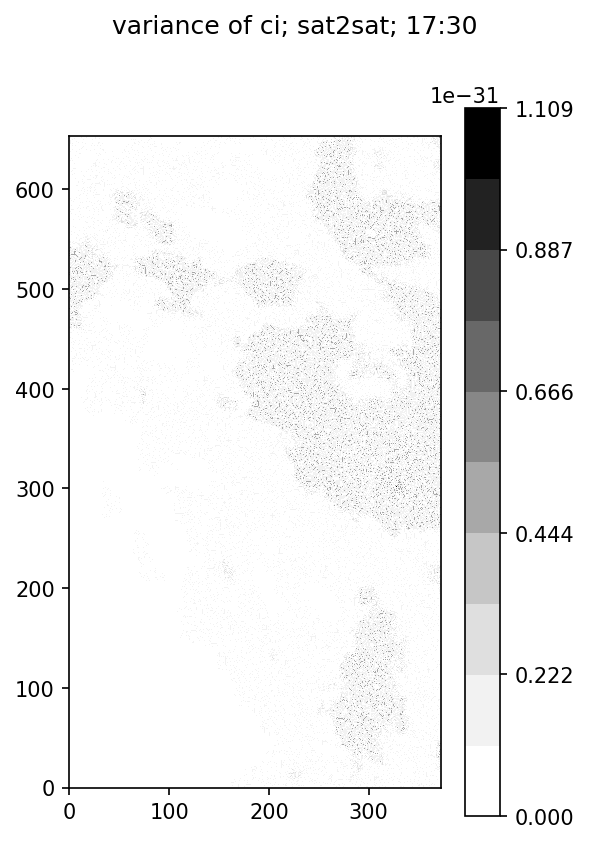

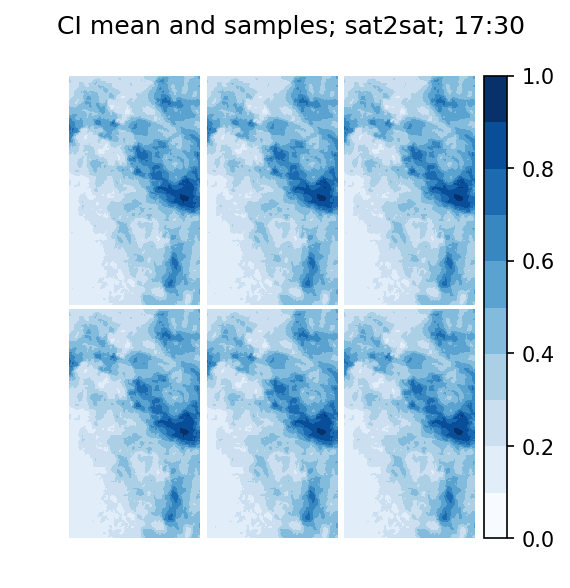

In [70]:
U_plots(ensemble, sat_time, 'sat2sat')
V_plots(ensemble, sat_time, 'sat2sat')
ci_plots(ensemble, sat_time, 'sat2sat')

In [71]:
ensemble, div_sat2wind_flag = lf.maybe_assim_sat2wind(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, sat2wind=sat2wind,                        
    flags=flags)

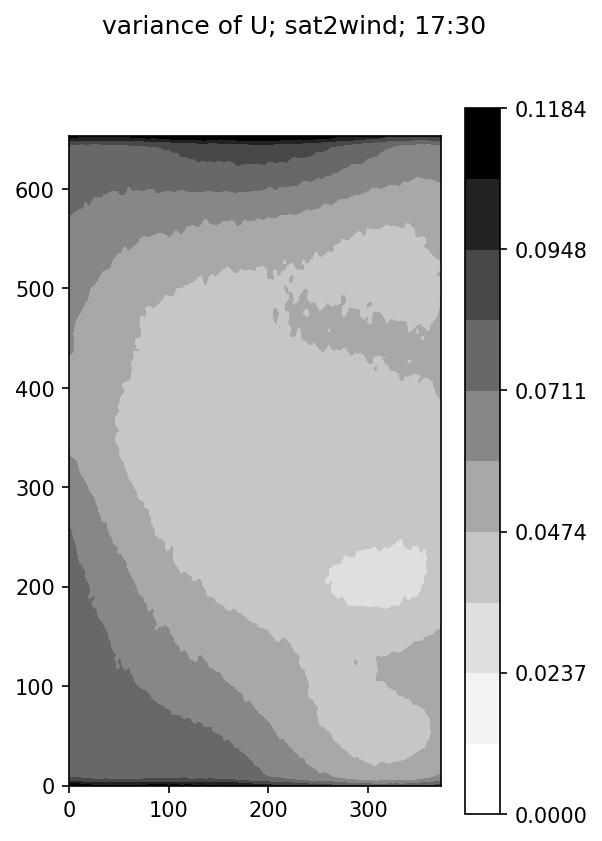

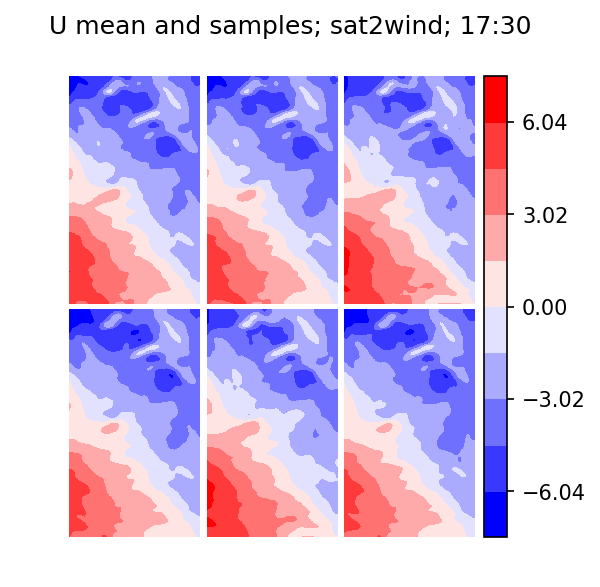

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


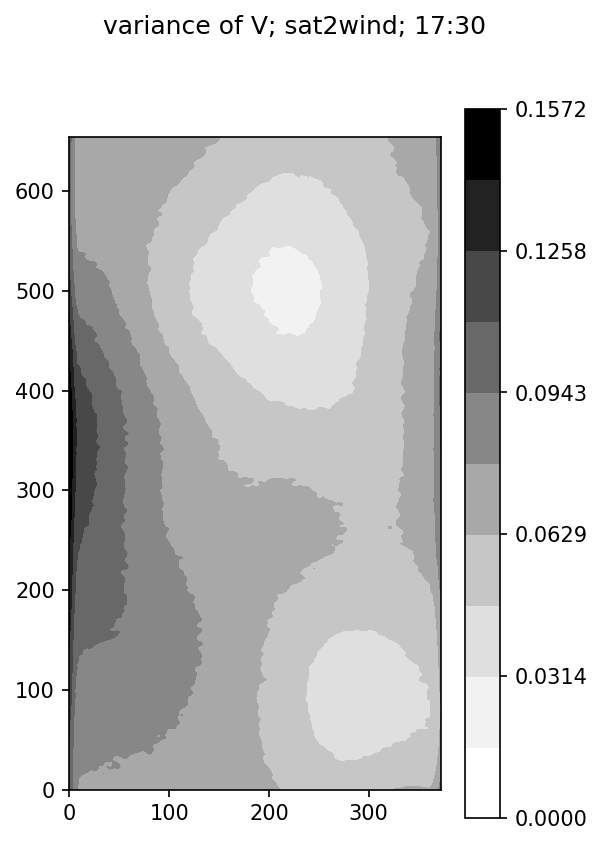

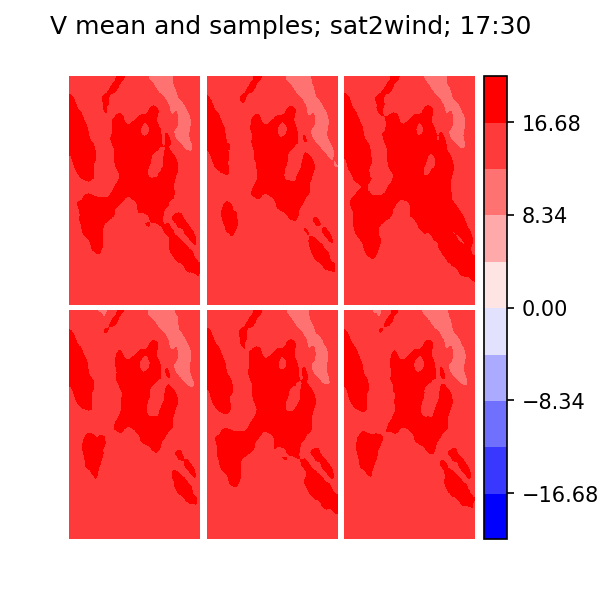

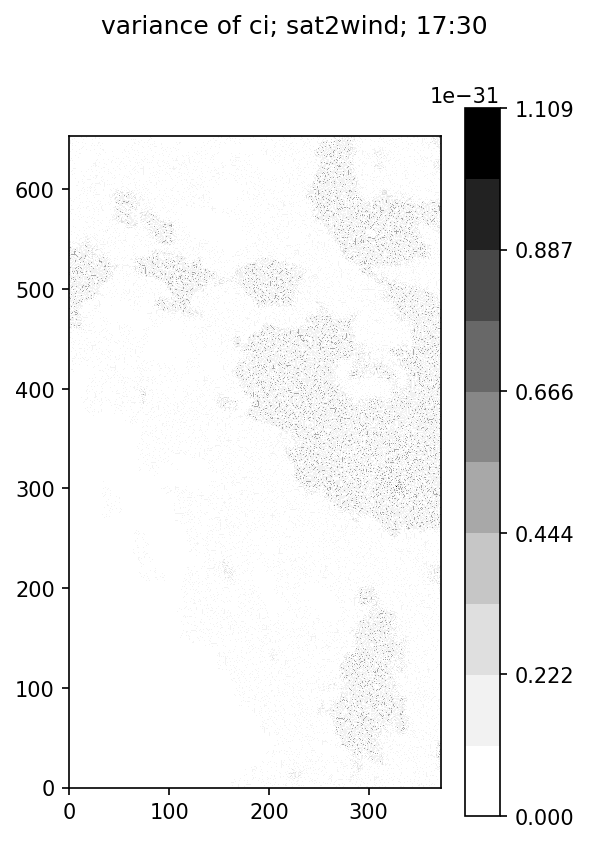

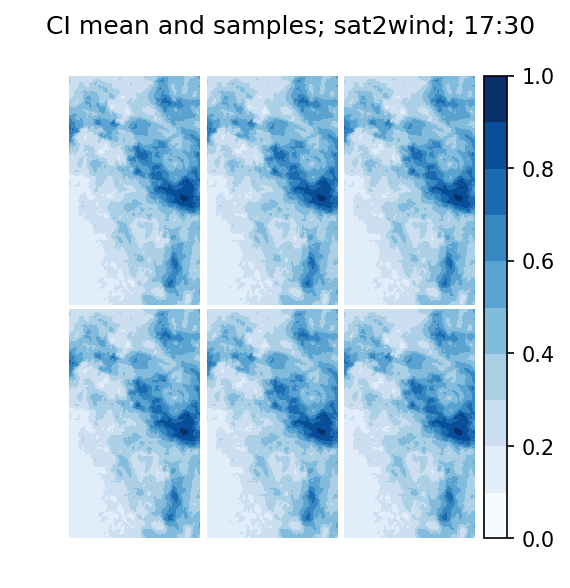

In [72]:
U_plots(ensemble, sat_time, 'sat2wind')
V_plots(ensemble, sat_time, 'sat2wind')
ci_plots(ensemble, sat_time, 'sat2wind')

In [73]:
ensemble, div_wrf_flag = lf.maybe_assim_wrf(                            
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, wrf=wrf,                                  
    ens_params=ens_params,                                           
    flags=flags)

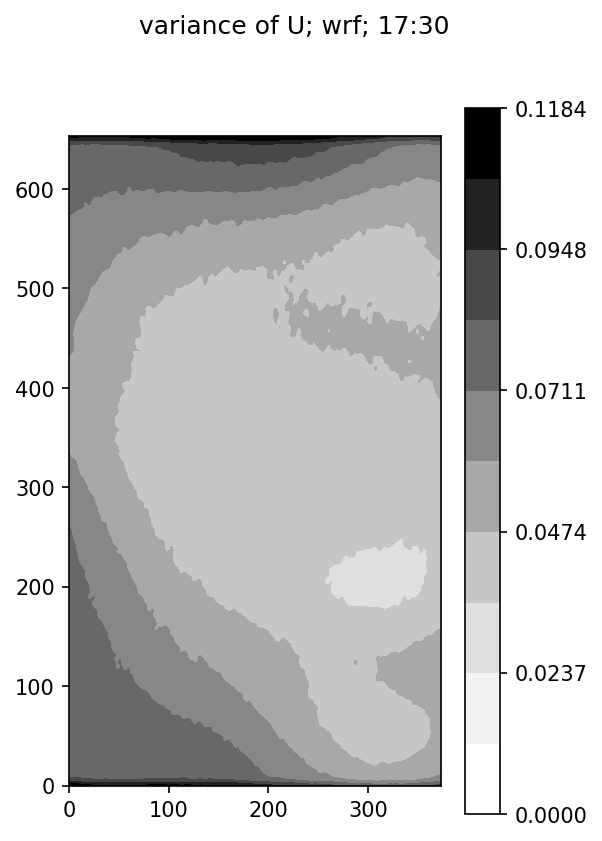

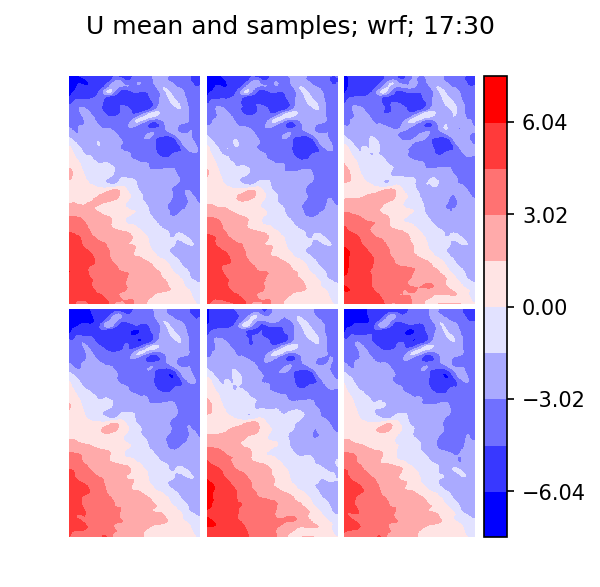

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


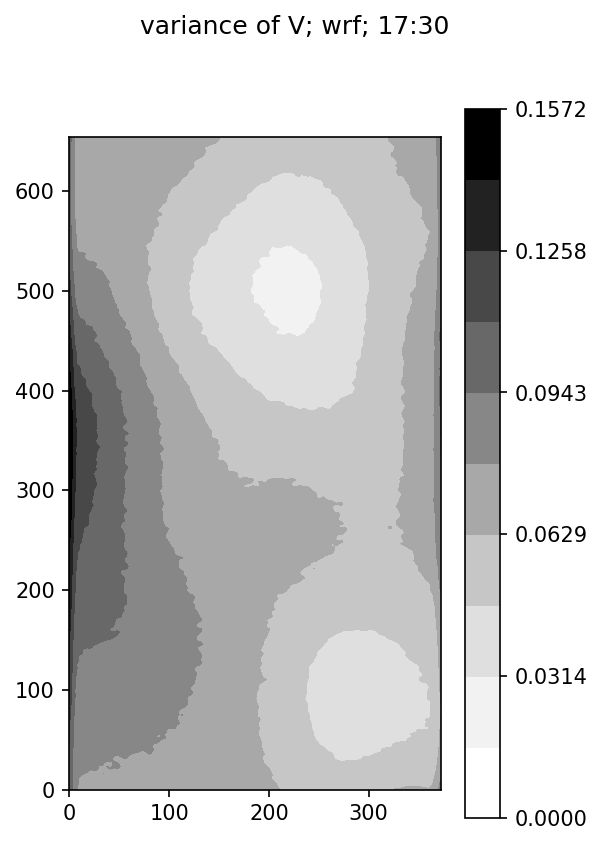

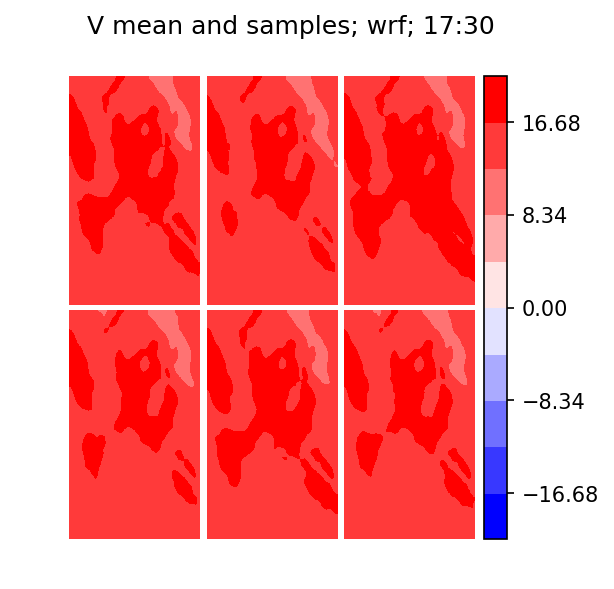

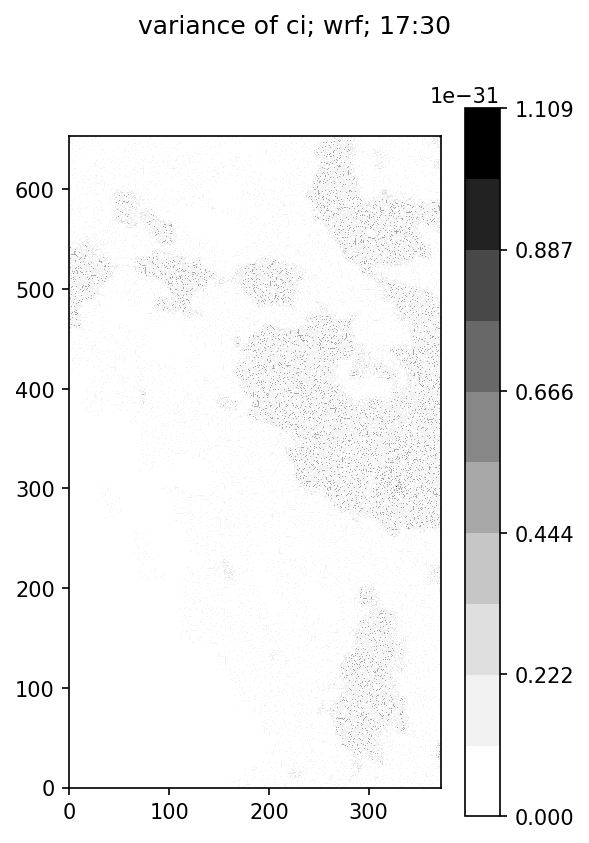

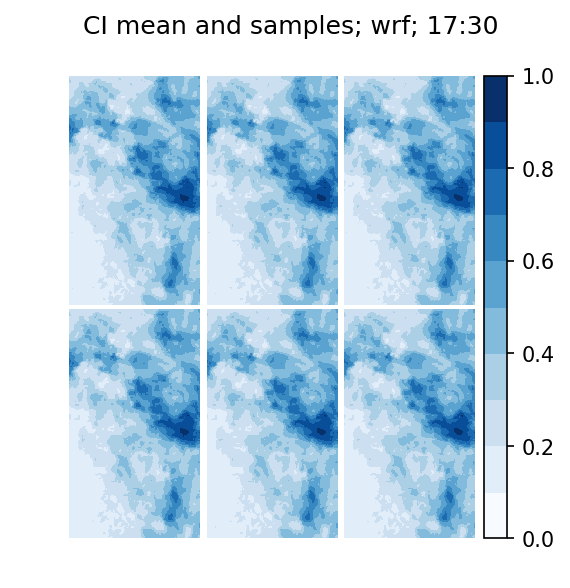

In [74]:
U_plots(ensemble, sat_time, 'wrf')
V_plots(ensemble, sat_time, 'wrf')
ci_plots(ensemble, sat_time, 'wrf')

In [75]:
ensemble_no_opt_flow = ensemble.copy()
returned = lf.maybe_assim_opt_flow(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, time_index=time_index,                        
    coords=coords, sys_vars=sys_vars,                                
    flags=flags, opt_flow=opt_flow)
ensemble, div_opt_flow_flag = returned[:2]
u_opt_flow, v_opt_flow = returned[2:4]
u_flat_pos, v_flat_pos = returned[4:6]

In [76]:
importlib.reload(tp)

<module 'letkf_forecasting.tmh_plot' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/tmh_plot.py'>

(<matplotlib.figure.Figure at 0x7fe78e083f60>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe7c5a646a0>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7fe78e28eda0>], dtype=object))

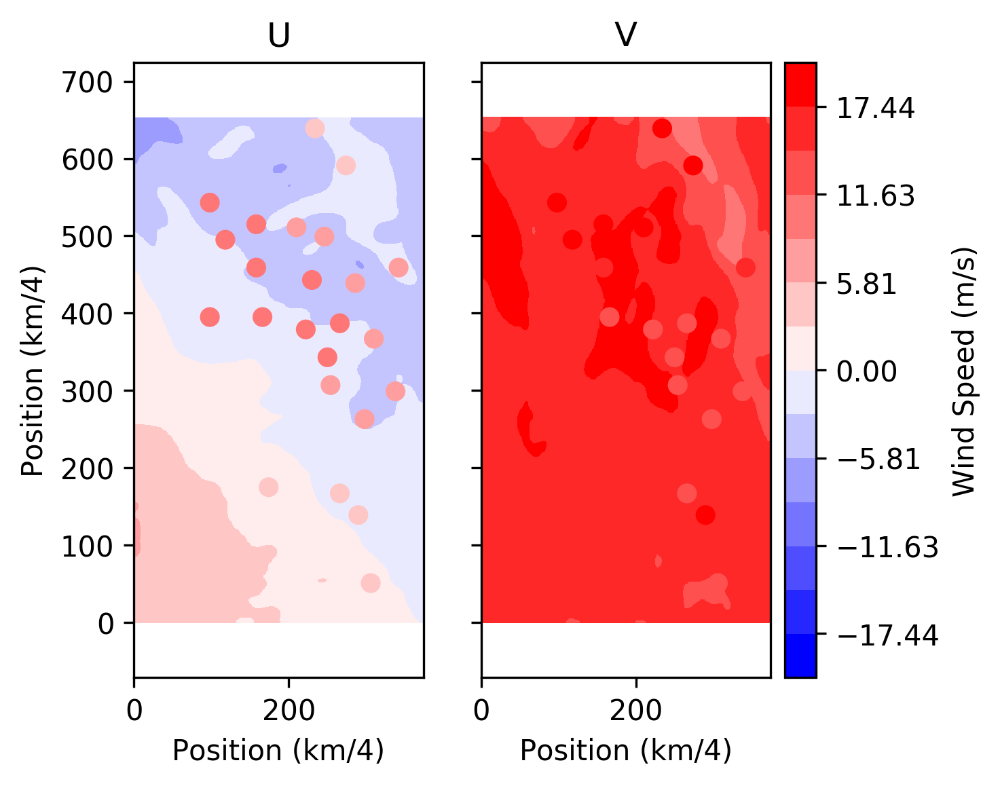

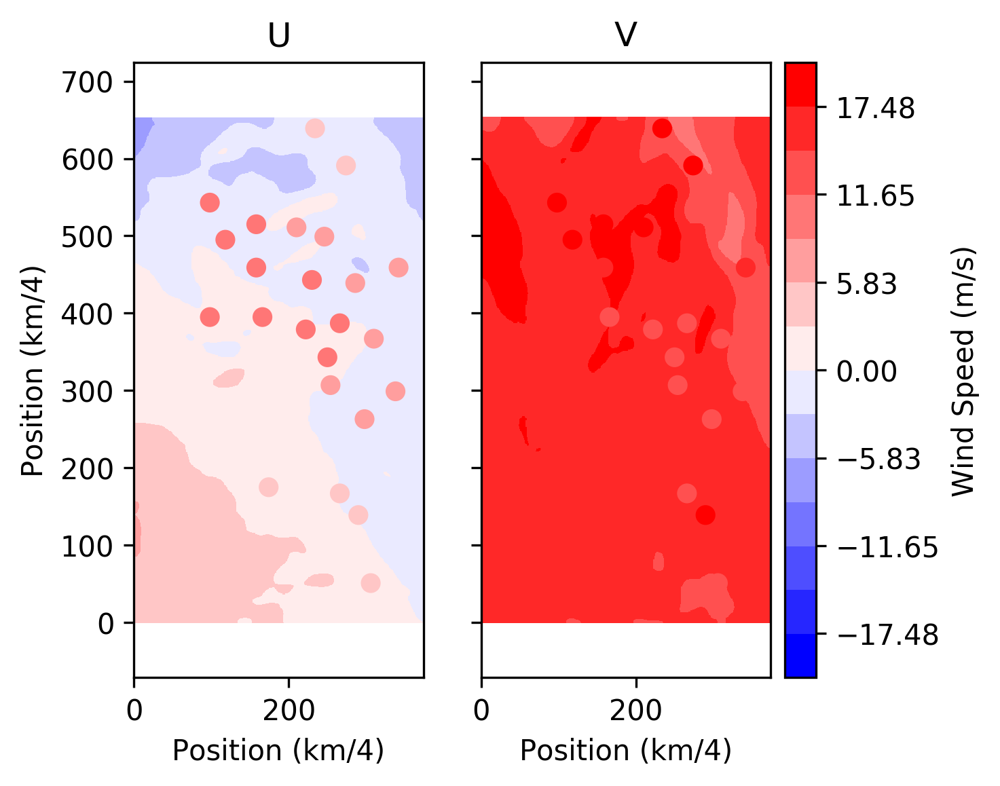

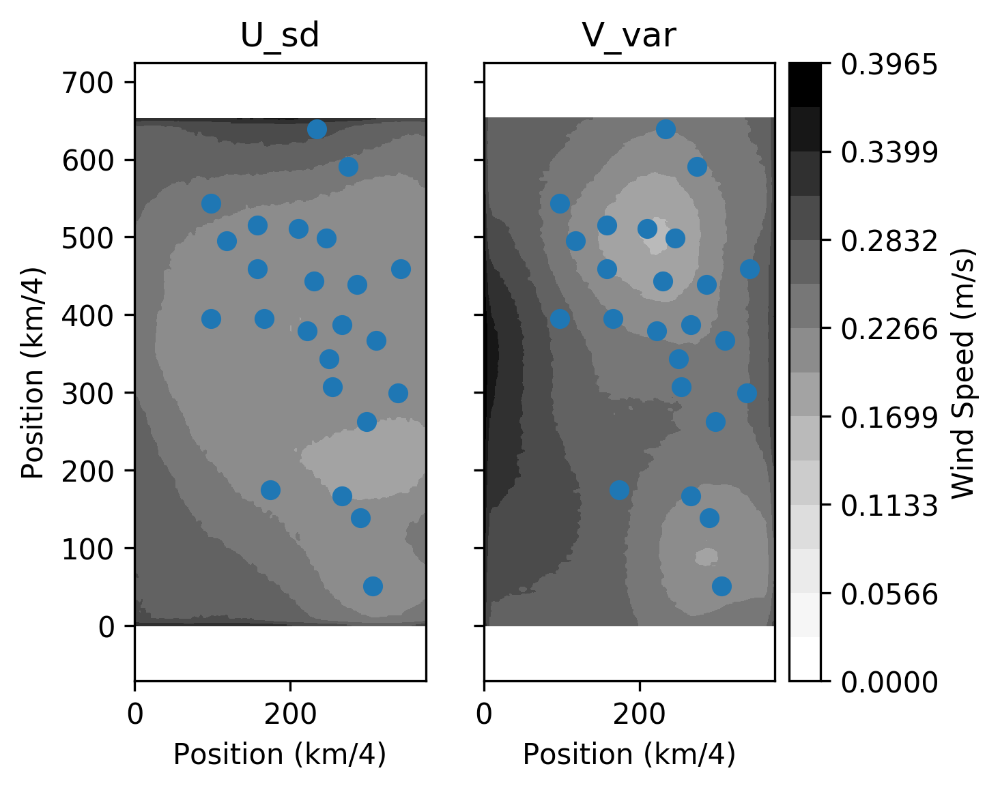

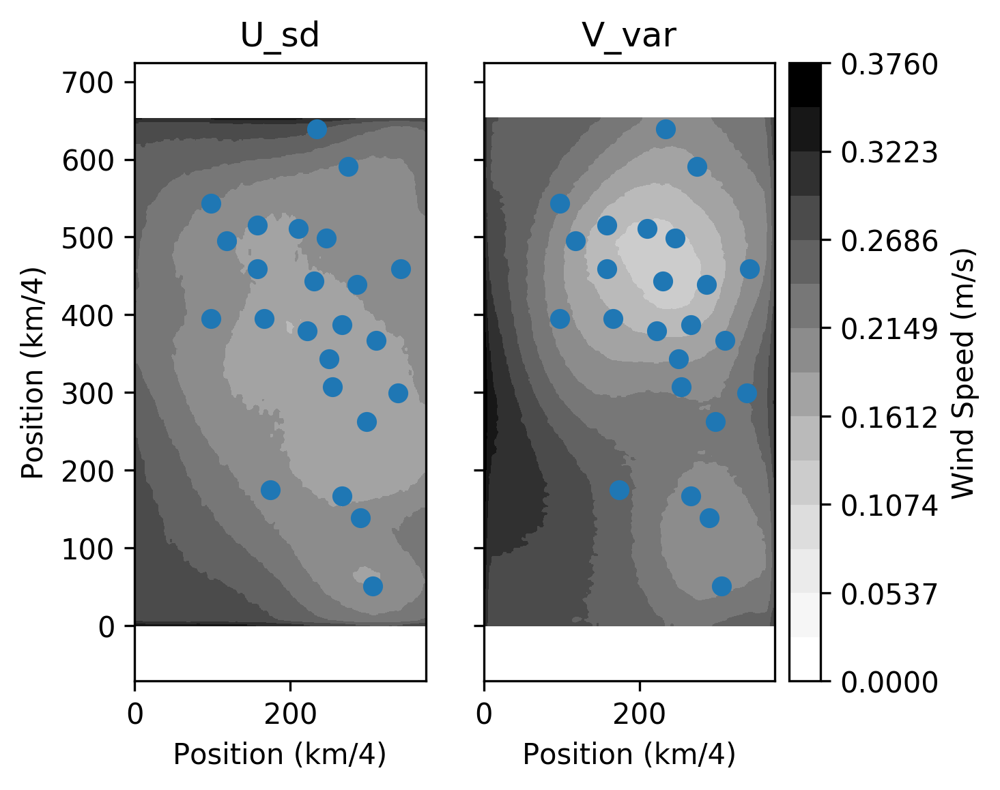

In [77]:
pos = np.array(np.unravel_index(u_flat_pos, sys_vars.U_crop_shape))
tp.wrf_opt_flow_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.wrf_opt_flow_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)

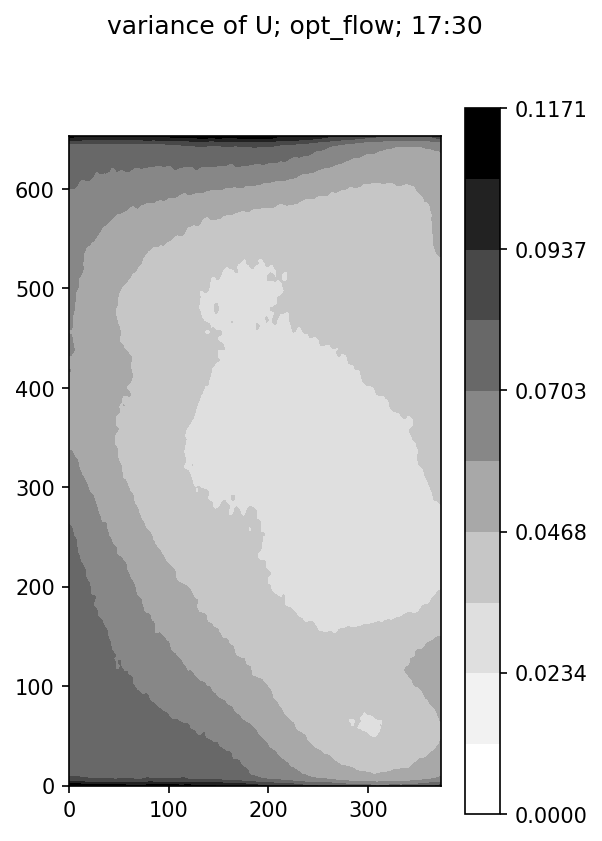

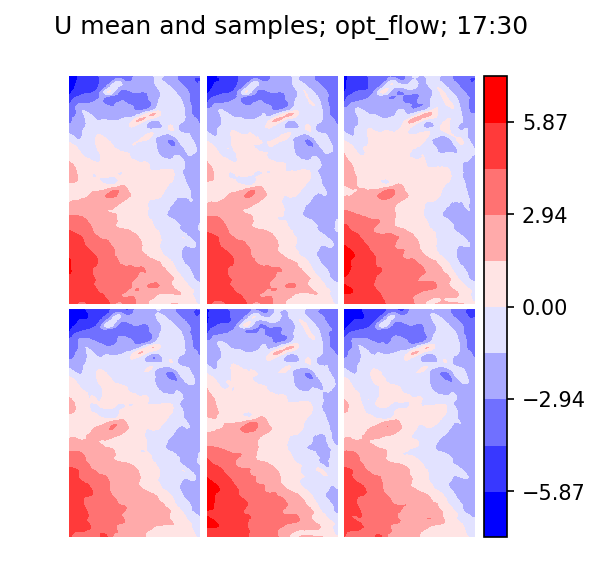

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


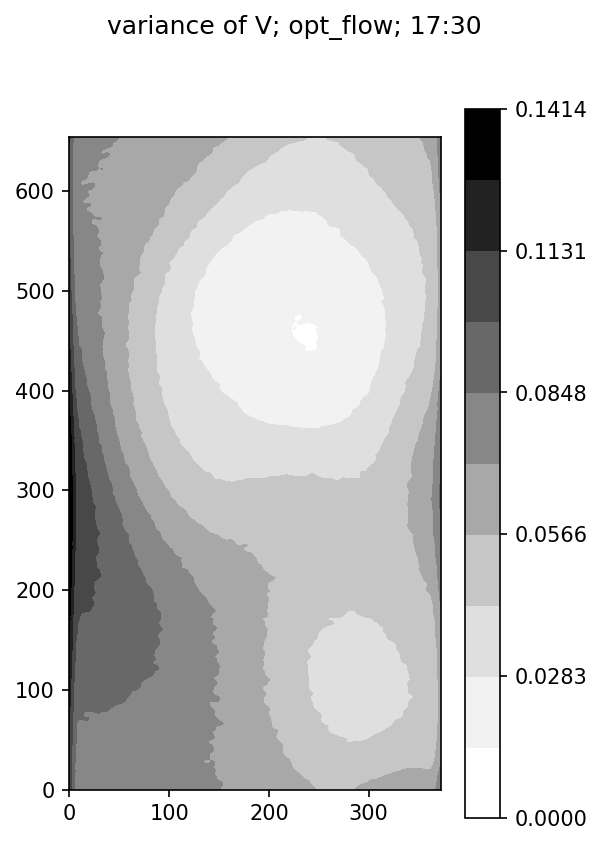

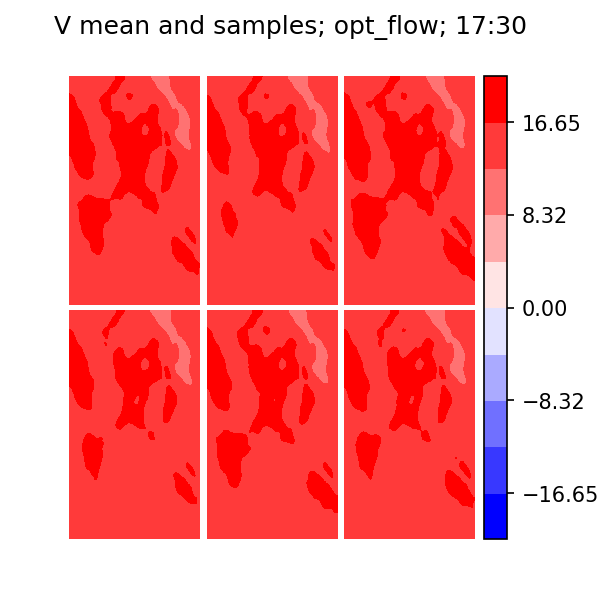

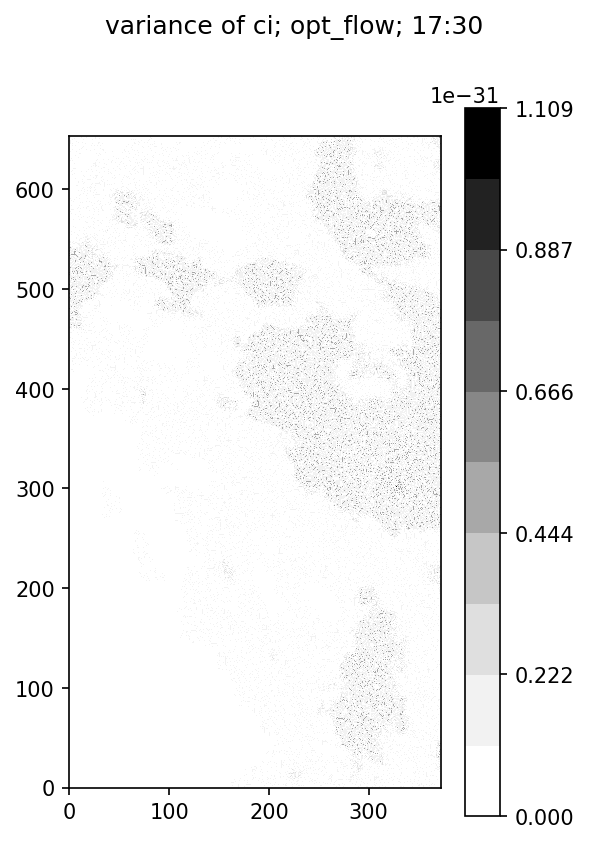

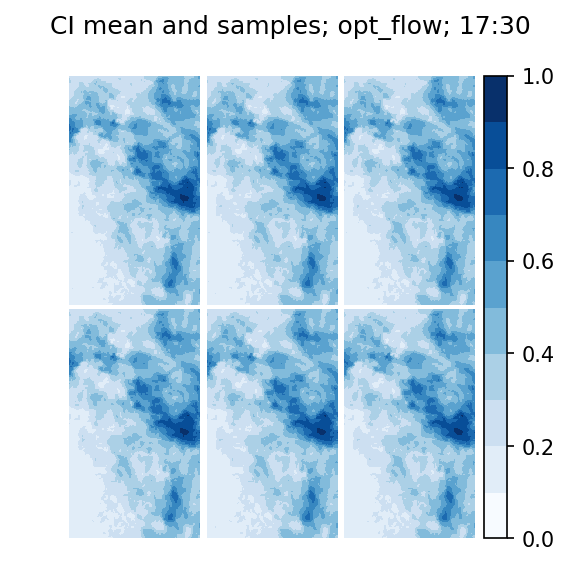

In [78]:
U_plots(ensemble, sat_time, 'opt_flow')
V_plots(ensemble, sat_time, 'opt_flow')
ci_plots(ensemble, sat_time, 'opt_flow')

In [79]:
remove_div_flag = (div_sat2wind_flag                                 
                   or div_wrf_flag                                   
                   or div_opt_flow_flag)                             
ensemble, remove_div_flag = lf.preprocess(                              
    ensemble=ensemble, flags=flags,                                  
    remove_div_flag=remove_div_flag,                                 
    coords=coords, sys_vars=sys_vars)

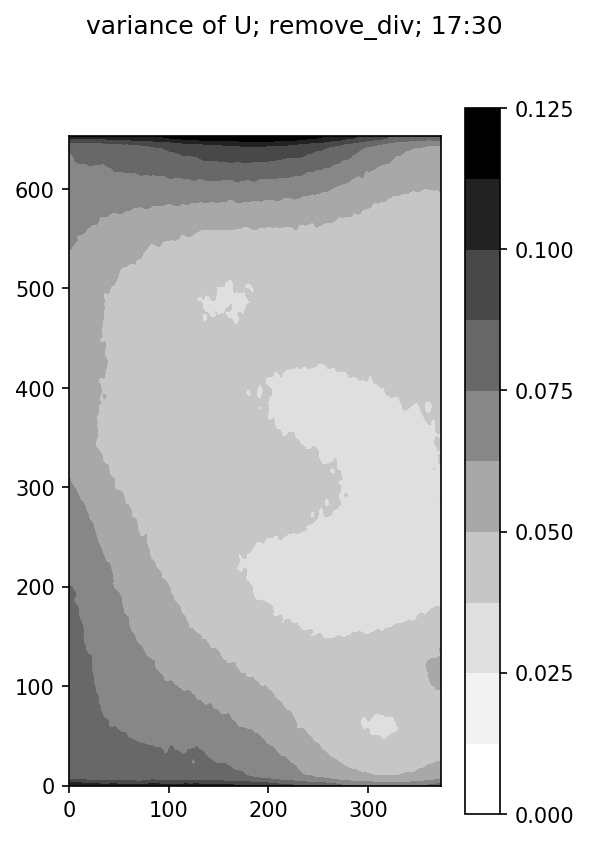

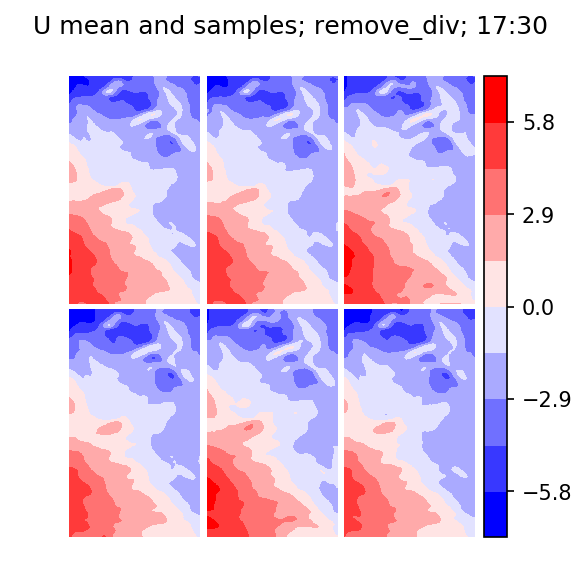

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


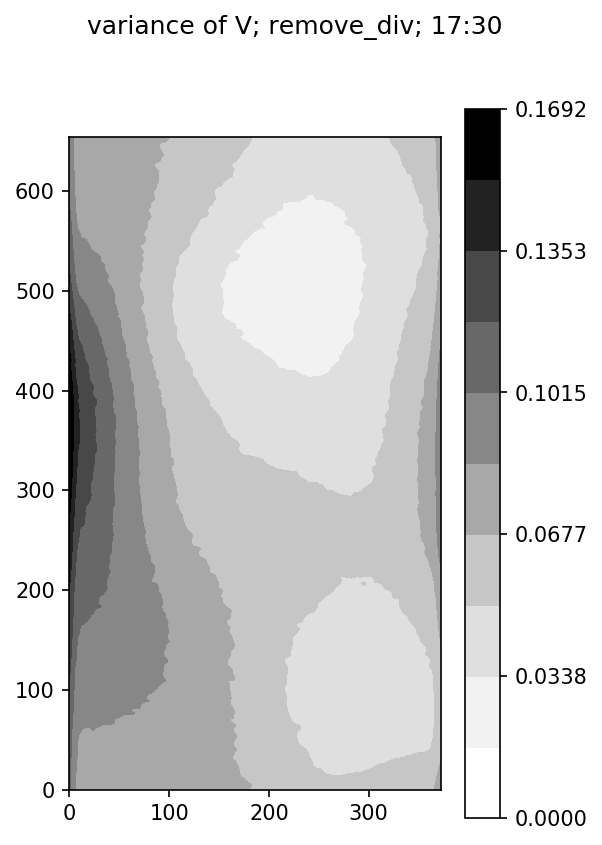

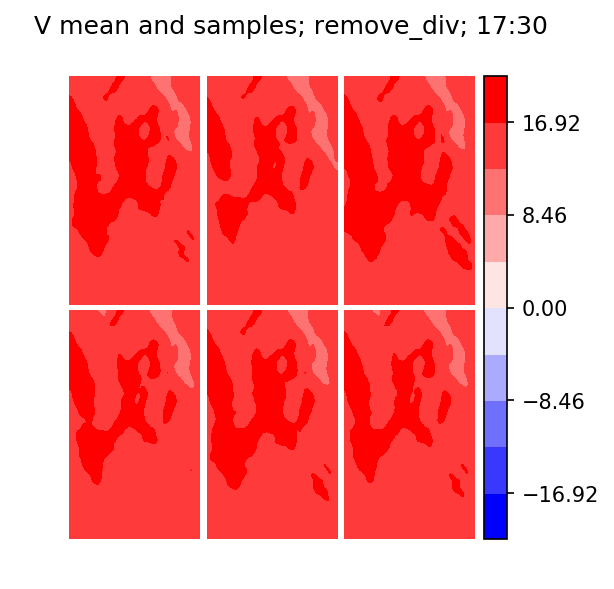

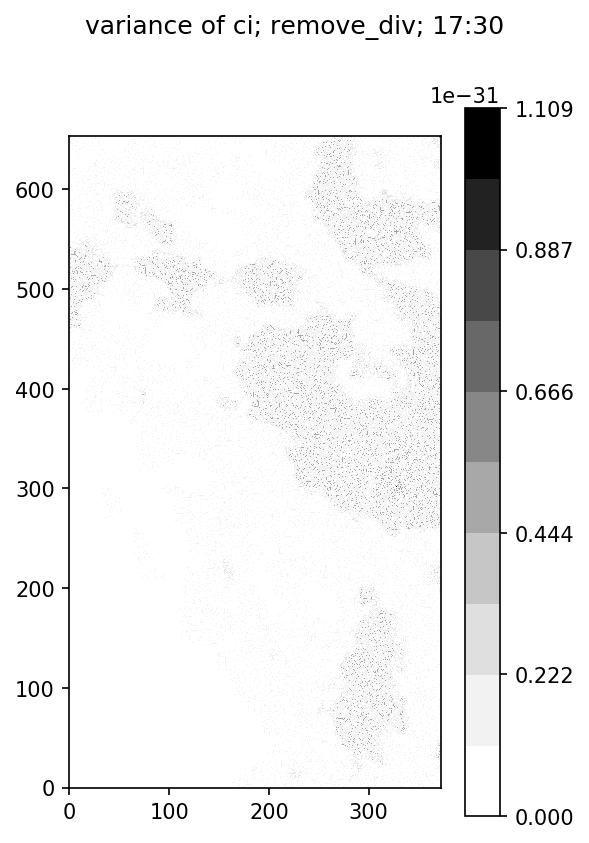

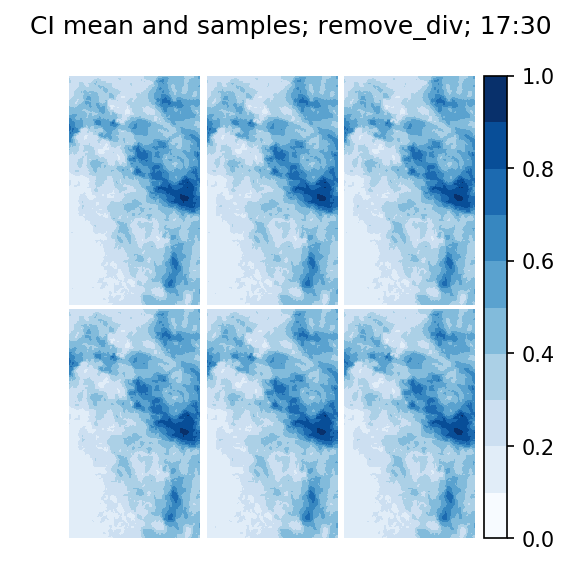

In [80]:
U_plots(ensemble, sat_time, 'remove_div')
V_plots(ensemble, sat_time, 'remove_div')
ci_plots(ensemble, sat_time, 'remove_div')

In [81]:
ensemble_array, save_times, ensemble = lf.forecast(                     
    ensemble=ensemble, sat_time=sat_time,                            
    flags=flags, coords=coords, time_index=time_index,               
    sys_vars=sys_vars,                                               
    advect_params=advect_params, pert_params=pert_params,            
    assim_vars=assim_vars)

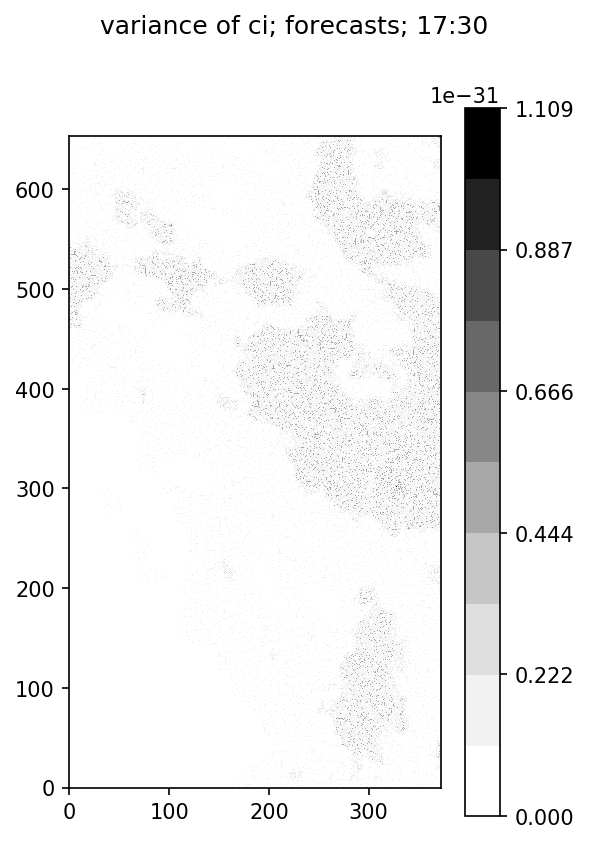

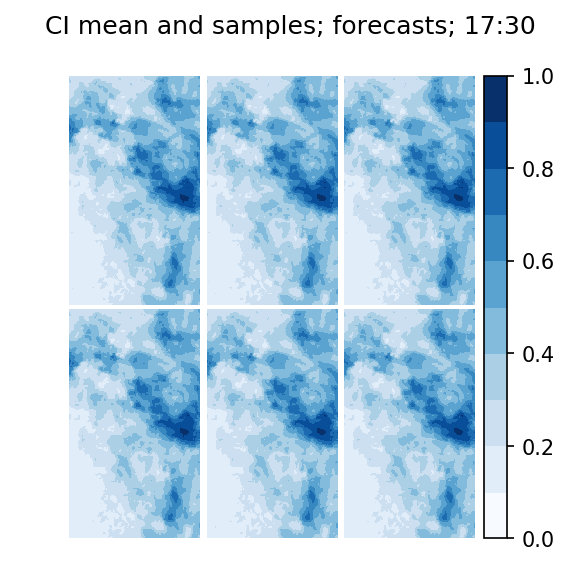

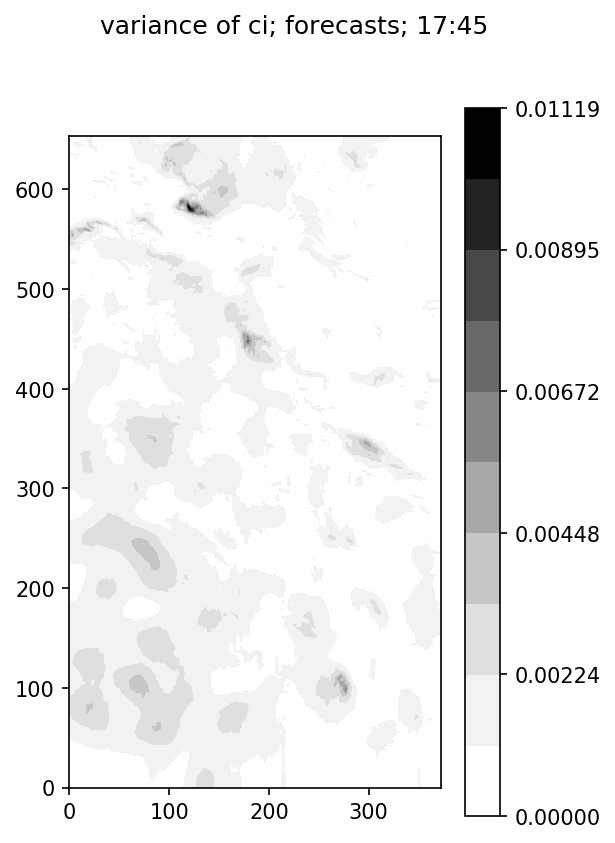

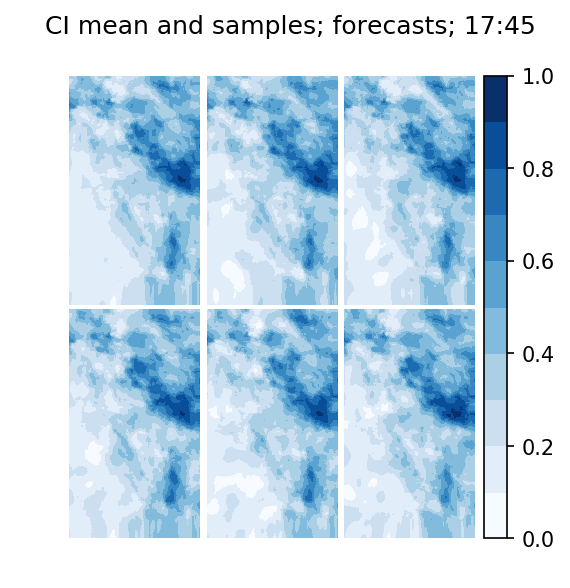

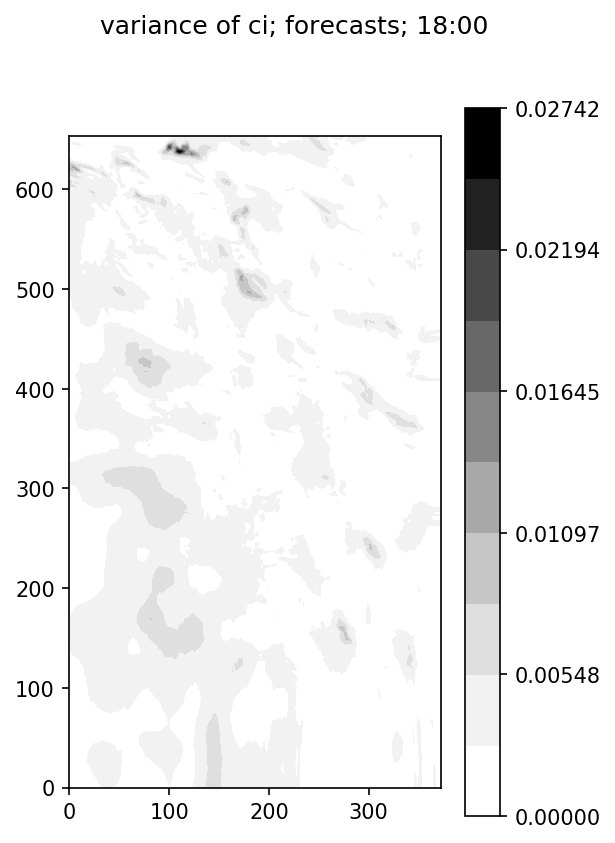

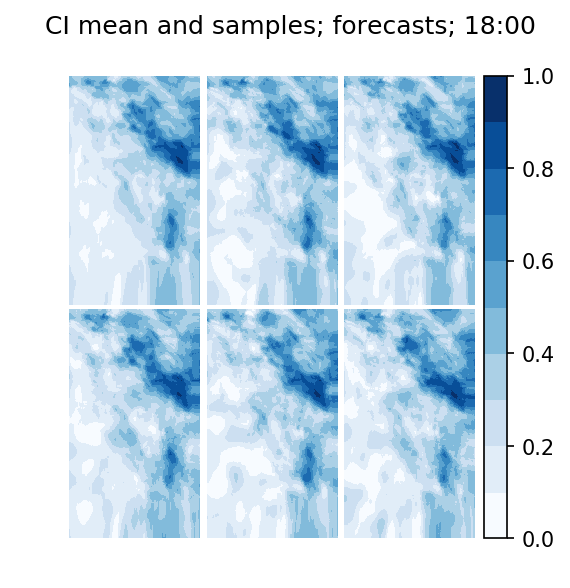

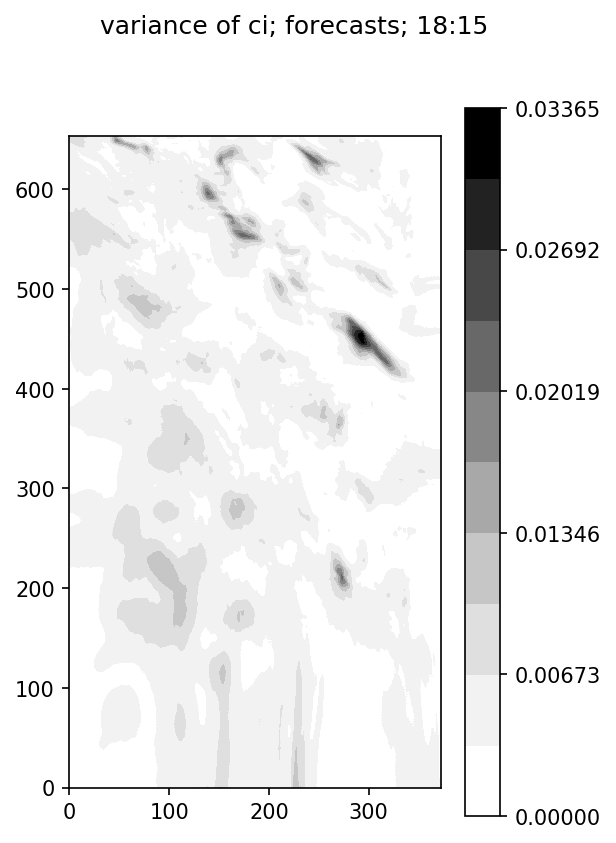

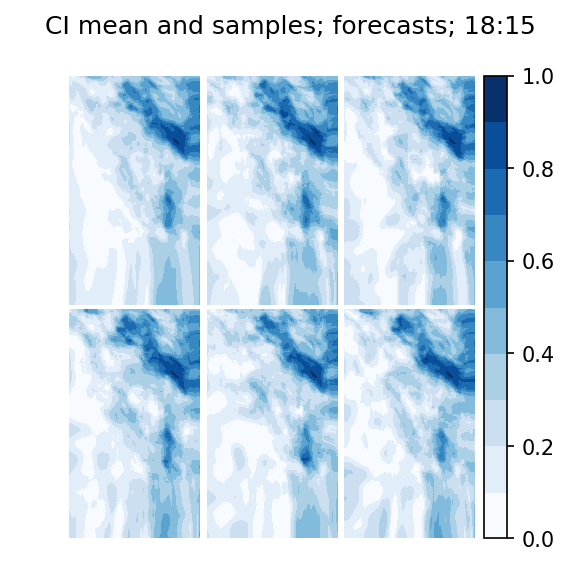

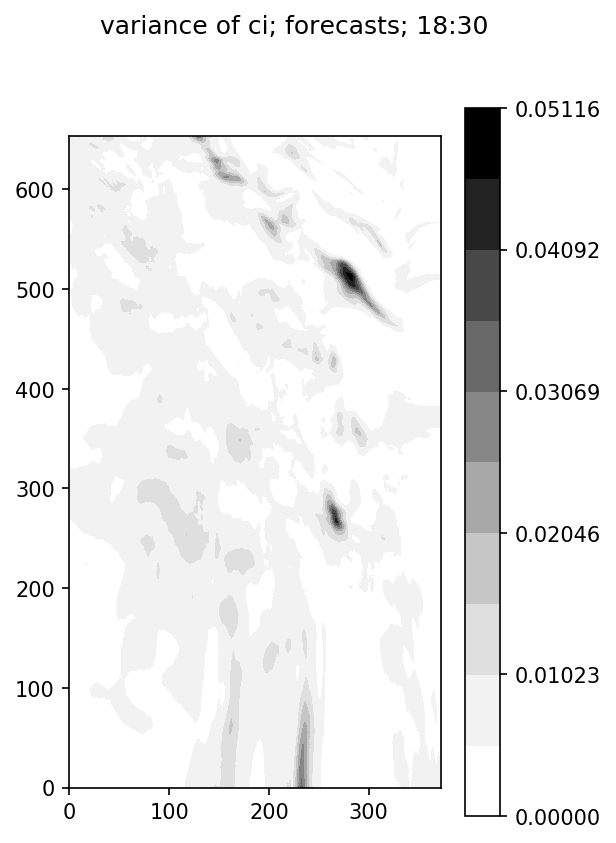

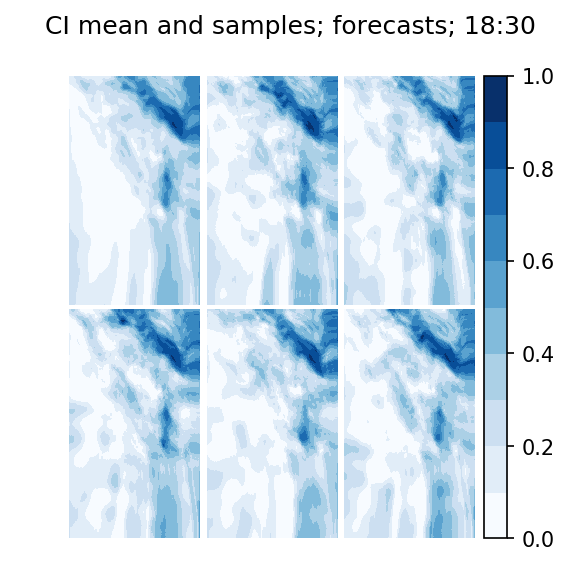

In [82]:
for ii in range(ensemble_array.shape[0]):
    ci_plots(ensemble_array[ii], save_times[ii], 'forecasts')

In [83]:
# lf.save(ensemble_array=ensemble_array, coords=coords,                   
#      ens_params=ens_params, param_dict=param_dict,                   
#      sys_vars=sys_vars, save_times=save_times,                       
#      results_file_path=results_file_path)

In [84]:
time_index = 5
sat_time = coords.sat_times[time_index]                              
logging.info(str(sat_time))

In [85]:
ensemble = lf.maybe_assim_sat2sat(                                      
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    flags=flags)

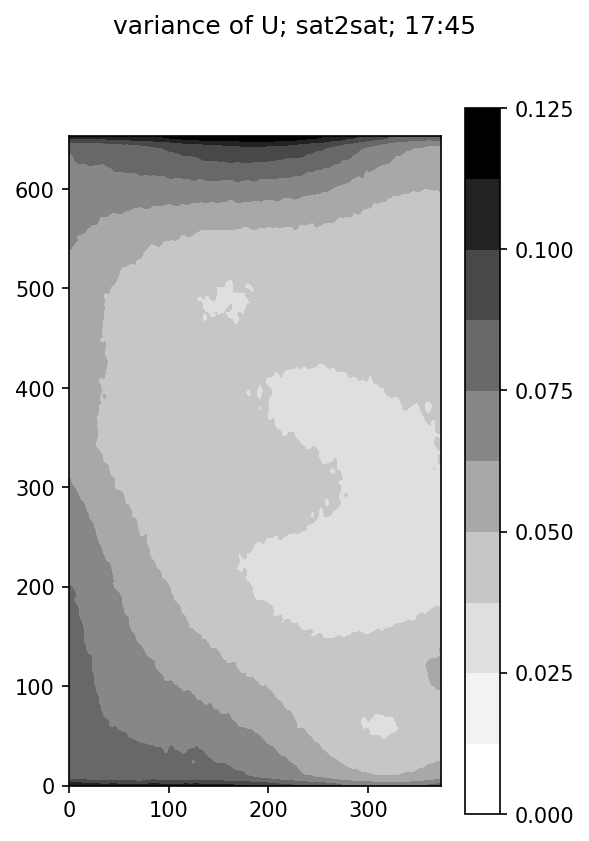

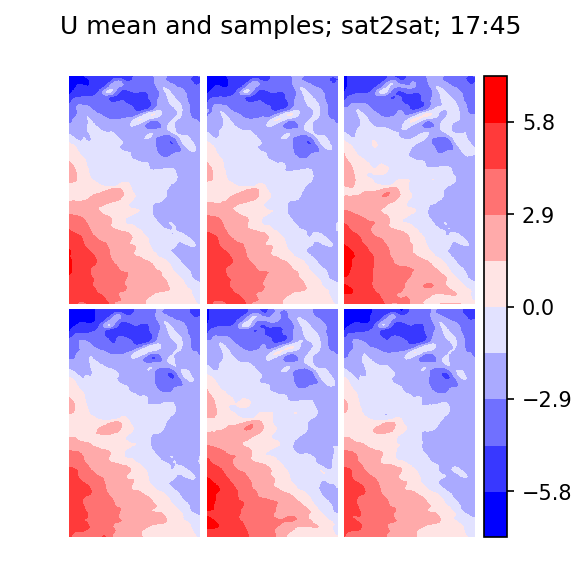

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


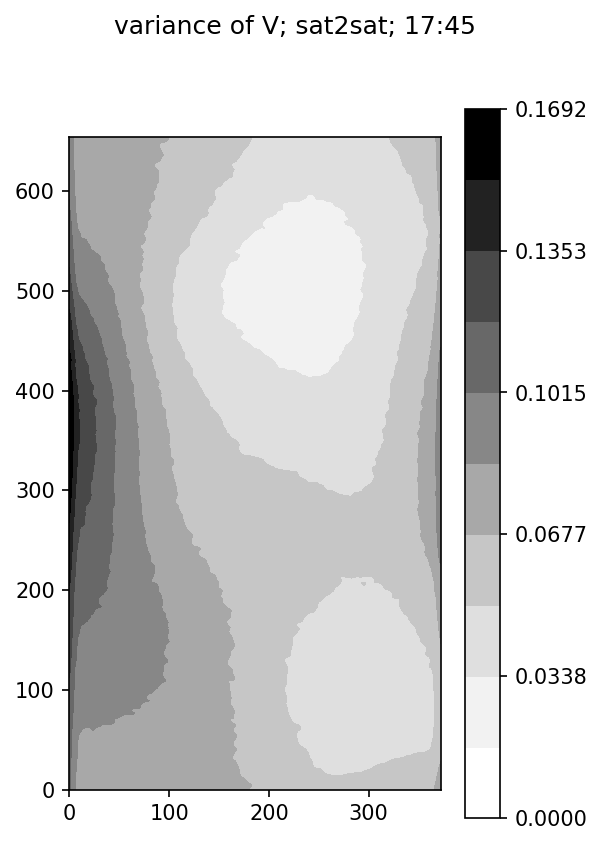

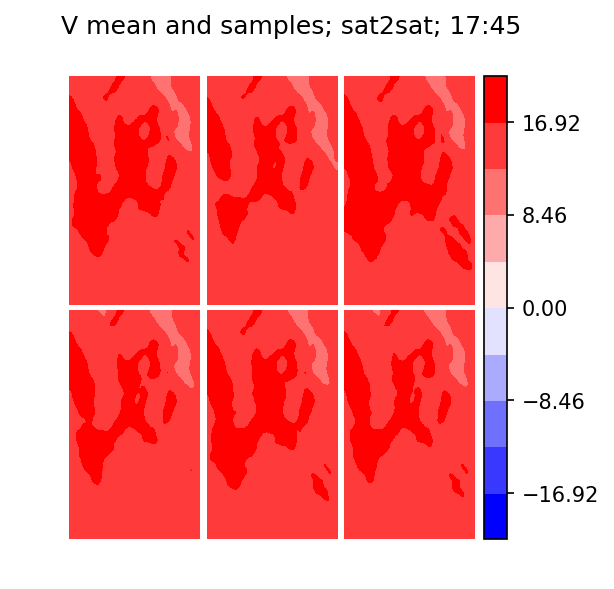

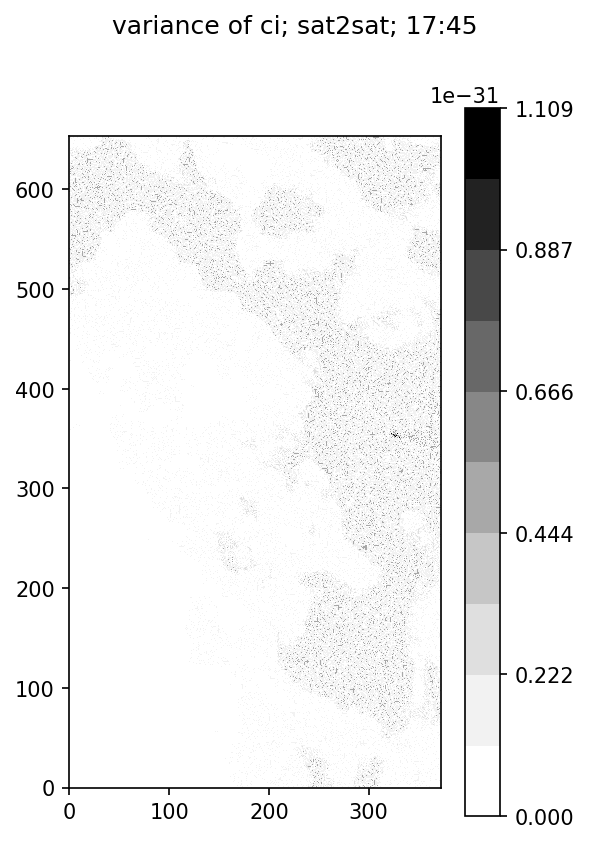

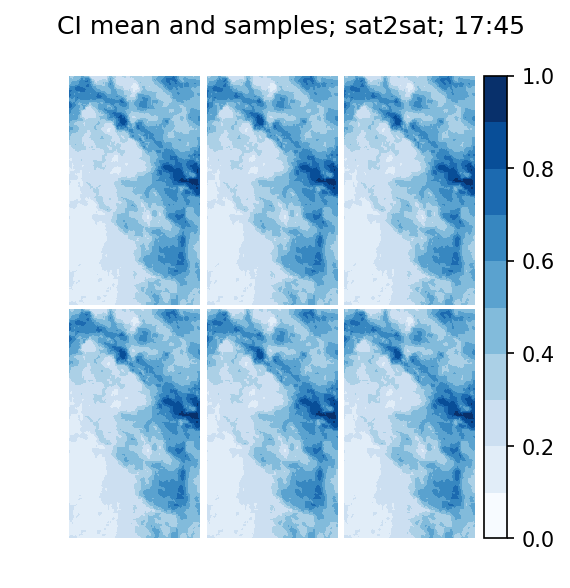

In [86]:
U_plots(ensemble, sat_time, 'sat2sat')
V_plots(ensemble, sat_time, 'sat2sat')
ci_plots(ensemble, sat_time, 'sat2sat')

In [87]:
ensemble, div_sat2wind_flag = lf.maybe_assim_sat2wind(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, sat2wind=sat2wind,                        
    flags=flags)

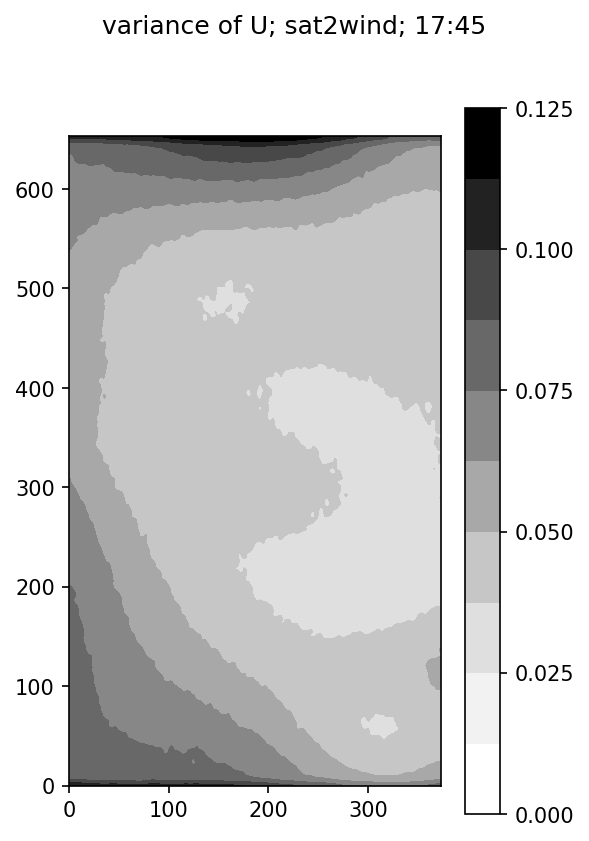

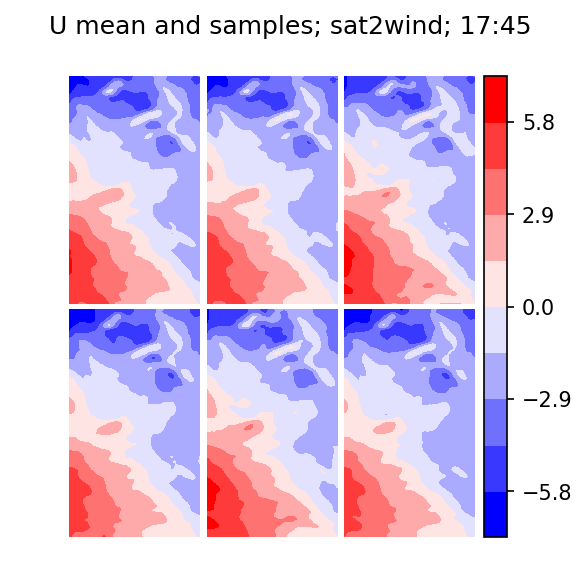

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


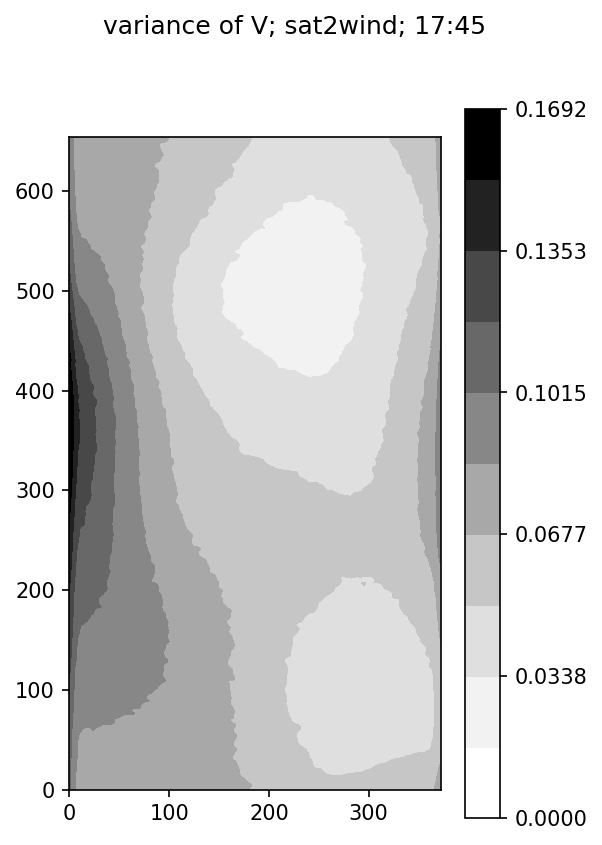

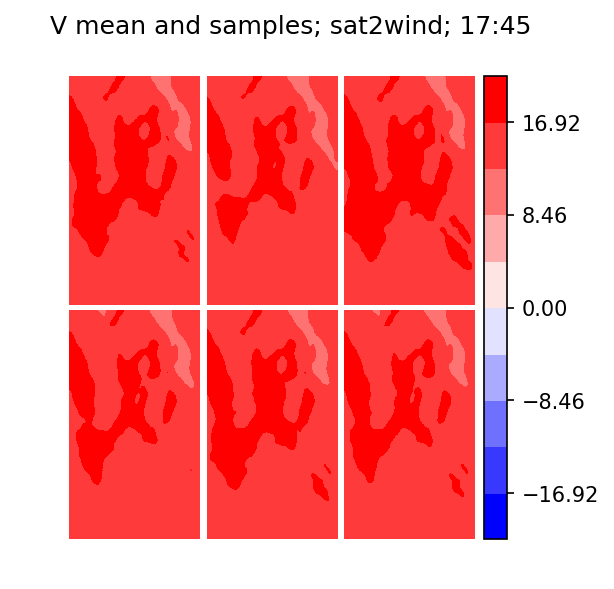

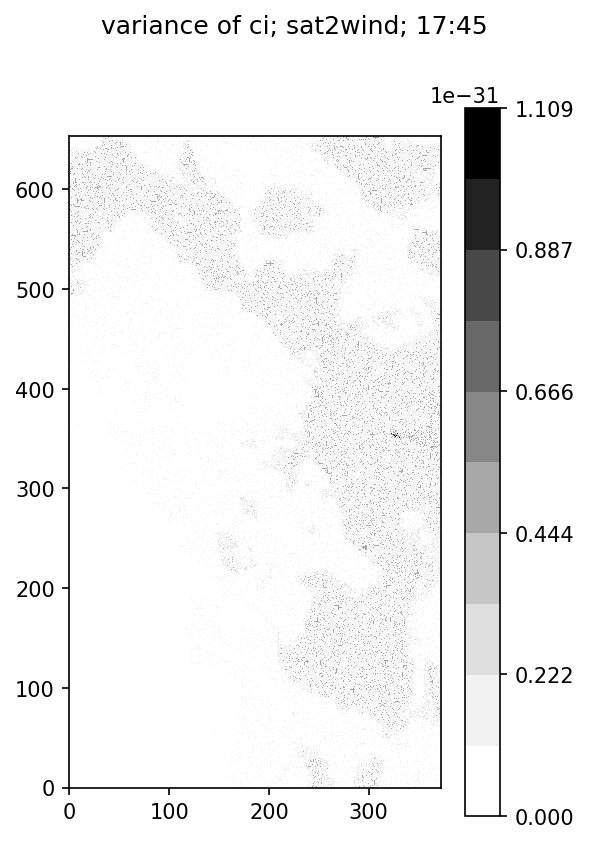

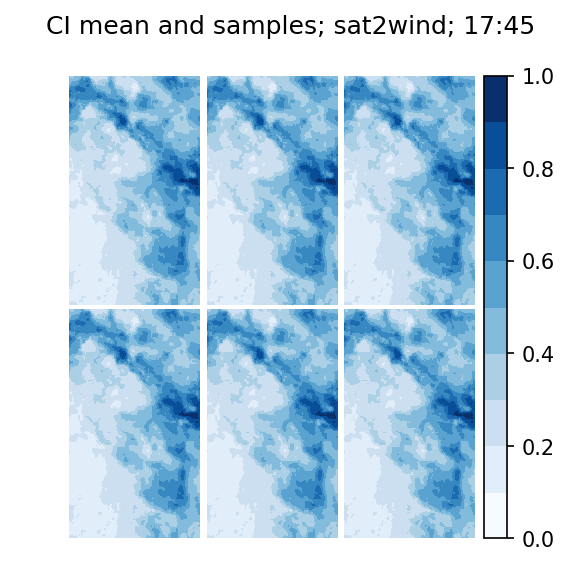

In [88]:
U_plots(ensemble, sat_time, 'sat2wind')
V_plots(ensemble, sat_time, 'sat2wind')
ci_plots(ensemble, sat_time, 'sat2wind')

In [89]:
ensemble, div_wrf_flag = lf.maybe_assim_wrf(                            
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, coords=coords, sys_vars=sys_vars,             
    assim_vars=assim_vars, wrf=wrf,                                  
    ens_params=ens_params,                                           
    flags=flags)

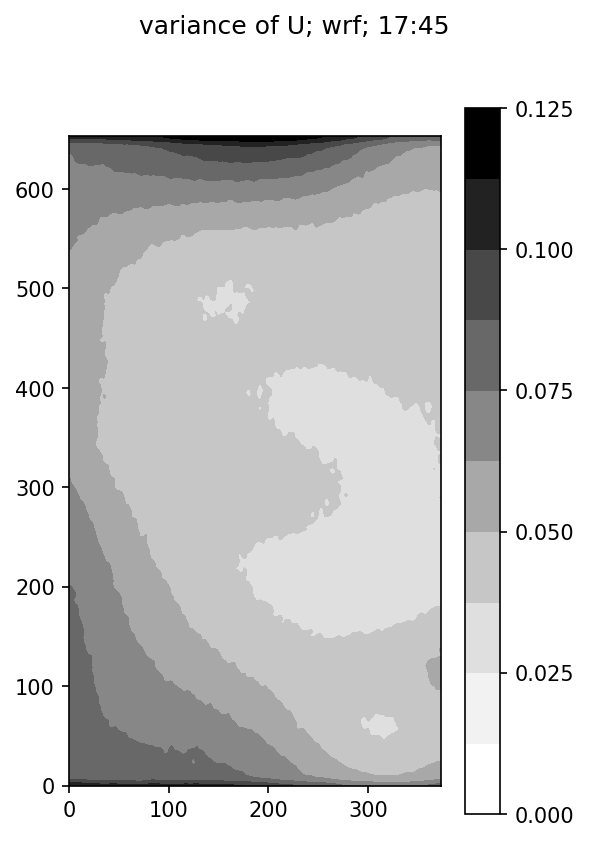

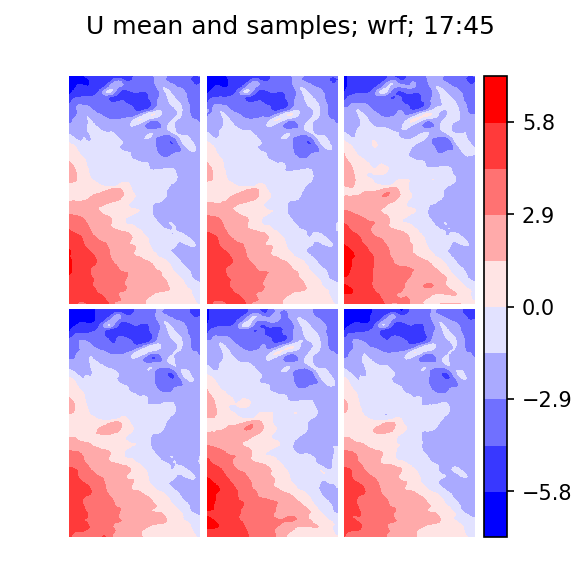

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


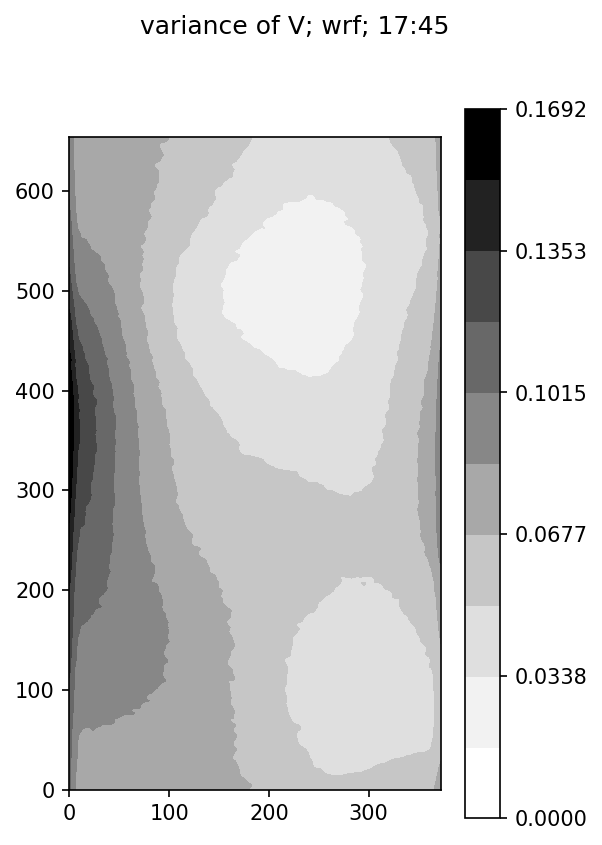

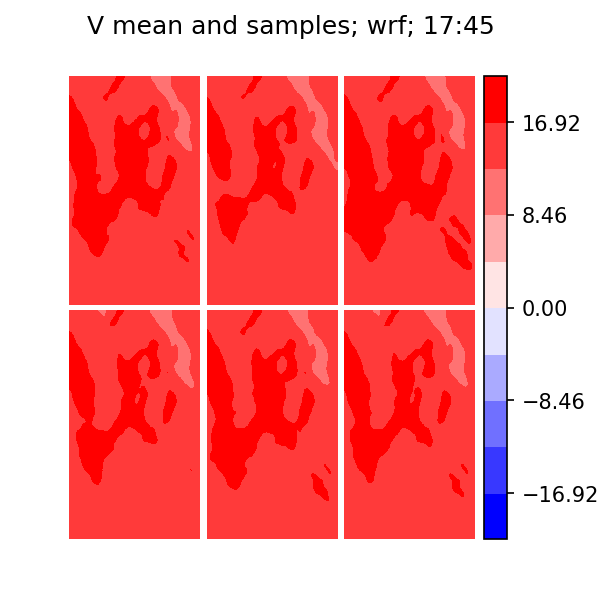

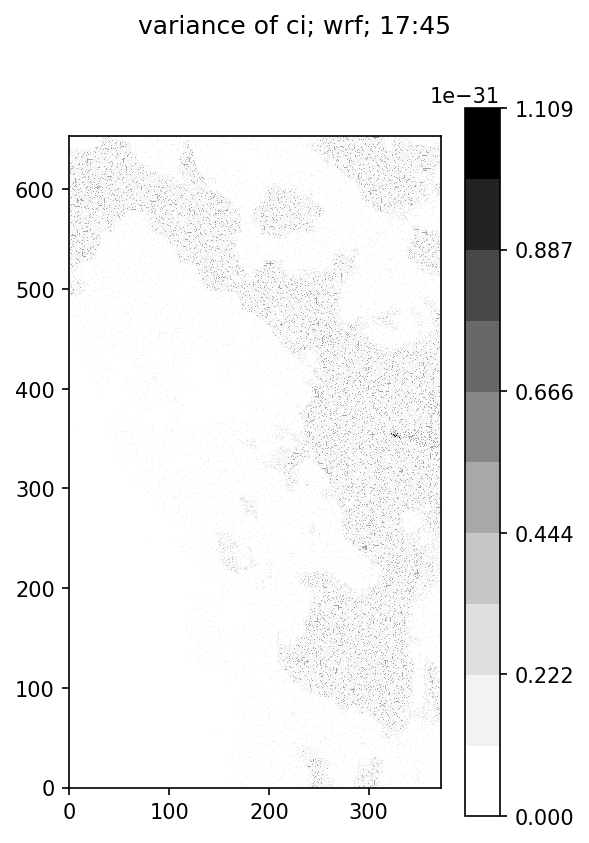

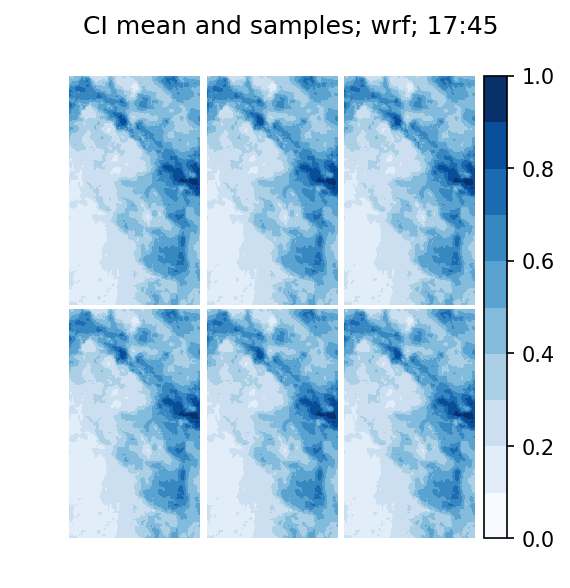

In [90]:
U_plots(ensemble, sat_time, 'wrf')
V_plots(ensemble, sat_time, 'wrf')
ci_plots(ensemble, sat_time, 'wrf')

In [91]:
ensemble_no_opt_flow = ensemble.copy()
returned = lf.maybe_assim_opt_flow(                  
    ensemble=ensemble, data_file_path=data_file_path,                
    sat_time=sat_time, time_index=time_index,                        
    coords=coords, sys_vars=sys_vars,                                
    flags=flags, opt_flow=opt_flow)
ensemble, div_opt_flow_flag = returned[:2]
u_opt_flow, v_opt_flow = returned[2:4]
u_flat_pos, v_flat_pos = returned[4:6]

In [92]:
importlib.reload(tp)

<module 'letkf_forecasting.tmh_plot' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/tmh_plot.py'>

(<matplotlib.figure.Figure at 0x7fe785d08978>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe77c307470>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7fe78e083eb8>], dtype=object))

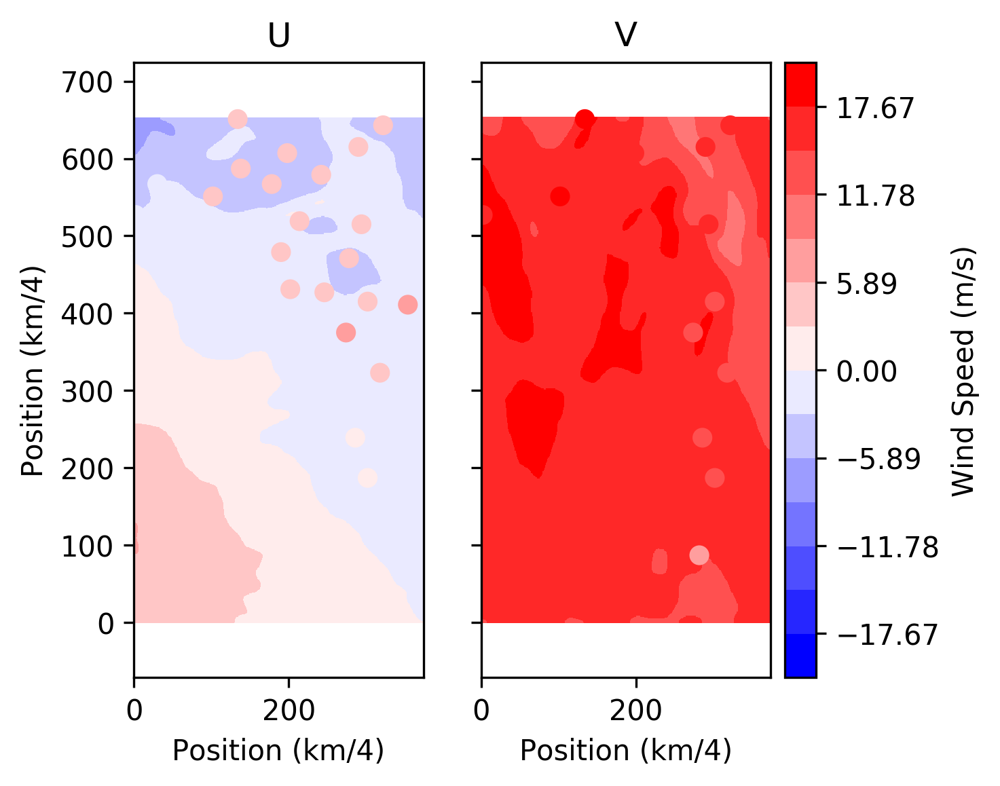

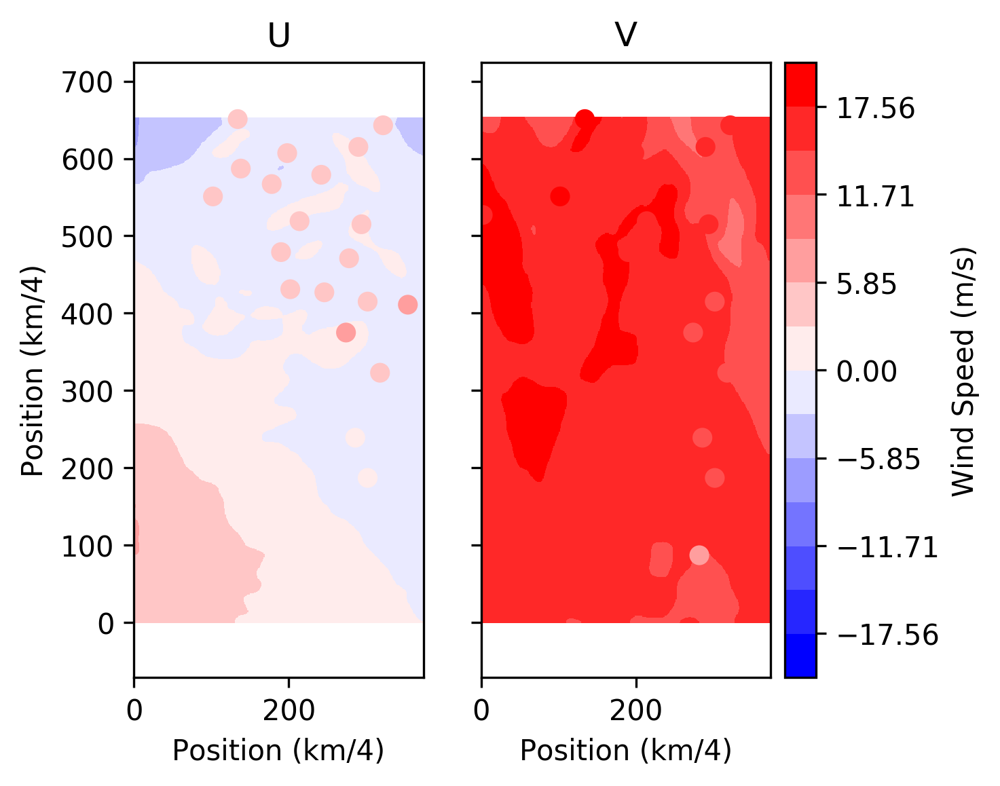

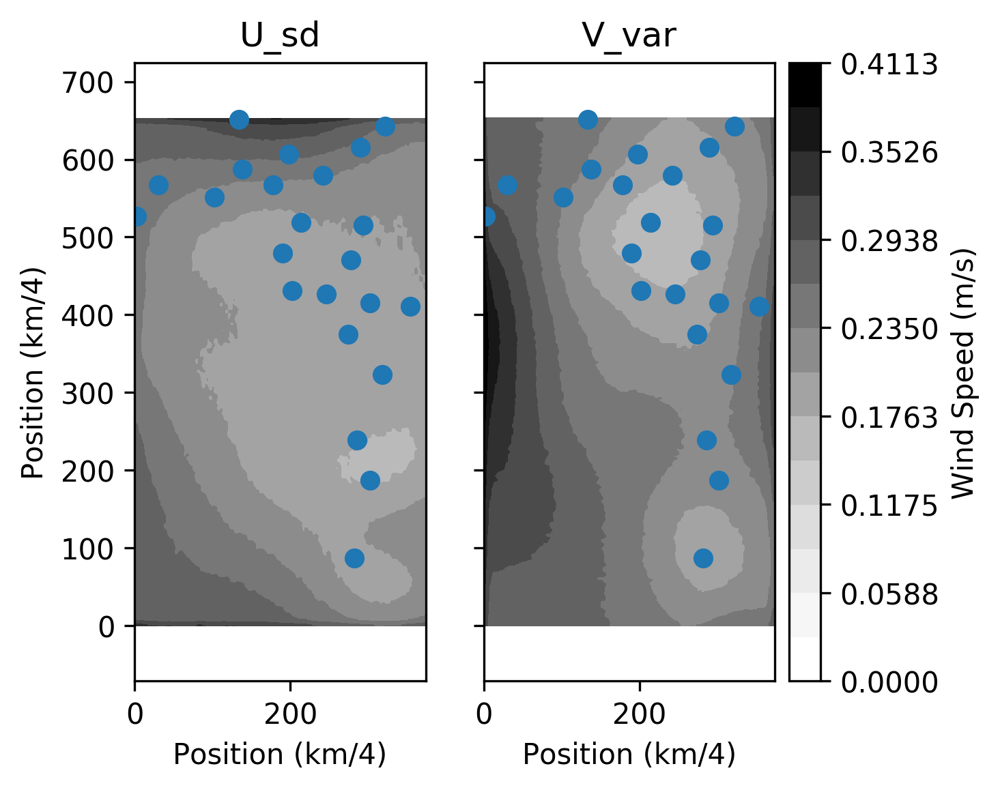

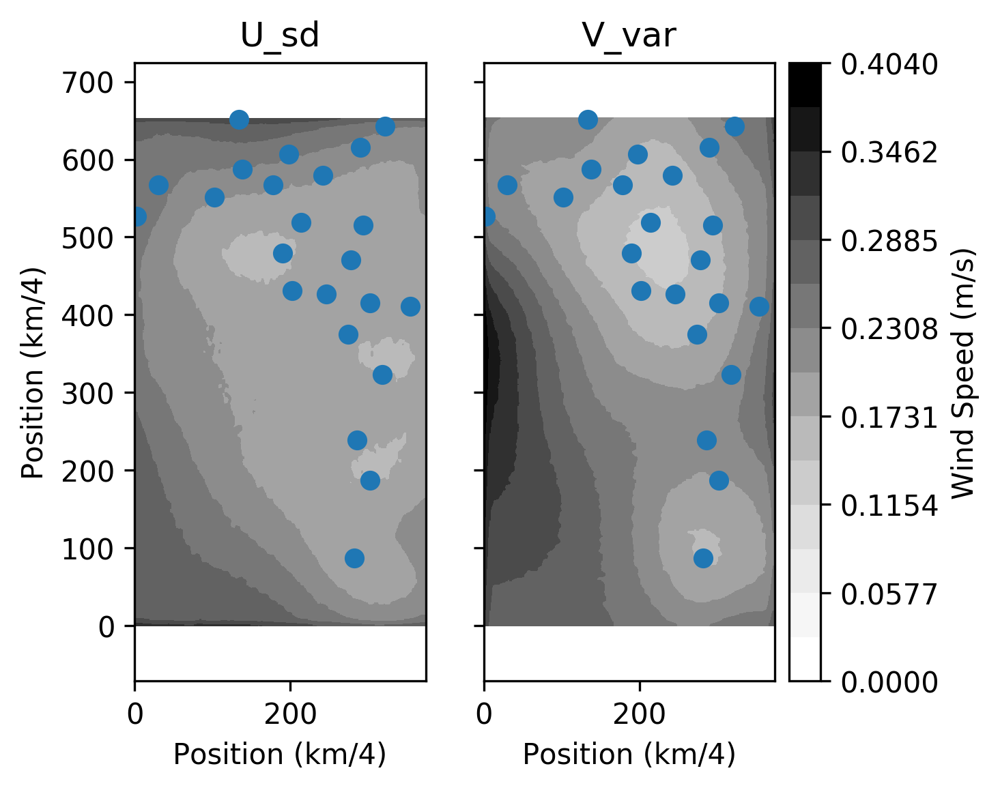

In [93]:
pos = np.array(np.unravel_index(u_flat_pos, sys_vars.U_crop_shape))
tp.wrf_opt_flow_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.wrf_opt_flow_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble_no_opt_flow, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)
tp.opt_flow_sd_plot(ensemble, sys_vars.U_crop_shape, sys_vars.V_crop_shape,
               u_opt_flow, v_opt_flow, pos[::-1].T, 1)

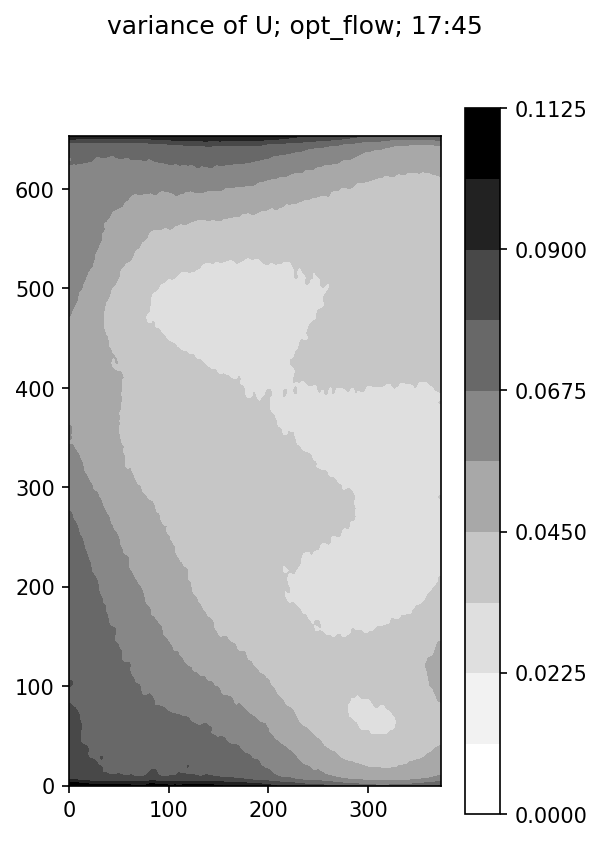

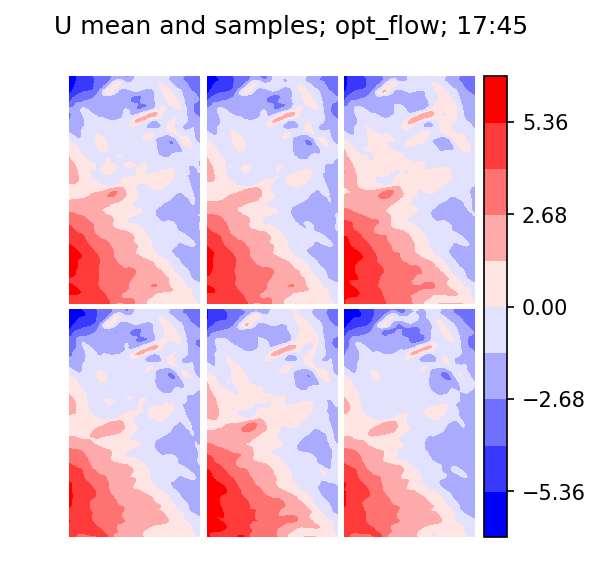

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


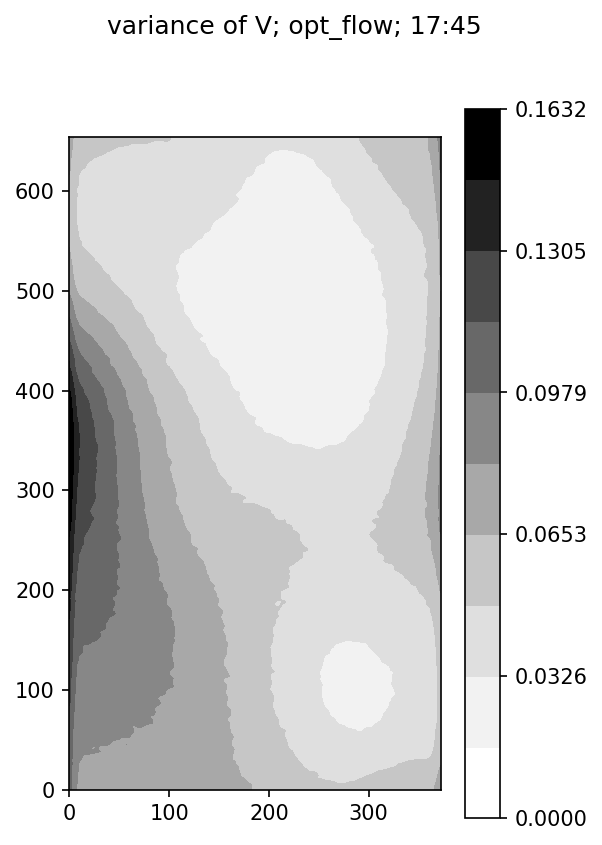

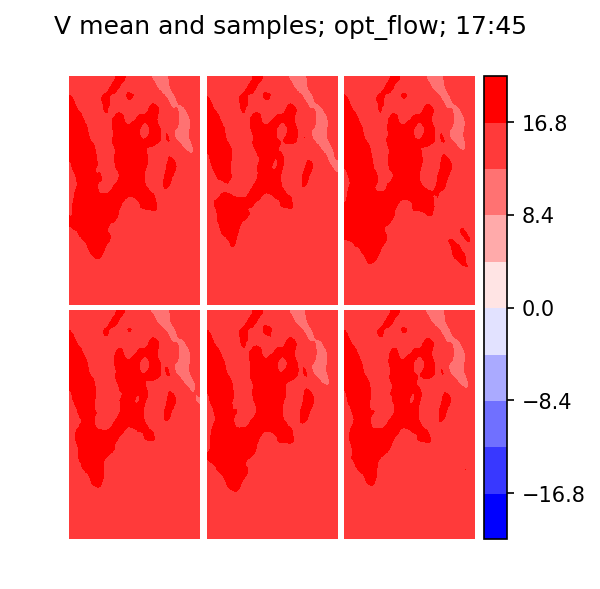

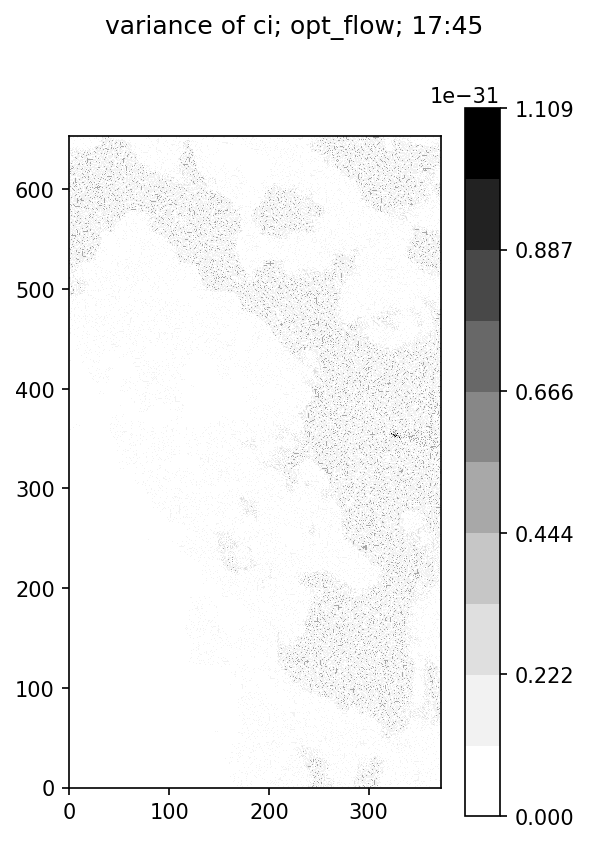

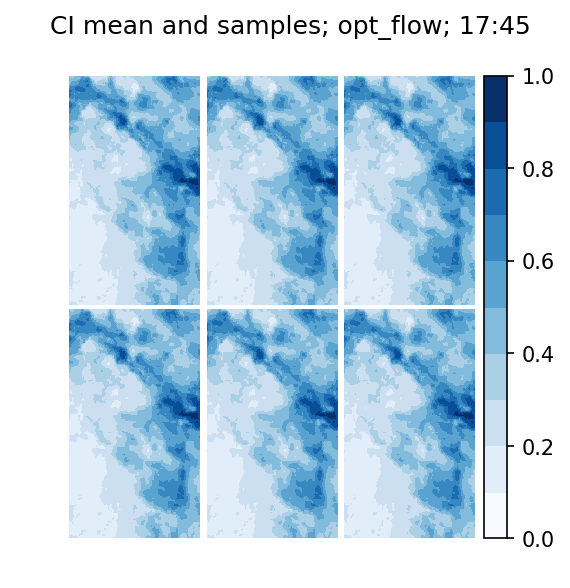

In [94]:
U_plots(ensemble, sat_time, 'opt_flow')
V_plots(ensemble, sat_time, 'opt_flow')
ci_plots(ensemble, sat_time, 'opt_flow')

In [95]:
remove_div_flag = (div_sat2wind_flag                                 
                   or div_wrf_flag                                   
                   or div_opt_flow_flag)                             
ensemble, remove_div_flag = lf.preprocess(                              
    ensemble=ensemble, flags=flags,                                  
    remove_div_flag=remove_div_flag,                                 
    coords=coords, sys_vars=sys_vars)

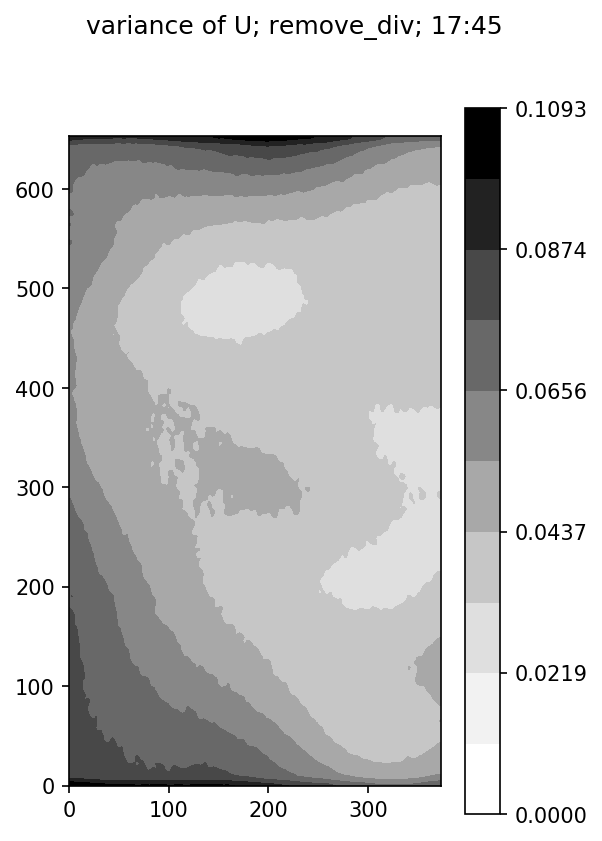

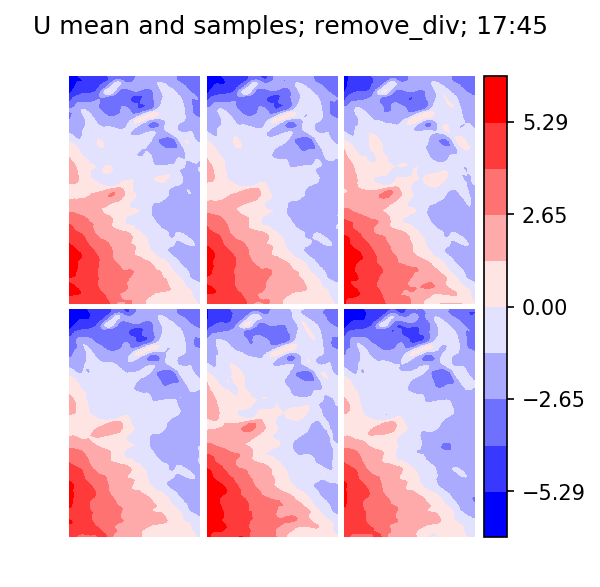

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


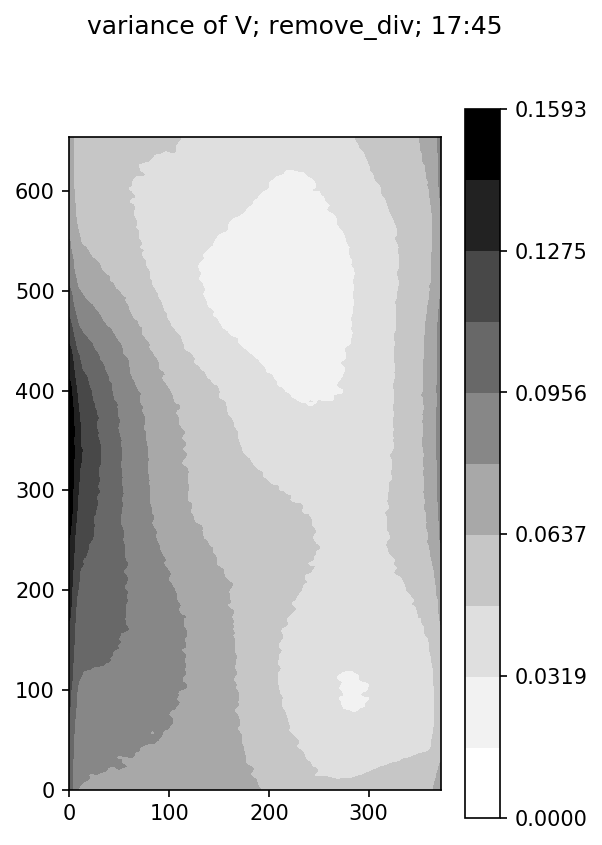

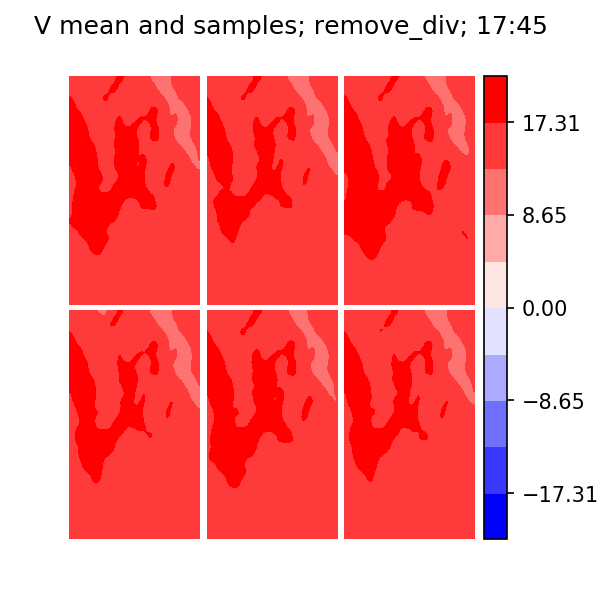

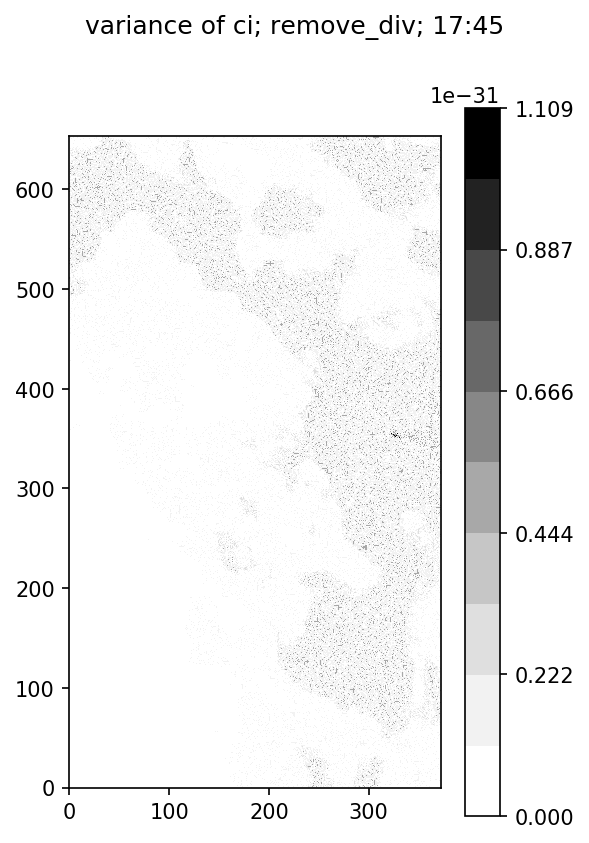

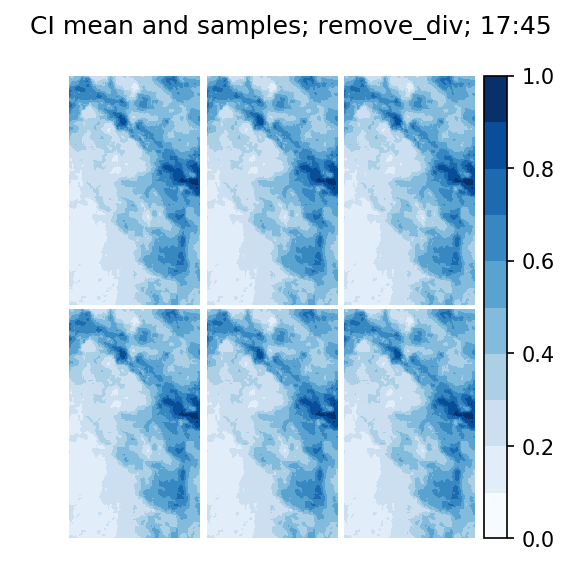

In [96]:
U_plots(ensemble, sat_time, 'remove_div')
V_plots(ensemble, sat_time, 'remove_div')
ci_plots(ensemble, sat_time, 'remove_div')

In [97]:
ensemble_array, save_times, ensemble = lf.forecast(                     
    ensemble=ensemble, sat_time=sat_time,                            
    flags=flags, coords=coords, time_index=time_index,               
    sys_vars=sys_vars,                                               
    advect_params=advect_params, pert_params=pert_params,            
    assim_vars=assim_vars)

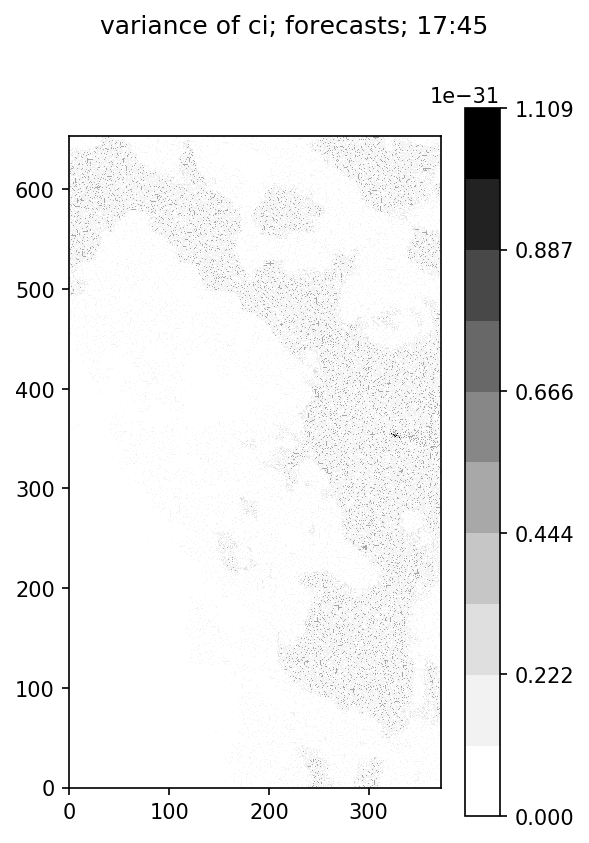

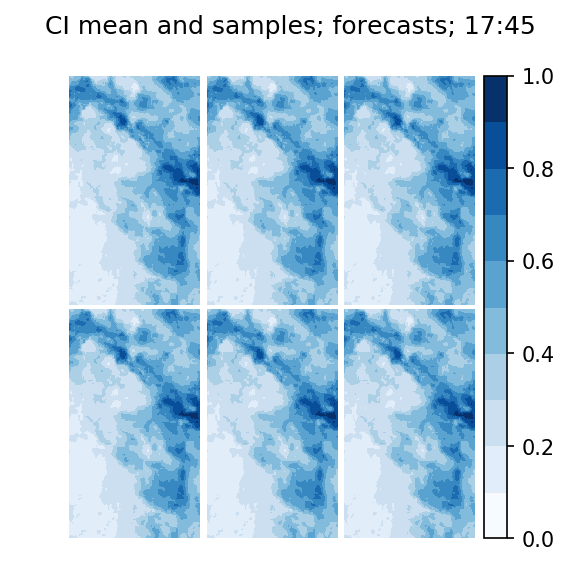

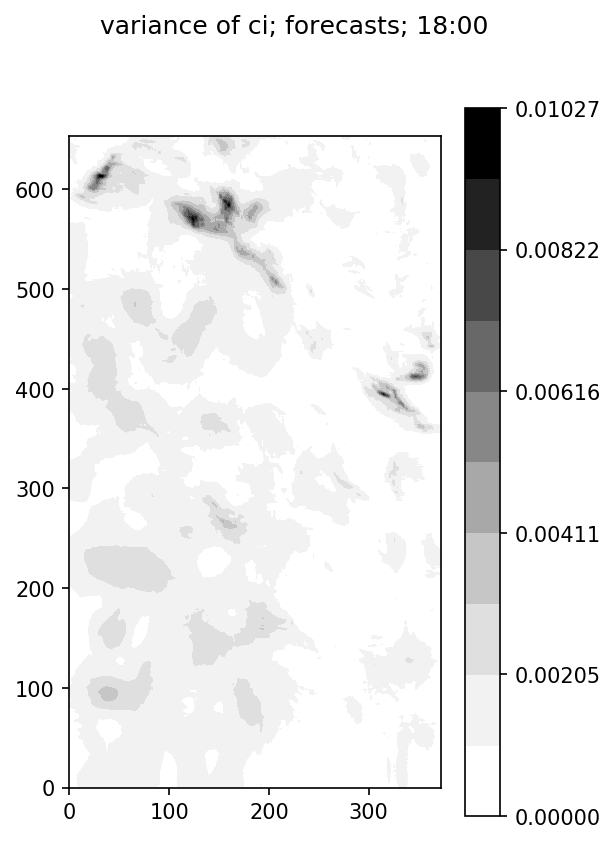

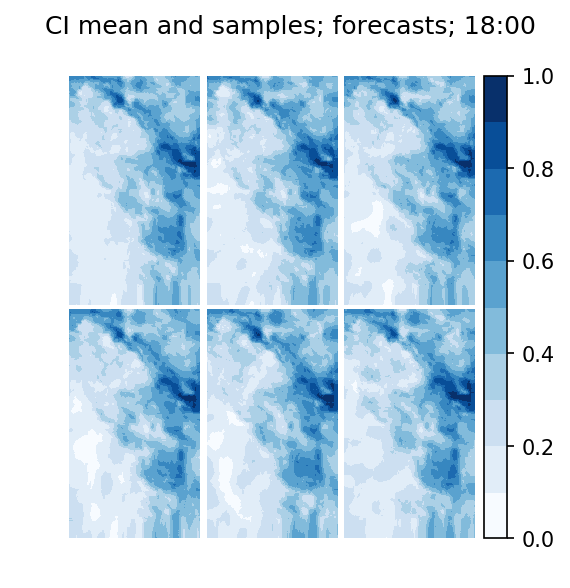

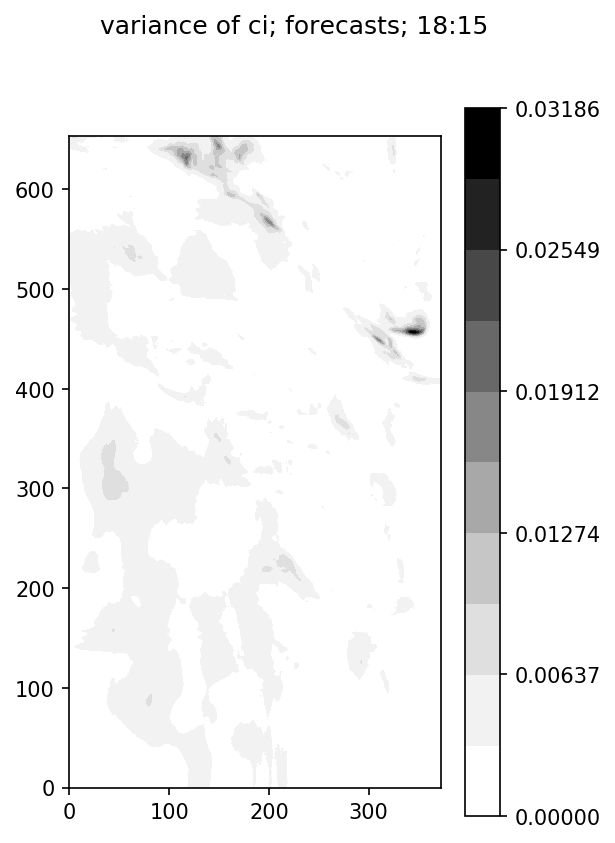

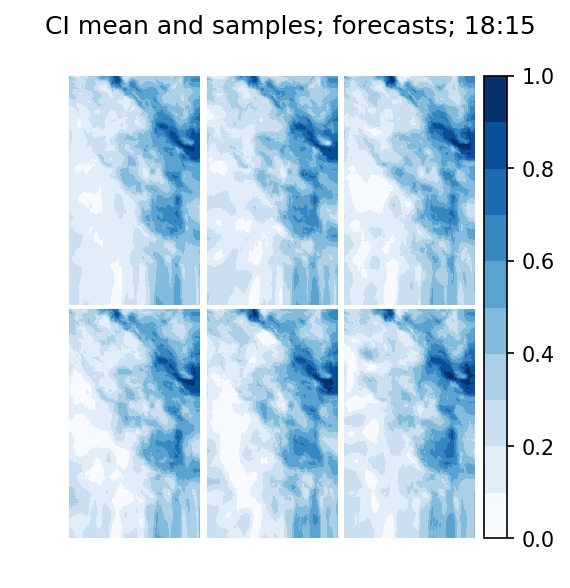

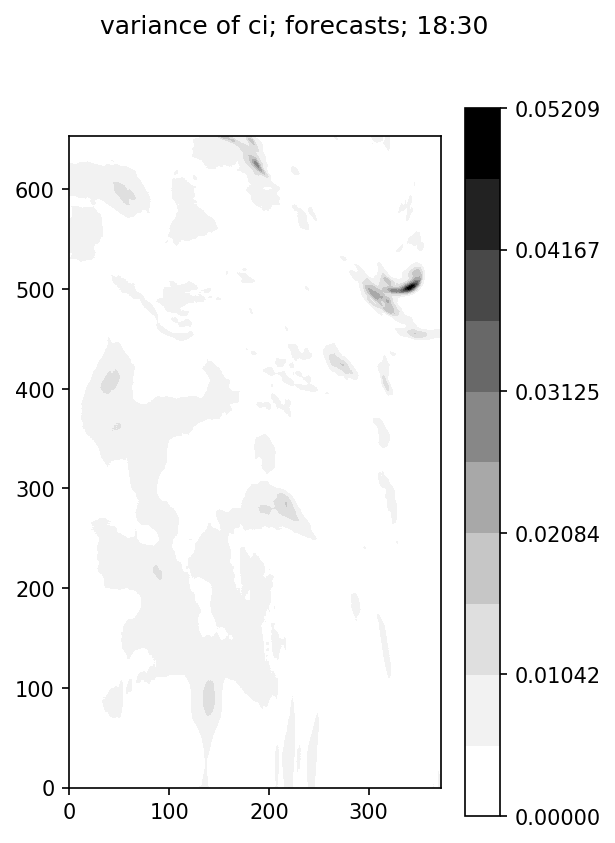

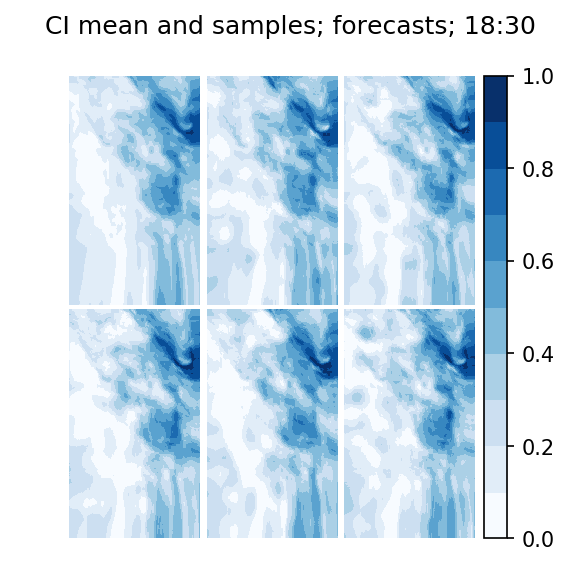

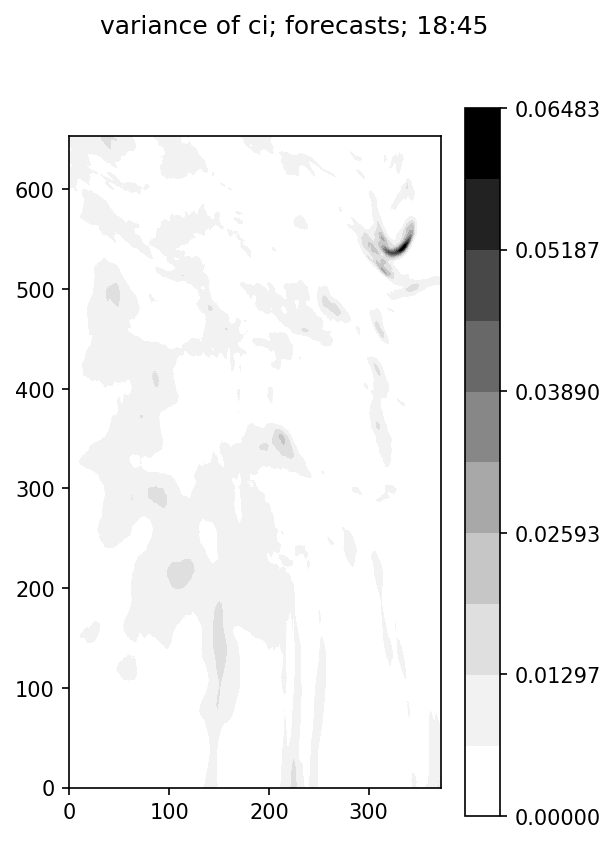

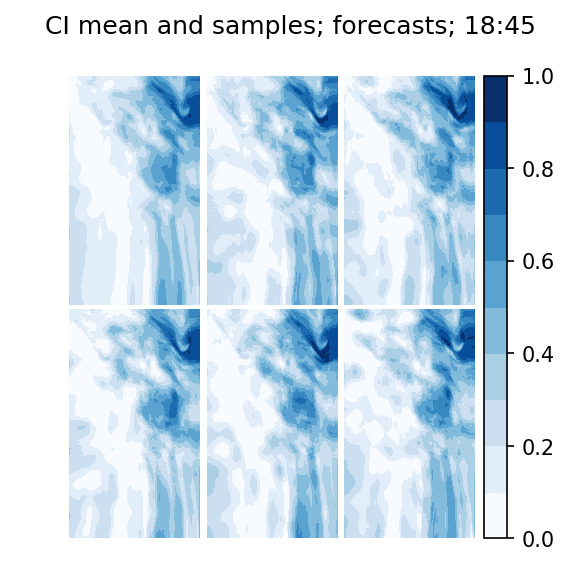

In [98]:
for ii in range(ensemble_array.shape[0]):
    ci_plots(ensemble_array[ii], save_times[ii], 'forecasts')

In [99]:
# lf.save(ensemble_array=ensemble_array, coords=coords,                   
#      ens_params=ens_params, param_dict=param_dict,                   
#      sys_vars=sys_vars, save_times=save_times,                       
#      results_file_path=results_file_path)

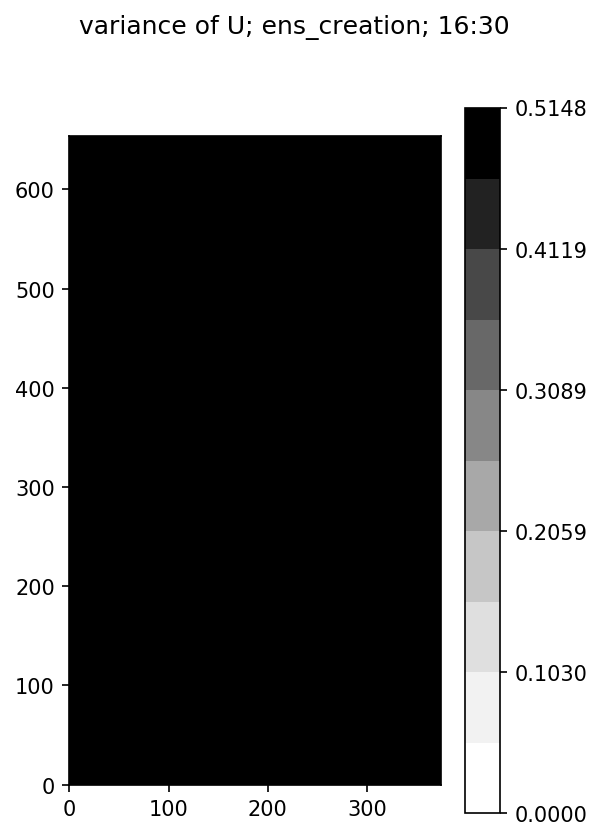

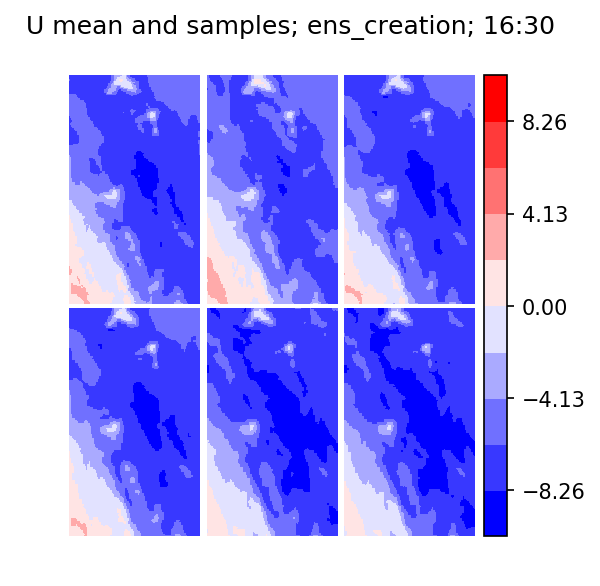

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


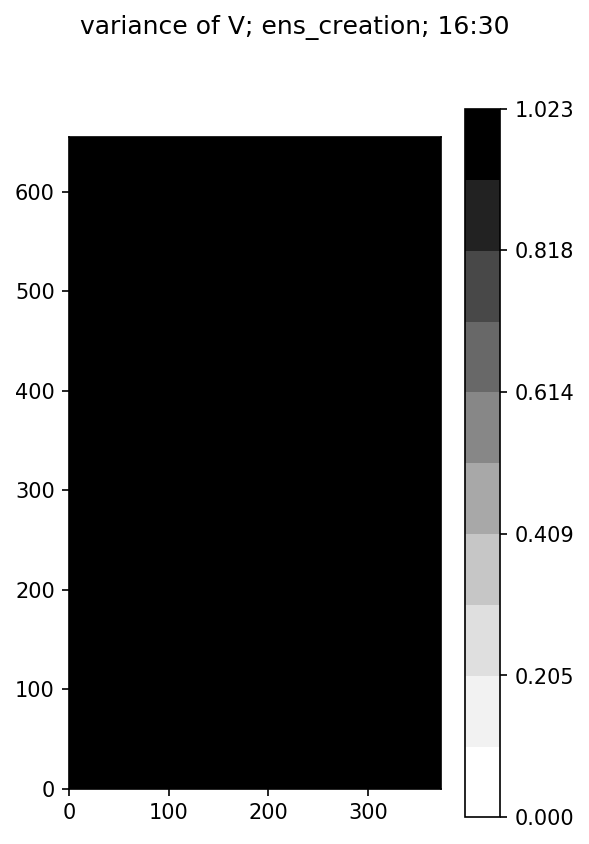

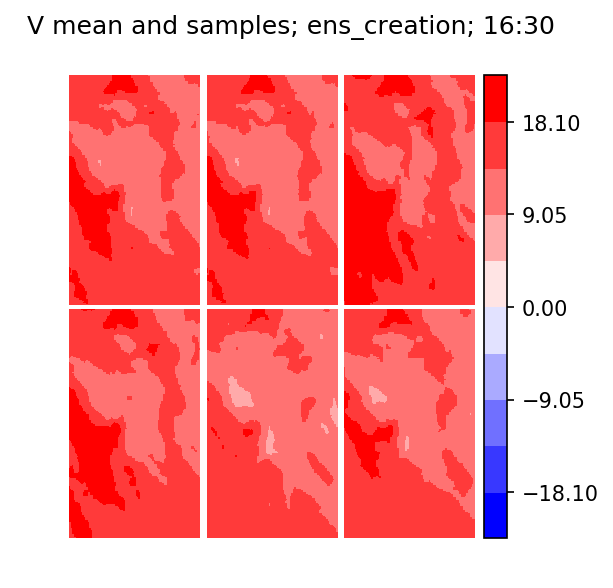

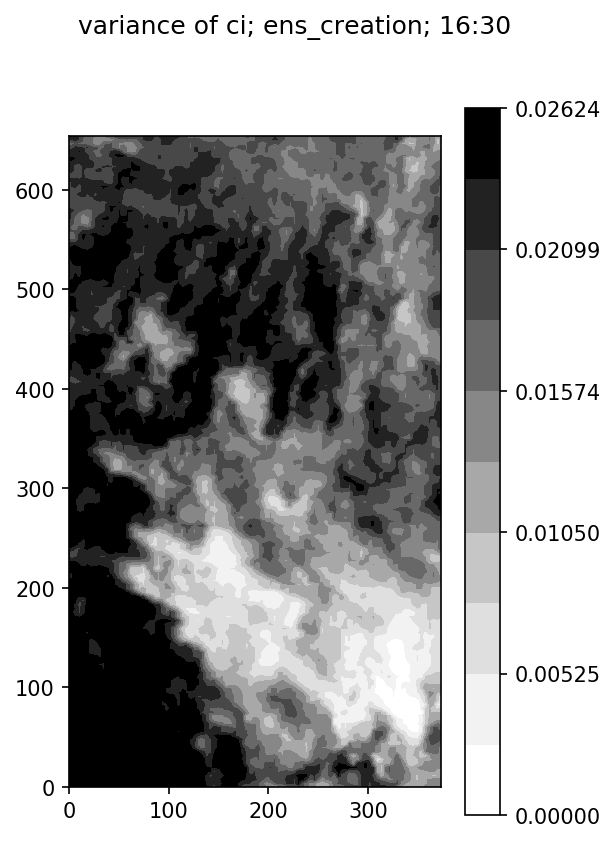

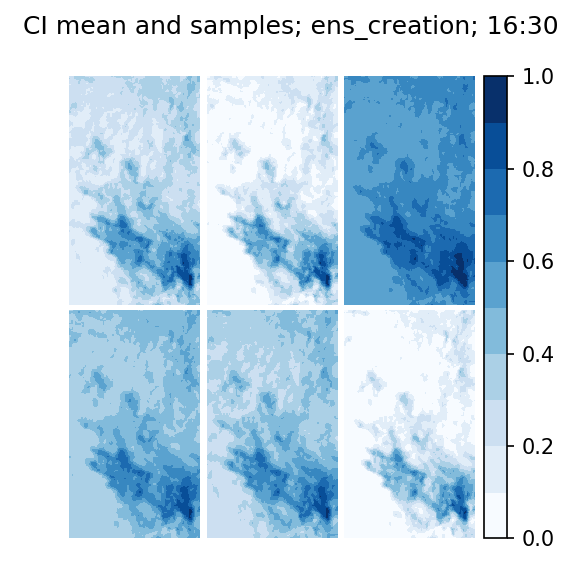

In [8]:
U_plots(ensemble, sat_times[0], 'ens_creation')
V_plots(ensemble, sat_times[0], 'ens_creation')
ci_plots(ensemble, sat_times[0], 'ens_creation')

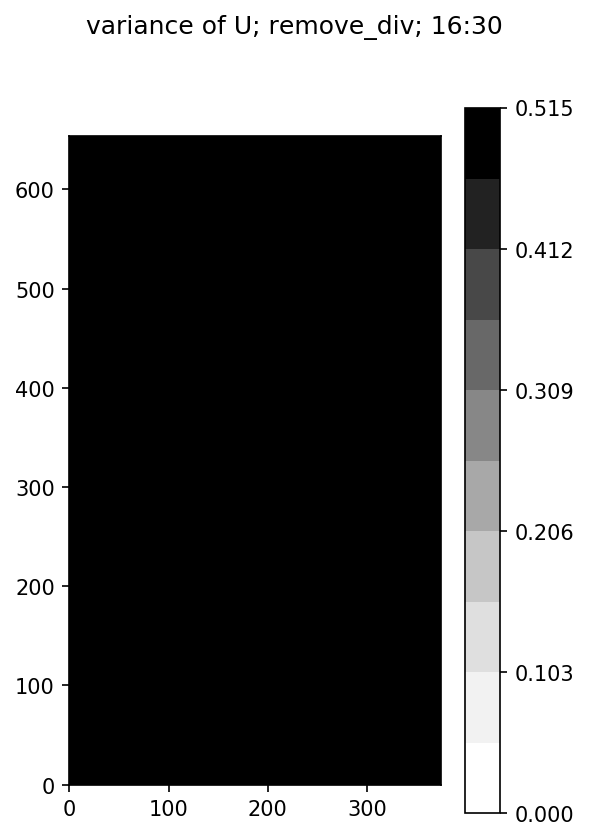

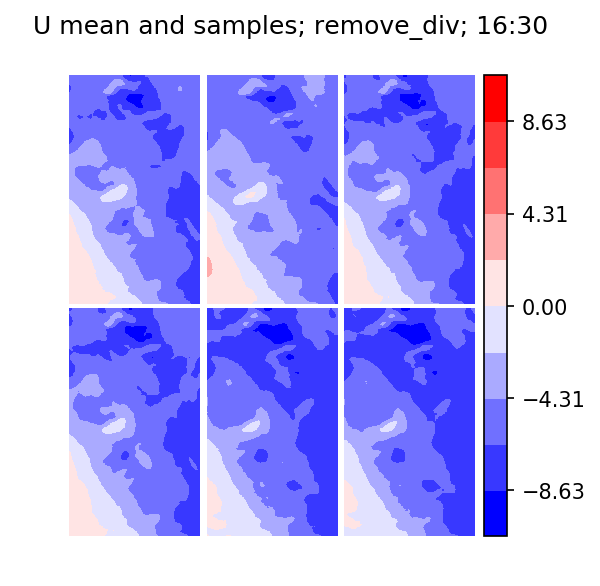

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


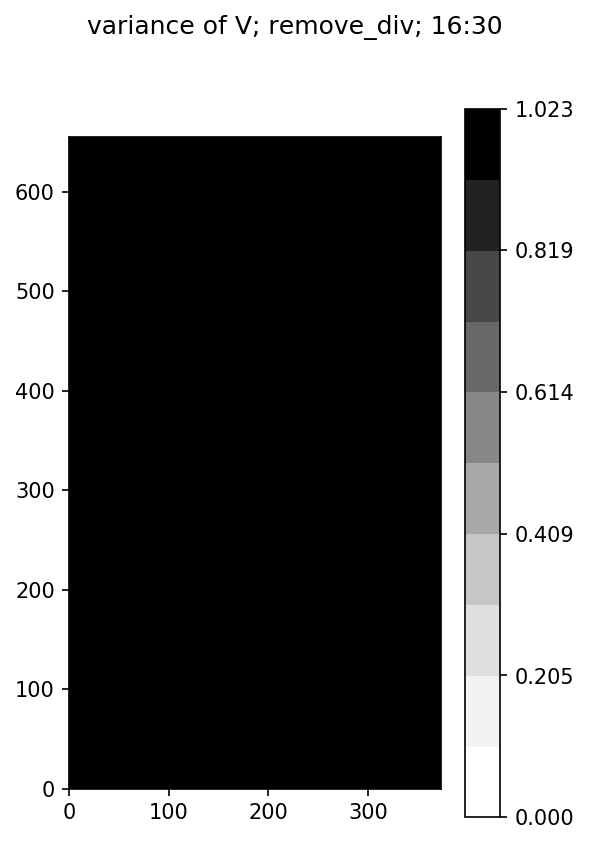

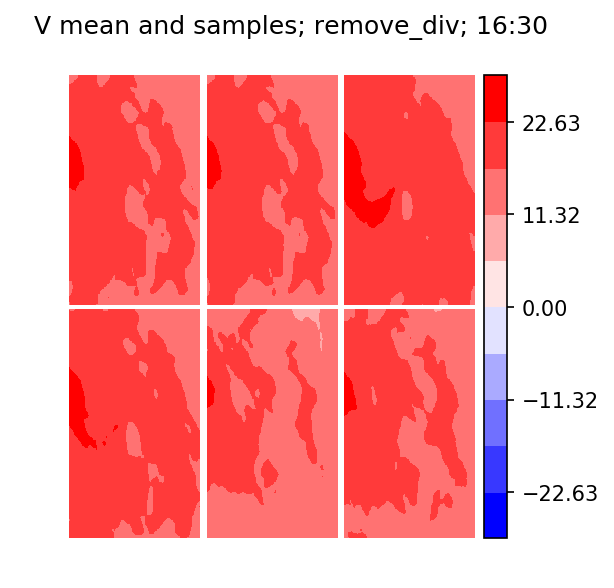

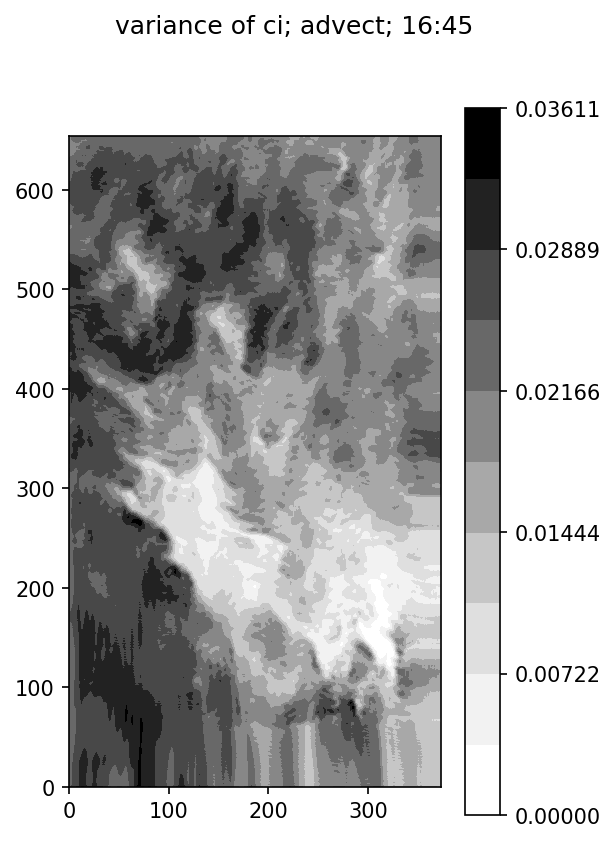

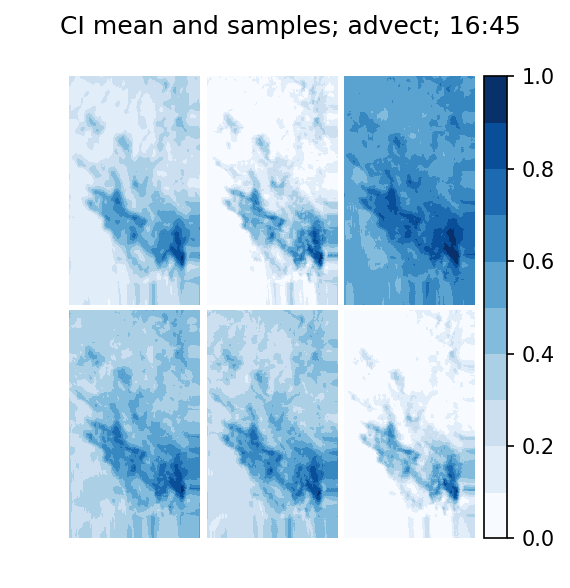

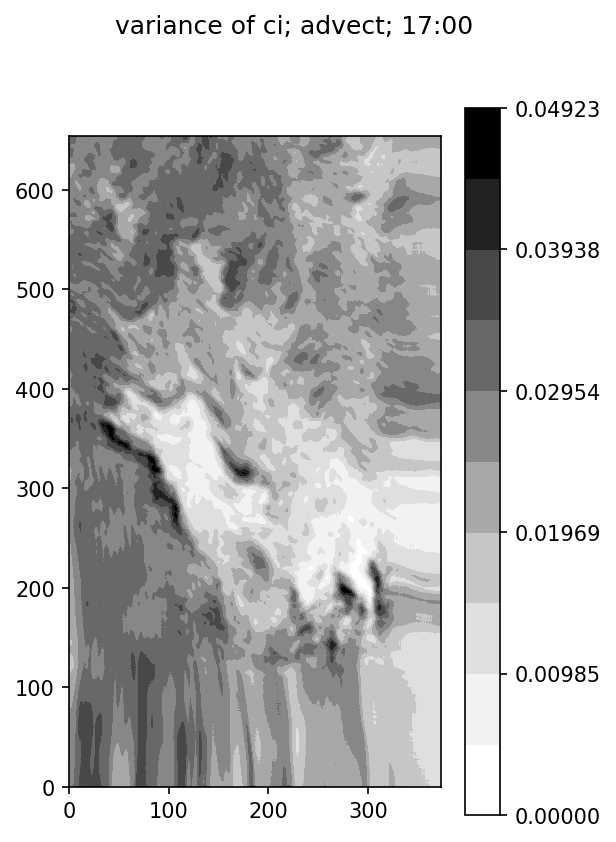

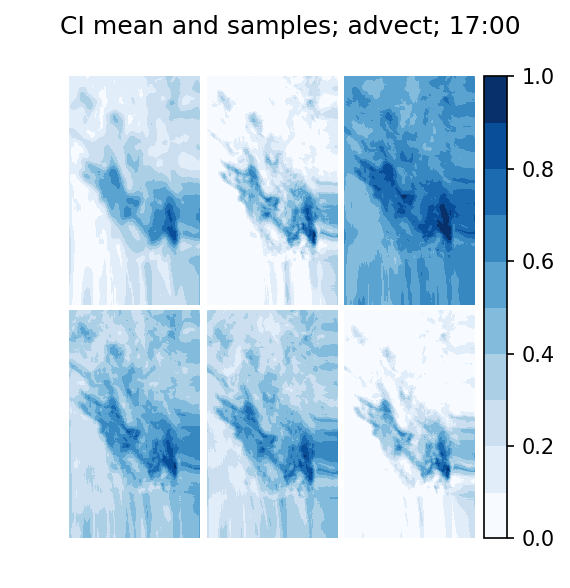

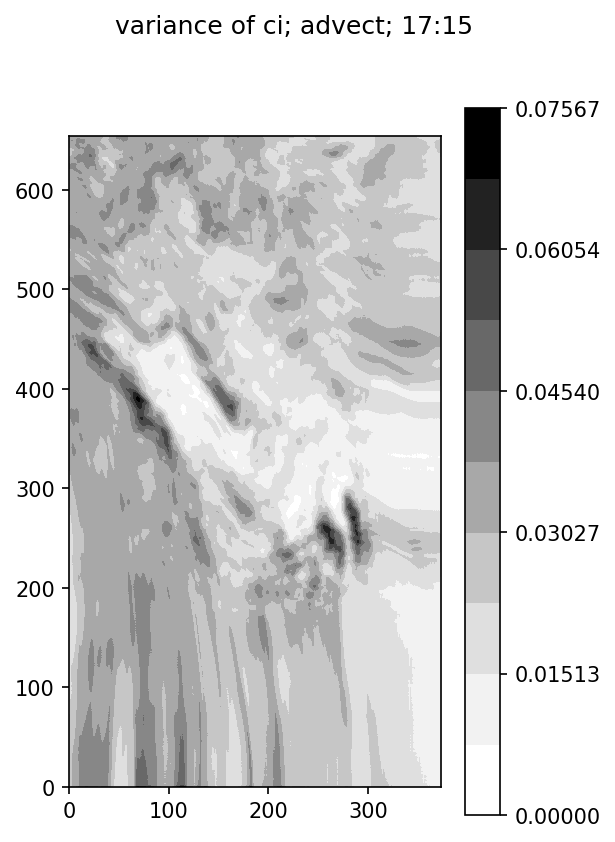

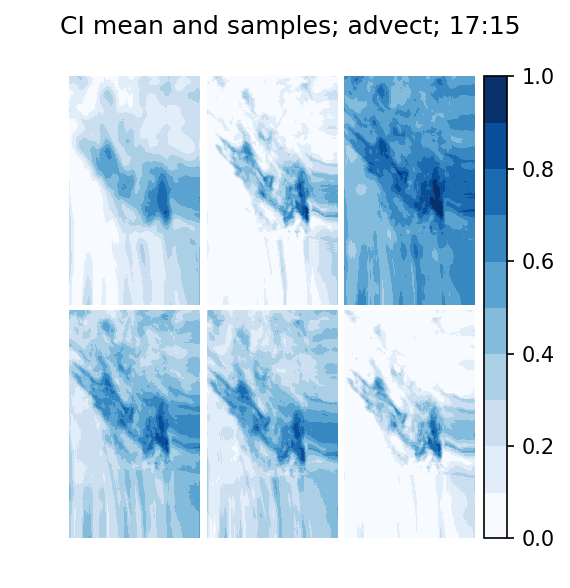

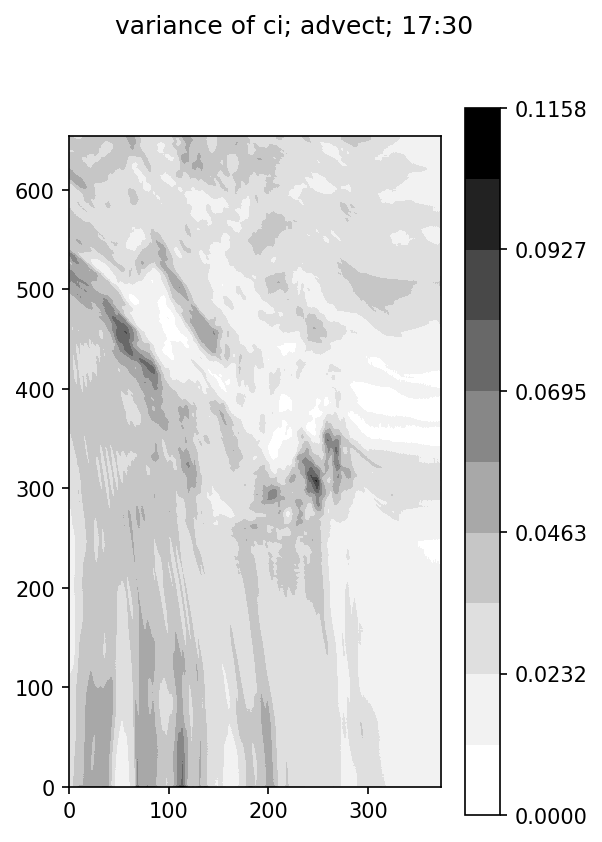

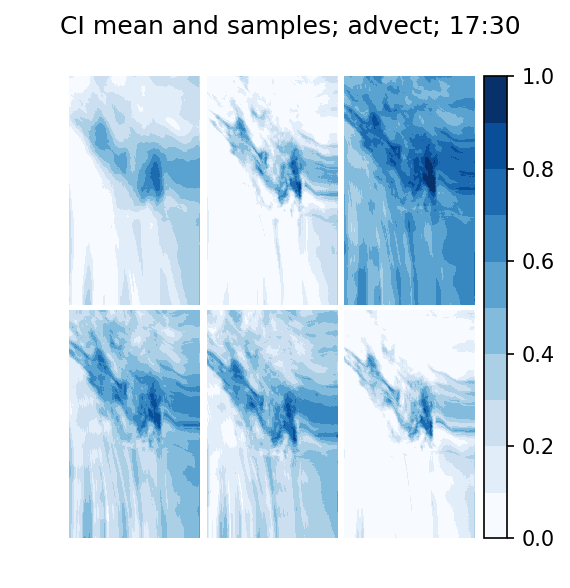

In [9]:
importlib.reload(tp)
importlib.reload(lf)
importlib.reload(letkf_forecasting.advection)
importlib.reload(letkf_forecasting.optical_flow)

time_index = 0
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

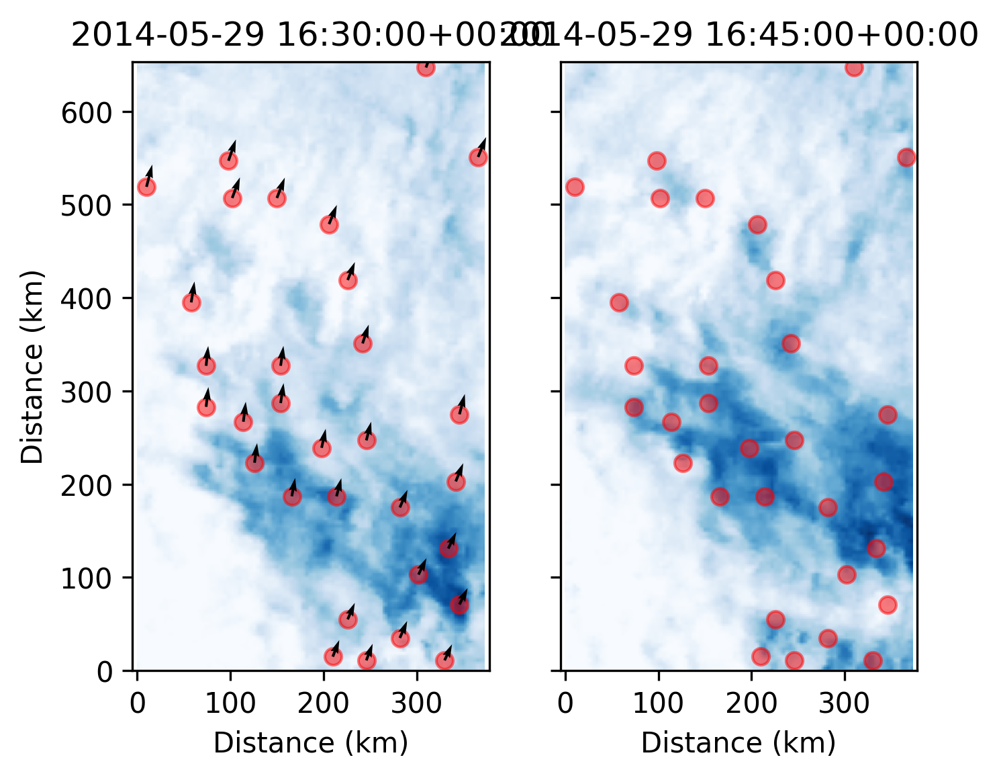

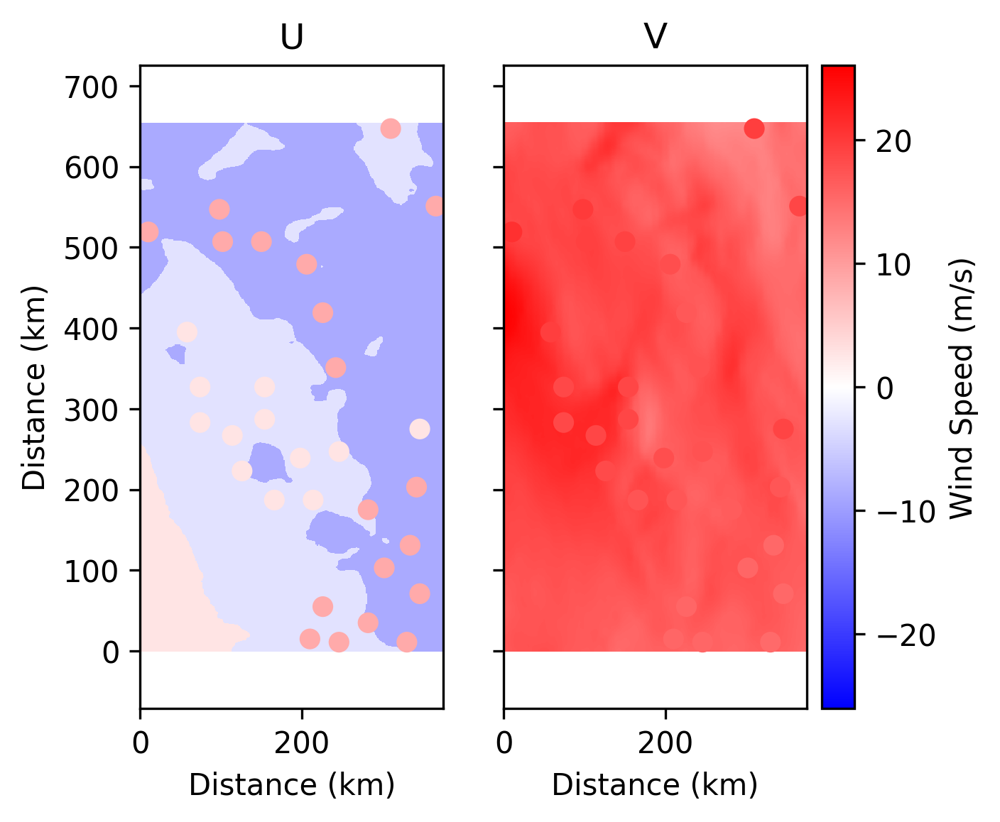

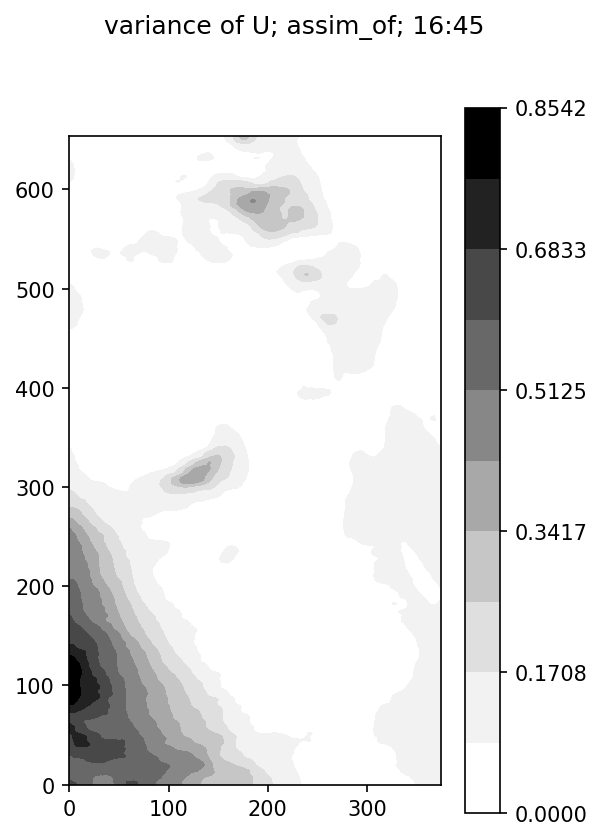

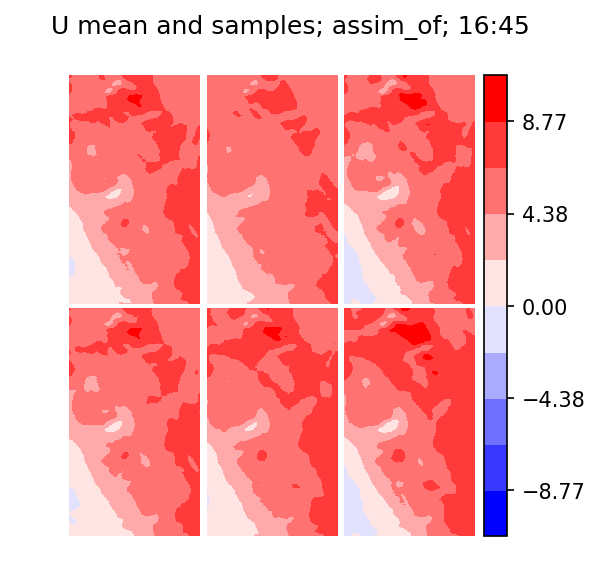

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


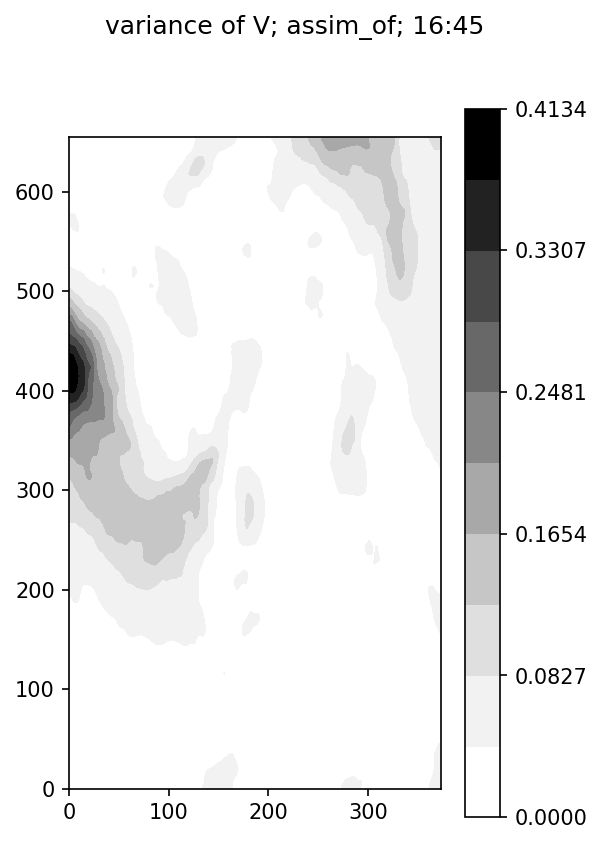

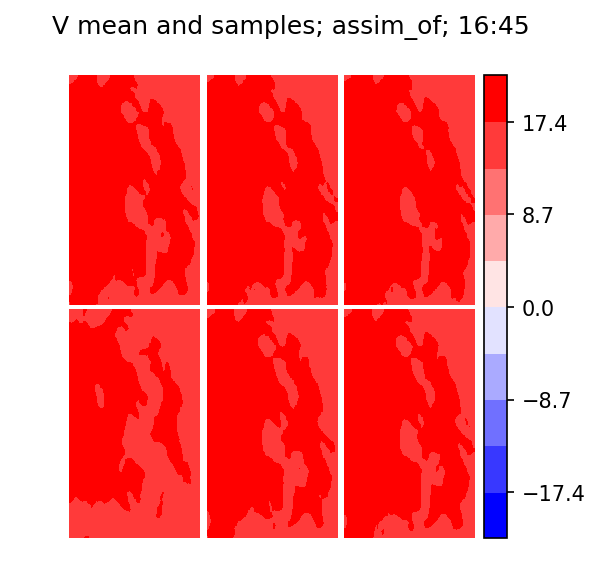

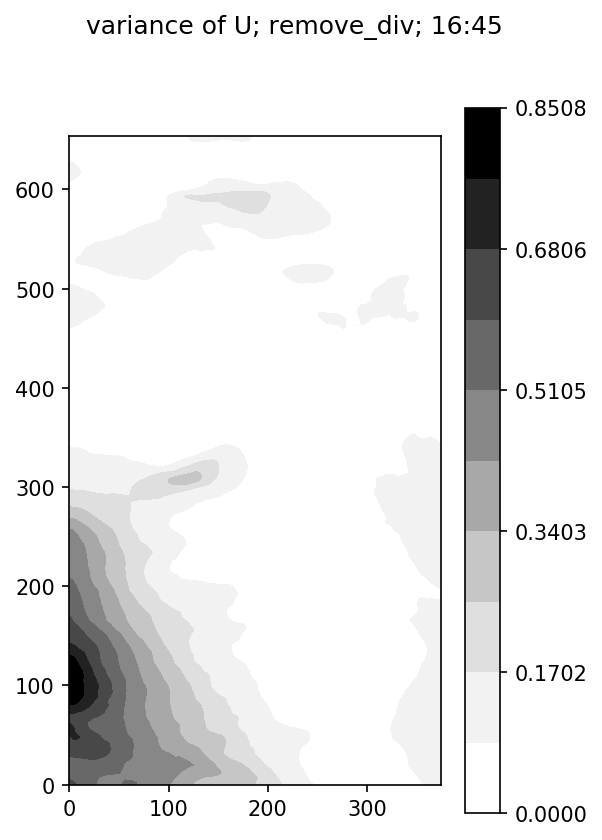

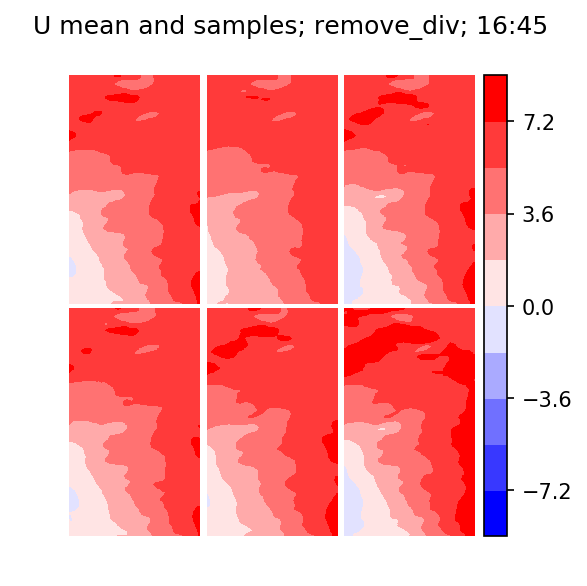

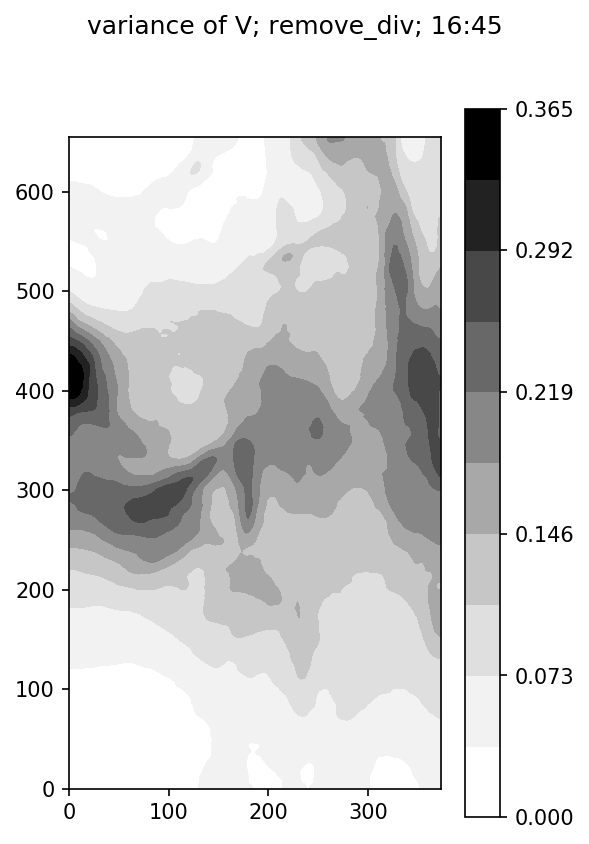

...

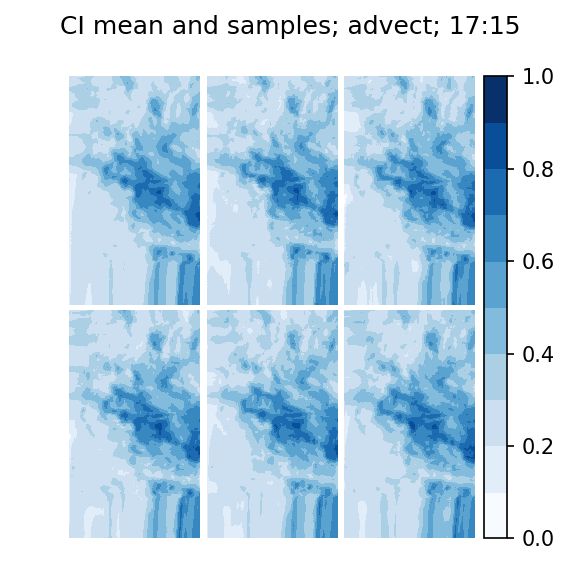

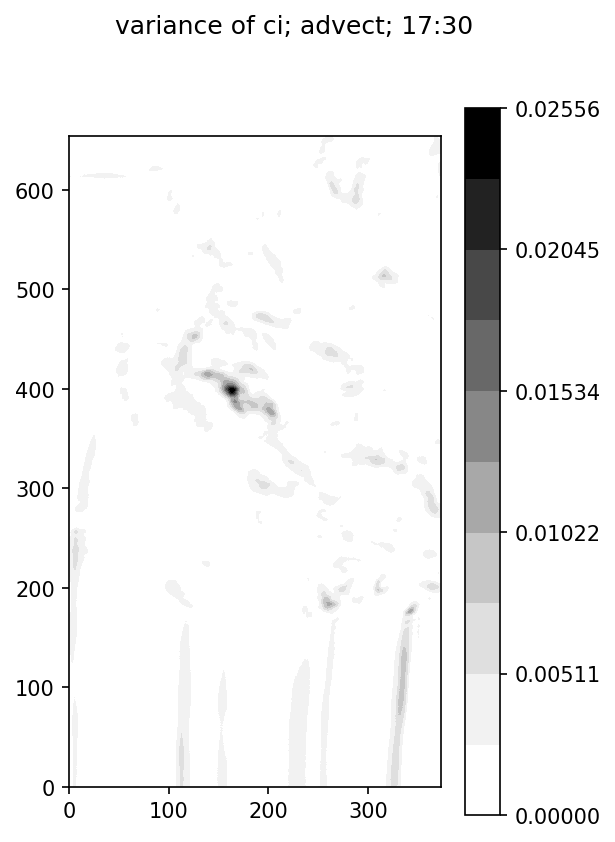

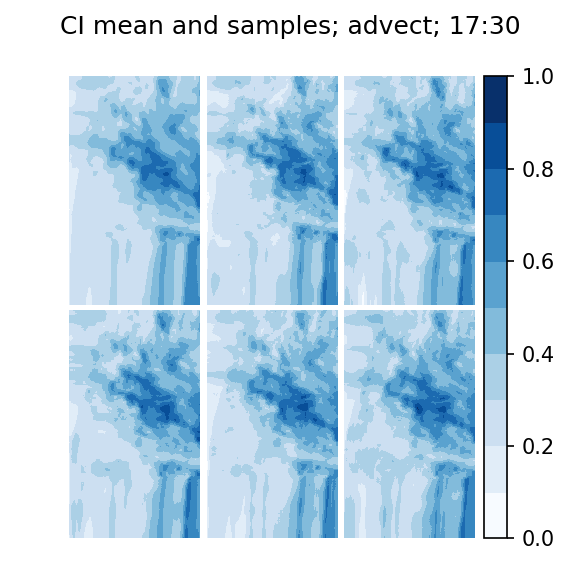

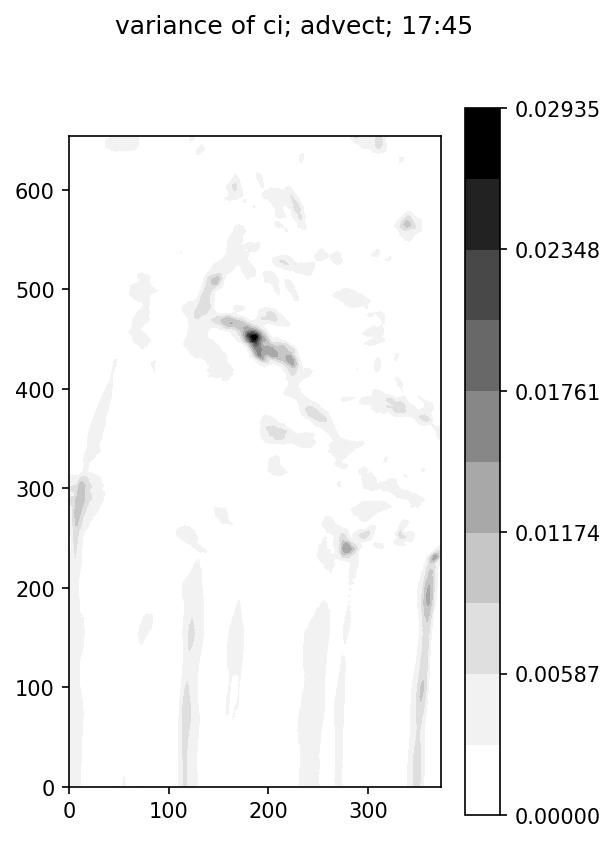

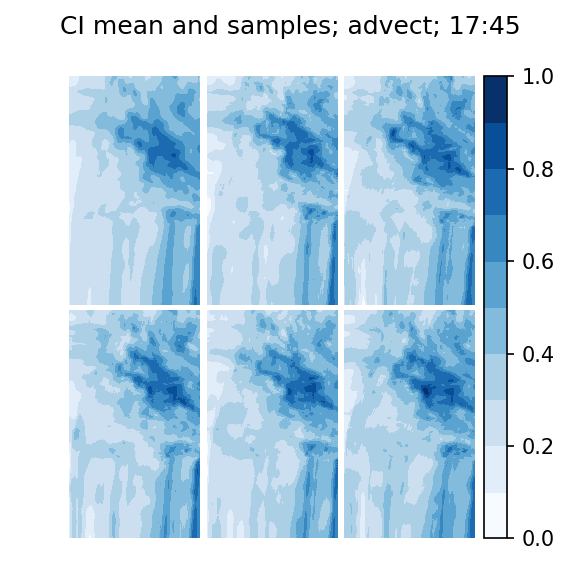

In [10]:
importlib.reload(tp)
importlib.reload(lf)

time_index += 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

In [ ]:
importlib.reload(tp)
importlib.reload(lf)

time_index += 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

In [ ]:
importlib.reload(tp)
importlib.reload(lf)

time_index += 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

In [ ]:
importlib.reload(tp)
importlib.reload(lf)

time_index += 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

In [ ]:
importlib.reload(tp)
importlib.reload(lf)

time_index += 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

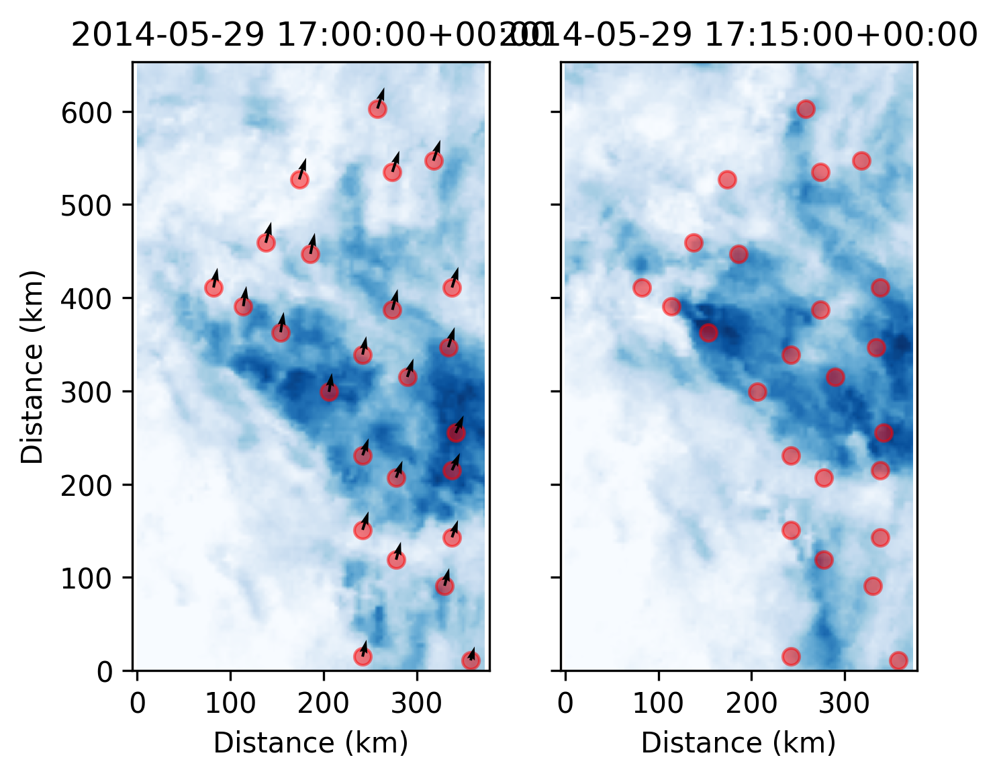

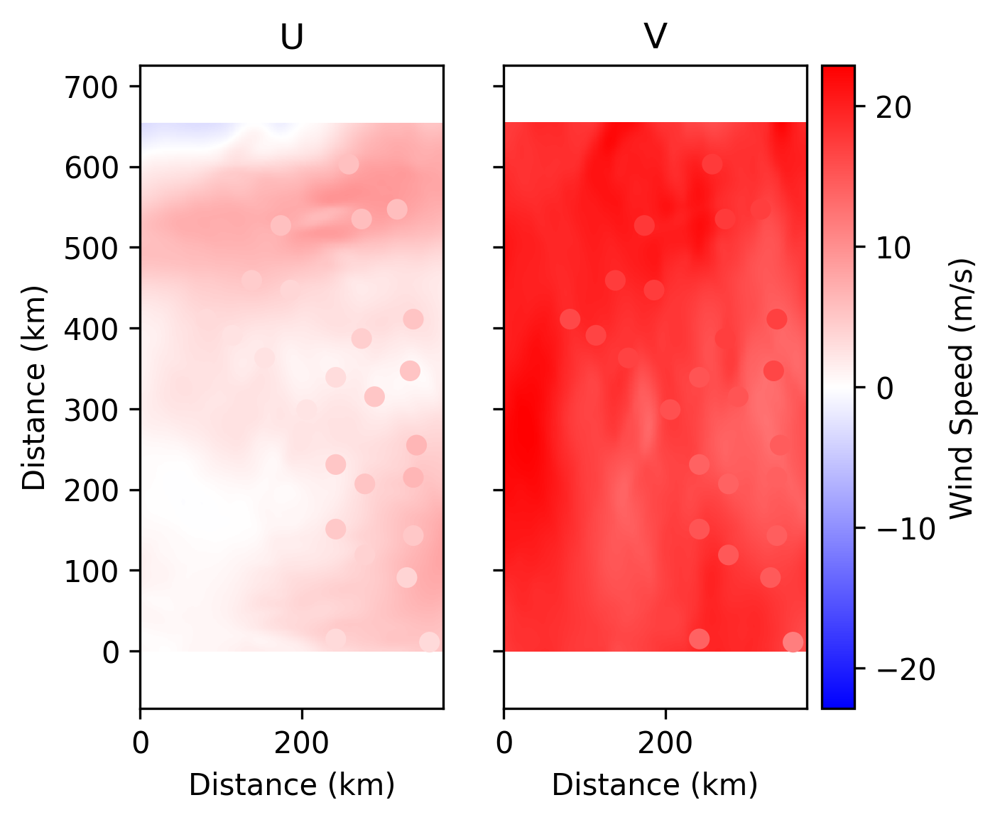

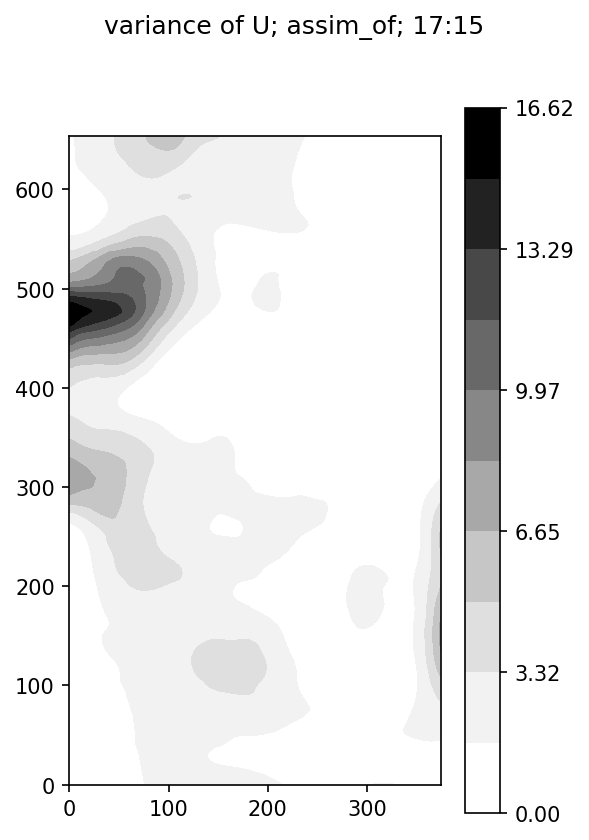

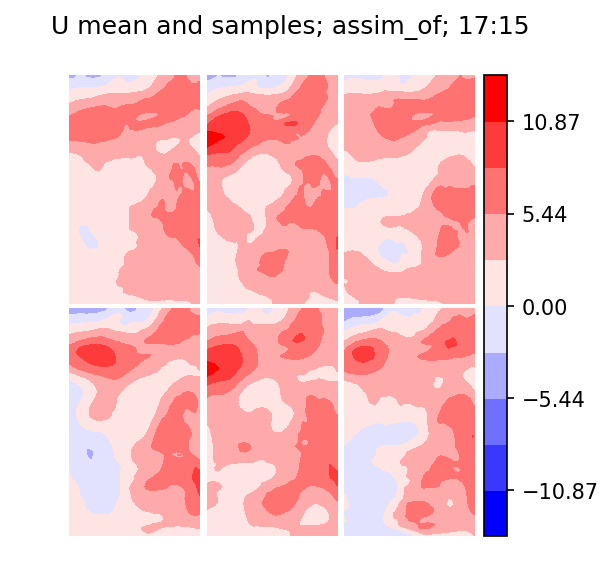

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


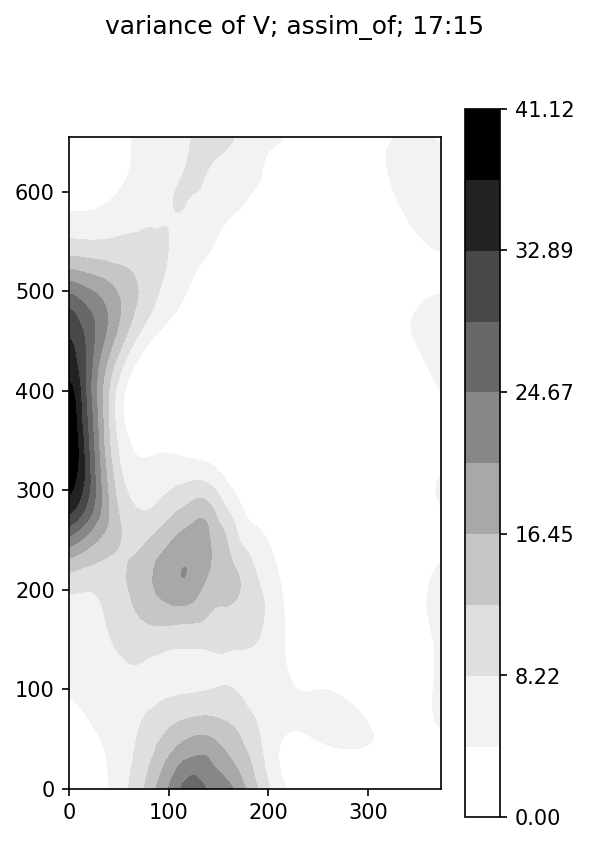

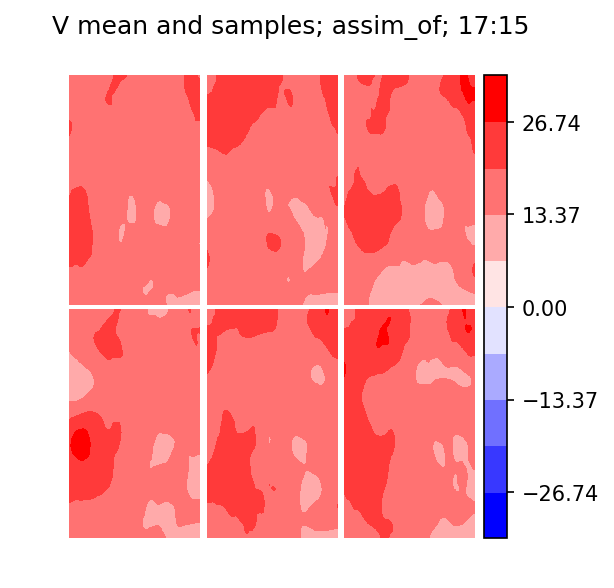

KeyboardInterrupt: 

In [11]:
importlib.reload(tp)
importlib.reload(lf)

time_index += 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

In [ ]:
importlib.reload(tp)
importlib.reload(lf)

time_index += 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

In [ ]:
importlib.reload(tp)
importlib.reload(lf)

time_index += 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        
        tp.of_vectors_plot(
            image0[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            image1[sn_min_crop:sn_max_crop,
                   we_min_crop:we_max_crop],
            pos[::-1].T, pos[::-1].T, u_of, v_of,
            time0, sat_time, 1)
        
        del this_U, this_V, image0, image1
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        
        tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
                       u_of, v_of, pos[::-1].T, 1)
        
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

In [73]:
importlib.reload(tp)

<module 'letkf_forecasting.tmh_plot' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/tmh_plot.py'>

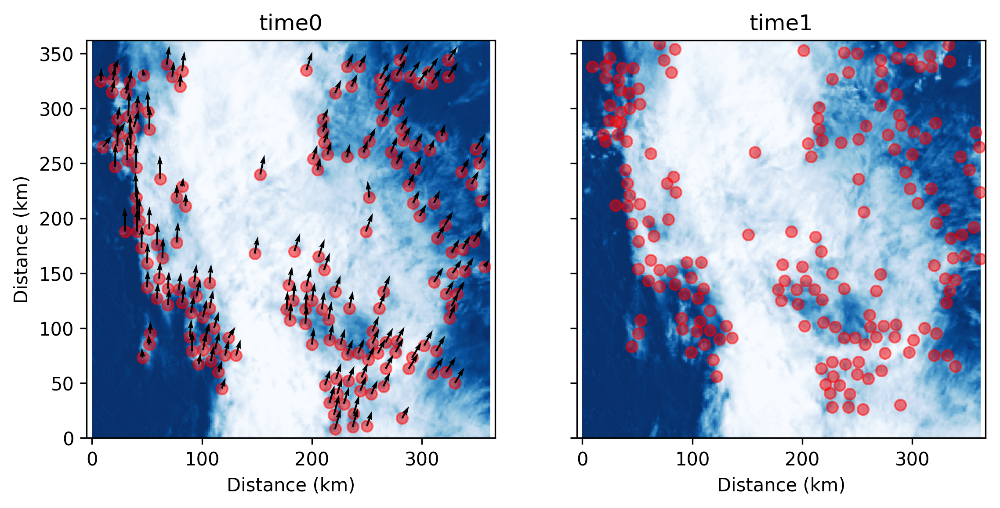

In [59]:
time0 = sat_times[time_index - 1]
with Dataset(data_file_path, mode='r') as store:
    this_U = store.variables['U'][
        wind_times_all == wind_time, :, :]
    this_V = store.variables['V'][
        wind_times_all == wind_time, :, :]
    image0 = store.variables['ci'][sat_times_all == time0,
                                   :, :]
    image1 = store.variables['ci'][
        sat_times_all == sat_time, :, :]
    # boolean indexing does not drop dimension
    this_U = this_U[0]
    this_V = this_V[0]
    image0 = image0[0]
    image1 = image1[0]
u_of, v_of, pos = lf.optical_flow(image0, image1,
                               time0, sat_time,
                               this_U, this_V)

(<matplotlib.figure.Figure at 0x7f642a64beb8>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f642a5597b8>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7f642a1eaeb8>], dtype=object))

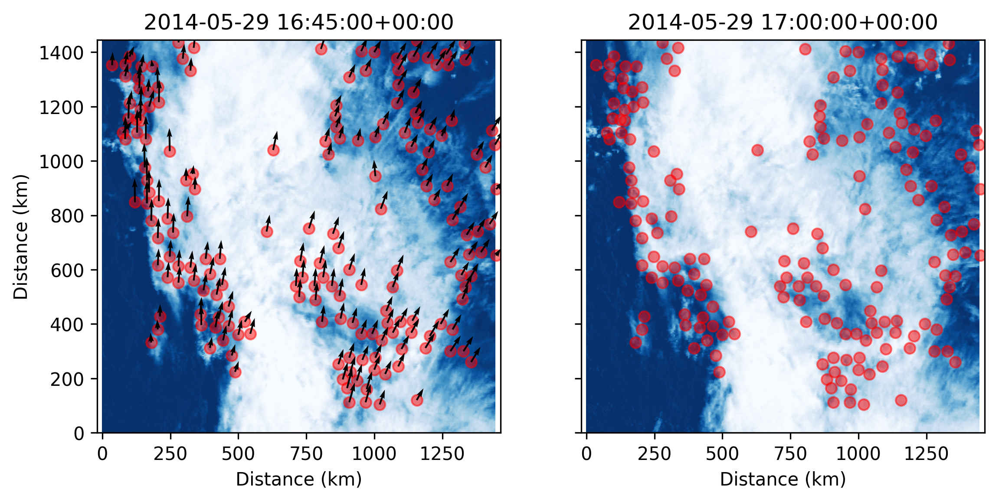

In [60]:
pos = pos*4  # optical flow done on coarse grid
tp.of_vectors_plot(
    image0,
    image1,
    pos, pos, u_of, v_of,
    time0, sat_time, 1)

(<matplotlib.figure.Figure at 0x7f642a1e0ba8>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f642a14fa20>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7f642a41dba8>], dtype=object))

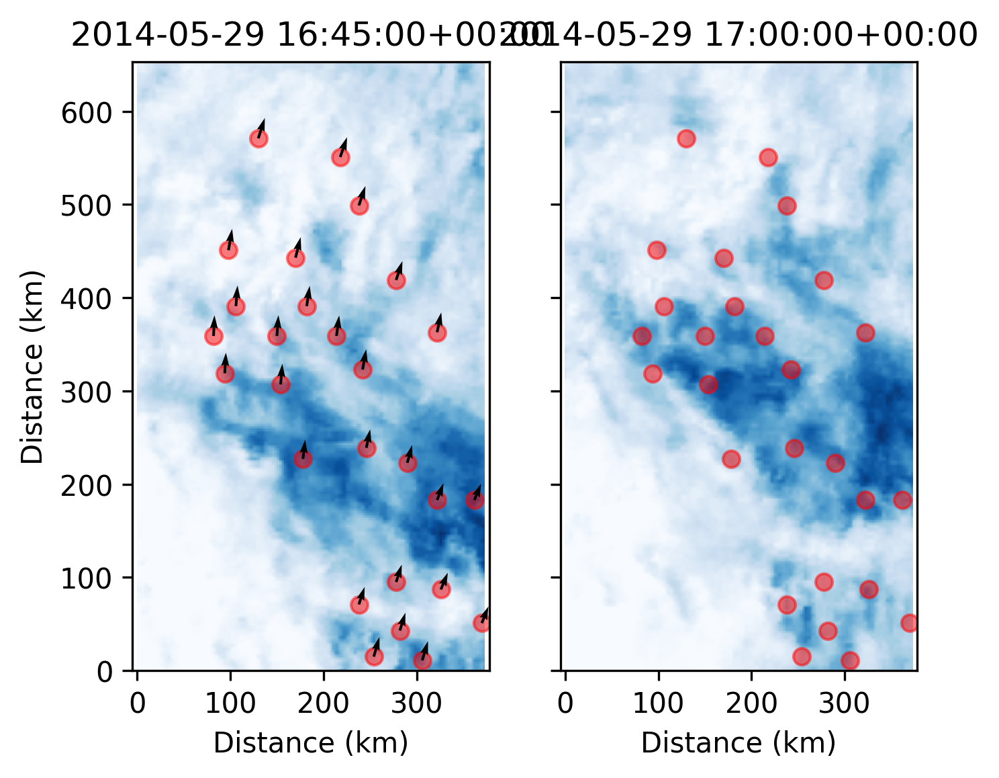

In [61]:
# need to select only pos in crop domain; convert to crop
keep = np.logical_and(
    np.logical_and(pos[:, 0] > wind_x_range[0],
                   pos[:, 0] < wind_x_range[1]),
    np.logical_and(pos[:, 1] > wind_y_range[0],
                   pos[:, 1] < wind_y_range[1]))
pos = pos[keep]
u_of = u_of[keep]
v_of = v_of[keep]
pos[:, 0] -= wind_x_range[0]
pos[:, 1] -= wind_y_range[0]
pos = pos.T
pos = pos[::-1]

tp.of_vectors_plot(
    image0[sn_min_crop:sn_max_crop,
           we_min_crop:we_max_crop],
    image1[sn_min_crop:sn_max_crop,
           we_min_crop:we_max_crop],
    pos[::-1].T, pos[::-1].T, u_of, v_of,
    time0, sat_time, 1)

In [ ]:
np.ravel

In [17]:
del this_U, this_V, image0, image1
u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
logging.debug('assim of')
remove_div_flag = True
x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
y_temp = np.arange(U_crop_shape[0])*dx/1000
x_temp, y_temp = np.meshgrid(x_temp, y_temp)

tp.wrf_of_plot(ensemble, U_crop_shape, V_crop_shape,
               u_of, v_of, pos, 1)

array([ 1.72407365,  5.57354403,  6.89337873,  0.92313981,  5.57856274,
        6.61912727,  6.20352888,  5.71392488,  6.46942186,  5.70141268,
        6.46672583,  1.65096712,  3.65073323,  6.46933699,  6.7154274 ,
        4.83313704,  2.99913216,  6.28614664,  3.85109806,  4.09717178,
        3.5280695 ,  5.08188915,  2.11968327,  1.55268359,  5.53280306,
        1.1899991 ,  2.64299202], dtype=float32)

(<matplotlib.figure.Figure at 0x7f643c2358d0>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f6465da2dd8>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7f643c1a1940>], dtype=object))

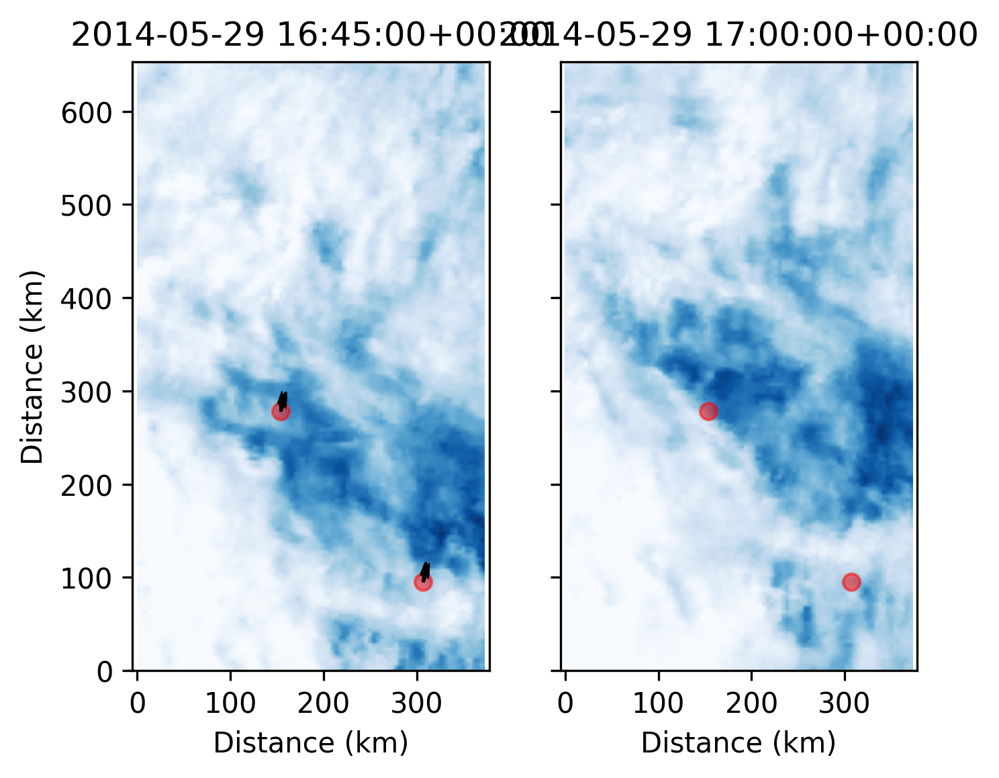

In [22]:
tp.of_vectors_plot(
    image0[sn_min_crop:sn_max_crop,
           we_min_crop:we_max_crop],
    image1[sn_min_crop:sn_max_crop,
           we_min_crop:we_max_crop],
                   pos, pos, u_of, v_of,
                           time0, sat_time, 1)

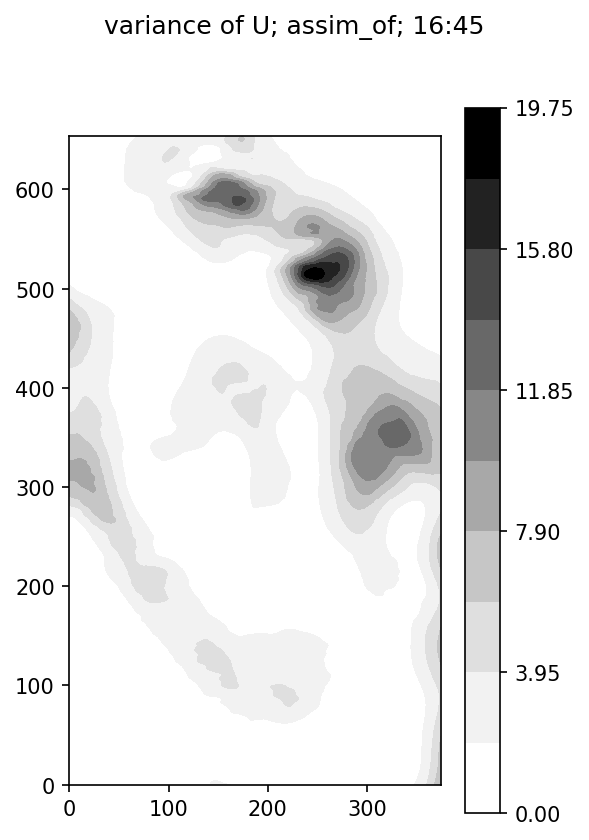

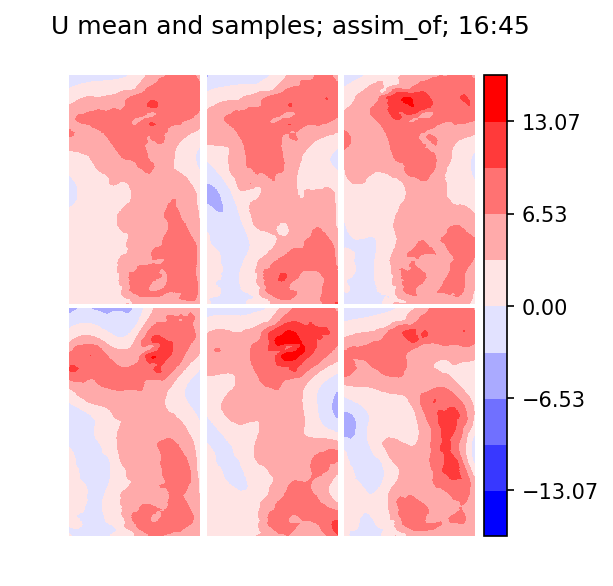

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


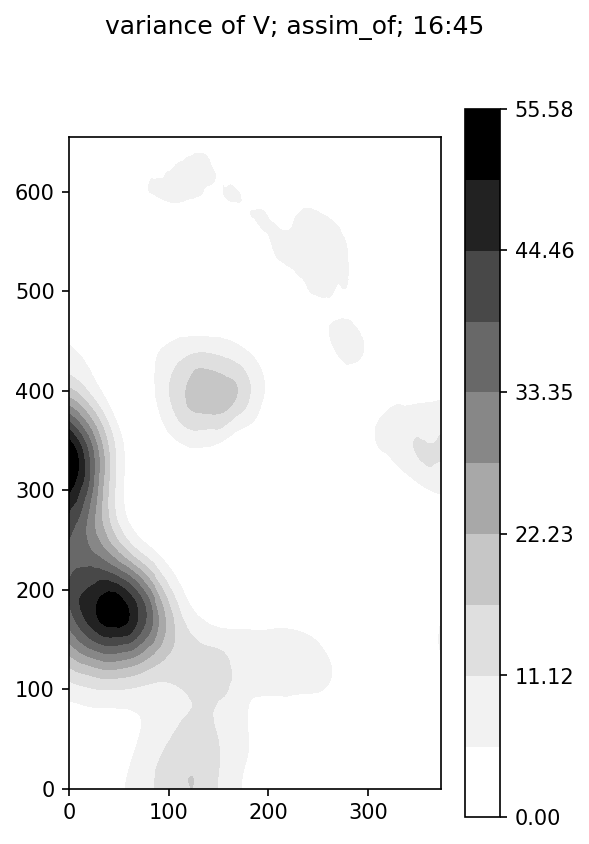

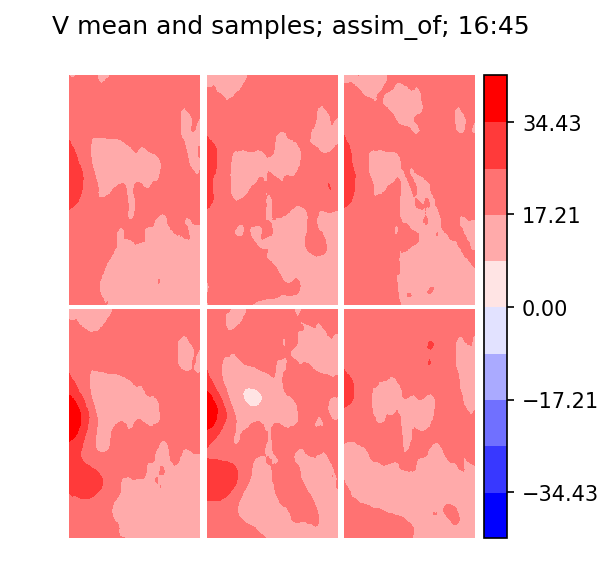

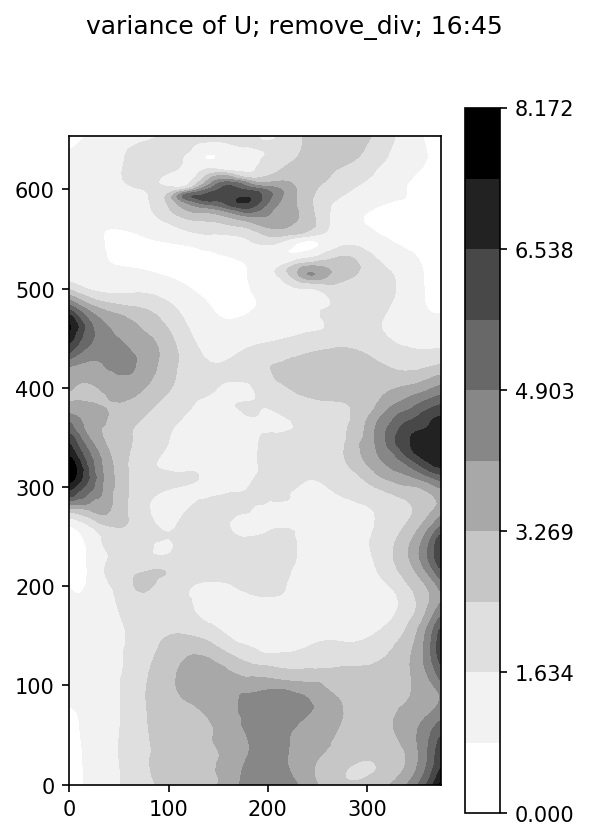

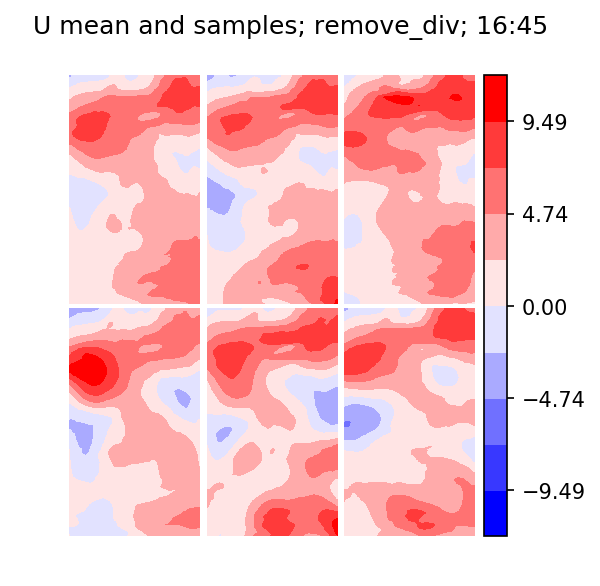

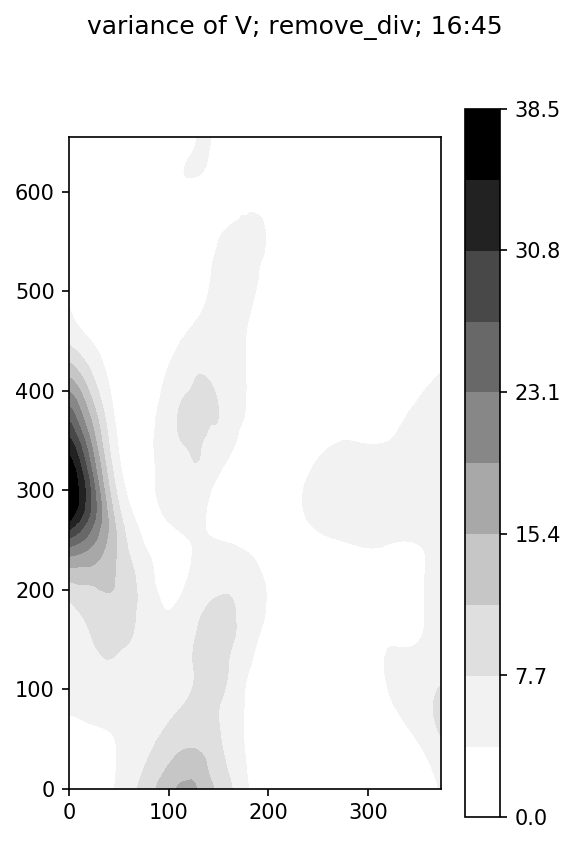

...

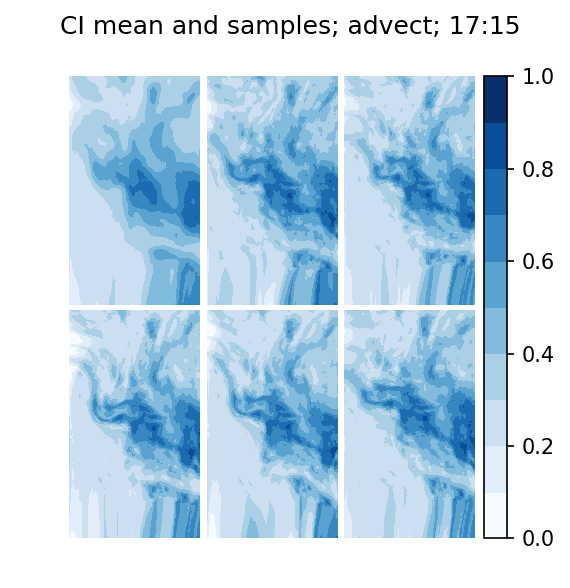

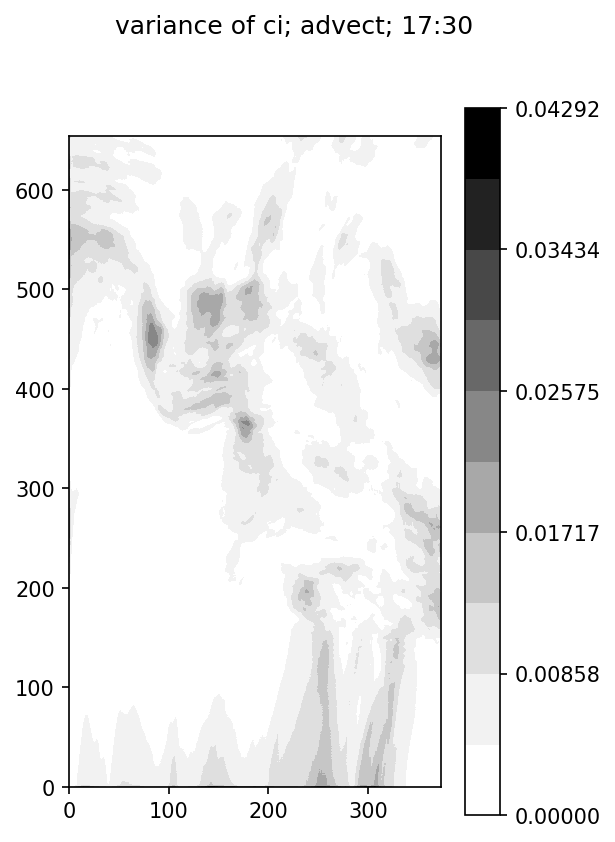

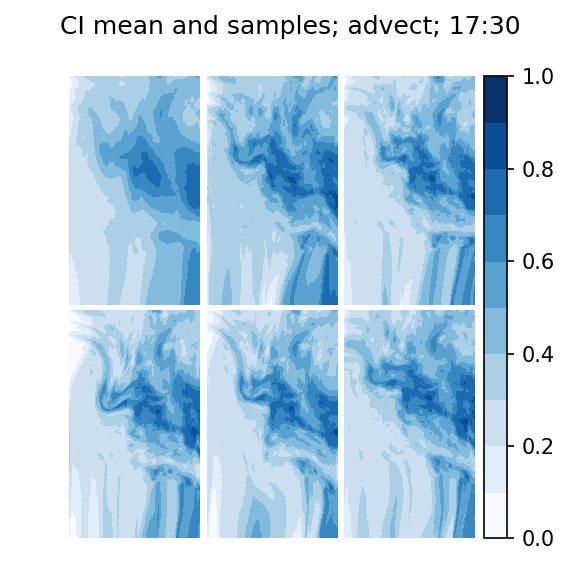

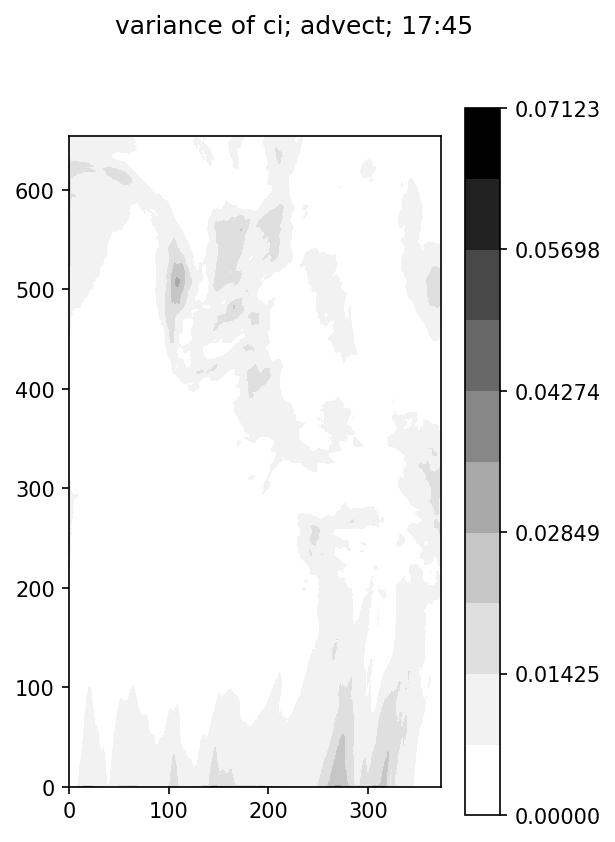

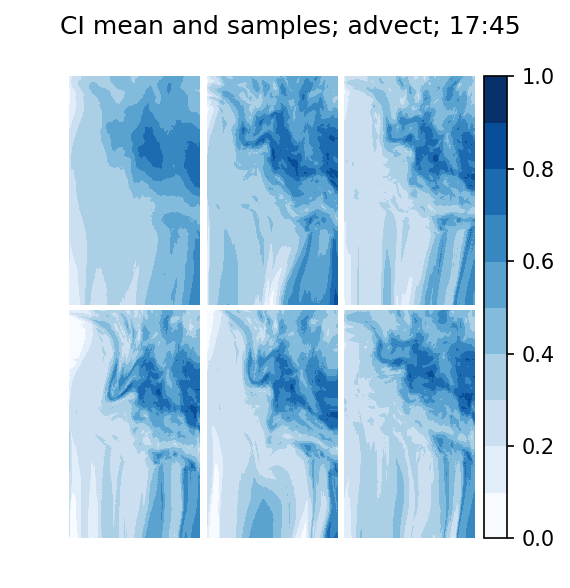

In [65]:
# for time_index in range(5): #range(sat_times.size - 1):
time_index = time_index + 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        del this_U, this_V, image0, image1
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

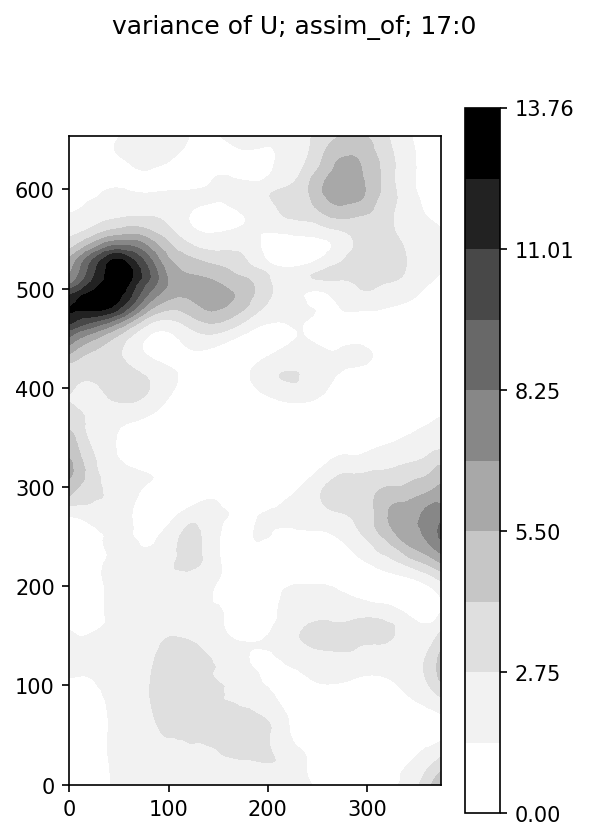

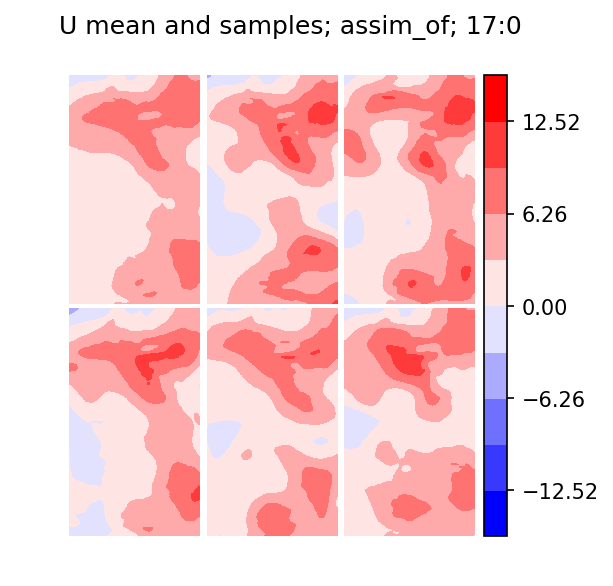

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


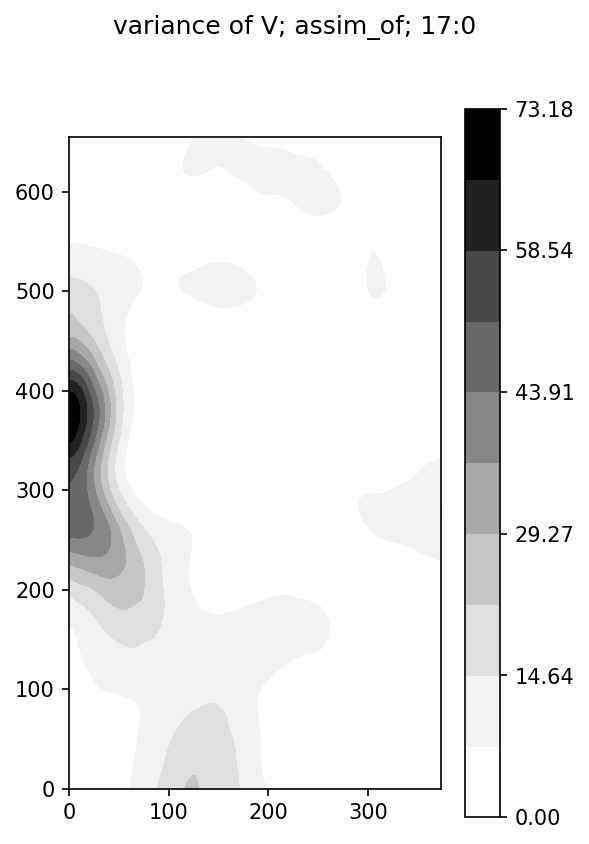

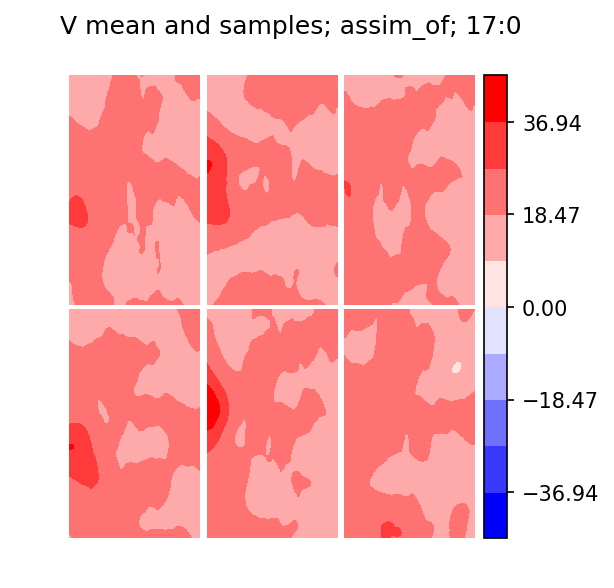

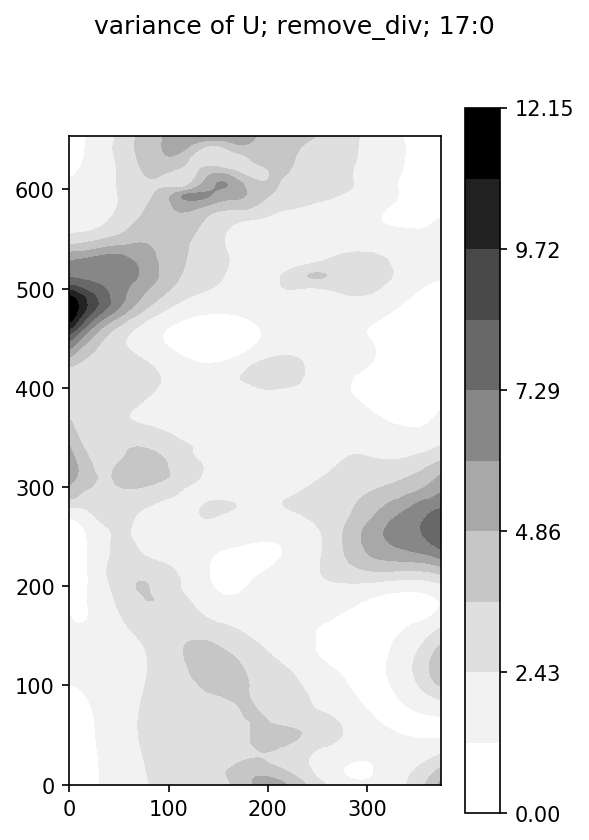

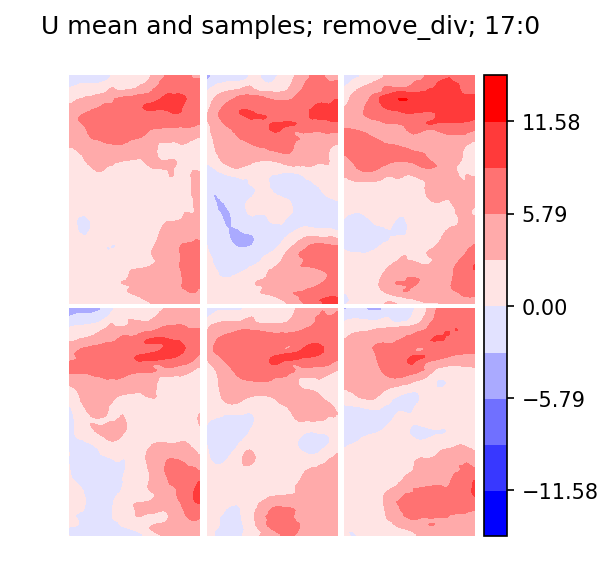

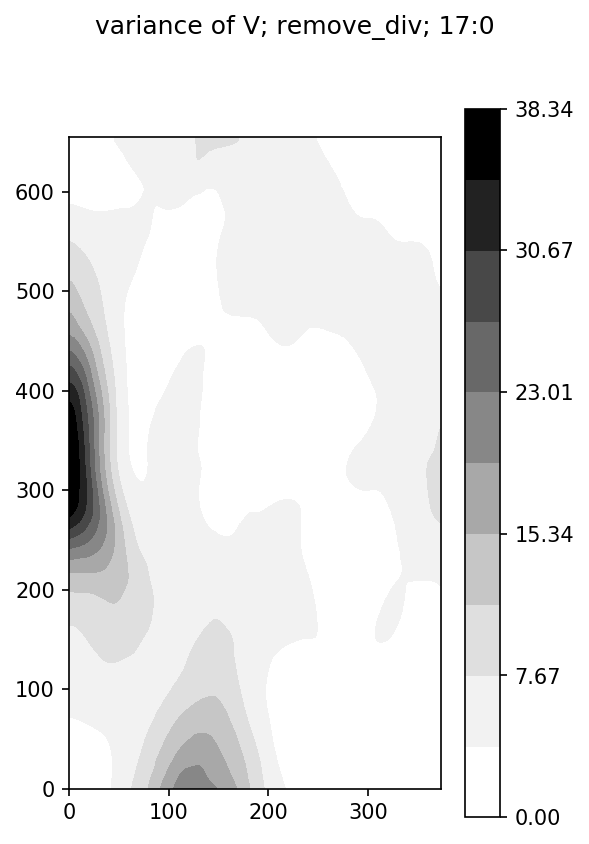

...

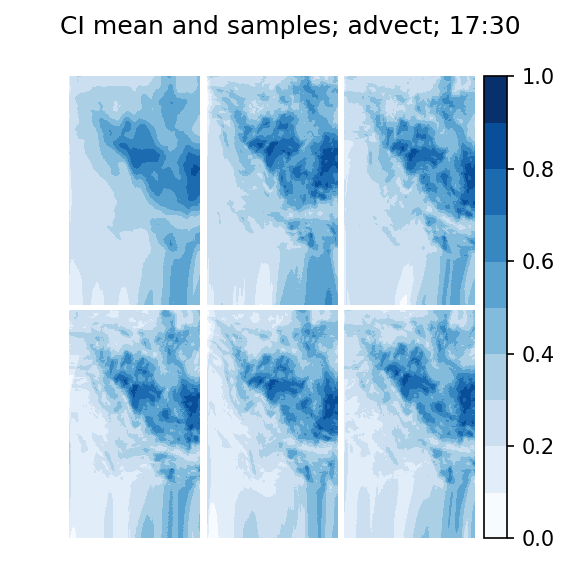

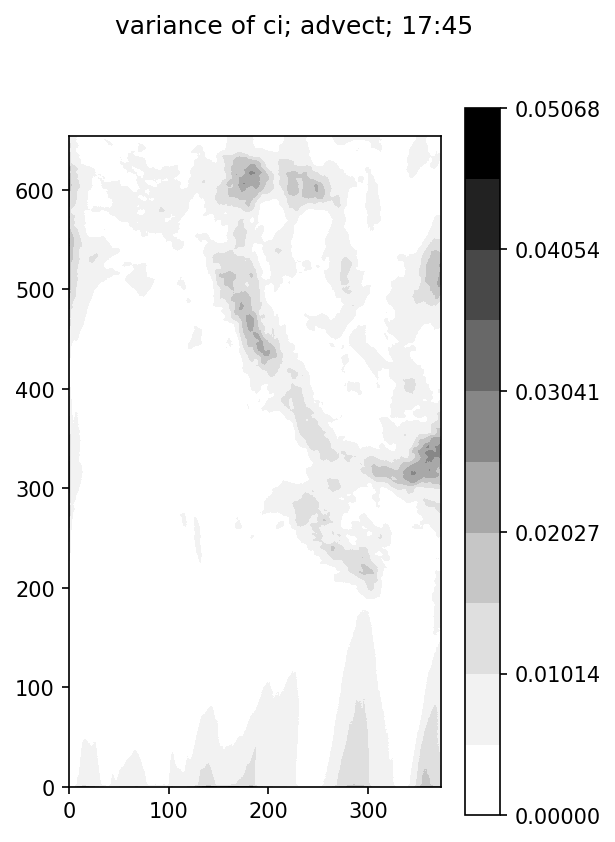

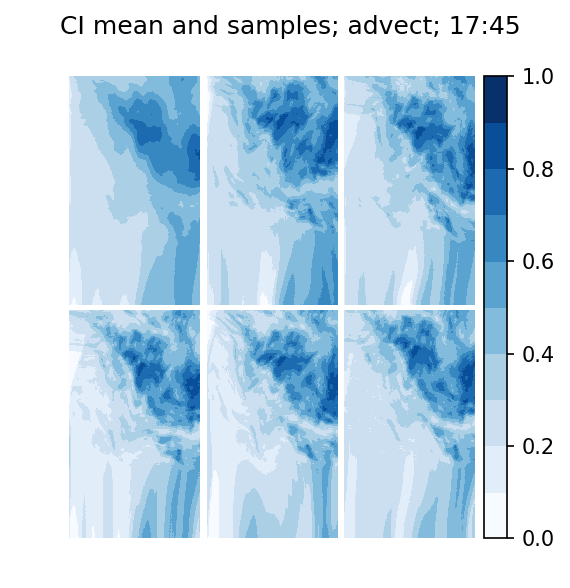

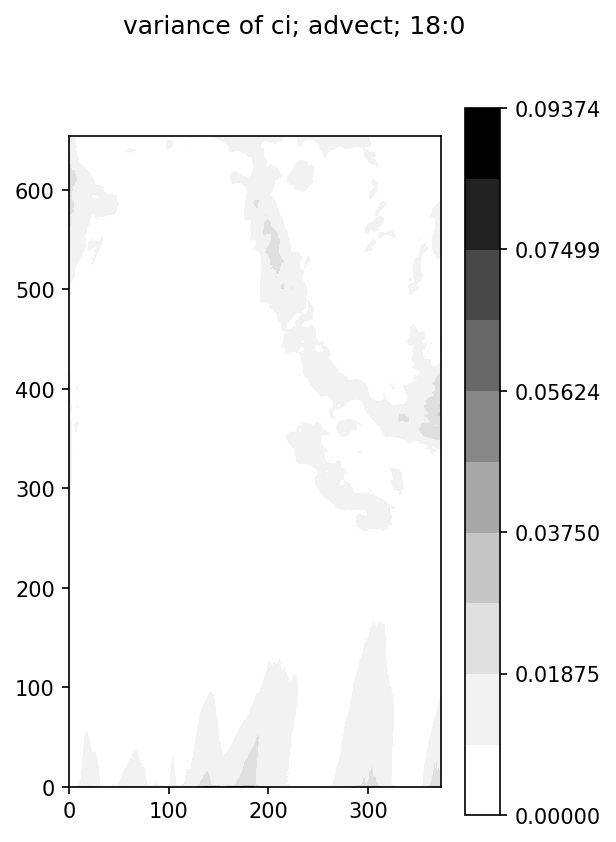

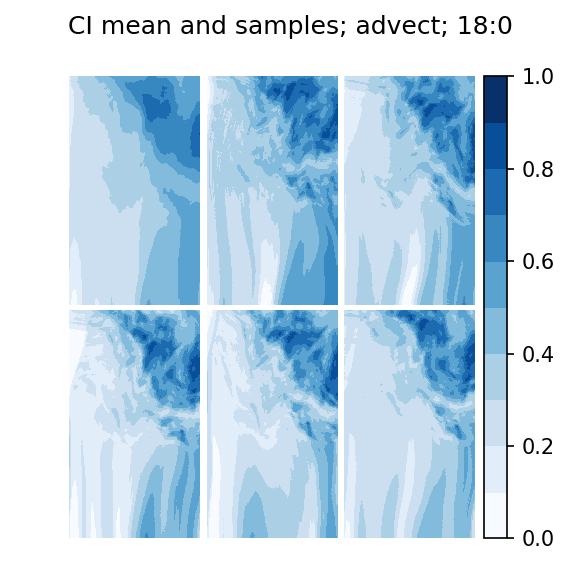

In [66]:
# for time_index in range(5): #range(sat_times.size - 1):
time_index = time_index + 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        del this_U, this_V, image0, image1
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

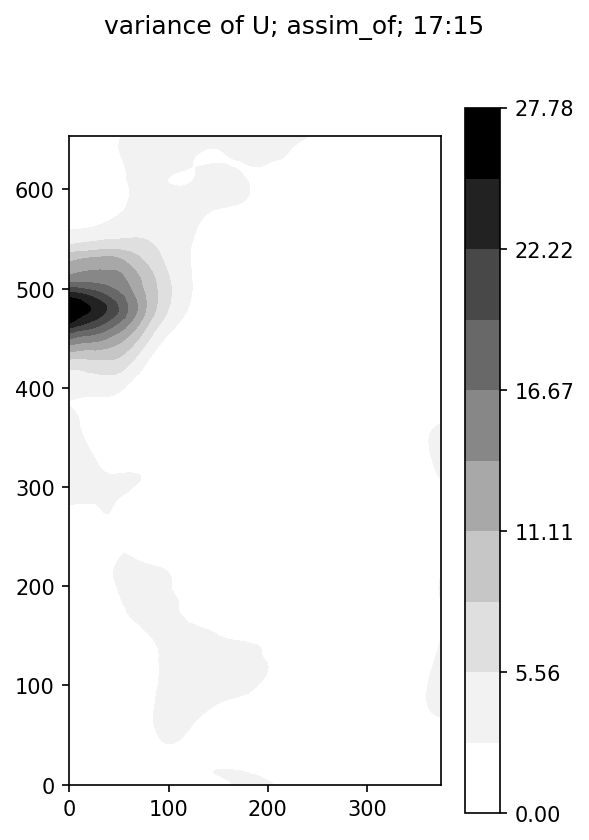

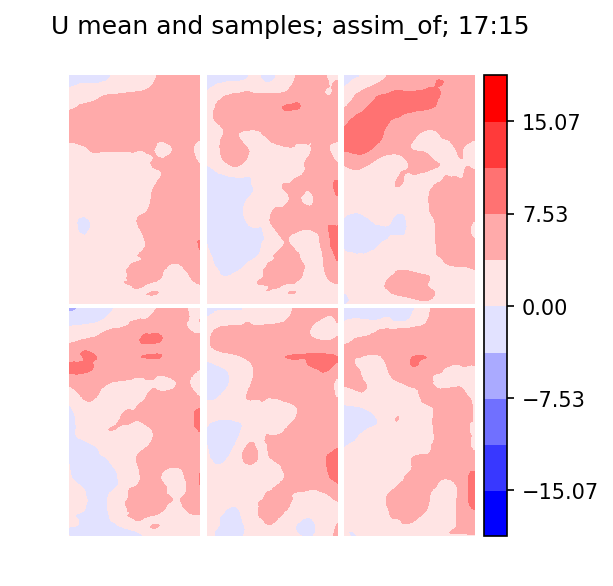

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


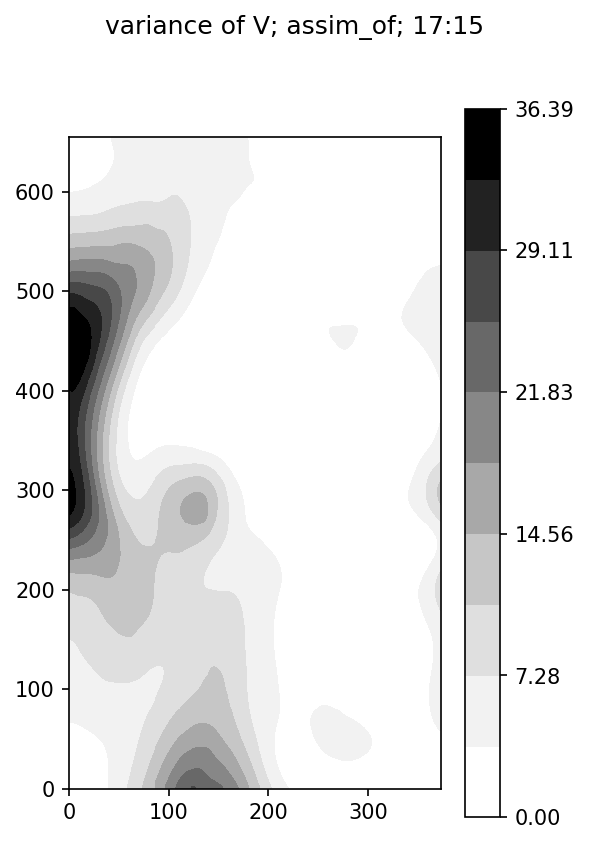

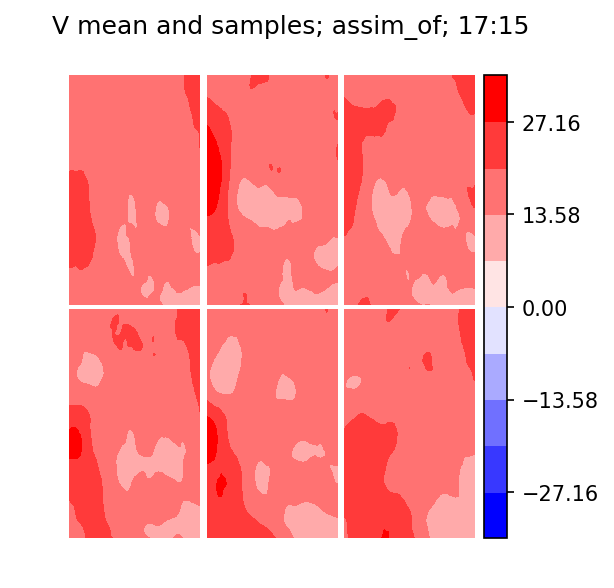

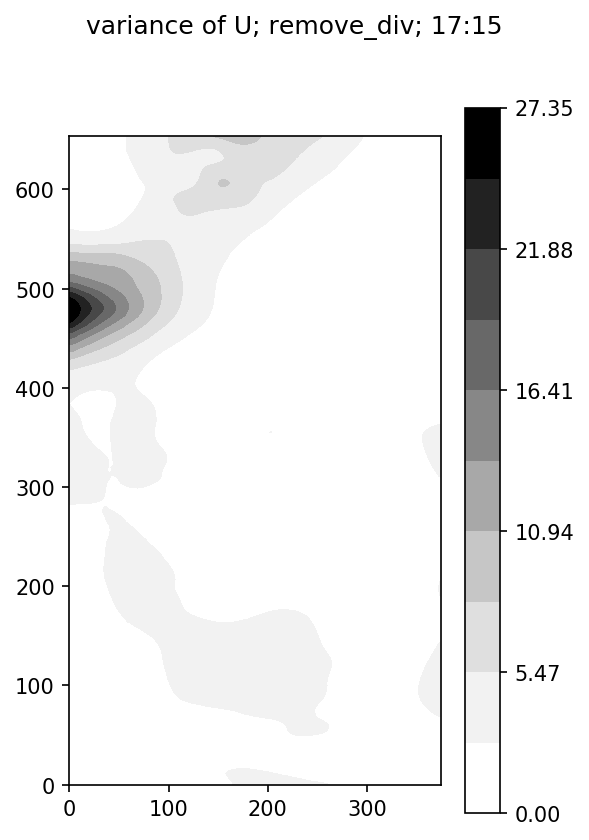

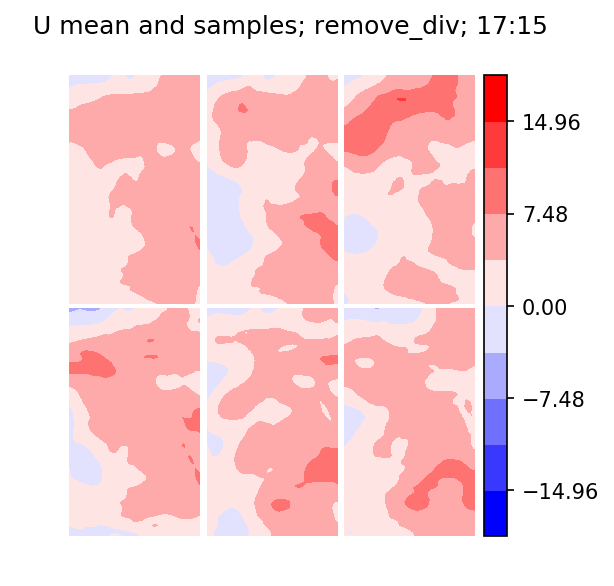

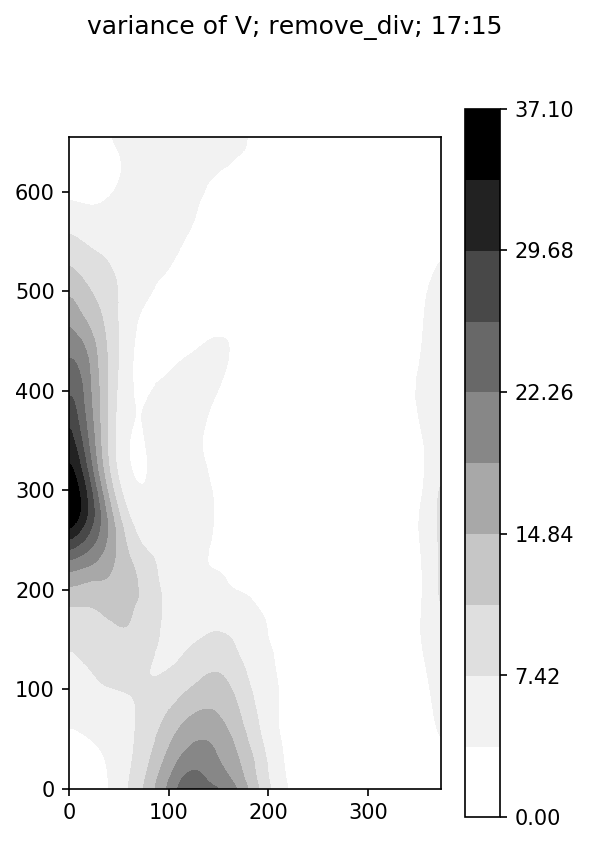

...

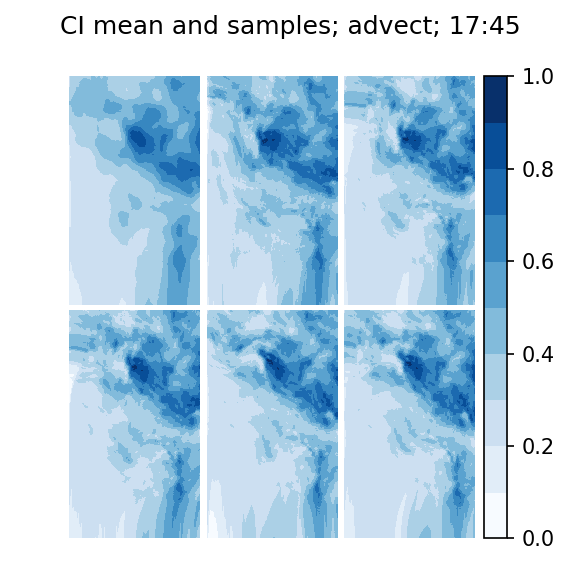

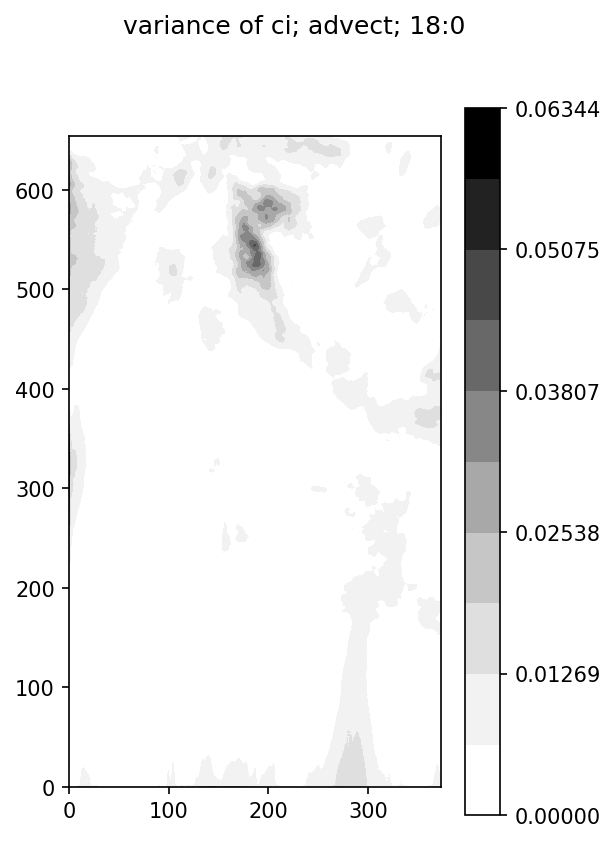

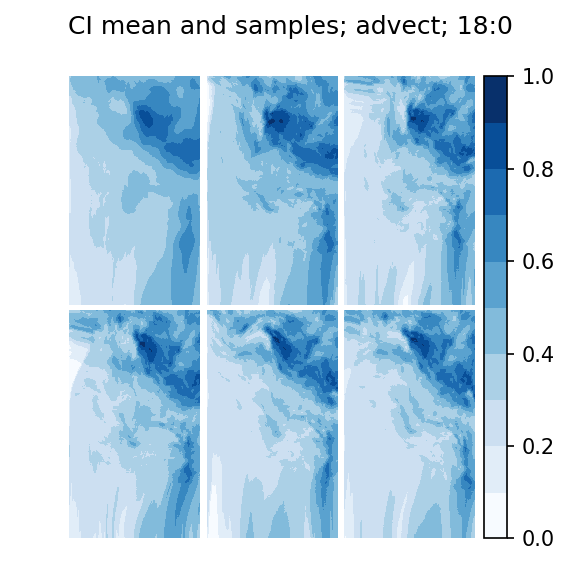

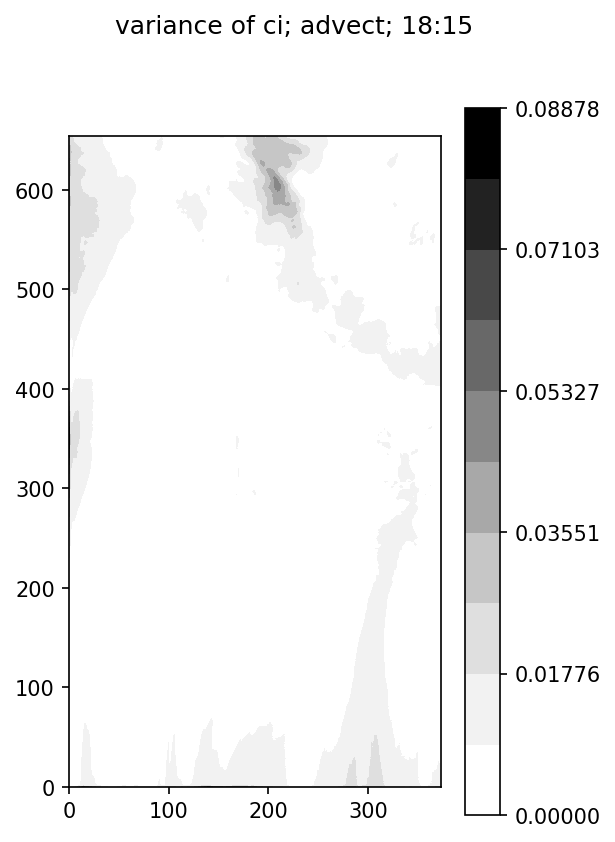

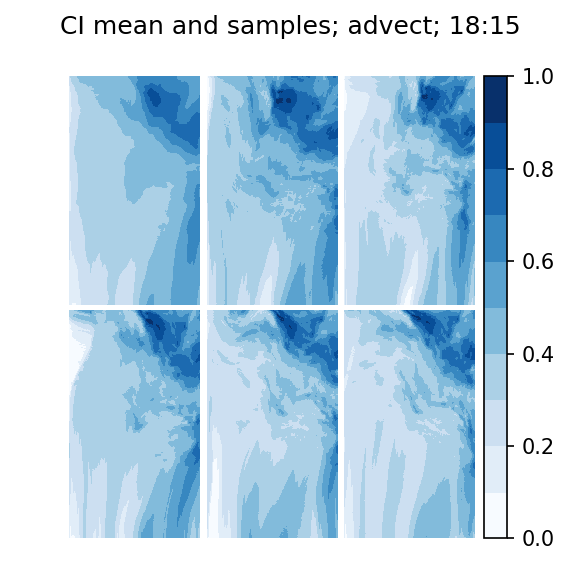

In [67]:
# for time_index in range(5): #range(sat_times.size - 1):
time_index = time_index + 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        del this_U, this_V, image0, image1
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

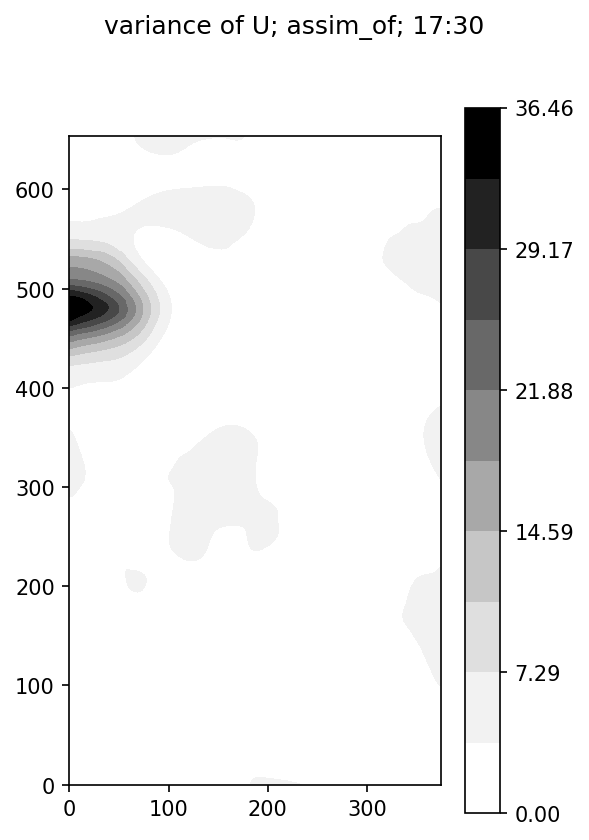

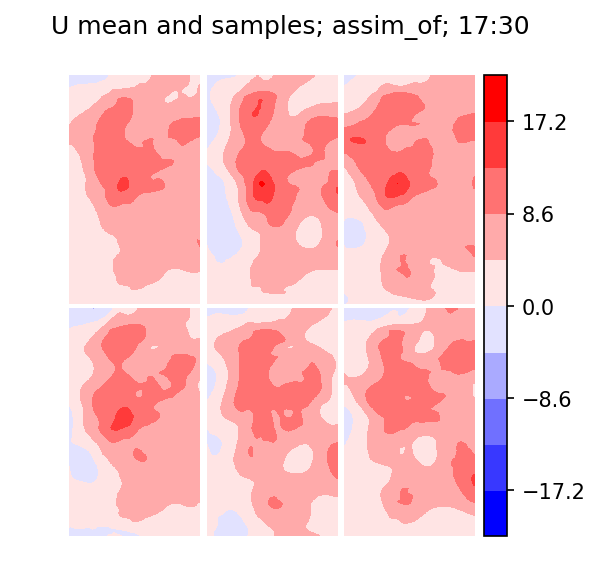

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/figure.py:402: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


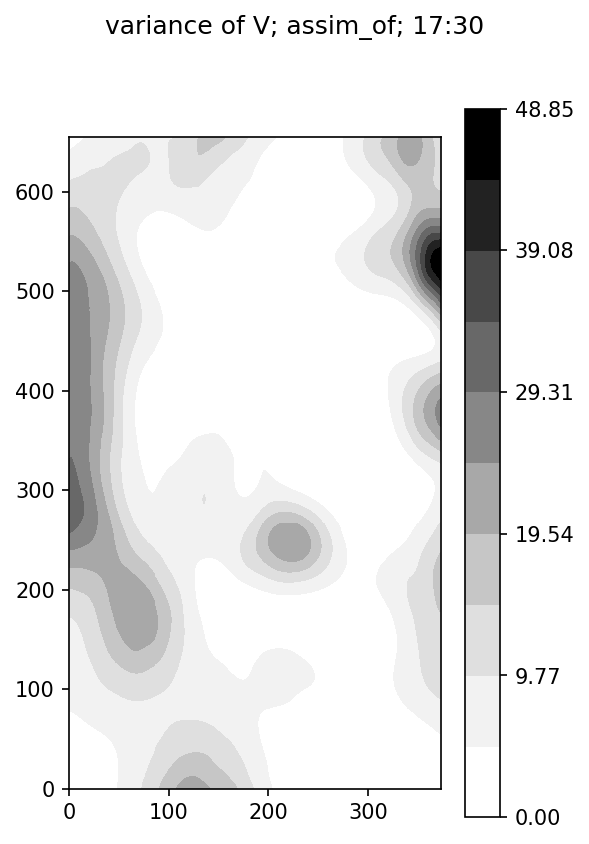

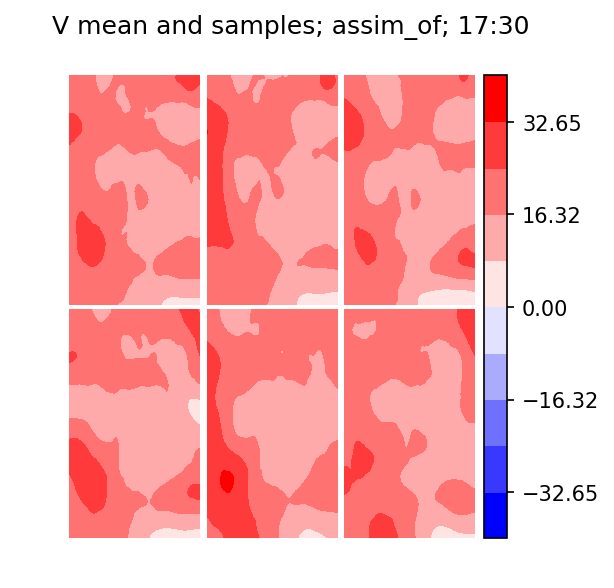

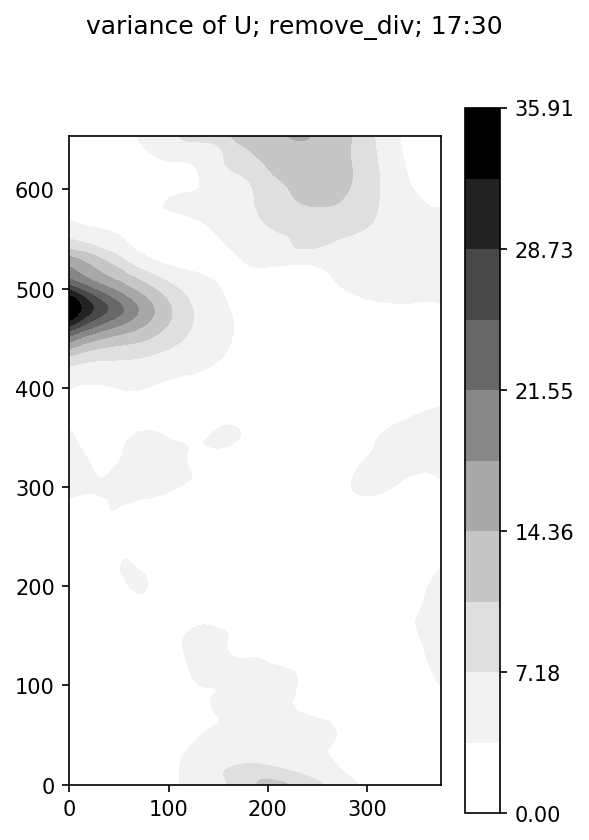

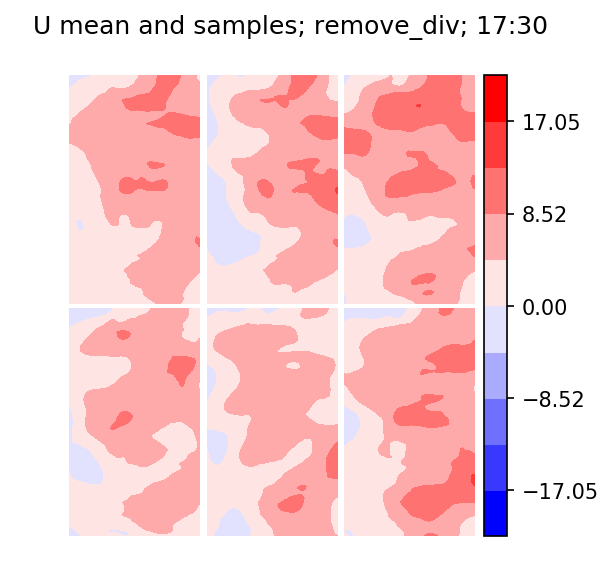

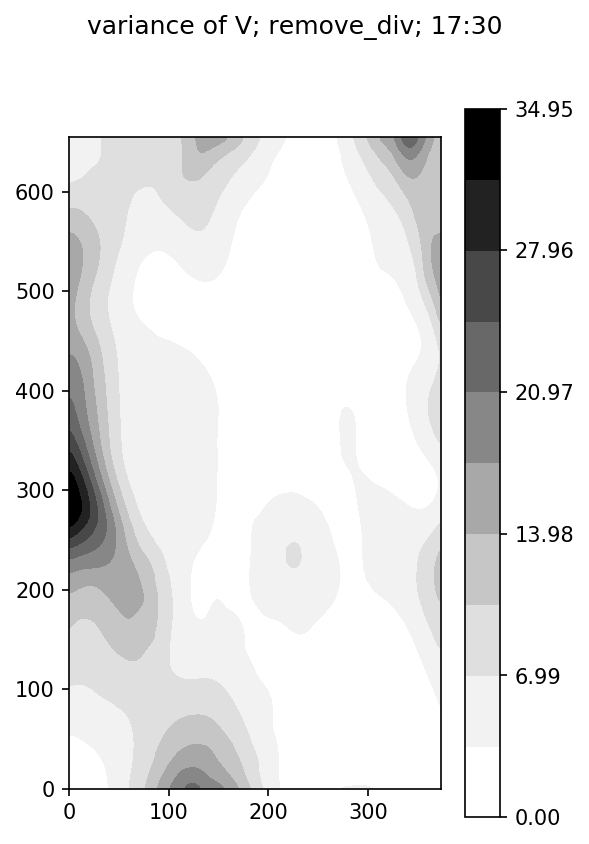

...

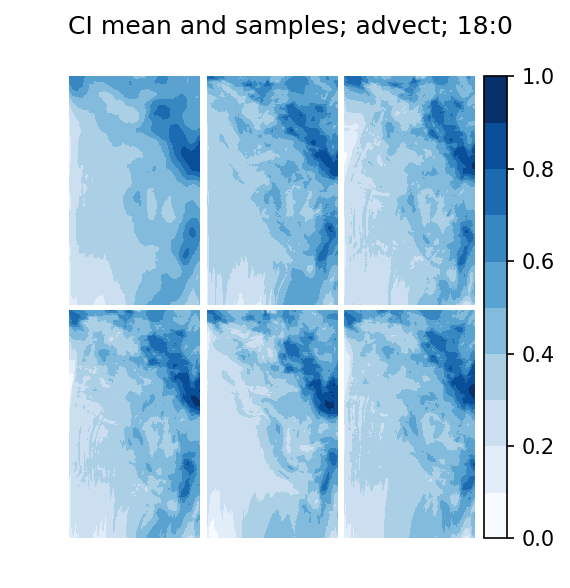

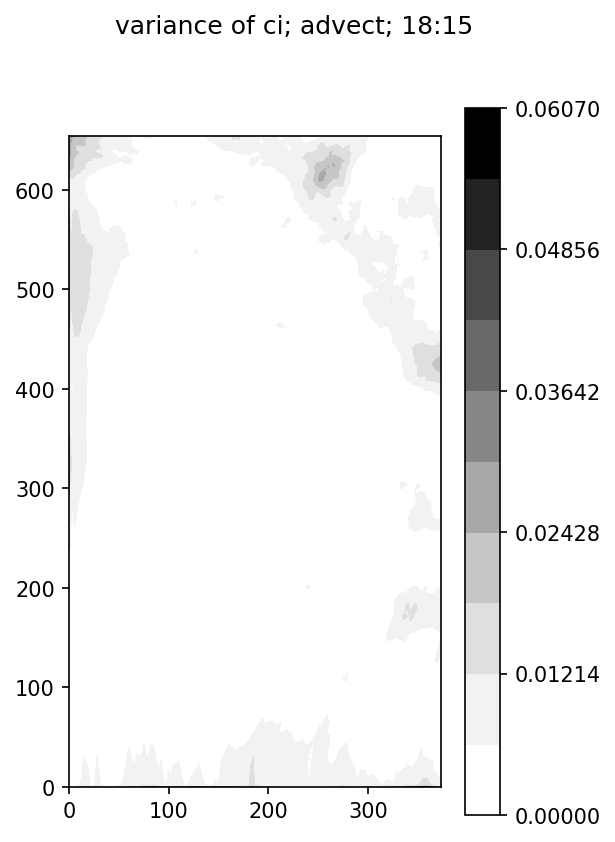

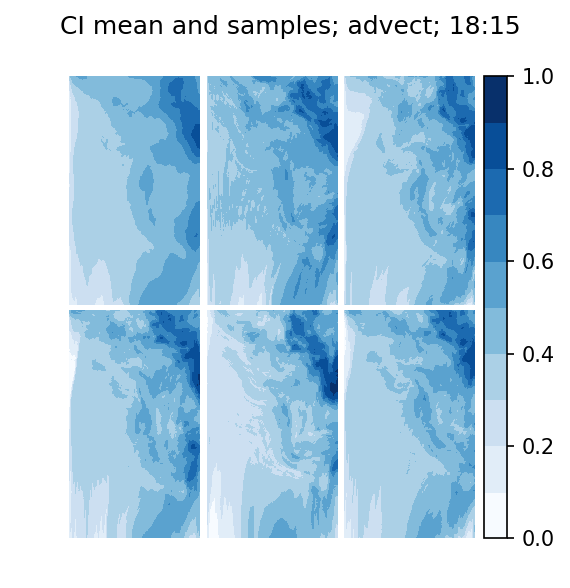

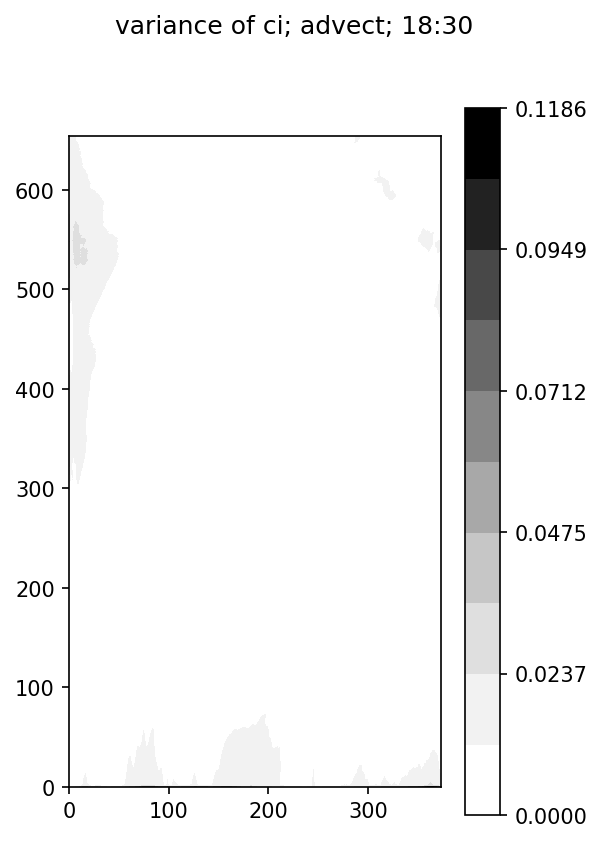

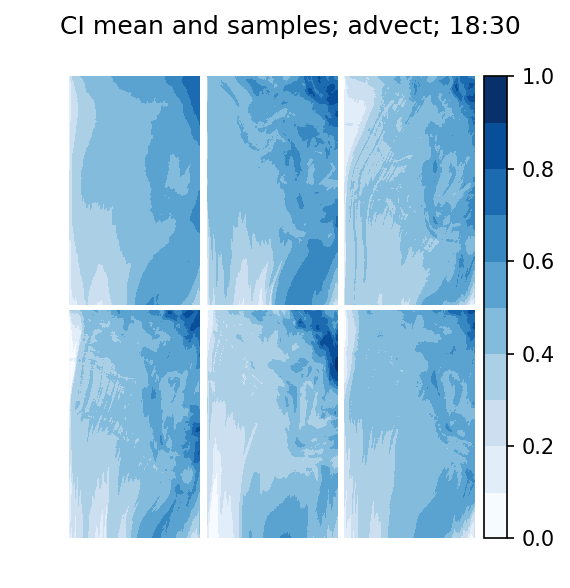

In [68]:
# for time_index in range(5): #range(sat_times.size - 1):
time_index = time_index + 1
sat_time = sat_times[time_index]
save_times = pd.date_range(sat_time, periods=(num_of_horizons + 1),
                           freq='15min')
save_times = save_times.tz_convert(None)
logging.info(str(sat_time))
int_index_wind = wind_times_all.get_loc(sat_times[0],
                                        method='pad')
wind_time = wind_times_all[int_index_wind]
num_of_advec = int((
    sat_times[time_index + 1] -
    sat_times[time_index]).seconds/(60*15))

if time_index != 0:
    if flags['assim_sat2wind']:
        logging.debug('Assim sat2wind')
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]

        ensemble = lf.assimilate_sat_to_wind(
            ensemble=ensemble,
            observations=q.ravel(),
            R_inverse_wind=1/sat2wind['sig']**2,
            wind_inflation=sat2wind['infl'],
            domain_shape=ci_crop_shape,
            U_shape=U_crop_shape, V_shape=V_crop_shape,
            localization_length_wind=sat2wind['loc'],
            assimilation_positions=assim_pos_sat2wind,
            assimilation_positions_2d=assim_pos_2d_sat2wind,
            full_positions_2d=full_pos_2d_sat2wind)
        U_plots(ensemble, sat_time, 'sat2wind')
        V_plots(ensemble, sat_time, 'sat2wind')
        remove_div_flag = True
        del q

    if sat_time == wind_time:
        logging.debug('Assim WRF')
        with Dataset(data_file_path, mode='r') as store:
            U = store.variables['U'][wind_times_all == wind_time,
                                     sn_min_crop:sn_max_crop + 1,
                                     we_stag_min_crop:
                                     we_stag_max_crop + 1]
            V = store.variables['V'][wind_times_all == wind_time,
                                     sn_stag_min_crop:
                                     sn_stag_max_crop + 1,
                                     we_min_crop:we_max_crop + 1]
            #  boolean indexing does not drop dimension
            q = q[0]
            U = U[0]
            V = V[0]
        remove_div_flag = True
        if flags['assim_wrf']:
            ensemble[:U_crop_size] = lf.assimilate_wrf(
                ensemble=ensemble[:U_crop_size],
                observations=U.ravel(),
                R_inverse=1/wrf['sig']**2,
                wind_inflation=wrf['infl'],
                wind_shape=U_crop_shape,
                localization_length_wind=wrf['loc'],
                assimilation_positions=assim_pos_U_wrf,
                assimilation_positions_2d=assim_pos_2d_U_wrf,
                full_positions_2d=full_pos_2d_U_wrf)

            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = lf.assimilate_wrf(
                         ensemble=ensemble[U_crop_size:
                                           U_crop_size + V_crop_size],
                         observations=V.ravel(),
                         R_inverse=1/wrf['sig']**2,
                         wind_inflation=wrf['infl'],
                         wind_shape=V_crop_shape,
                         localization_length_wind=wrf['loc'],
                         assimilation_positions=assim_pos_V_wrf,
                         assimilation_positions_2d=assim_pos_2d_V_wrf,
                         full_positions_2d=full_pos_2d_V_wrf)
            del U, V
            U_plots(ensemble, sat_time, 'assim_wrf')
            V_plots(ensemble, sat_time, 'assim_wrf')
        else:
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][0],
                size=ens_shape[1])
            ensemble[:U_crop_size] = (U.ravel()[:, None]
                                      + random_nums[None, :])
            random_nums = np.random.normal(
                loc=0,
                scale=ens_params['wind_sigma'][1],
                size=ens_shape[1])
            ensemble[U_crop_size:
                     U_crop_size + V_crop_size] = (
                         V.ravel()[:, None]
                         + random_nums[None, :])
            U_plots(ensemble, sat_time, 'replace_wrf')
            V_plots(ensemble, sat_time, 'replace_wrf')
    if flags['assim_of']:
        logging.debug('calc of')
        # retreive OF vectors
        time0 = sat_times[time_index - 1]
        with Dataset(data_file_path, mode='r') as store:
            this_U = store.variables['U'][
                wind_times_all == wind_time, :, :]
            this_V = store.variables['V'][
                wind_times_all == wind_time, :, :]
            image0 = store.variables['ci'][sat_times_all == time0,
                                           :, :]
            image1 = store.variables['ci'][
                sat_times_all == sat_time, :, :]
            # boolean indexing does not drop dimension
            this_U = this_U[0]
            this_V = this_V[0]
            image0 = image0[0]
            image1 = image1[0]
        u_of, v_of, pos = lf.optical_flow(image0, image1,
                                       time0, sat_time,
                                       this_U, this_V)
        del this_U, this_V, image0, image1
        pos = pos*4  # optical flow done on coarse grid

        # need to select only pos in crop domain; convert to crop
        keep = np.logical_and(
            np.logical_and(pos[:, 0] > wind_x_range[0],
                           pos[:, 0] < wind_x_range[1]),
            np.logical_and(pos[:, 1] > wind_y_range[0],
                           pos[:, 1] < wind_y_range[1]))
        pos = pos[keep]
        u_of = u_of[keep]
        v_of = v_of[keep]
        pos[:, 0] -= wind_x_range[0]
        pos[:, 1] -= wind_y_range[0]
        pos = pos.T
        pos = pos[::-1]
        u_of_flat_pos = np.ravel_multi_index(pos, U_crop_shape)
        v_of_flat_pos = np.ravel_multi_index(pos, V_crop_shape)
        logging.debug('assim of')
        remove_div_flag = True
        x_temp = np.arange(U_crop_shape[1])*dx/1000  # in km not m
        y_temp = np.arange(U_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[:U_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[:U_crop_size],
            observations=u_of, R_sig=opt_flow['sig'],
            flat_locations=u_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        x_temp = np.arange(V_crop_shape[1])*dx/1000
        y_temp = np.arange(V_crop_shape[0])*dx/1000
        x_temp, y_temp = np.meshgrid(x_temp, y_temp)
        ensemble[U_crop_size:
                 U_crop_size + V_crop_size] = lf.reduced_enkf(
            ensemble=ensemble[U_crop_size:U_crop_size +
                              V_crop_size],
            observations=v_of, R_sig=opt_flow['sig'],
            flat_locations=v_of_flat_pos,
            inflation=opt_flow['infl'],
            localization=opt_flow['loc'],
            x=x_temp.ravel(), y=y_temp.ravel())
        U_plots(ensemble, sat_time, 'assim_of')
        V_plots(ensemble, sat_time, 'assim_of')
    if not flags['assim_sat2sat']:
        with Dataset(data_file_path, mode='r') as store:
            q = store.variables['ci'][sat_times_all == sat_time,
                                      sn_min_crop:sn_max_crop + 1,
                                      we_min_crop:we_max_crop + 1]
            # boolean indexing does not drop dimension
            q = q[0]
        ensemble[wind_size:] = q.ravel()[:, None]

if remove_div_flag and flags['div']:
    logging.debug('remove divergence')
    remove_div_flag = False
    ensemble[:wind_size] = lf.remove_divergence_ensemble(
        FunctionSpace_wind, ensemble[:wind_size],
        U_crop_shape, V_crop_shape, 4)  # hardwired smoothing
    U_plots(ensemble, sat_time, 'remove_div')
    V_plots(ensemble, sat_time, 'remove_div')
temp_ensemble = ensemble.copy()
ensemble_array = temp_ensemble.copy()[None, :, :]
cx = abs(temp_ensemble[:U_crop_size]).max()
cy = abs(temp_ensemble[U_crop_size:
                       U_crop_size + V_crop_size]).max()
T_steps = int(np.ceil((5*60)*(cx/dx+cy/dy)
                      / advect_params['C_max']))
dt = (5*60)/T_steps
for m in range(num_of_horizons):
    logging.info(str(pd.Timedelta('15min')*(m + 1)))
    for n in range(3):
        temp_ensemble = lf.advect_5min_ensemble(
            ensemble, dt, dx, dy, T_steps,
            U_crop_shape, V_crop_shape,
            ci_crop_shape, client)
        if flags['perturbation']:
            temp_ensemble[wind_size:] = lf.perturb_irradiance(
                temp_ensemble[wind_size:], ci_crop_shape,
                pert_params['edge_weight'],
                pert_params['pert_mean'],
                pert_params['pert_sigma'],
                rf_approx_var, rf_eig, rf_vectors)
    ci_plots(ensemble, save_times[m + 1], 'advect')
    ensemble_array = np.concatenate(
        [ensemble_array, temp_ensemble[None, :, :]],
        axis=0)
    if num_of_advec == m:
        ensemble = temp_ensemble.copy()
U, V, ci = lf.extract_components(
    ensemble_array, ens_params['ens_num'], num_of_horizons + 1,
    U_crop_shape, V_crop_shape, ci_crop_shape)

In [ ]:
time1 = time_py.time()
print('It took: ' + str((time1 - time0)/60))
logging.info('It took: ' + str((time1 - time0)/60))